In [4]:
%%javascript
/** Below because this notebook is pretty large */
var rto = 120;
console.log('NB: Increase require timeout to ' + rto + ' seconds');
window.requirejs.config({waitSeconds: rto}); 

<IPython.core.display.Javascript object>

# Init results

In [1]:
#%%capture
%load_ext autoreload
%autoreload 2
%matplotlib notebook

import os
import cortex
import numpy as np
import matplotlib.pyplot as pl
from matplotlib import cm
import sys
import yaml
import time
from collections import defaultdict as dd
from scipy.stats import sem, ks_2samp
import seaborn as sns
import pandas as pds
import dill
from skimage import filters

opj = os.path.join

sys.path.append("..")

from prfpy.stimulus import PRFStimulus2D
from prfpy.model import Iso2DGaussianModel, CSS_Iso2DGaussianModel, Norm_Iso2DGaussianModel, DoG_Iso2DGaussianModel
from prfpy.fit import Iso2DGaussianFitter, Norm_Iso2DGaussianFitter, DoG_Iso2DGaussianFitter, CSS_Iso2DGaussianFitter

from utils.preproc_utils import *
from utils.postproc_utils import *
from utils.visualize_results import visualize_results

from IPython.core.display import display, HTML

sound_file = '/Users/marcoaqil/Downloads/filling-your-inbox.mp3'

/Users/marcoaqil/anaconda3/envs/prfpy_2021/lib/python3.9/site-packages/nilearn/glm/__init__.py:55: FutureWarning: The nilearn.glm module is experimental. It may change in any future release of Nilearn.
  warn('The nilearn.glm module is experimental. '


ModuleNotFoundError: No module named 'utils'

In [ ]:
#results object
current_results = results()
                        

## Combine & Process results

In [ ]:
current_results.combine_results(results_folder='/Volumes/Crucial X8/PRFMapping/PRFMapping-Deriv-hires/prfpy/FS7_results/separate_conds_noCV/ZSC', 
                    timecourse_folder='/Volumes/Crucial X8/PRFMapping/PRFMapping-Deriv-hires/prfpy/FS7_results/timecourses/',
                               calculate_CCrsq=False,
                               calculate_noise_ceiling=False)

In [251]:
current_results.combine_results(results_folder='/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/prfpy/TC', 
                    timecourse_folder='/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/timecourses',
                               calculate_CCrsq=False,
                               calculate_noise_ceiling=False)

100%|██████████| 24/24 [00:01<00:00, 16.37it/s]


In [8]:
current_results.combine_results(results_folder='/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/prfpy/999999_tc', 
                            timecourse_folder='/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/timecourses',
                               calculate_CCrsq=False,
                               calculate_noise_ceiling=False)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 10.12it/s]


In [32]:
current_results.combine_results(results_folder='/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/prfpy/crossvalidated_tc', 
                            timecourse_folder='/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/timecourses',
                               calculate_CCrsq=False,
                               calculate_noise_ceiling=True,
                               screenshot_paths = ['/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/HCP_data/7T_RETBAR_small.hdf5'])

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 360/360 [14:59<00:00,  2.50s/it]


In [9]:
current_results.combine_results(results_folder='/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/prfpy/TC_nocv', 
                            timecourse_folder='/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/timecourses',
                               calculate_CCrsq=False,
                               calculate_noise_ceiling=False)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████| 180/180 [00:09<00:00, 18.07it/s]


In [ ]:
current_results.combine_results(results_folder='/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/prfpy/TC_nocv', 
                            timecourse_folder='/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/timecourses',
                               calculate_CCrsq=False,
                               calculate_noise_ceiling=False)

In [20]:
current_results.combine_results(results_folder='/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/prfpy/allconds_nocv', 
                            timecourse_folder='/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/timecourses',
                               calculate_CCrsq=False,
                               calculate_noise_ceiling=False)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 17.36it/s]


In [21]:
current_results.process_results(current_results.main_dict)

  0%|                                                                                                                                     | 0/1 [00:00<?, ?it/s]

  0%|                                                                                                                                     | 0/7 [00:00<?, ?it/s]/Users/marcoaqil/prfpy_tools/test/../utils/postproc_utils.py:487: RuntimeWarning: divide by zero encountered in true_divide
  prf = params[...,3] * np.exp(-0.5*x[...,np.newaxis]**2 / params[...,2]**2)
/Users/marcoaqil/prfpy_tools/test/../utils/postproc_utils.py:359: RuntimeWarning: invalid value encountered in true_divide
  processed_results['Size ratio (sigma_2/sigma_1)'][k2][mask] = v2[:,6]/v2[:,2]
/Users/marcoaqil/prfpy_tools/test/../utils/postproc_utils.py:362: RuntimeWarning: invalid value encountered in true_divide
  processed_results['Ratio (B/D)'][k2][mask] = v2[:,7]/v2[:,8]
/Users/marcoaqil/prfpy_tools/test/../utils/postproc_utils.py:363: RuntimeWarning: invali

# Init visualize results

In [ ]:
vis_res = visualize_results(current_results)

## Fix HCP MSMall ordering (run once on HCP data)

In [33]:
#fix HCP ordering
if 'HCP' in vis_res.main_dict:
    hcp_atlas_mask_path = ['/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/HCP_data/atlas/L.atlasroi.59k_fs_LR.shape.gii',
                          '/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/HCP_data/atlas/R.atlasroi.59k_fs_LR.shape.gii']
    vis_res.fix_hcp_ordering(vis_res.main_dict['HCP'], hcp_atlas_mask_path)

## Load previous visualize_result.main_dict

In [ ]:
#rsqwm have rsq-weighted means over subjects on fsaverage
#maindict_ #allall, allruns_sepcond_rsqwm, 5050CV, allruns_sepcond_zsc, HCP_181subjects_rsqwm, HCP_999999, 99mean181, 99split20, HCP_cv (tcfit), HCP_tc_nocv
with open('/Volumes/Crucial X8/maindict_HCP_181subjects_rsqwm.pickle', 'rb') as handle:
    vis_res.main_dict=dill.load(handle)

## Save current visualize_result.main_dict

In [25]:
with open('/Volumes/Crucial X8/maindict_HCP**_rsqwm.pickle', 'wb') as handle:
     dill.dump(vis_res.main_dict, handle)

Stopping server


## Load/Save rois (run always)

In [ ]:
#this function parses or imports labaled ROIs for all subjects (run always)
#set to list of ROI names to output indices of rois for roi-only fitting. empty list for no output
output_rois = []#['custom.OccPole', 'custom.V1','custom.V2','custom.V3','custom.hV4','custom.VO',
                      #'custom.V3AB','custom.LO','custom.TO','custom.IPS','custom.FO']
    
#import flatmaps from freesurfer, if created, and import freesurfer custom rois to pycortex overlays.svg (need pre-imported flatmaps for this)
import_flatmaps = False

output_rois_path = '/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP' #/Volumes/Crucial X8/PRFMapping/PRFMapping-Deriv-hires
#freesurfer directory
fs_dir = '/Volumes/Crucial X8/PRFMapping/PRFMapping-Deriv-hires/freesurfer'

#HCP atlas path (without .{hemi}.gii)
hcp_atlas_path = '/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/HCP_data/atlas/Q1-Q6_RelatedParcellation210.CorticalAreas_dil_Colors.59k_fs_LR.dlabel' 

vis_res.define_rois_and_flatmaps(fs_dir, output_rois_path, import_flatmaps, output_rois, hcp_atlas_path)
    

## Project to fsaverage

In [19]:
#projecting results to fsaverage surface
vis_res.project_to_fsaverage(models = ['Norm_abcd'], #'Noise Ceiling (RSq)'],
                             parameters = ['x_pos', 'y_pos','Norm Param. B','Norm Param. D','Amplitude', 'Surround Amplitude','Size (fwhmax)','Surround Size (fwatmin)','Size (sigma_1)','Size (sigma_2)'],# 'Noise Ceiling'],#[
                             space_names = 'HCP',
                             analysis_names = 'all', 
                             subject_ids = 'all',#['725751','100610','765864','109123','158136']
                             hcp_atlas_mask_path = ['/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/HCP_data/atlas/L.atlasroi.59k_fs_LR.shape.gii',
                                                    '/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/HCP_data/atlas/R.atlasroi.59k_fs_LR.shape.gii'],
                             hcp_cii_file_path = '/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/HCP_data/100610/MNINonLinear/Results/tfMRI_RETBAR1_7T_AP/tfMRI_RETBAR1_7T_AP_Atlas_1.6mm_MSMAll_hp2000_clean.dtseries.nii',
                             hcp_old_sphere = '/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/HCP_data/atlas/resample_fsaverage/fs_LR-deformed_to-fsaverage.?.sphere.59k_fs_LR.surf.gii',
                             hcp_new_sphere = '/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/HCP_data/atlas/resample_fsaverage/fsaverage_std_sphere.?.164k_fsavg_?.surf.gii',
                             hcp_old_area = '/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/HCP_data/atlas/resample_fsaverage/fs_LR.?.midthickness_va_avg.59k_fs_LR.shape.gii',
                             hcp_new_area = '/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/HCP_data/atlas/resample_fsaverage/fsaverage.?.midthickness_va_avg.164k_fsavg_?.shape.gii',
                             hcp_temp_folder = '/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/temp_files')

  0%|                                                     | 0/7 [00:00<?, ?it/s]

HCP fit-task-all_fit-runs-all 100610


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 14%|██████▍                                      | 1/7 [00:09<00:55,  9.27s/it]

False
False
HCP fit-task-all_fit-runs-all 102311


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 29%|████████████▊                                | 2/7 [00:16<00:41,  8.35s/it]

False
False
HCP fit-task-all_fit-runs-all 102816


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 43%|███████████████████▎                         | 3/7 [00:24<00:32,  8.08s/it]

False
False
HCP fit-task-all_fit-runs-all 104416


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 57%|█████████████████████████▋                   | 4/7 [00:32<00:23,  7.95s/it]

False
False
HCP fit-task-all_fit-runs-all 105923


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 71%|████████████████████████████████▏            | 5/7 [00:40<00:15,  7.89s/it]

False
False
HCP fit-task-all_fit-runs-all 108323


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 86%|██████████████████████████████████████▌      | 6/7 [00:48<00:07,  7.85s/it]

False
False
HCP fit-task-all_fit-runs-all 109123


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
  0%|                                                     | 0/7 [00:00<?, ?it/s]

False
False
HCP fit-task-all_fit-runs-all 100610


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 14%|██████▍                                      | 1/7 [00:07<00:46,  7.76s/it]

False
False
HCP fit-task-all_fit-runs-all 102311


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 29%|████████████▊                                | 2/7 [00:15<00:39,  7.84s/it]

False
False
HCP fit-task-all_fit-runs-all 102816


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 43%|███████████████████▎                         | 3/7 [00:23<00:31,  7.83s/it]

False
False
HCP fit-task-all_fit-runs-all 104416


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 57%|█████████████████████████▋                   | 4/7 [00:31<00:23,  7.76s/it]

False
False
HCP fit-task-all_fit-runs-all 105923


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 71%|████████████████████████████████▏            | 5/7 [00:39<00:15,  7.84s/it]

False
False
HCP fit-task-all_fit-runs-all 108323


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 86%|██████████████████████████████████████▌      | 6/7 [00:47<00:07,  7.94s/it]

False
False
HCP fit-task-all_fit-runs-all 109123


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
100%|█████████████████████████████████████████████| 7/7 [00:55<00:00,  7.87s/it]
/Users/marcoaqil/prfpy_tools/test/../utils/visualize_results.py:1283: RuntimeWarning: invalid value encountered in true_divide
  fsaverage_group_average = (data*weights).sum(0)/weights.sum(0)
  0%|                                                     | 0/7 [00:00<?, ?it/s]

False
False
HCP fit-task-all_fit-runs-all 100610


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 14%|██████▍                                      | 1/7 [00:07<00:46,  7.78s/it]

False
False
HCP fit-task-all_fit-runs-all 102311


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 29%|████████████▊                                | 2/7 [00:15<00:39,  7.92s/it]

False
False
HCP fit-task-all_fit-runs-all 102816


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 43%|███████████████████▎                         | 3/7 [00:23<00:31,  7.93s/it]

False
False
HCP fit-task-all_fit-runs-all 104416


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 57%|█████████████████████████▋                   | 4/7 [00:31<00:23,  7.80s/it]

False
False
HCP fit-task-all_fit-runs-all 105923


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 71%|████████████████████████████████▏            | 5/7 [00:38<00:15,  7.74s/it]

False
False
HCP fit-task-all_fit-runs-all 108323


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 86%|██████████████████████████████████████▌      | 6/7 [00:46<00:07,  7.80s/it]

False
False
HCP fit-task-all_fit-runs-all 109123


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
  0%|                                                     | 0/7 [00:00<?, ?it/s]

False
False
HCP fit-task-all_fit-runs-all 100610


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 14%|██████▍                                      | 1/7 [00:08<00:48,  8.06s/it]

False
False
HCP fit-task-all_fit-runs-all 102311


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 29%|████████████▊                                | 2/7 [00:16<00:40,  8.12s/it]

False
False
HCP fit-task-all_fit-runs-all 102816


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 43%|███████████████████▎                         | 3/7 [00:24<00:32,  8.12s/it]

False
False
HCP fit-task-all_fit-runs-all 104416


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 57%|█████████████████████████▋                   | 4/7 [00:32<00:24,  8.06s/it]

False
False
HCP fit-task-all_fit-runs-all 105923


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 71%|████████████████████████████████▏            | 5/7 [00:40<00:16,  8.03s/it]

False
False
HCP fit-task-all_fit-runs-all 108323


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 86%|██████████████████████████████████████▌      | 6/7 [00:48<00:08,  8.05s/it]

False
False
HCP fit-task-all_fit-runs-all 109123


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
  0%|                                                     | 0/7 [00:00<?, ?it/s]

False
False
HCP fit-task-all_fit-runs-all 100610


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 14%|██████▍                                      | 1/7 [00:07<00:47,  7.84s/it]

False
False
HCP fit-task-all_fit-runs-all 102311


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 29%|████████████▊                                | 2/7 [00:15<00:39,  7.88s/it]

False
False
HCP fit-task-all_fit-runs-all 102816


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 43%|███████████████████▎                         | 3/7 [00:23<00:31,  7.88s/it]

False
False
HCP fit-task-all_fit-runs-all 104416


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 57%|█████████████████████████▋                   | 4/7 [00:31<00:23,  7.88s/it]

False
False
HCP fit-task-all_fit-runs-all 105923


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 71%|████████████████████████████████▏            | 5/7 [00:39<00:15,  7.80s/it]

False
False
HCP fit-task-all_fit-runs-all 108323


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 86%|██████████████████████████████████████▌      | 6/7 [00:46<00:07,  7.74s/it]

False
False
HCP fit-task-all_fit-runs-all 109123


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
  0%|                                                     | 0/7 [00:00<?, ?it/s]

False
False
HCP fit-task-all_fit-runs-all 100610


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 14%|██████▍                                      | 1/7 [00:07<00:45,  7.65s/it]

False
False
HCP fit-task-all_fit-runs-all 102311


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 29%|████████████▊                                | 2/7 [00:15<00:39,  7.84s/it]

False
False
HCP fit-task-all_fit-runs-all 102816


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 43%|███████████████████▎                         | 3/7 [00:24<00:32,  8.18s/it]

False
False
HCP fit-task-all_fit-runs-all 104416


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 57%|█████████████████████████▋                   | 4/7 [00:32<00:25,  8.38s/it]

False
False
HCP fit-task-all_fit-runs-all 105923


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 71%|████████████████████████████████▏            | 5/7 [00:41<00:16,  8.49s/it]

False
False
HCP fit-task-all_fit-runs-all 108323


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 86%|██████████████████████████████████████▌      | 6/7 [00:49<00:08,  8.24s/it]

False
False
HCP fit-task-all_fit-runs-all 109123


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
  0%|                                                     | 0/7 [00:00<?, ?it/s]

False
False
HCP fit-task-all_fit-runs-all 100610


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 14%|██████▍                                      | 1/7 [00:08<00:53,  8.84s/it]

False
False
HCP fit-task-all_fit-runs-all 102311


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 29%|████████████▊                                | 2/7 [00:17<00:43,  8.62s/it]

False
False
HCP fit-task-all_fit-runs-all 102816


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 43%|███████████████████▎                         | 3/7 [00:25<00:34,  8.52s/it]

False
False
HCP fit-task-all_fit-runs-all 104416


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 57%|█████████████████████████▋                   | 4/7 [00:34<00:25,  8.43s/it]

False
False
HCP fit-task-all_fit-runs-all 105923


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 71%|████████████████████████████████▏            | 5/7 [00:42<00:16,  8.35s/it]

False
False
HCP fit-task-all_fit-runs-all 108323


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 86%|██████████████████████████████████████▌      | 6/7 [00:50<00:08,  8.30s/it]

False
False
HCP fit-task-all_fit-runs-all 109123


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
  0%|                                                     | 0/7 [00:00<?, ?it/s]

False
False
HCP fit-task-all_fit-runs-all 100610


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 14%|██████▍                                      | 1/7 [00:07<00:45,  7.51s/it]

False
False
HCP fit-task-all_fit-runs-all 102311


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 29%|████████████▊                                | 2/7 [00:16<00:41,  8.35s/it]

False
False
HCP fit-task-all_fit-runs-all 102816


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 43%|███████████████████▎                         | 3/7 [00:24<00:33,  8.32s/it]

False
False
HCP fit-task-all_fit-runs-all 104416


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 57%|█████████████████████████▋                   | 4/7 [00:32<00:23,  7.93s/it]

False
False
HCP fit-task-all_fit-runs-all 105923


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 71%|████████████████████████████████▏            | 5/7 [00:40<00:16,  8.28s/it]

False
False
HCP fit-task-all_fit-runs-all 108323


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 86%|██████████████████████████████████████▌      | 6/7 [00:49<00:08,  8.42s/it]

False
False
HCP fit-task-all_fit-runs-all 109123


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
  0%|                                                     | 0/7 [00:00<?, ?it/s]

False
False
HCP fit-task-all_fit-runs-all 100610


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 14%|██████▍                                      | 1/7 [00:07<00:45,  7.59s/it]

False
False
HCP fit-task-all_fit-runs-all 102311


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 29%|████████████▊                                | 2/7 [00:15<00:37,  7.57s/it]

False
False
HCP fit-task-all_fit-runs-all 102816


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 43%|███████████████████▎                         | 3/7 [00:22<00:30,  7.54s/it]

False
False
HCP fit-task-all_fit-runs-all 104416


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 57%|█████████████████████████▋                   | 4/7 [00:30<00:22,  7.51s/it]

False
False
HCP fit-task-all_fit-runs-all 105923


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 71%|████████████████████████████████▏            | 5/7 [00:37<00:15,  7.55s/it]

False
False
HCP fit-task-all_fit-runs-all 108323


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 86%|██████████████████████████████████████▌      | 6/7 [00:45<00:07,  7.54s/it]

False
False
HCP fit-task-all_fit-runs-all 109123


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
  0%|                                                     | 0/7 [00:00<?, ?it/s]

False
False
HCP fit-task-all_fit-runs-all 100610


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 14%|██████▍                                      | 1/7 [00:07<00:45,  7.50s/it]

False
False
HCP fit-task-all_fit-runs-all 102311


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 29%|████████████▊                                | 2/7 [00:14<00:37,  7.48s/it]

False
False
HCP fit-task-all_fit-runs-all 102816


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 43%|███████████████████▎                         | 3/7 [00:22<00:29,  7.44s/it]

False
False
HCP fit-task-all_fit-runs-all 104416


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 57%|█████████████████████████▋                   | 4/7 [00:29<00:22,  7.45s/it]

False
False
HCP fit-task-all_fit-runs-all 105923


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 71%|████████████████████████████████▏            | 5/7 [00:37<00:14,  7.44s/it]

False
False
HCP fit-task-all_fit-runs-all 108323


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 86%|██████████████████████████████████████▌      | 6/7 [00:44<00:07,  7.47s/it]

False
False
HCP fit-task-all_fit-runs-all 109123


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
  0%|                                                     | 0/7 [00:00<?, ?it/s]

False
False
HCP fit-task-all_fit-runs-all 100610


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 14%|██████▍                                      | 1/7 [00:07<00:44,  7.37s/it]

False
False
HCP fit-task-all_fit-runs-all 102311


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 29%|████████████▊                                | 2/7 [00:14<00:36,  7.36s/it]

False
False
HCP fit-task-all_fit-runs-all 102816


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 43%|███████████████████▎                         | 3/7 [00:22<00:29,  7.44s/it]

False
False
HCP fit-task-all_fit-runs-all 104416


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 57%|█████████████████████████▋                   | 4/7 [00:29<00:22,  7.45s/it]

False
False
HCP fit-task-all_fit-runs-all 105923


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 71%|████████████████████████████████▏            | 5/7 [00:37<00:14,  7.46s/it]

False
False
HCP fit-task-all_fit-runs-all 108323


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
 86%|██████████████████████████████████████▌      | 6/7 [00:44<00:07,  7.42s/it]

False
False
HCP fit-task-all_fit-runs-all 109123


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
100%|█████████████████████████████████████████████| 7/7 [00:52<00:00,  7.45s/it]

False
False



/Users/marcoaqil/prfpy_tools/test/../utils/visualize_results.py:1291: RuntimeWarning: Mean of empty slice
  self.main_dict['fsaverage']['Mean analysis']['fsaverage']['Processed Results'][parameter][model] = np.nanmean([self.main_dict['fsaverage'][an[0]]['fsaverage']['Processed Results'][parameter][model] for an in analyses], axis=0)
/Users/marcoaqil/prfpy_tools/test/../utils/visualize_results.py:1301: RuntimeWarning: invalid value encountered in true_divide
  subj_res['Processed Results']['Size ratio (sigma_2/sigma_1)'][model] = subj_res['Processed Results']['Size (sigma_2)'][model]/subj_res['Processed Results']['Size (sigma_1)'][model]
/Users/marcoaqil/prfpy_tools/test/../utils/visualize_results.py:1304: RuntimeWarning: invalid value encountered in true_divide
  subj_res['Processed Results']['Ratio (B/D)'][model] = subj_res['Processed Results']['Norm Param. B'][model]/subj_res['Processed Results']['Norm Param. D'][model]


In [8]:
for space, space_res in vis_res.main_dict.items(): 
    if space == 'fsaverage':
        for analysis, analysis_res in space_res.items():
#            if analysis == 'fit-task-BAR_fit-runs-CVmedian':
            for subj, subj_res in analysis_res.items():
                if subj == 'fsaverage_cvrsq': 
                    for receptor in ['GABA_A', '5-HTT', '5-HT2A', '5-HT1A', '5-HT1B', '5-HT4']: #['GABA_A']:#
                        if receptor != 'GABA_A':
                            rec_map = np.concatenate((nb.load(f"/Users/marcoaqil/Downloads/5-HT_atlas/{receptor}/{receptor}.mean.bmax.mrtm2.nopvc.fsaverage.lh.sm10.nii.gz").get_data()[:,0,0,0],
                                                 nb.load(f"/Users/marcoaqil/Downloads/5-HT_atlas/{receptor}/{receptor}.mean.bmax.mrtm2.nopvc.fsaverage.rh.sm10.nii.gz").get_data()[:,0,0,0]))
                        else:
                            rec_map = np.concatenate((nb.load(f"/Users/marcoaqil/Downloads/bzr_atlas/Bmax.nopvc.fsaverage.lh.sm10.nii.gz").get_data()[:,0,0,0],
                                                 nb.load(f"/Users/marcoaqil/Downloads/bzr_atlas/Bmax.nopvc.fsaverage.rh.sm10.nii.gz").get_data()[:,0,0,0]))


                        subj_res['Processed Results']['Receptor Maps'][receptor] = np.copy(rec_map)     
os.system(f"open {sound_file}")

/var/folders/vb/gdqfj5px0gb7r_bgl5hpf8n00000gn/T/ipykernel_65293/4262017171.py:12: DeprecationWarning: get_data() is deprecated in favor of get_fdata(), which has a more predictable return type. To obtain get_data() behavior going forward, use numpy.asanyarray(img.dataobj).

* deprecated from version: 3.0
* Will raise <class 'nibabel.deprecator.ExpiredDeprecationError'> as of version: 5.0
  rec_map = np.concatenate((nb.load(f"/Users/marcoaqil/Downloads/bzr_atlas/Bmax.nopvc.fsaverage.lh.sm10.nii.gz").get_data()[:,0,0,0],
/var/folders/vb/gdqfj5px0gb7r_bgl5hpf8n00000gn/T/ipykernel_65293/4262017171.py:13: DeprecationWarning: get_data() is deprecated in favor of get_fdata(), which has a more predictable return type. To obtain get_data() behavior going forward, use numpy.asanyarray(img.dataobj).

* deprecated from version: 3.0
* Will raise <class 'nibabel.deprecator.ExpiredDeprecationError'> as of version: 5.0
  nb.load(f"/Users/marcoaqil/Downloads/bzr_atlas/Bmax.nopvc.fsaverage.rh.sm10.nii.

0

In [ ]:
space='fsaverage'
an='fit-task-BAR_fit-runs-CVmedian'
for sj in vis_res.main_dict[space][an]:
    print(sj)
    print(len(vis_res.main_dict[space][an][sj]['Processed Results']['RSq']['Norm_abcd']))
    print((vis_res.main_dict[space][an][sj]['Processed Results']['RSq']['Norm_abcd']==0).sum())
    print(np.isnan(vis_res.main_dict[space][an][sj]['Processed Results']['RSq']['Norm_abcd']).sum())
    print((~np.isfinite(vis_res.main_dict[space][an][sj]['Processed Results']['RSq']['Norm_abcd'])).sum())
    print('\n')

In [44]:
#alpha = vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-CVmedian']['fsaverage']['Processed Results']['Alpha']['all']
#np.sum(vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-CVmedian']['fsaverage']['Processed Results']['Noise Ceiling']['Noise Ceiling (RSq)'][alpha>-10]>-0.86)
#np.sum(vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-CVmedian']['fsaverage']['Processed Results']['RSq']['Norm_abcd']>0.03)
np.nanquantile(vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-CVmedian']['fsaverage']['Processed Results']['Noise Ceiling']['Noise Ceiling (RSq)'][alpha>-10],0.9)

-0.40004184544086446

In [43]:
np.sum(vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-CVmedian']['fsaverage']['Processed Results']['Noise Ceiling']['Noise Ceiling (RSq)'][alpha>-10]>-0.4)

32766

In [50]:
pl.figure()
alpha = vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-CVmedian']['fsaverage']['Processed Results']['Alpha']['Norm_abcd']
pl.hist(vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-CVmedian']['fsaverage']['Processed Results']['RSq']['Norm_abcd'][alpha>rsq_thresh],bins=200)

<IPython.core.display.Javascript object>

(array([2.38003e+05, 1.73690e+04, 9.38700e+03, 6.22900e+03, 4.80400e+03,
        3.54000e+03, 2.79700e+03, 2.48100e+03, 2.09200e+03, 1.90700e+03,
        1.58700e+03, 1.34800e+03, 1.13000e+03, 1.10000e+03, 1.03200e+03,
        9.76000e+02, 8.83000e+02, 8.31000e+02, 7.94000e+02, 8.14000e+02,
        7.22000e+02, 6.85000e+02, 6.10000e+02, 5.74000e+02, 5.49000e+02,
        5.16000e+02, 5.35000e+02, 4.80000e+02, 5.02000e+02, 5.01000e+02,
        5.06000e+02, 5.13000e+02, 5.07000e+02, 4.93000e+02, 5.03000e+02,
        5.10000e+02, 5.19000e+02, 4.77000e+02, 4.73000e+02, 4.71000e+02,
        3.95000e+02, 4.26000e+02, 3.96000e+02, 3.73000e+02, 3.81000e+02,
        3.43000e+02, 3.06000e+02, 3.15000e+02, 2.99000e+02, 2.52000e+02,
        2.58000e+02, 2.58000e+02, 2.17000e+02, 2.34000e+02, 2.14000e+02,
        2.09000e+02, 2.22000e+02, 2.42000e+02, 2.25000e+02, 2.07000e+02,
        2.18000e+02, 2.17000e+02, 2.21000e+02, 2.17000e+02, 2.20000e+02,
        1.74000e+02, 1.84000e+02, 1.86000e+02, 1.69

# Surface plots

HCP fit-task-all_fit-runs-all 100610
HCP fit-task-all_fit-runs-all 102311
HCP fit-task-all_fit-runs-all 102816
HCP fit-task-all_fit-runs-all 104416
HCP fit-task-all_fit-runs-all 105923
HCP fit-task-all_fit-runs-all 108323
HCP fit-task-all_fit-runs-all 109123


<IPython.core.display.Javascript object>


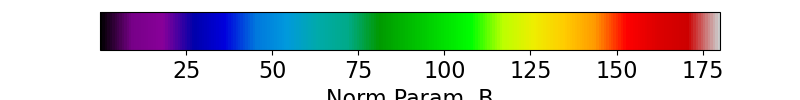

<IPython.core.display.Javascript object>


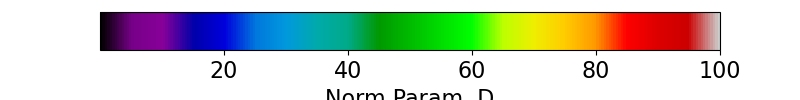

<IPython.core.display.Javascript object>


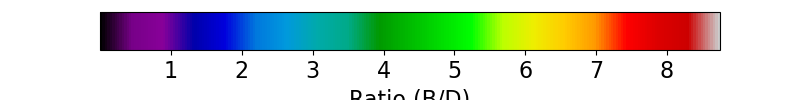

Started server on port 9528
-----


In [36]:
%matplotlib notebook
#visualize subject-specific ROIs and timeseries stats
#output FS-format polar angle and eccentricity maps for freeview ROI plotting
vis_res.output_freesurfer_maps = False
#compare t1w and surface fitting rsq and polar angle maps
vis_res.compare_volume_surface = False

vis_res.plot_rois_cortex = False
vis_res.plot_stats_cortex = False
vis_res.plot_rsq_cortex = False
vis_res.plot_ecc_cortex = False
vis_res.plot_polar_cortex = False
vis_res.plot_size_cortex = False
vis_res.plot_amp_cortex = False
vis_res.plot_css_exp_cortex = False
vis_res.plot_surround_size_cortex = False
vis_res.plot_suppression_index_cortex = False
vis_res.plot_norm_baselines_cortex = True
vis_res.plot_size_ratio_cortex = False
vis_res.plot_receptors_cortex = False
#set these to None if not wanted. 
vis_res.plot_correlations_per_roi = None#{'x_params_topl':['Norm Param. B'], 'y_params_topl':['Receptor Maps'],
                                    # 'x_params_lowl':['Norm_abcd'], 'y_params_lowl':['GABA'],
                                    # 'atlas':'glasser'} #glasser, HCPQ1Q6, custom
#note there is no quantile exclusion here, so the means may suffer from extreme values. just a visualization tool; use the quant_plots if want to be sure
vis_res.plot_means_per_roi = None# {'y_params_topl':['Norm Param. B','Norm Param. D','Size ratio (sigma_2/sigma_1)'], 
                                 #   'y_params_lowl':['Norm_abcd'], 
                                 #    'atlas':'glasser'} #glasser, HCPQ1Q6, custom

rsq_thresh = 0.0
rsq_max_opacity = 0.2#rsq_thresh+1e-6
#change to 'all' to plot whole brain. string single ROI for single ROI
rois = 'Brain'#['custom.hV4']#'all'#['custom.hV4']#'['custom.hV4']#'all'#['custom.hV4']#'all'#['custom.V1', 'custom.V2', 'custom.V3']
space_names ='HCP'# 'fsnative'#'fsaverage'#'HCP'#
analysis_names = 'fit-task-all_fit-runs-all'#'fit-task-BAR_fit-runs-CVmedian'#'fit-task-2R_fit-runs-all'#'fit-task-4R_fit-runs-all'# #'Mean analysis'#
subject_ids = ['100610']#['fsaverage_hcp1sthalf','fsaverage_hcp2ndhalf']#['sub-006']##'all'#['sub-001']

threshold_li = 0# filters.threshold_li(vis_res.main_dict[space_names][analysis_names][subject_ids[0]]['Processed Results']['#Subjects with CVRSq>0']['Norm_abcd'])

vis_res.set_alpha(only_models=['Norm_abcd'], ecc_min=0.0, ecc_max=8.0, min_number_sjs=threshold_li)

vis_res.pycortex_plots(rois, rsq_thresh, space_names, analysis_names, subject_ids, rsq_max_opacity = rsq_max_opacity, pycortex_cmap = 'nipy_spectral',#'Jet_2D_alpha', #'nipy_spectral_2D_alpha' #Jet_2D_alpha                    
                       #pycortex_image_path = '/Volumes/Crucial X8/PRFMapping/Figures/pyc_surface_maps',
                       timecourse_folder = '/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/timecourses',#'/Volumes/Crucial X8/PRFMapping/PRFMapping-Deriv-hires/prfpy/FS7_results/timecourses',#'/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/timecourses',##'
                       screenshot_paths = ['/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/HCP_data/7T_RETBAR_small.hdf5'])
                                            #'/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/HCP_data/7T_RETBAR_small.hdf5'
                                            #'/Volumes/Crucial X8/PRFMapping/PRFMapping-Deriv-hires/prfpy/FS7_results/timecourses/task-2R_screenshots'

In [42]:
  vis_res.js_handle_dict[space_names][analysis_names][subject_ids[0]].keys()

dict_keys(['rsq', 'ecc', 'polar', 'size', 'amp', 'surround_size', 'norm_baselines', 'size_ratio', 'receptors'])

In [53]:
save_views=True
subj = subject_ids[0]
if save_views:
    #capture pycortex views
    #sub-006 camera coords 179 109 259 /// sub-007 183 126 250

    param_to_save = 'receptors'
    rec = '5-HT1B'
    js_handle_to_save = vis_res.js_handle_dict[space_names][analysis_names][subj][param_to_save]
    #js_handle_to_save._capture_view()
        
    base_str = f"{subj}_{param_to_save}_{rec}"#'_Norm-Neural baseline (B)'
    
    # views = dict(dorsal=dict(radius=191, altitude=73, azimuth=178, pivot=0),
    #              medial=dict(radius=10, altitude=101, azimuth=359, pivot=167),
    #              lateral=dict(radius=277, altitude=90, azimuth=177, pivot=123),
    #              ventral=dict(radius=221, altitude=131, azimuth=175, pivot=0)
    #                     )
    
    if subj == 'sub-007':
        views = dict(occipital=dict(azimuth=183, altitude=126, radius=250, pivot=0))
    elif subj == 'sub-006':
        views = dict(occipital=dict(azimuth=179, altitude=109, radius=259, pivot=0))
        
    views = dict(flat=dict(pivot=180, radius=150, azimuth=180, altitude=0.1, target=[0,-100,0], 
                                  specularity=0))

    vis_res.save_pycortex_views(js_handle_to_save, base_str, views, image_path = vis_res.pycortex_image_path)
        

{'surface.{subject}.pivot': [180], 'camera.radius': [150], 'camera.azimuth': [180], 'camera.altitude': [0.1], 'camera.target': [0, -100, 0], 'surface.{subject}.specularity': [0], 'surface.{subject}.unfold': [1]}


<IPython.core.display.Javascript object>


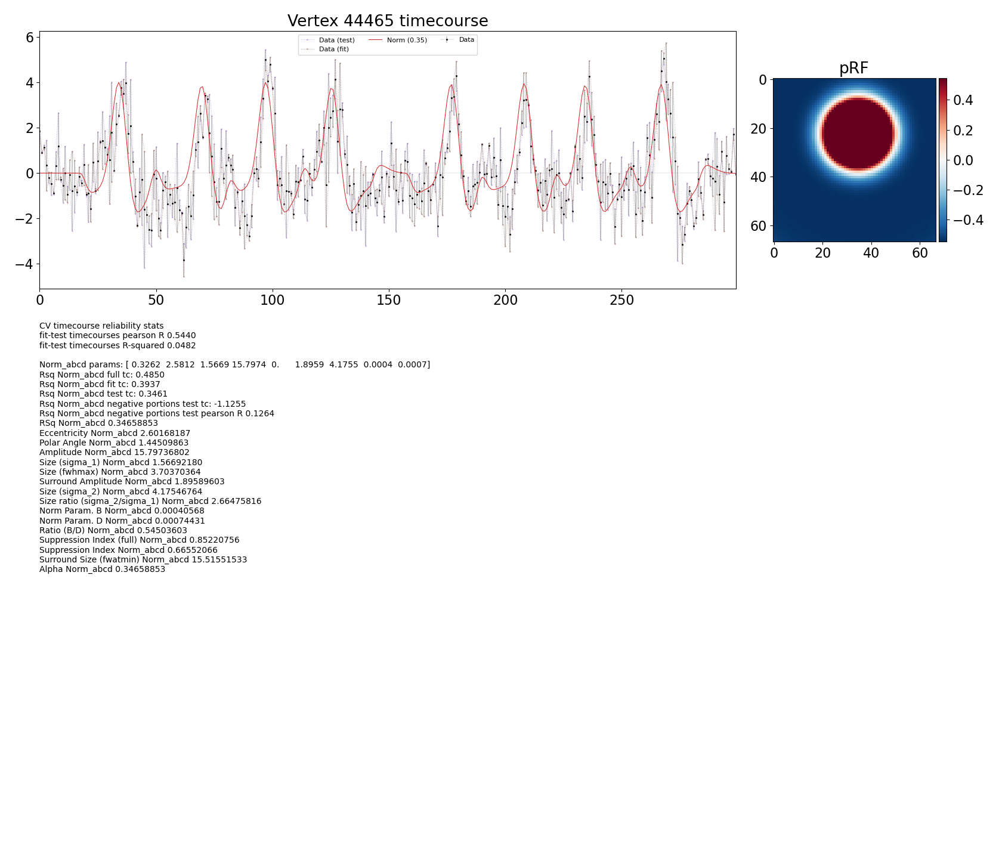

In [32]:
vis_res.f

# 1D quantitative plots

In [9]:
%%capture
pl.close('all')
display(HTML("<style>div.output_scroll { height: 50em; }</style>"))
#generalized quantitative parameter plots
#'Eccentricity'#'Suppression Index (full)'#'Suppression Index#'Size (fwhmax)'#'Surround Size (fwatmin)'
#'Norm Param. B'#''Ratio (B/D)'#'Norm Param. D'#'RSq'#'CCrsq_task-1R'#'CSS Exponent'#'Amplitude'
#'Surround Amplitude'#'Size (sigma_1)'##'Size (sigma_2)'
#'Size ratio (sigma_2/sigma_1)'#C/A#'B/A'#'D/C'#'D/A'#'B/C'#'Surround volume (full)'#'Centre volume (full)'
#'(A+B)/(C+D)'#'(A*B)/(C*D)'#'(A*D)/(C*B)'#'(A+D)/(C+B)'#'Point-stim derivative'#'(C(A+B))/(A(C+D))'
#'Min/Max Response Ratio'#'Max/Min Response Ratio'#'A(C+D)/C(A+B)'##Min/Max Response Ratio (with BD)'#'A/C'
#D/B#D*sigma_2/sigma_1#(D*sigma_2)/(B*sigma_1)#'(AD-BC)/D**2 (deriv at 0)'#(Cs_2**2+D)/(As_1**2+B)
#(B*sigma_1)/(D*sigma_2)##B/D**2#'B/sqrt(D)'#'B(1/(Cpis_2**2+D)-1/D)'
####DoG
#'Surround volume (full)'#'Surround/Centre Amplitude' #'Surround-Centre Amplitude'#'Surround-Centre Volume'
#'Timecourse Neg/Pos Area Ratio'
#['GABA_A','5-HTT', '5-HT2A', '5-HT1A', '5-HT1B', '5-HT4']


#'custom.V1', 'custom.V2', 'custom.V3','custom.V3AB','custom.hV4','custom.LO','custom.TO','custom.VO','custom.IPS'
#combined all_custom Brain
#rois = ['custom.V1', 'custom.V2', 'custom.V3','custom.V3AB','custom.hV4','custom.LO','custom.TO','custom.VO','custom.IPS']
#rois = [ 'V1', 'V2', 'V3', 'hV4', 'VO1', 'VO2', 'PHC1', 'PHC2', 'TO1', 'TO2', 'LO1', 'LO2', 'V3A', 'V3B', 'IPS0', 'IPS1', 'IPS2', 'IPS3', 'IPS4', 'IPS5', 'SPL1', 'FEF', 'combined']

#rois = ['all_custom']
#rois = ['HCPQ1Q6.V1', 'HCPQ1Q6.V2', 'HCPQ1Q6.V3', 'HCPQ1Q6.V3AB',# 'HCPQ1Q6.V3B', 
#        'HCPQ1Q6.LO', 'HCPQ1Q6.V7','HCPQ1Q6.TO',
#        'HCPQ1Q6.IPS1']

rsq_thresh = 0.3 #0.3
save_figures = True
figure_path = '/Volumes/Crucial X8/PRFMapping/Figures/'

#set to 'all' to plot all analyses
space_names = 'fsnative'
analysis_names = 'all'#'fit-task-2R_fit-runs-all'#'all'#'fit-task-4R_fit-runs-all'#'fit-task-2R_fit-runs-all'#'all'#,
subject_ids = 'all'#['sub-006']#'all'#

vis_res.set_alpha(only_models=['Norm_abcd'], ecc_min=0, ecc_max=4.5)

ylim={}
xlim={}

#set model/roi specific x-y limitd

#ylim = {'Mean':(1.5,14), 'Norm_abcd':(1.5,14), 'Gauss':(1.5,14), 'CSS':(1.5,14), 'DoG':(1.5,14)}
#xlim = {'Gauss':(0,4.5), 'DoG':(0,4.5), 'CSS':(0,4.5), 'Norm_abcd':(0,4.5)}
#dog rsq
#ylim = {'Norm_abcd':(-5,310)}
#xlim = {'Norm_abcd':(-0.005,0.155)}
#dog tcsi
#xlim = {'Norm_abcd':(-0.02,1.33)}
#for r in rois:
    #xlim[r] = xlim['Norm_abcd']
    #ylim[r] = ylim['Norm_abcd']
    #size ratio
#xlim = {'Norm_abcd':(-0.02,0.8)}
#ylim = {'Mean':(0,66)} #dmean
#ylim = {'Mean':(0,111)} #bmean
#ylim = {'Mean':(0,13)} #sratiomean
#         if r in ['custom.V1', 'custom.V2', 'custom.V3']:
#             ylim[r] = (1.5,14)
#         elif r in ['custom.V3AB', 'custom.hV4', 'custom.LO']:
#             ylim[r] = (1.5,14)
#         else:
#             ylim[r] = (1.5,14)
#x_parameter = 'Eccentricity'
#y_parameter = 'Size ratio (sigma_2/sigma_1)'
    
#bin_by: 'size' (x-param bins have the same number of vertices) or 'space' (x-param bins are approx equally spaced) space is useful for clustered parameters)
for x_parameter in ['Eccentricity']:
    for y_parameter in ['B/C', 'D/C', 'B/A', 'D/A']:
        if x_parameter != y_parameter:
            vis_res.quant_plots(x_parameter, y_parameter, rois, rsq_thresh, save_figures, figure_path,
                                        space_names, analysis_names, subject_ids,
                                         #y_parameter_toplevel='Receptor Maps',
                                        diff_gauss=False, diff_gauss_x=False, 
                                        log_yaxis=False, log_xaxis = False, nr_bins = 8, bin_by='size', rsq_weights=True,
                                        scatter=False, violin=False, stats_on_plot=False, means_only=True, zconfint_err_alpha=None,
                                        xlim=xlim, ylim=ylim, zscore_xdata=False, zscore_ydata=False,
                                        each_subj_on_group=True, bold_voxel_volume=4.8270, # x_param_model='DoG',
                                        quantile_exclusion=0.999) #zconfint_err_alpha=0.05

os.system(f"open {sound_file}")


In [54]:
%%capture capt
pl.close('all')
display(HTML("<style>div.output_scroll { height: 50em; }</style>"))
#generalized quantitative parameter plots
#'Eccentricity'#'Suppression Index (full)'#'Suppression Index#'Size (fwhmax)'#'Surround Size (fwatmin)'
#'Norm Param. B'#''Ratio (B/D)'#'Norm Param. D'#'RSq'#'CCrsq_task-1R'#'CSS Exponent'#'Amplitude'
#'Surround Amplitude'#'Size (sigma_1)'##'Size (sigma_2)'
#'Size ratio (sigma_2/sigma_1)'#C/A#'B/A'#'D/C'#'D/A'#'B/C'#'Surround volume (full)'#'Centre volume (full)'
#'(A+B)/(C+D)'#'(A*B)/(C*D)'#'(A*D)/(C*B)'#'(A+D)/(C+B)'#'Point-stim derivative'#'(C(A+B))/(A(C+D))'
#'Min/Max Response Ratio'#'Max/Min Response Ratio'#'A(C+D)/C(A+B)'##Min/Max Response Ratio (with BD)'#'A/C'
#D/B#D*sigma_2/sigma_1#(D*sigma_2)/(B*sigma_1)#'(AD-BC)/D**2 (deriv at 0)'#(Cs_2**2+D)/(As_1**2+B)
#(B*sigma_1)/(D*sigma_2)##B/D**2#'B/sqrt(D)'#'B(1/(Cpis_2**2+D)-1/D)'
####DoG
#'Surround volume (full)'#'Surround/Centre Amplitude' #'Surround-Centre Amplitude'#'Surround-Centre Volume'
#'Timecourse Neg/Pos Area Ratio'
#['GABA_A','5-HTT', '5-HT2A', '5-HT1A', '5-HT1B', '5-HT4']


#'custom.V1', 'custom.V2', 'custom.V3','custom.V3AB','custom.hV4','custom.LO','custom.TO','custom.VO','custom.IPS'
#combined all_custom Brain
#rois = ['custom.V1', 'custom.V2', 'custom.V3','custom.V3AB','custom.hV4','custom.LO','custom.TO','custom.IPS','all_custom']
rois = [roi for roi in vis_res.idx_rois['fsaverage'] if 'glasser' in roi]#[-20:]#['V1','V2', 'V3','V3AB','hV4','LO','TO','VO','IPS'] #fsaverage
#rois = [ 'V1', 'V2', 'V3', 'hV4', 'VO1', 'VO2', 'PHC1', 'PHC2', 'LO1', 'LO2', 'TO1', 'TO2', 'V3A', 'V3B', 'IPS0', 'IPS1', 'IPS2', 'IPS3', 'IPS4', 'IPS5', 'SPL1', 'FEF']
# rois = ['glasser_V1','glasser_V2','glasser_V3','glasser_V4','glasser_V3A','glasser_V7','glasser_V3B','glasser_V3CD',
# 'glasser_LO1','glasser_LO2','glasser_PIT','glasser_V8','glasser_VMV3',
# 'glasser_IPS1','glasser_IP0','glasser_PGp','glasser_LO3','glasser_MT','glasser_V4t','glasser_FFC','combined']
#rois = ['V1','V2', 'V3','V3AB','hV4','LO','TO','VO','IPS','combined']
#rois = ['all_custom']
#rois = ['HCPQ1Q6.V1', 'HCPQ1Q6.V2', 'HCPQ1Q6.V3', 'HCPQ1Q6.V3AB',
#        'HCPQ1Q6.LO', 'HCPQ1Q6.V7','HCPQ1Q6.TO',
#        'HCPQ1Q6.IPS1']
#rois.append('combined')

rsq_thresh = 0.0 #0.3
save_figures = True
figure_path = f"/Volumes/Crucial X8/PRFMapping/Figures/glasser_ecc65_CVrsqmean_li_legend"

#set to 'all' to plot all analyses
space_names = 'fsaverage'
analysis_names = 'fit-task-BAR_fit-runs-all'#'all'#, -CVmedian
subject_ids = ['fsaverage_cvrsq']#['fsaverage']#['sub-001','sub-002','sub-006']#

threshold_li = filters.threshold_li(vis_res.main_dict[space_names][analysis_names][subject_ids[0]]['Processed Results']['#Subjects with CVRSq>0']['Norm_abcd'])

vis_res.set_alpha(only_models=['Norm_abcd'], ecc_min=0.0, ecc_max=8.0, min_number_sjs=threshold_li)

ylim={}
xlim={}

#set model/roi specific x-y limitd

#ylim = {'Mean':(1.5,14), 'Norm_abcd':(1.5,14), 'Gauss':(1.5,14), 'CSS':(1.5,14), 'DoG':(1.5,14)}
#xlim = {'Gauss':(0,4.5), 'DoG':(0,4.5), 'CSS':(0,4.5), 'Norm_abcd':(0,4.5)}
#dog rsq
#ylim = {'Norm_abcd':(-5,310)}
#xlim = {'Norm_abcd':(-0.005,0.155)}
#dog tcsi
#xlim = {'Norm_abcd':(-0.02,1.33)}
#for r in rois:
    #xlim[r] = xlim['Norm_abcd']
    #ylim[r] = ylim['Norm_abcd']
    #size ratio
#xlim = {'Norm_abcd':(-0.02,0.8)}
#ylim = {'Norm_abcd':(2,11)}

#         if r in ['custom.V1', 'custom.V2', 'custom.V3']:
#             ylim[r] = (1.5,14)
#         elif r in ['custom.V3AB', 'custom.hV4', 'custom.LO']:
#             ylim[r] = (1.5,14)
#         else:
#             ylim[r] = (1.5,14)

for x_parameter in ['5-HT1A', 'GABA_A']: #'5-HT1B', '5-HT2A']:#
    for y_parameter in ['Norm Param. B']:#'Norm Param. D']:#@
        
#         ylim = {'Norm_abcd':(-2,92)}
#         if x_parameter == 'GABA_A':
#             xlim = {'Norm_abcd':(760,1080)}
#         else:
#             xlim = {'Norm_abcd':(11,50)}
               
        #bin_by: 'size' (x-param bins have the same number of vertices) or 'space' (x-param bins are approx equally spaced) space is useful for clustered parameters)
        vis_res.quant_plots(x_parameter, y_parameter, rois, rsq_thresh, save_figures, figure_path,
                                        space_names, analysis_names, subject_ids,
                                        x_parameter_toplevel='Receptor Maps',  #y_parameter_toplevel='Receptor Maps',                                      
                                        diff_gauss=False, diff_gauss_x=False, 
                                        log_yaxis=False, log_xaxis = False, nr_bins = 1, bin_by='size', rsq_weights=True,
                                        scatter=False, violin=False, stats_on_plot=False, zconfint_err_alpha=None,
                                        xlim=xlim, ylim=ylim, zscore_xdata=False, zscore_ydata=False, 
                                         means_only=False, 
                                        rois_on_plot = True, rsq_alpha_plot = True,
                                        fit = False, exp_fit = False, show_legend = False, 
                                        each_subj_on_group=True, bold_voxel_volume=4.096,
                                        quantile_exclusion=0.999)#, x_param_model='DoG')

for x_parameter in ['5-HT1B', '5-HT2A']:#
    for y_parameter in ['Norm Param. D']:#@
#         ylim = {'Norm_abcd':(6,39)}
#         if x_parameter == '5-HT1B':
#             xlim = {'Norm_abcd':(12,31)}
#         else:
#             xlim = {'Norm_abcd':(40,68)}    
            
        #bin_by: 'size' (x-param bins have the same number of vertices) or 'space' (x-param bins are approx equally spaced) space is useful for clustered parameters)
        vis_res.quant_plots(x_parameter, y_parameter, rois, rsq_thresh, save_figures, figure_path,
                                        space_names, analysis_names, subject_ids,
                                        x_parameter_toplevel='Receptor Maps',  #y_parameter_toplevel='Receptor Maps',                                      
                                        diff_gauss=False, diff_gauss_x=False, 
                                        log_yaxis=False, log_xaxis = False, nr_bins = 1, bin_by='size', rsq_weights=True,
                                        scatter=False, violin=False, stats_on_plot=False, zconfint_err_alpha=None,
                                        xlim=xlim, ylim=ylim, zscore_xdata=False, zscore_ydata=False, 
                                         means_only=False, 
                                        rois_on_plot = True, rsq_alpha_plot = True,
                                        fit = False, exp_fit = False, show_legend = False, 
                                        each_subj_on_group=True, bold_voxel_volume=4.096,
                                        quantile_exclusion=0.999)#, x_param_model='DoG')

os.system(f"open {sound_file}")


# Multidimensional analyses

## OLS

HCP fit-task-BAR_fit-runs-all 100610
HCP fit-task-BAR_fit-runs-all 102311
HCP fit-task-BAR_fit-runs-all 102816
HCP fit-task-BAR_fit-runs-all 104416
HCP fit-task-BAR_fit-runs-all 105923
HCP fit-task-BAR_fit-runs-all 108323
HCP fit-task-BAR_fit-runs-all 109123
HCP fit-task-BAR_fit-runs-all 111312
HCP fit-task-BAR_fit-runs-all 111514
HCP fit-task-BAR_fit-runs-all 114823
HCP fit-task-BAR_fit-runs-all 115017
HCP fit-task-BAR_fit-runs-all 115825
HCP fit-task-BAR_fit-runs-all 116726
HCP fit-task-BAR_fit-runs-all 118225
HCP fit-task-BAR_fit-runs-all 125525
HCP fit-task-BAR_fit-runs-all 126426
HCP fit-task-BAR_fit-runs-all 128935
HCP fit-task-BAR_fit-runs-all 130114
HCP fit-task-BAR_fit-runs-all 130518
HCP fit-task-BAR_fit-runs-all 131217
HCP fit-task-BAR_fit-runs-all 131722
HCP fit-task-BAR_fit-runs-all 132118
HCP fit-task-BAR_fit-runs-all 134627
HCP fit-task-BAR_fit-runs-all 134829
HCP fit-task-BAR_fit-runs-all 135124
HCP fit-task-BAR_fit-runs-all 137128
HCP fit-task-BAR_fit-runs-all 140117
H

fsaverage fit-task-BAR_fit-runs-all 249947
fsaverage fit-task-BAR_fit-runs-all 251833
fsaverage fit-task-BAR_fit-runs-all 257845
fsaverage fit-task-BAR_fit-runs-all 263436
fsaverage fit-task-BAR_fit-runs-all 283543
fsaverage fit-task-BAR_fit-runs-all 318637
fsaverage fit-task-BAR_fit-runs-all 320826
fsaverage fit-task-BAR_fit-runs-all 330324
fsaverage fit-task-BAR_fit-runs-all 346137
fsaverage fit-task-BAR_fit-runs-all 352738
fsaverage fit-task-BAR_fit-runs-all 360030
fsaverage fit-task-BAR_fit-runs-all 365343
fsaverage fit-task-BAR_fit-runs-all 380036
fsaverage fit-task-BAR_fit-runs-all 381038
fsaverage fit-task-BAR_fit-runs-all 385046
fsaverage fit-task-BAR_fit-runs-all 389357
fsaverage fit-task-BAR_fit-runs-all 393247
fsaverage fit-task-BAR_fit-runs-all 395756
fsaverage fit-task-BAR_fit-runs-all 397760
fsaverage fit-task-BAR_fit-runs-all 401422
fsaverage fit-task-BAR_fit-runs-all 406836
fsaverage fit-task-BAR_fit-runs-all 412528
fsaverage fit-task-BAR_fit-runs-all 429040
fsaverage f

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimen

<IPython.core.display.Javascript object>


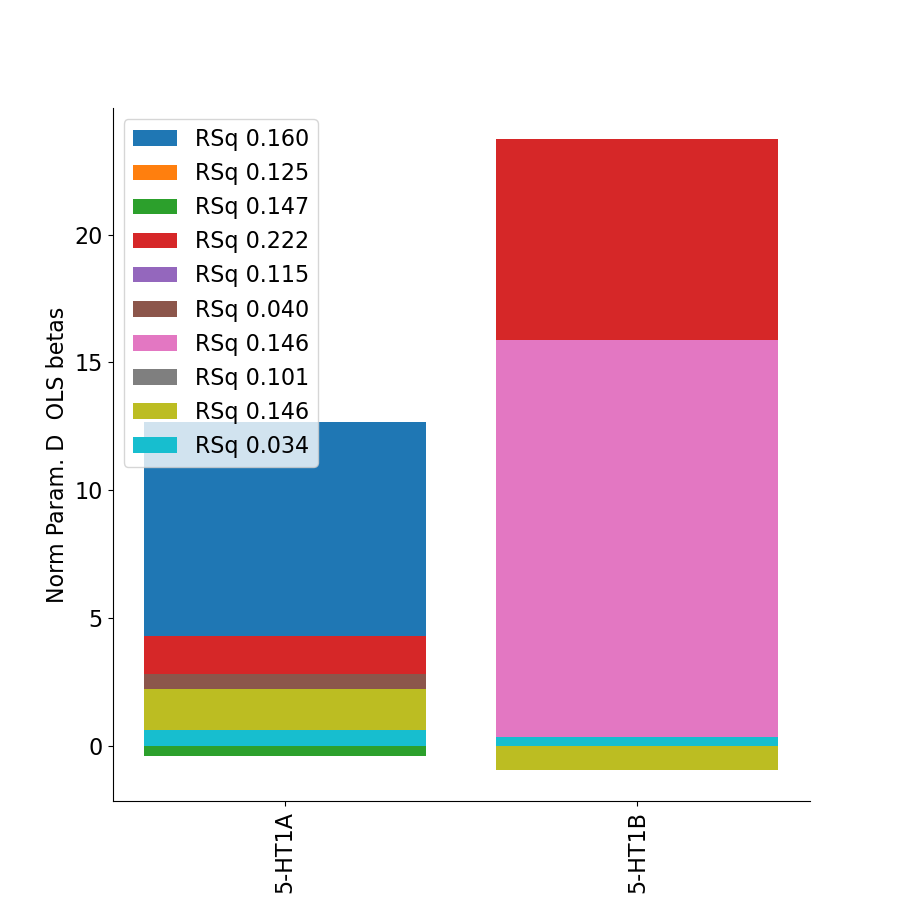

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_23c
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 264
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 9.1438 -0.0336]
wRSq 0.12197286111676398
wCC prediction 0.3492461325723796


<IPython.core.display.Javascript object>


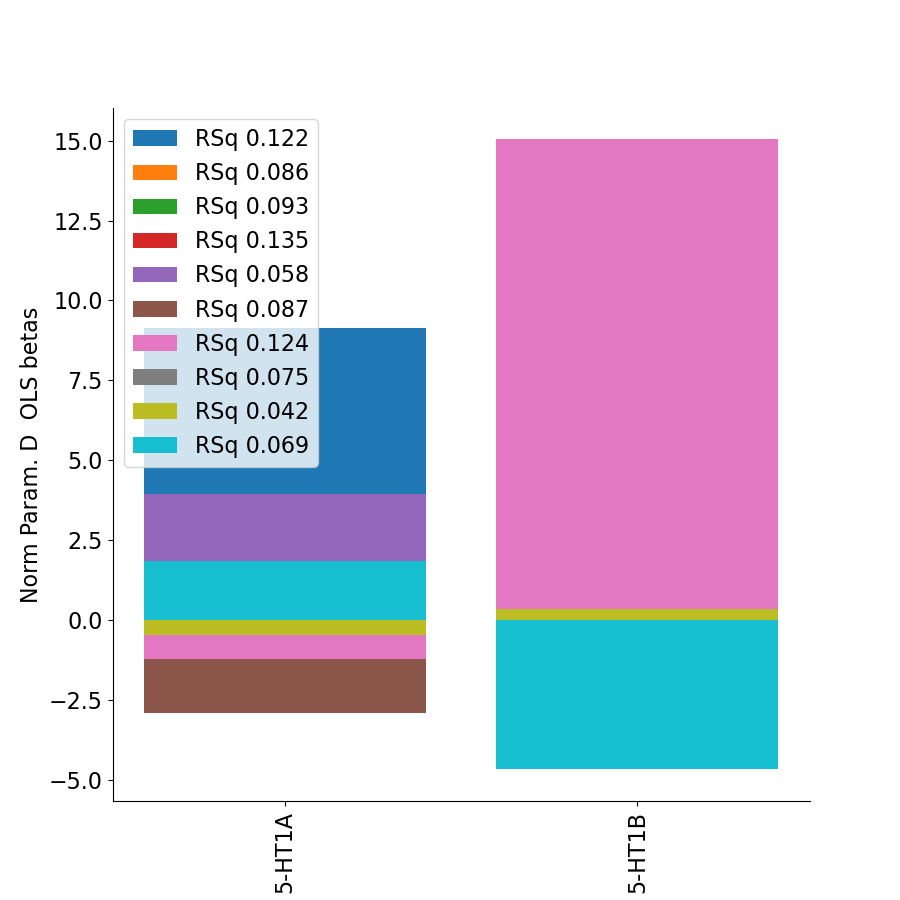

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_23d
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_24dd
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_24dv
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq gl

<IPython.core.display.Javascript object>


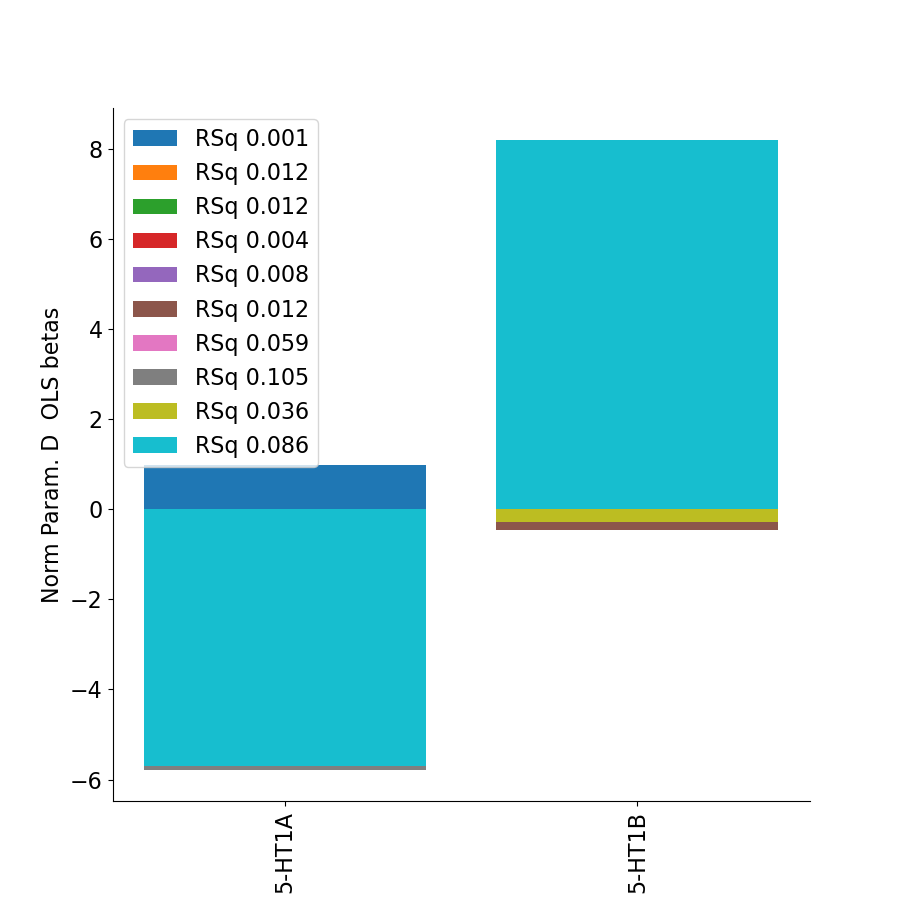

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_47l
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_47m
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_47s
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glas

<IPython.core.display.Javascript object>


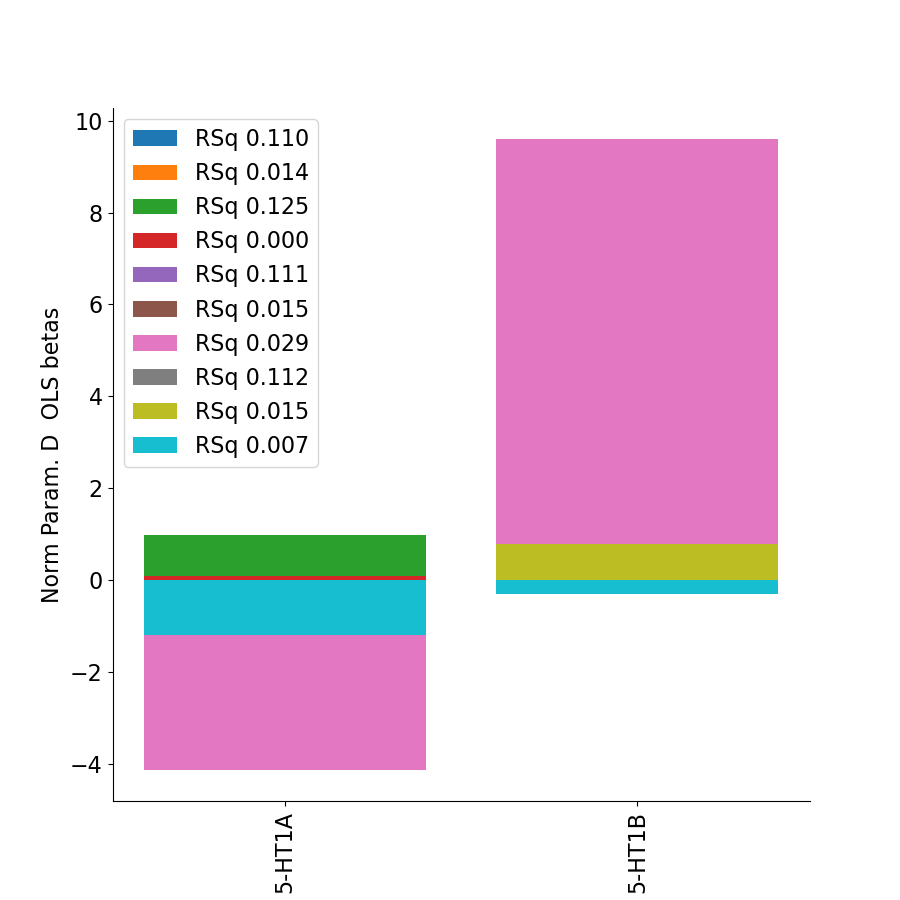

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_5m
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_5mv
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 370
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [6.653  0.0119]
wRSq 0.21412525999512355
wCC prediction 0.4627367069891078


<IPython.core.display.Javascript object>


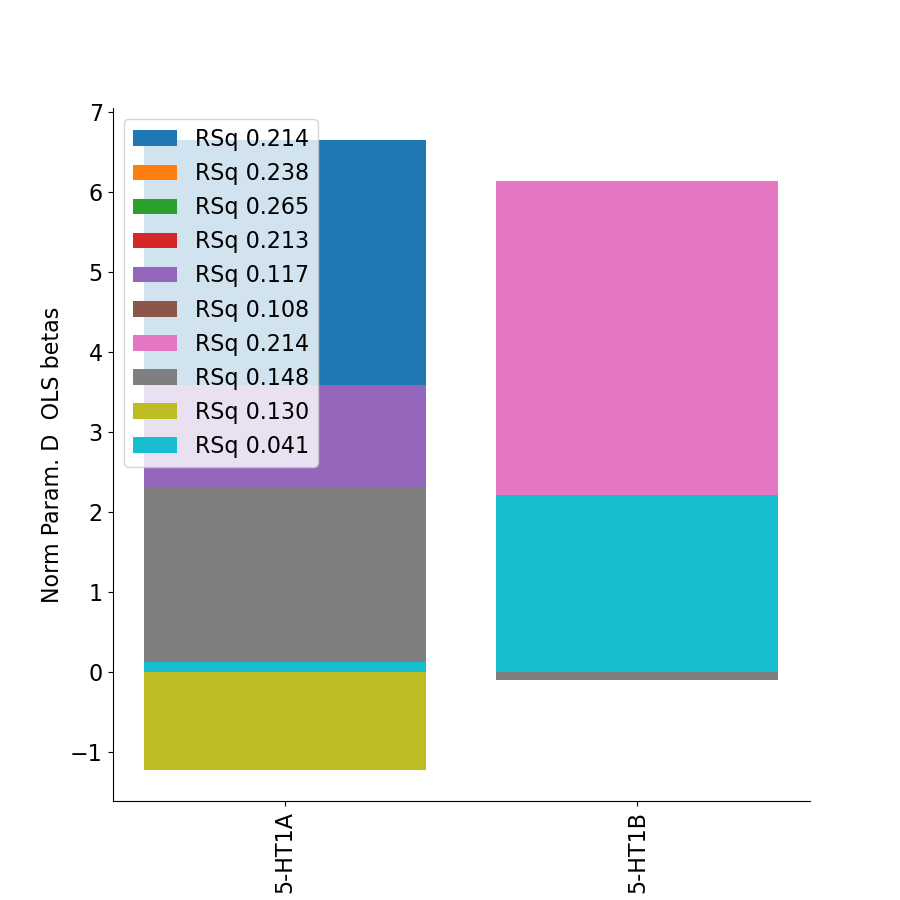

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_6a
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 2974
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [0.4768 0.0249]
wRSq 0.020199838032521344
wCC prediction 0.1421261342347756


<IPython.core.display.Javascript object>


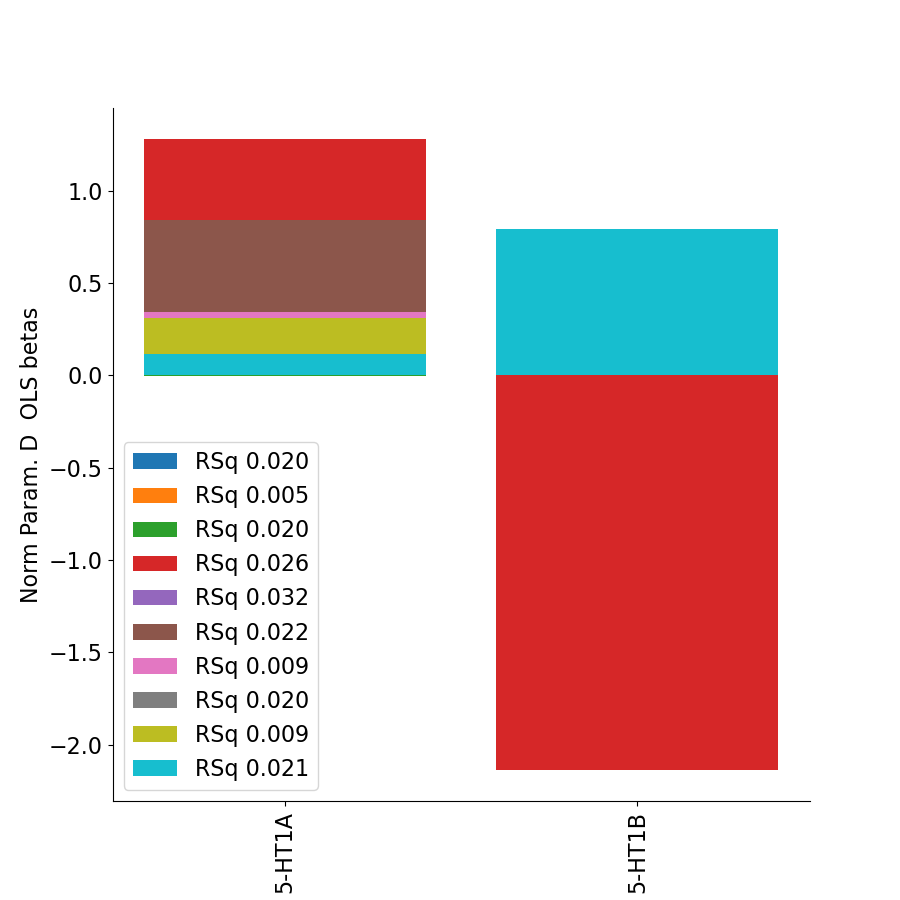

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_6d
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 153
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [31.5767 -0.116 ]
wRSq 0.27465005240965057
wCC prediction 0.5240706559326237


<IPython.core.display.Javascript object>


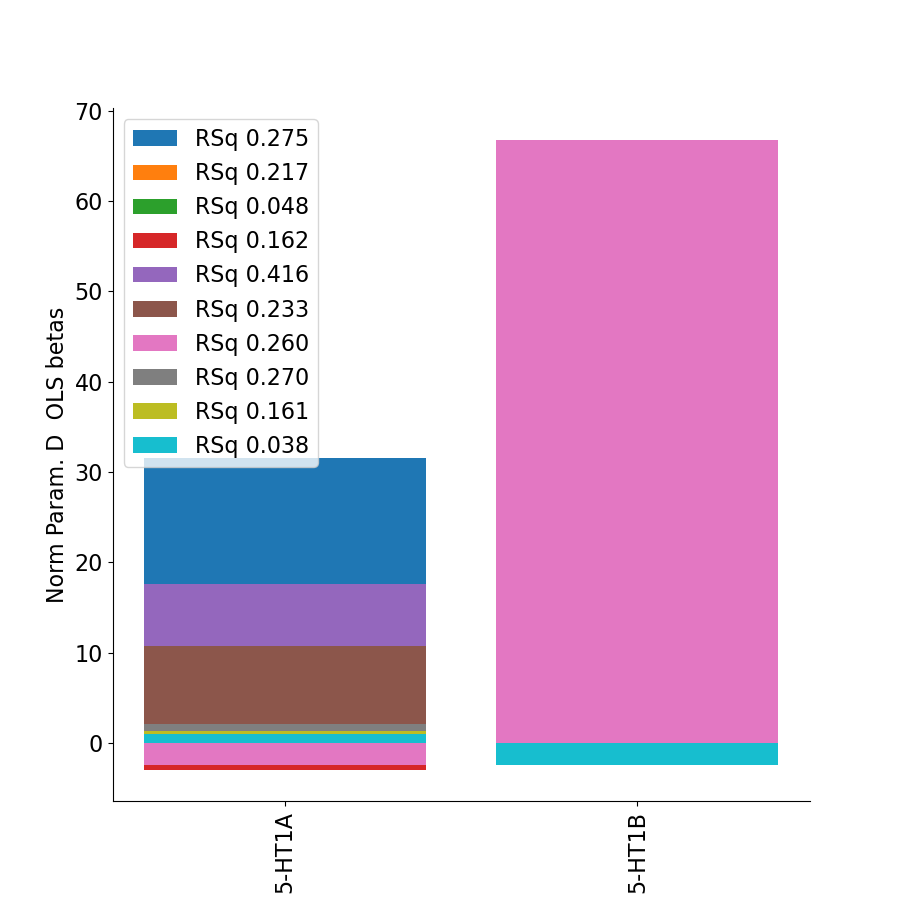

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_6ma
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 490
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-0.83    0.0531]
wRSq 0.036674765272377785
wCC prediction 0.19150656717819847


<IPython.core.display.Javascript object>


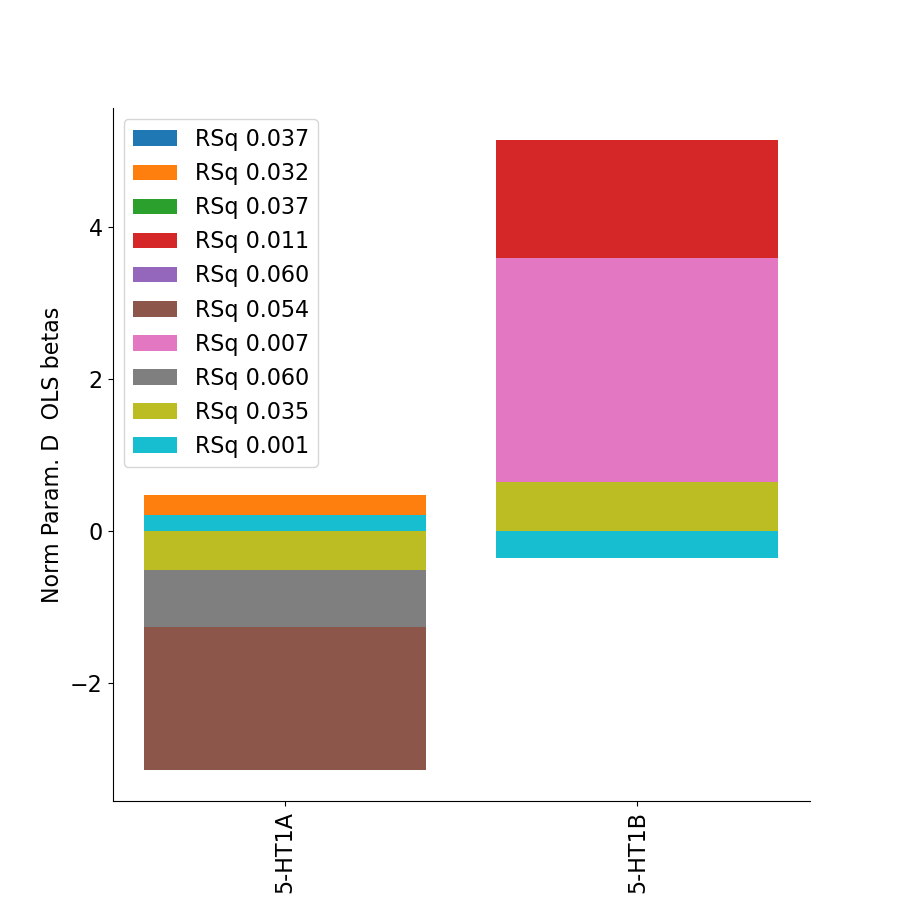

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_6mp
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 96
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [22.3974  0.1143]
wRSq 0.11990431685994962
wCC prediction 0.34627202725595574


<IPython.core.display.Javascript object>


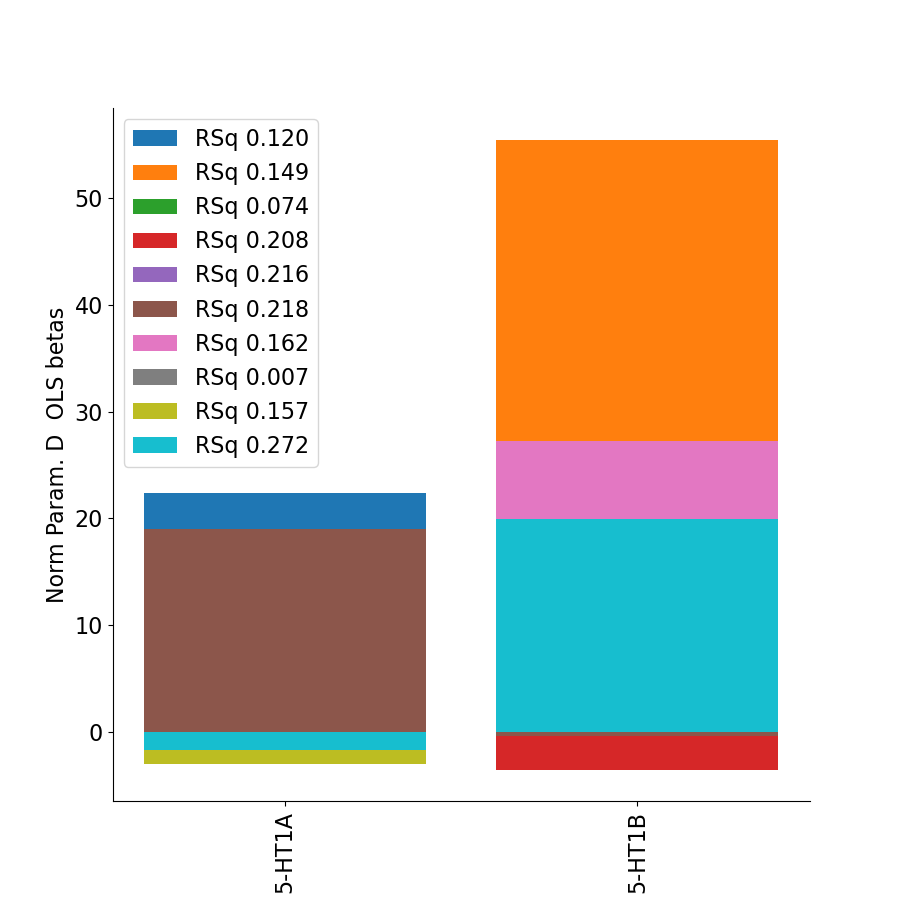

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_6r
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 612
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 7.0176 -0.0945]
wRSq 0.12425172445663513
wCC prediction 0.35249358073110343


<IPython.core.display.Javascript object>


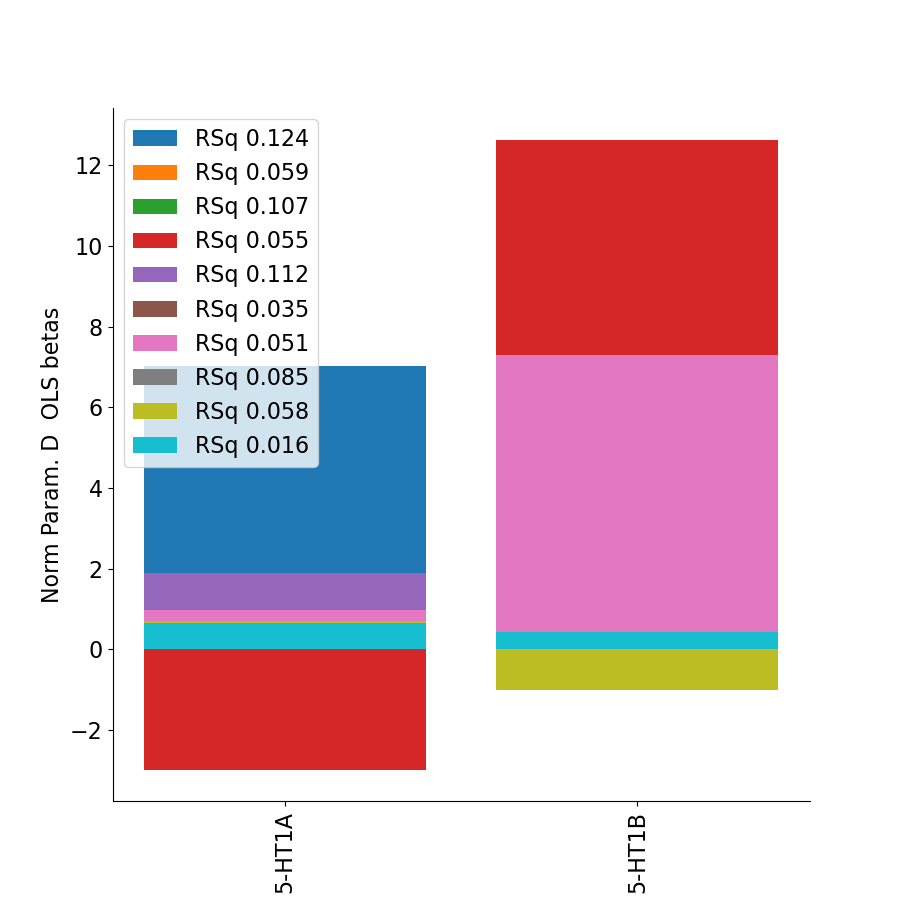

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_6v
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 459
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-0.8327 -0.079 ]
wRSq 0.08319284649809588
wCC prediction 0.2884317016177241


<IPython.core.display.Javascript object>


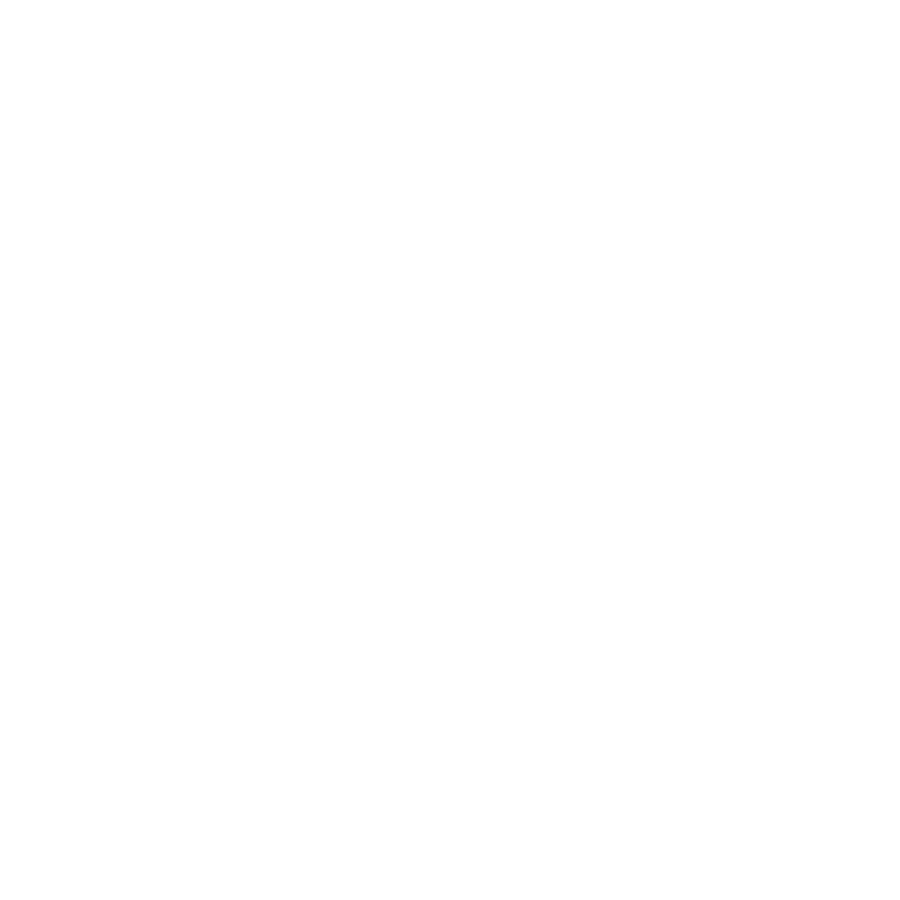

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_7AL
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1214
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 4.0211 -0.0357]
wRSq 0.024721081883051332
wCC prediction 0.1572293925544815


<IPython.core.display.Javascript object>


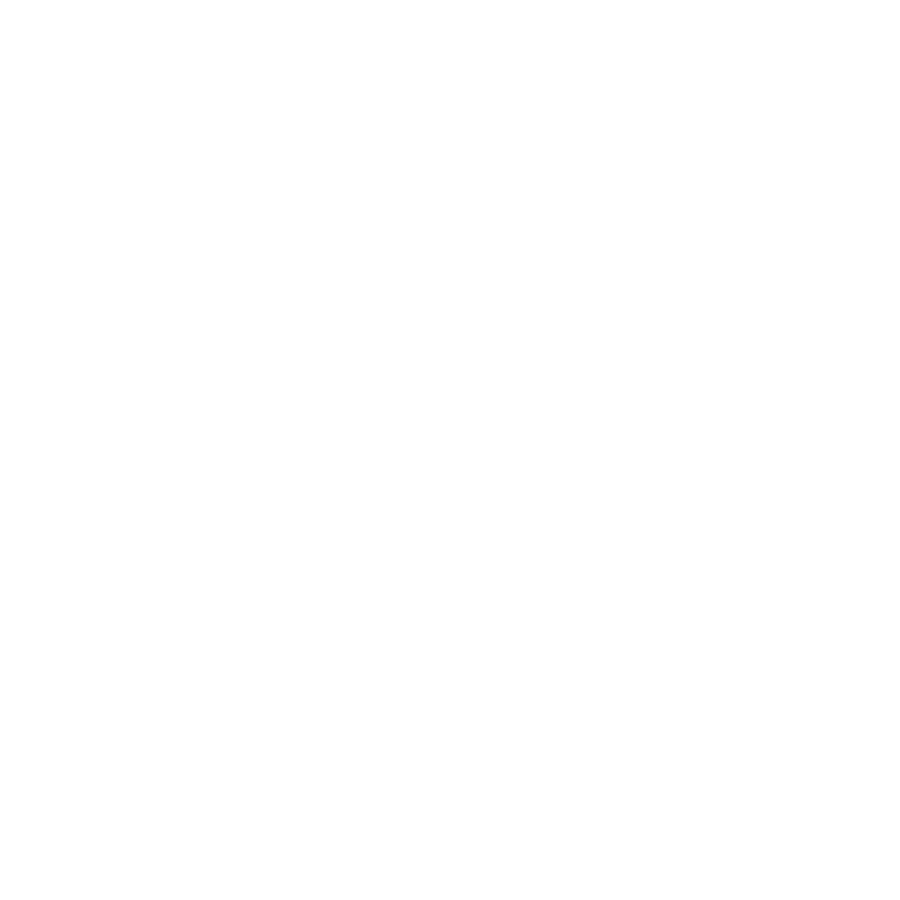

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_7Am
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1679
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-3.6662  0.0427]
wRSq 0.029511938341873045
wCC prediction 0.17179039071459423


<IPython.core.display.Javascript object>


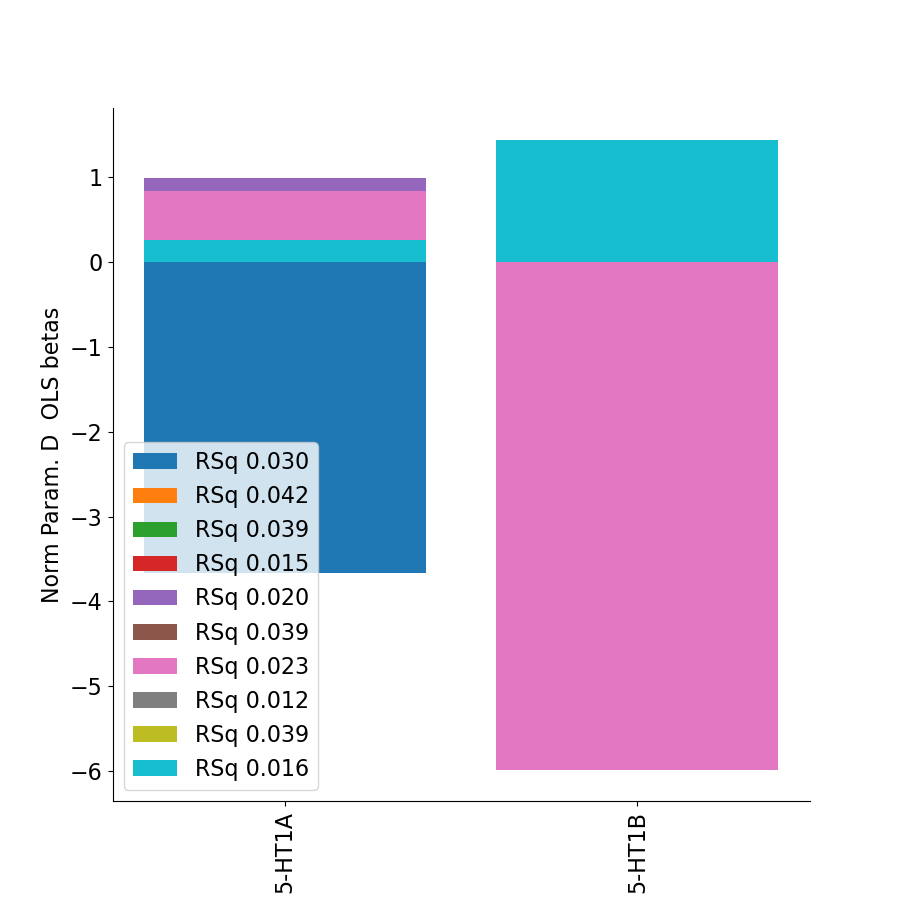

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_7m
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_7PC
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1502
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [3.3344 0.0122]
wRSq 0.04440927343362577
wCC prediction 0.2107350787923691


<IPython.core.display.Javascript object>


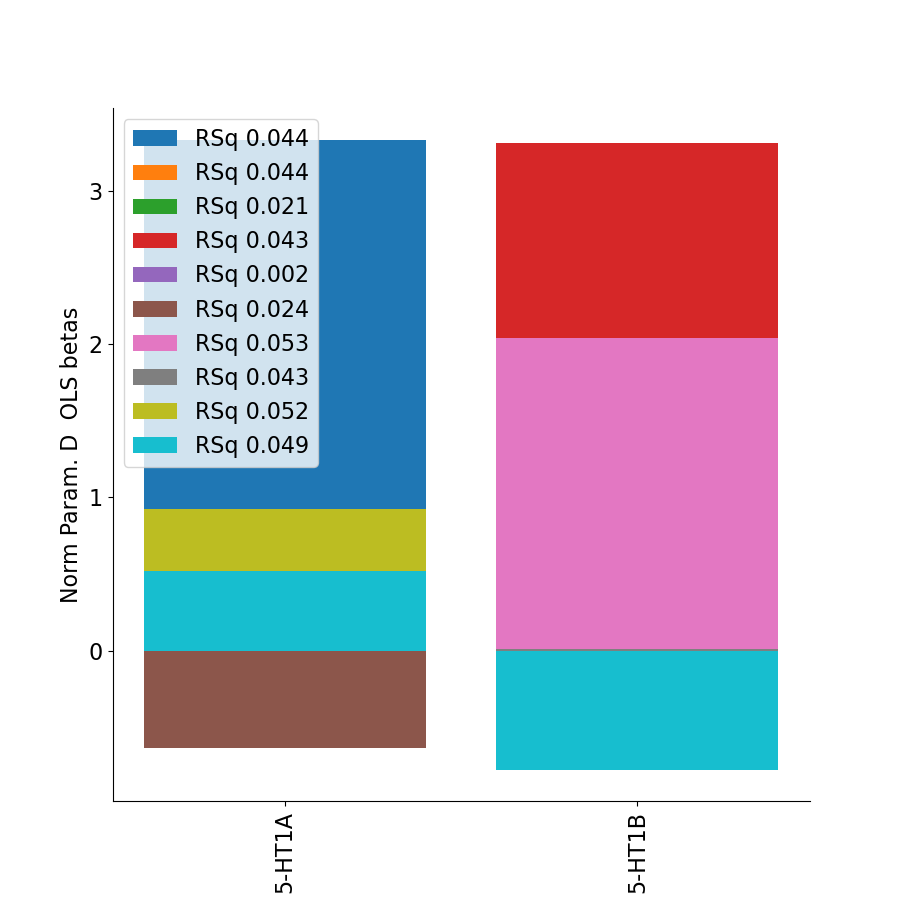

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_7PL
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 905
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [14.4167 -0.1186]
wRSq 0.06354473562929785
wCC prediction 0.2520808117039013


<IPython.core.display.Javascript object>


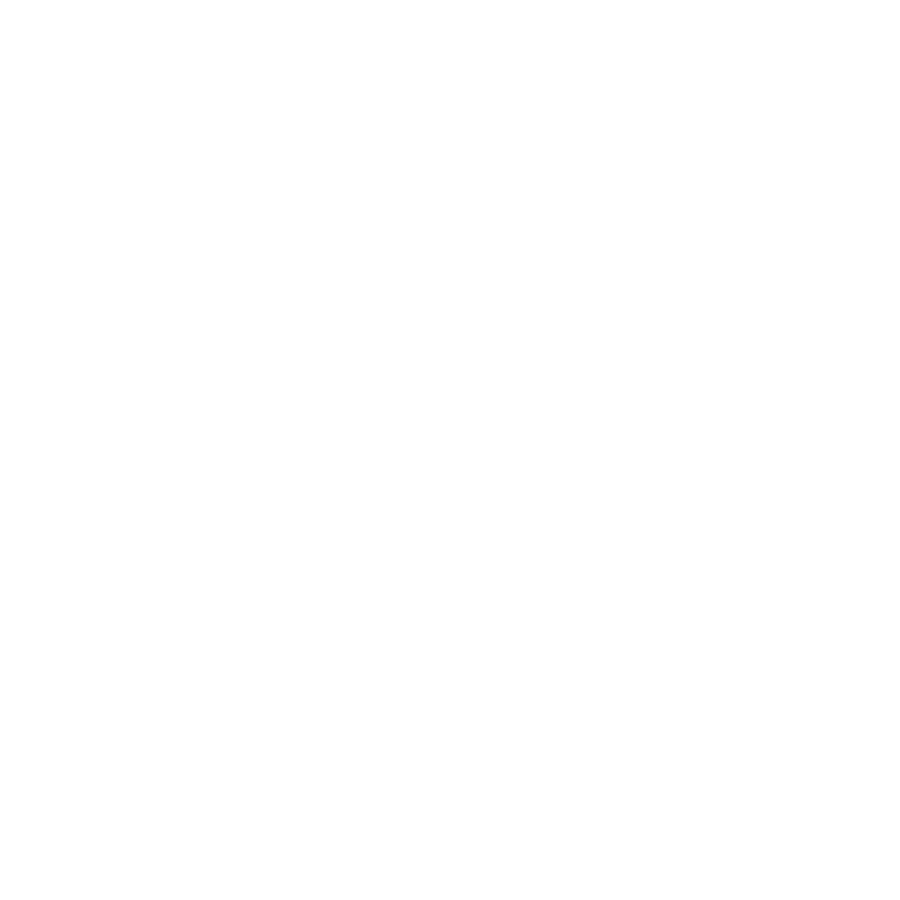

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_7Pm
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 200
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [4.0539 0.1075]
wRSq 0.06863334165918278
wCC prediction 0.2619796588653073


<IPython.core.display.Javascript object>


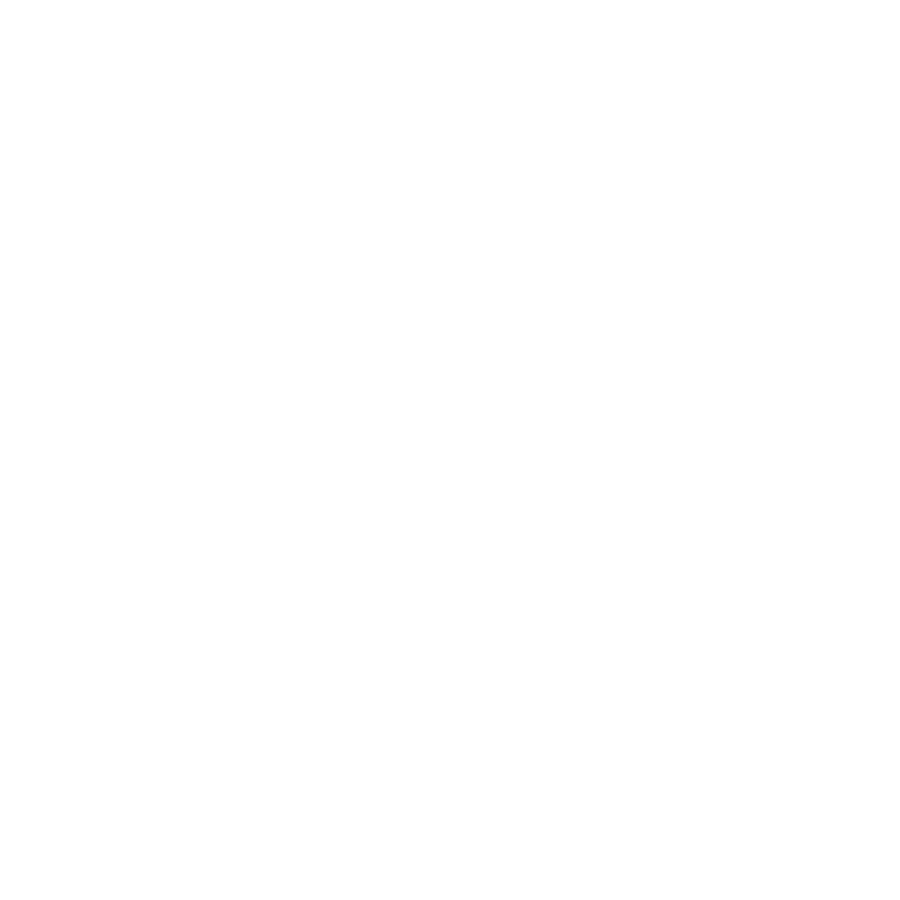

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_8Ad
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_8Av
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_8BL
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glas

<IPython.core.display.Javascript object>


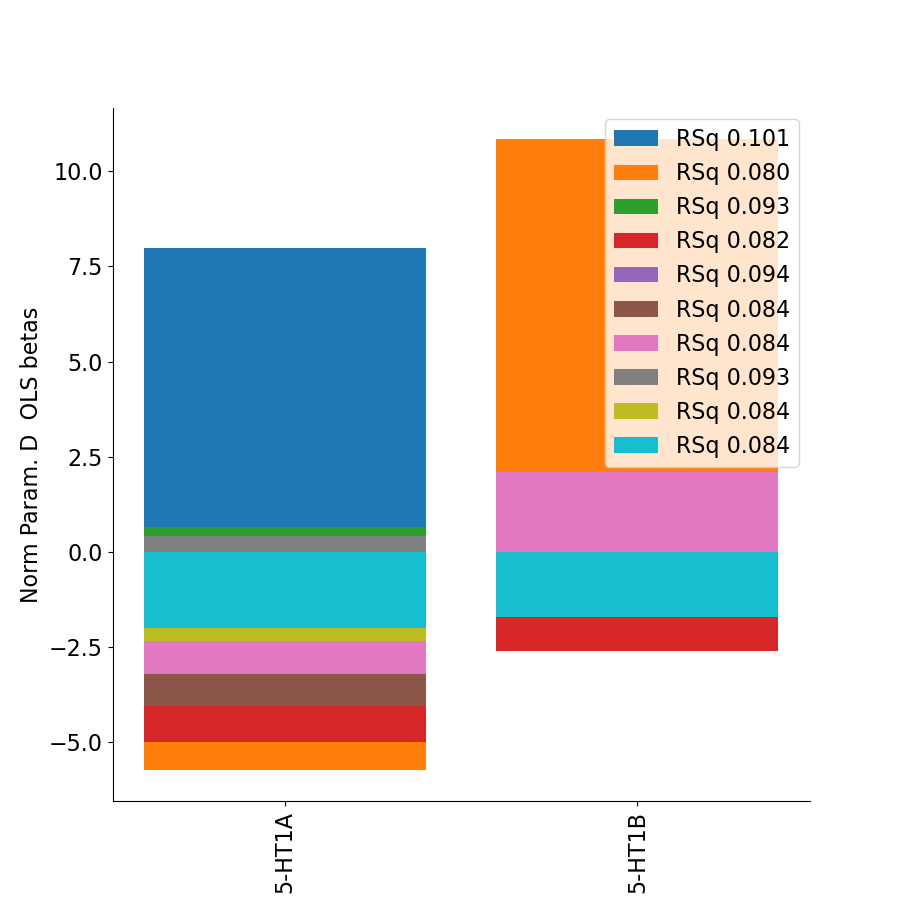

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_8C
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 8
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_9-46d
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 32
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [24.5723 -0.1655]
wRSq 0.21855159479639164
wCC prediction 0.4674950211460993


<IPython.core.display.Javascript object>


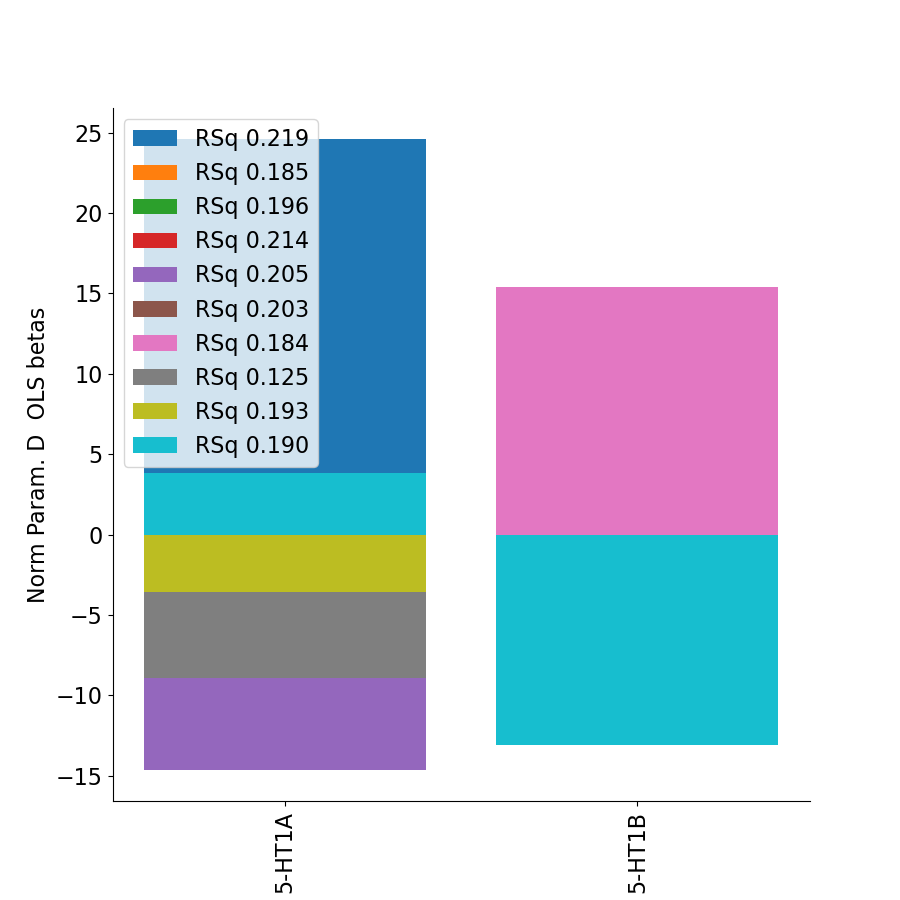

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_9a
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_9m
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_9p
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser

<IPython.core.display.Javascript object>


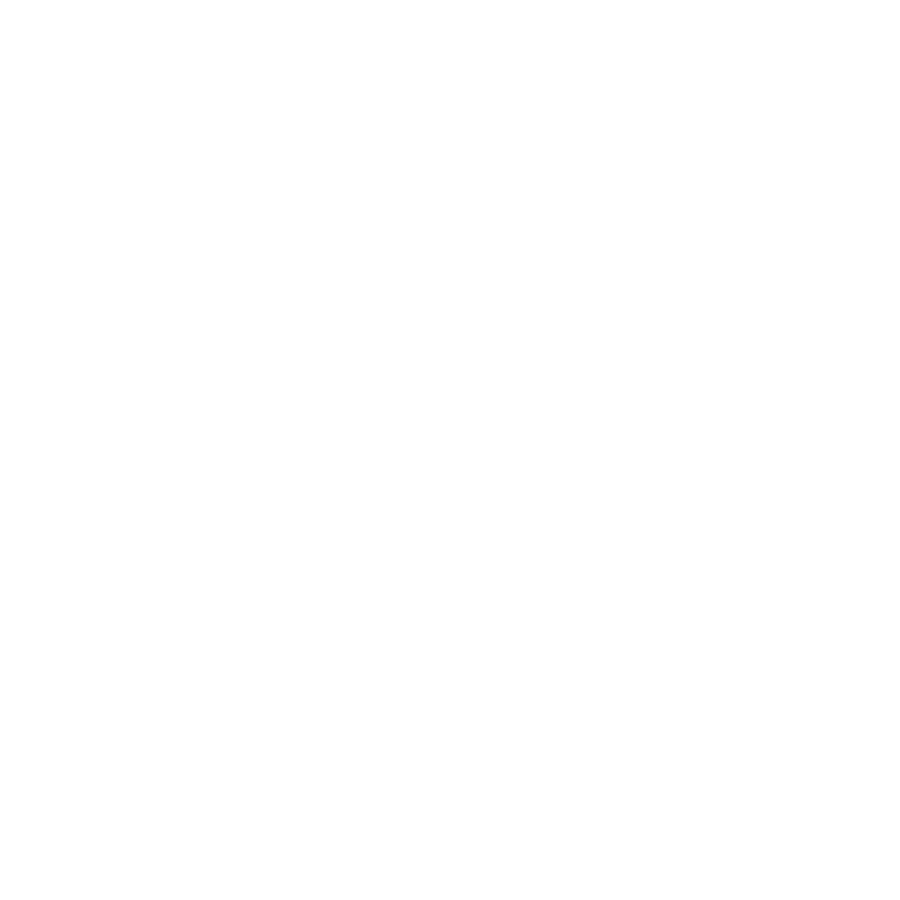

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_AVI
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 58
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [36.3448 -0.4572]
wRSq 0.13708624949577908
wCC prediction 0.3702516029617958


<IPython.core.display.Javascript object>


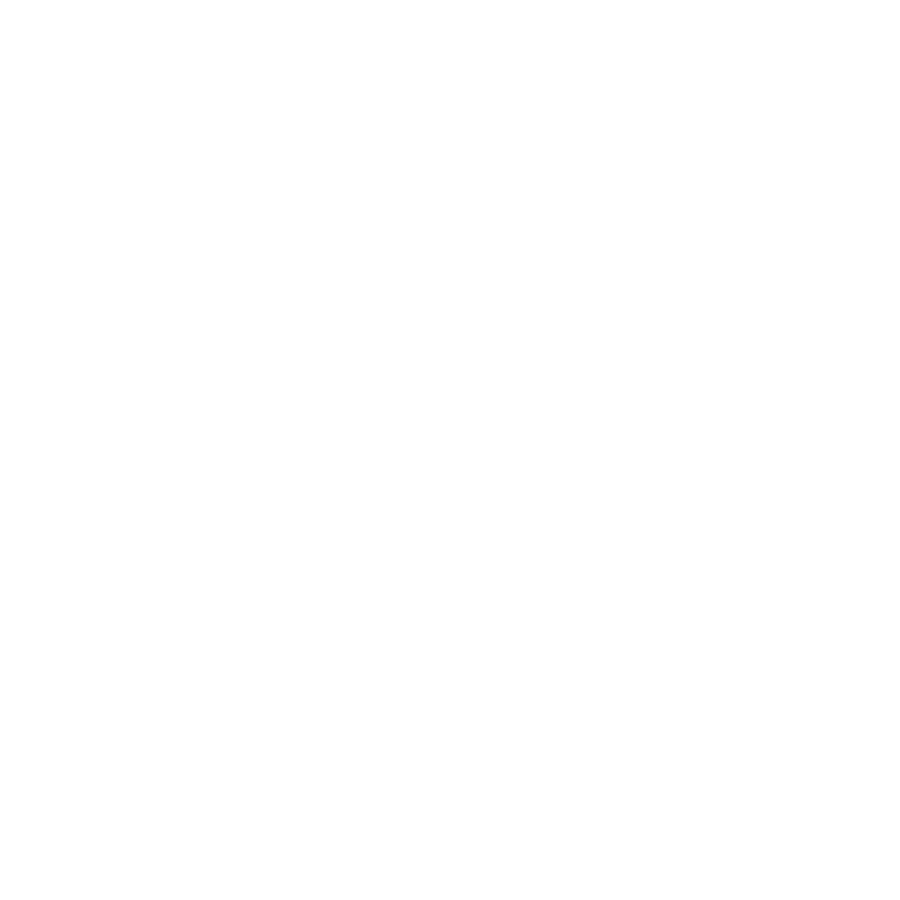

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_d23ab
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_d32
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_DVT
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 728
performing OLS (1D y)
Estimated OLS betas 

<IPython.core.display.Javascript object>


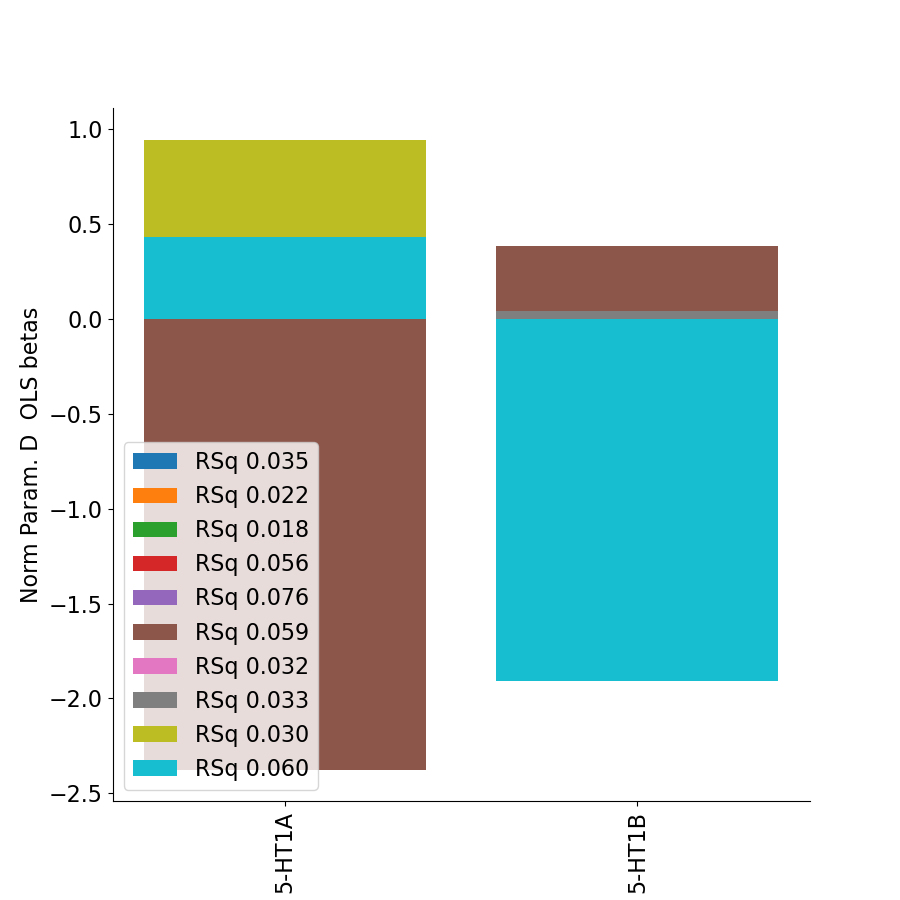

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_EC
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FEF
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1242
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [2.6018 0.0223]
wRSq 0.0203762537752451
wCC prediction 0.14274541595177445


<IPython.core.display.Javascript object>


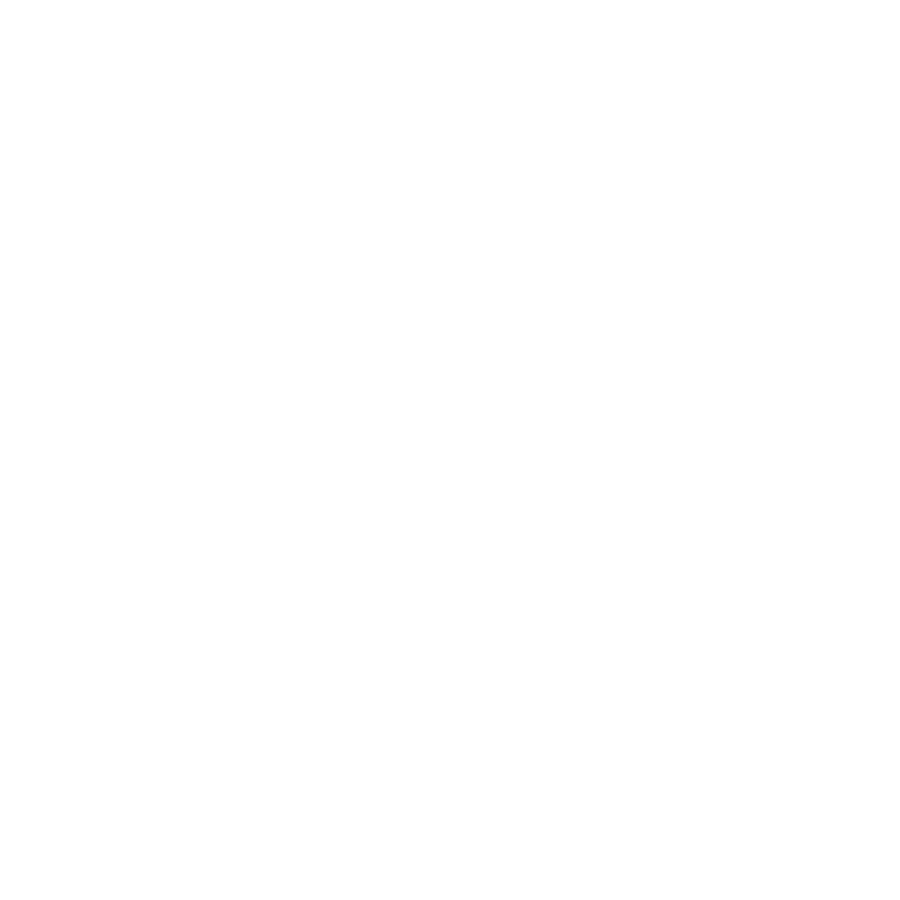

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FFC
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1265
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 3.4284 -0.0553]
wRSq 0.11019623586982441
wCC prediction 0.3319581839175296


<IPython.core.display.Javascript object>


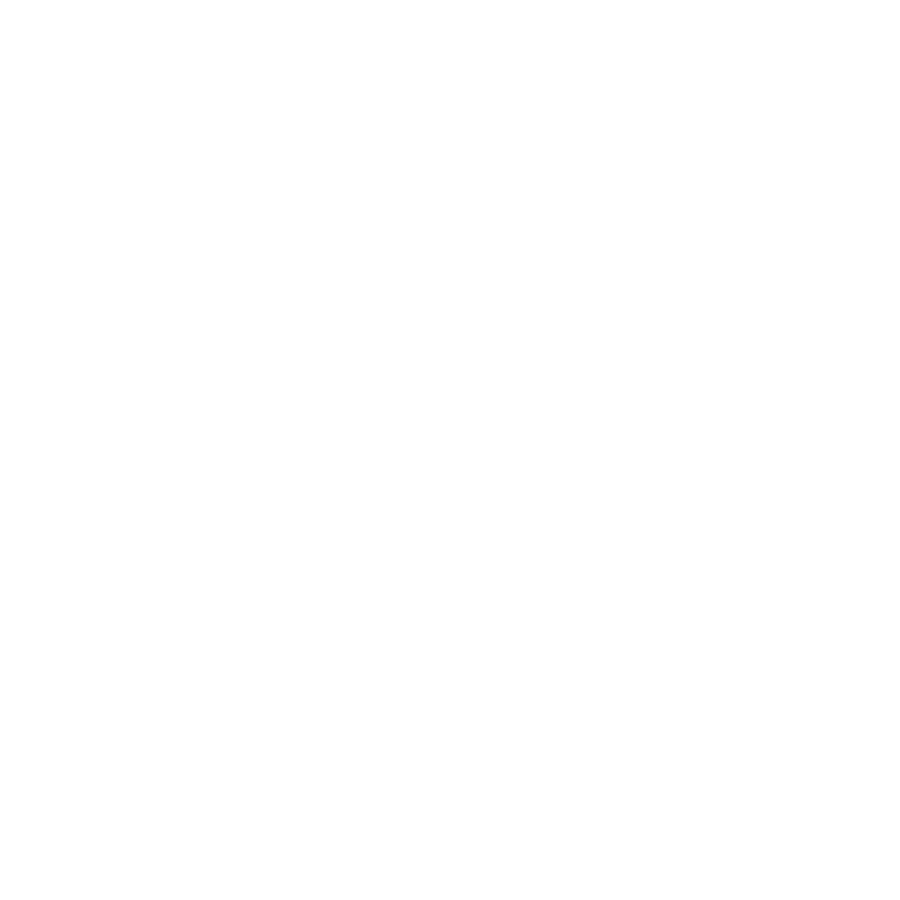

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FOP1
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FOP2
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FOP3
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq g

<IPython.core.display.Javascript object>


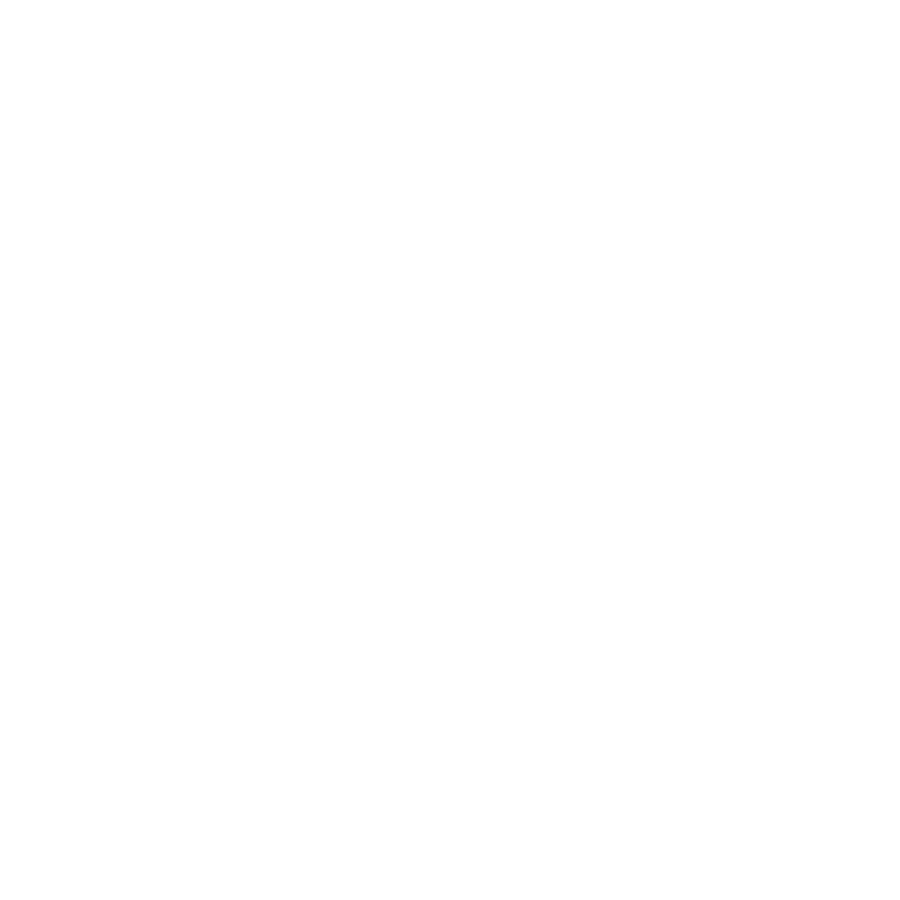

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FOP5
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 101
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [17.1036  0.0063]
wRSq 0.12910316892189966
wCC prediction 0.35930929423255875


<IPython.core.display.Javascript object>


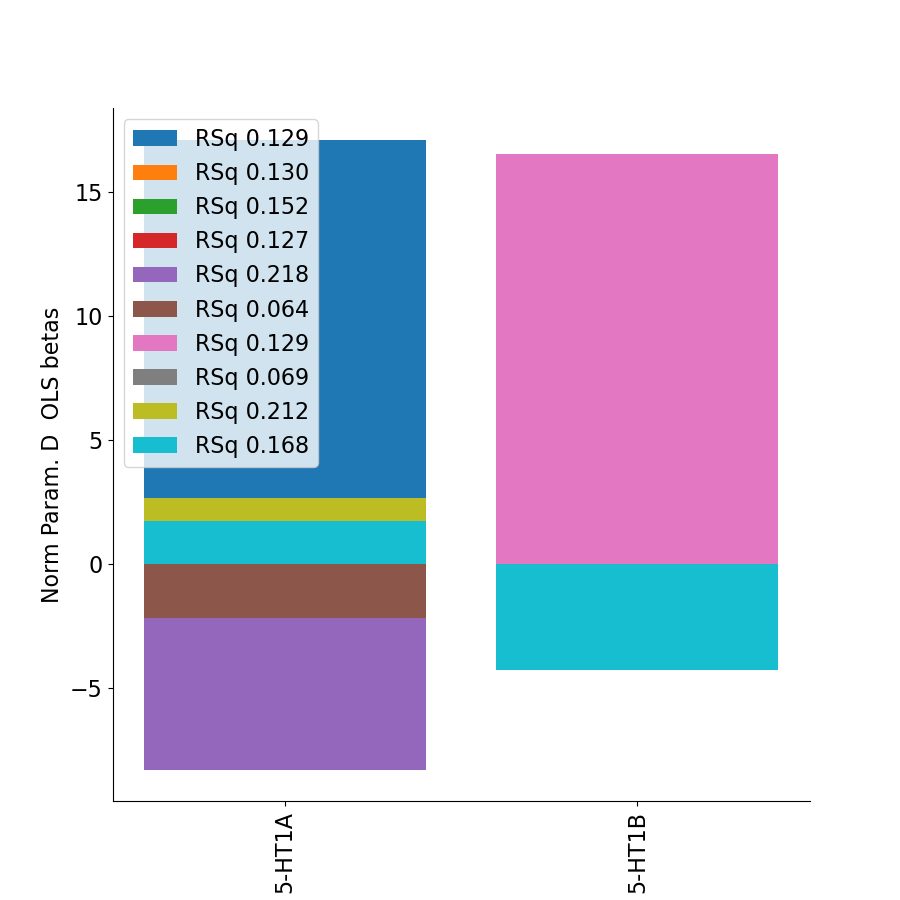

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FST
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 781
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-2.7582  0.0264]
wRSq 0.029487547059601993
wCC prediction 0.1717193846355207


<IPython.core.display.Javascript object>


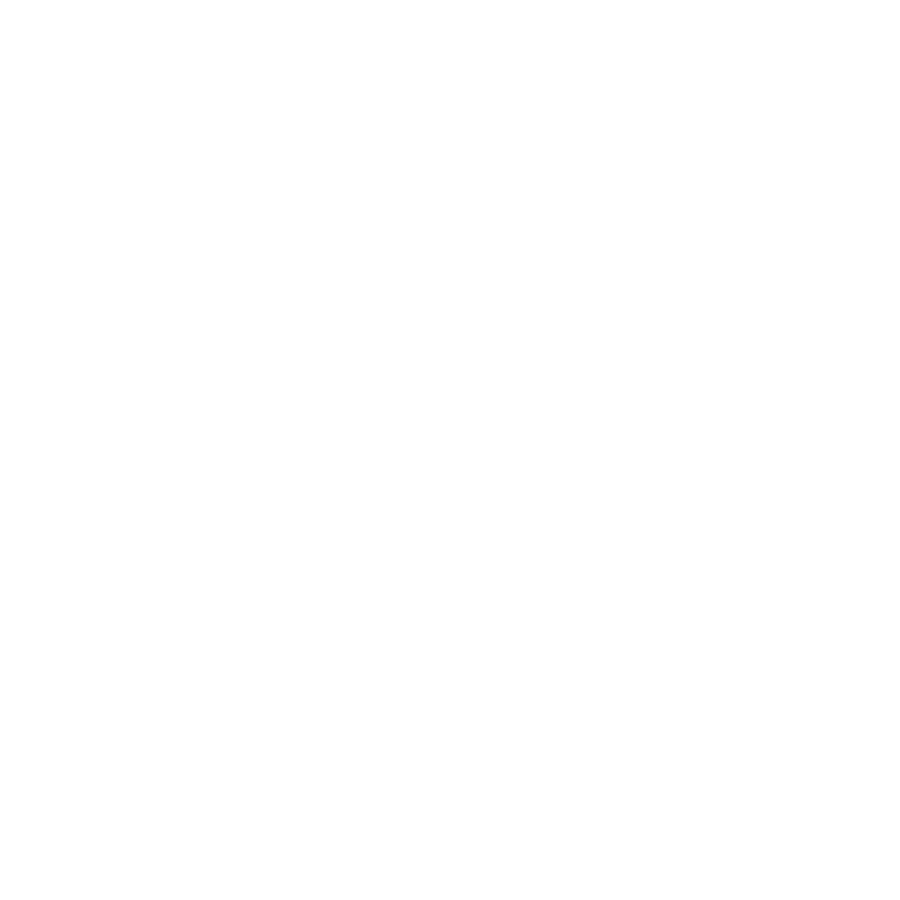

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_H
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_i6-8
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 29
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-18.9111   0.34  ]
wRSq 0.2628567169612289
wCC prediction 0.5126955402197574


<IPython.core.display.Javascript object>


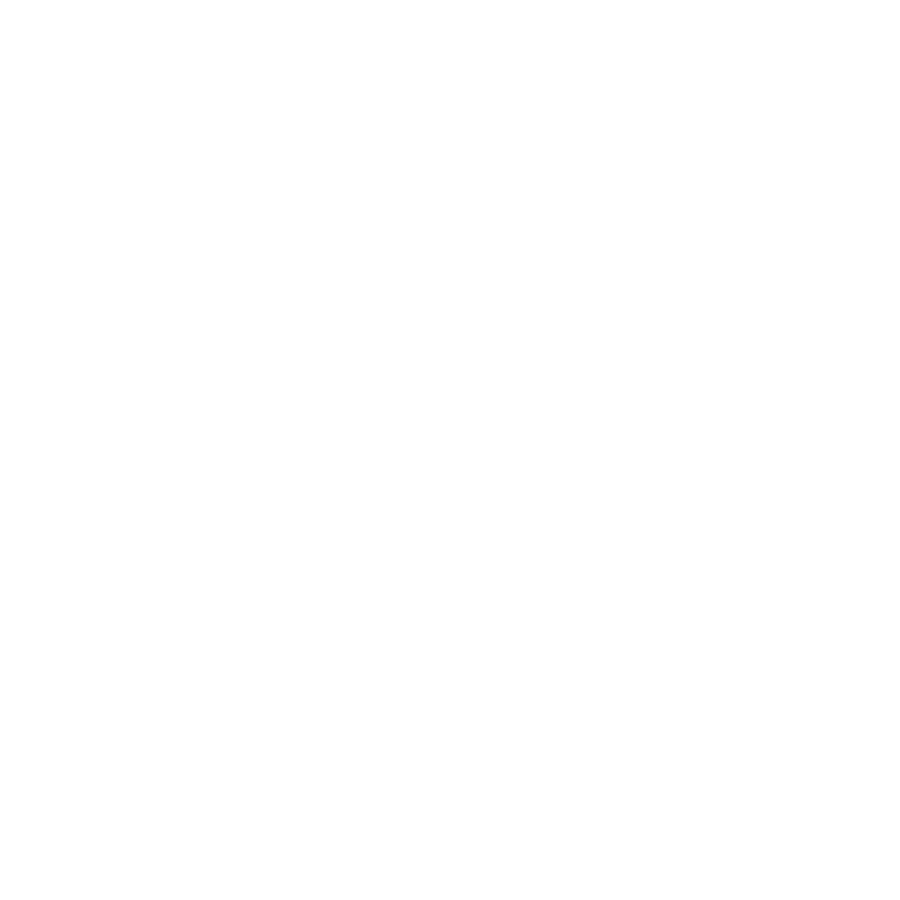

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_IFJa
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 37
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-6.0311  0.0923]
wRSq 0.009633441301658552
wCC prediction 0.09815009578018072


<IPython.core.display.Javascript object>


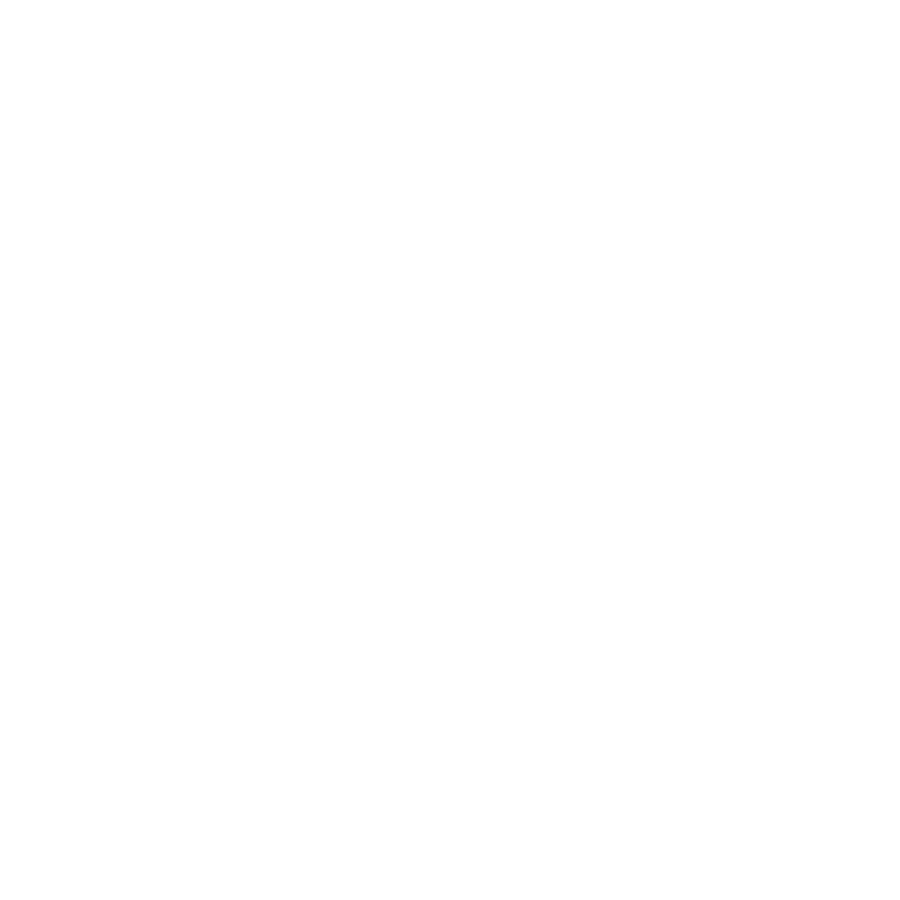

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_IFJp
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 499
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [20.8102 -0.0261]
wRSq 0.1267396678514514
wCC prediction 0.35600515143948613


<IPython.core.display.Javascript object>


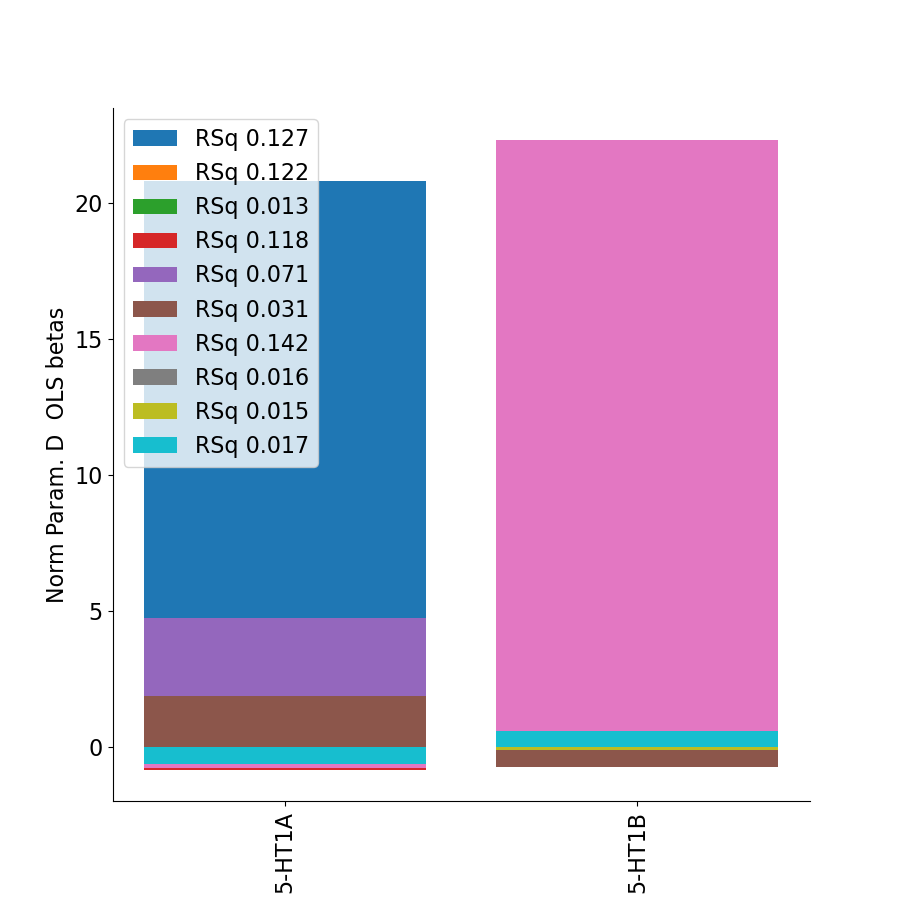

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_IFSa
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 2
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_IFSp
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 129
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [58.4923 -0.479 ]
wRSq 0.0777315622706477
wCC prediction 0.27880380605480953


<IPython.core.display.Javascript object>


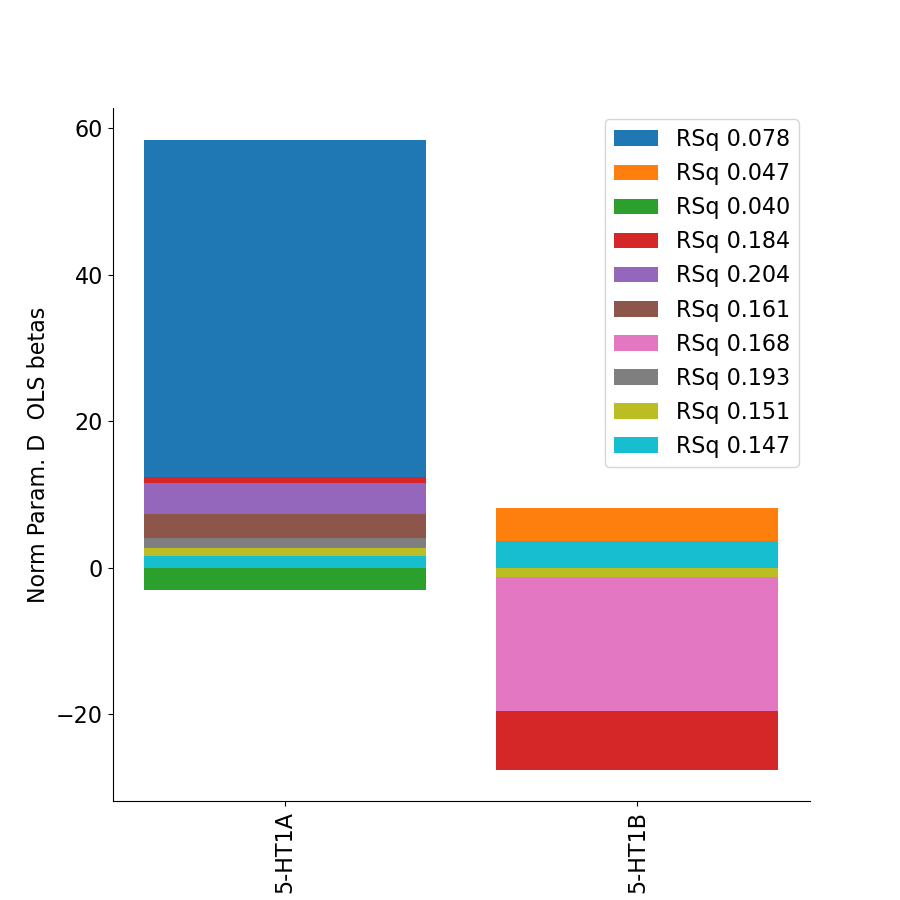

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_Ig
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_IP0
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 989
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-8.4046 -0.0074]
wRSq 0.1272313856827385
wCC prediction 0.3566950878309632


<IPython.core.display.Javascript object>


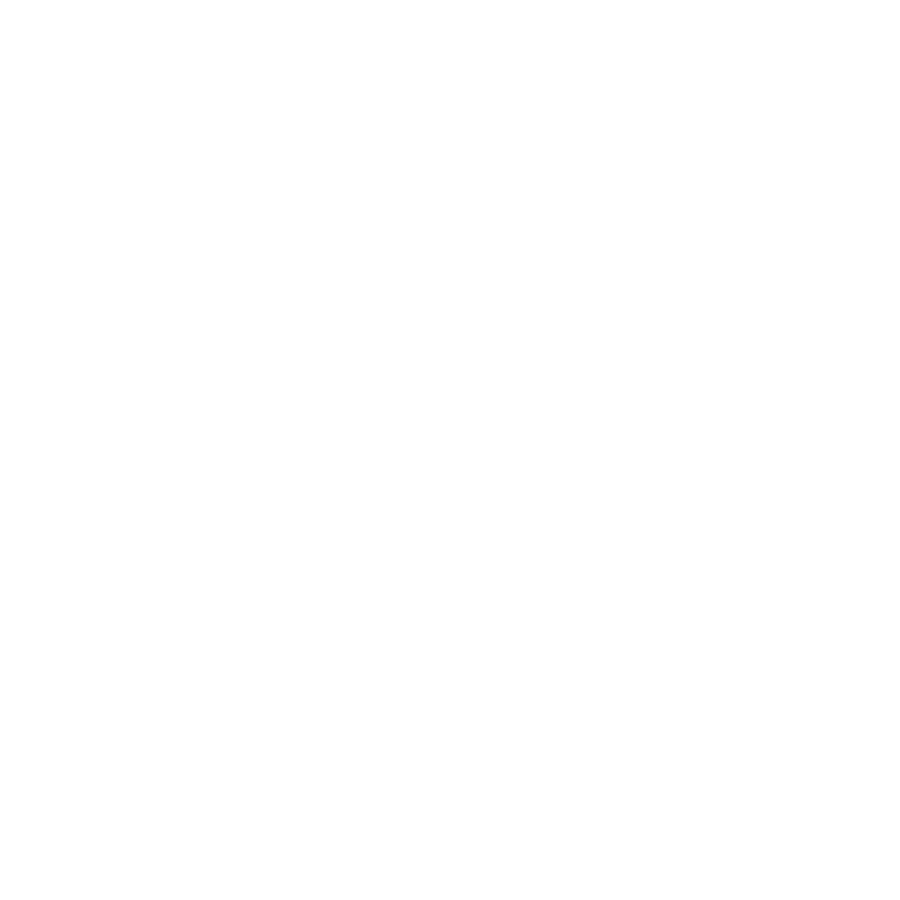

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_IP1
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 23
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-5.6829  0.0705]
wRSq 0.04659308412085705
wCC prediction 0.21585431225911839


<IPython.core.display.Javascript object>


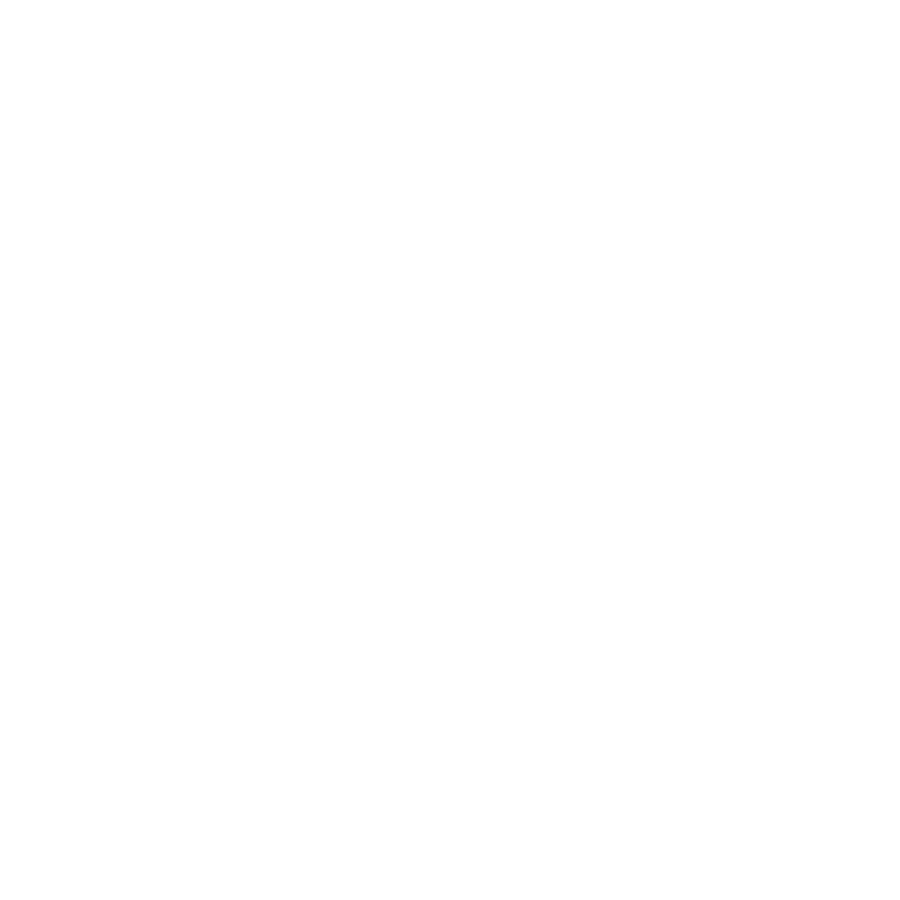

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_IP2
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 100
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [3.0253 0.0322]
wRSq 0.0017976862668945826
wCC prediction 0.0423991304969165


<IPython.core.display.Javascript object>


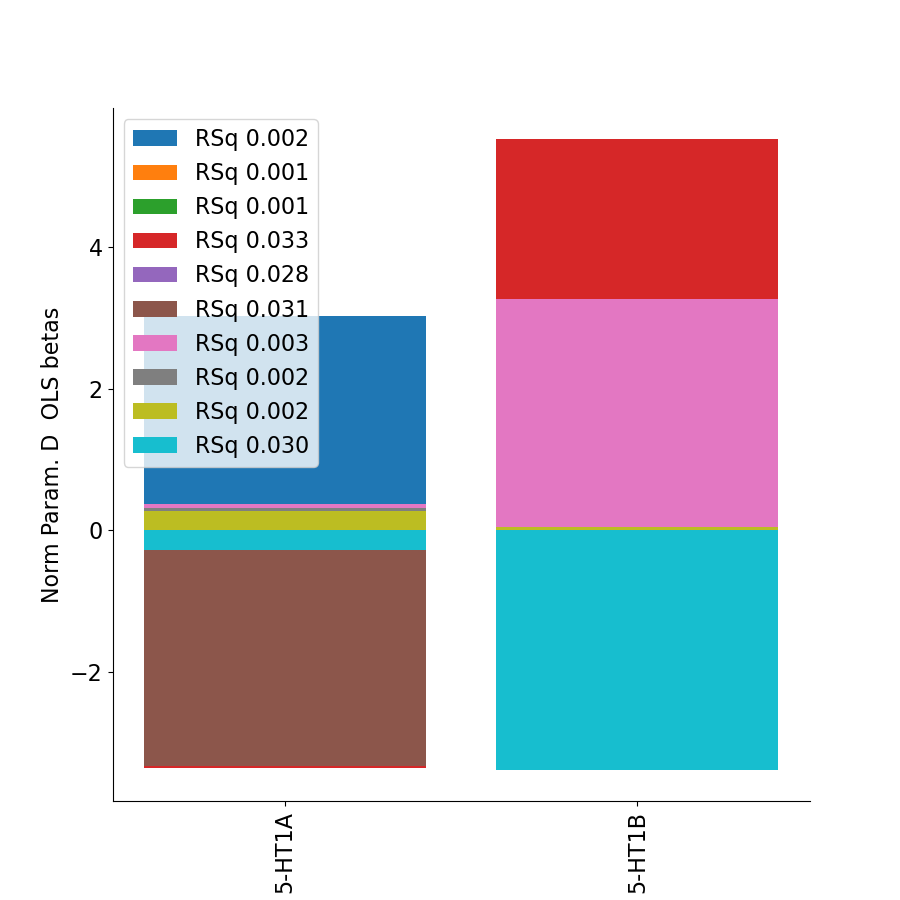

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_IPS1
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1187
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 1.5343 -0.0303]
wRSq 0.03181828288639932
wCC prediction 0.17837680030317632


<IPython.core.display.Javascript object>


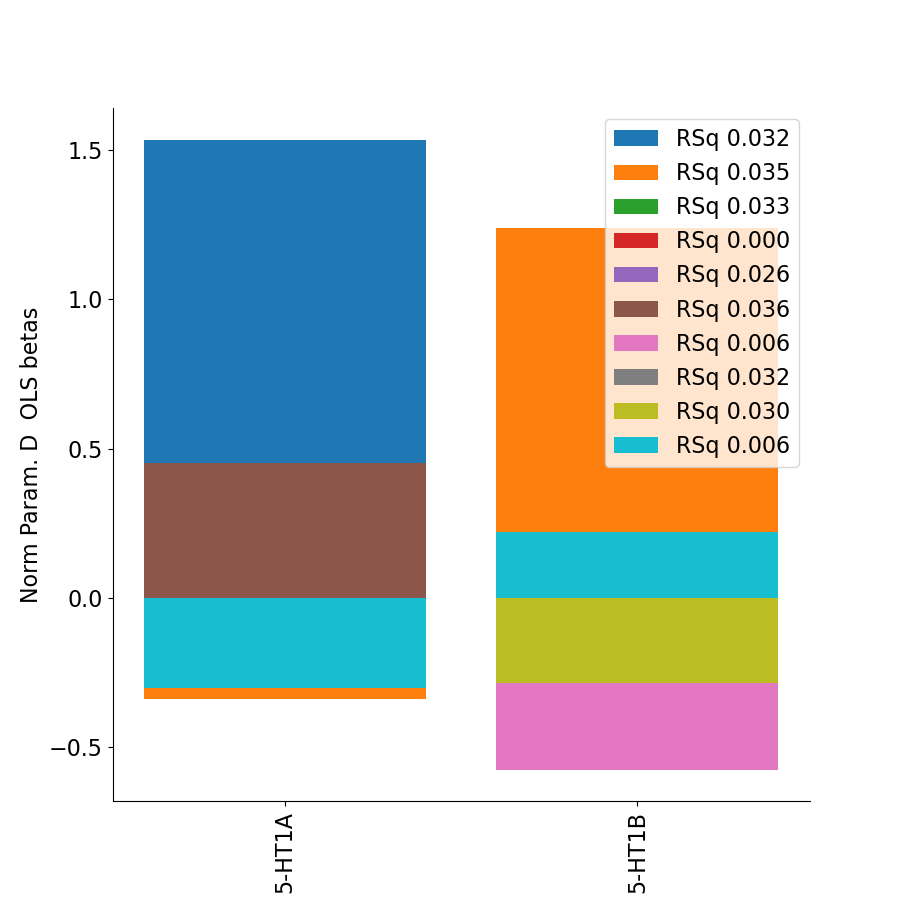

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_LBelt
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_LIPd
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 660
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [16.0966 -0.0557]
wRSq 0.09268904929916977
wCC prediction 0.3044487630113969


<IPython.core.display.Javascript object>


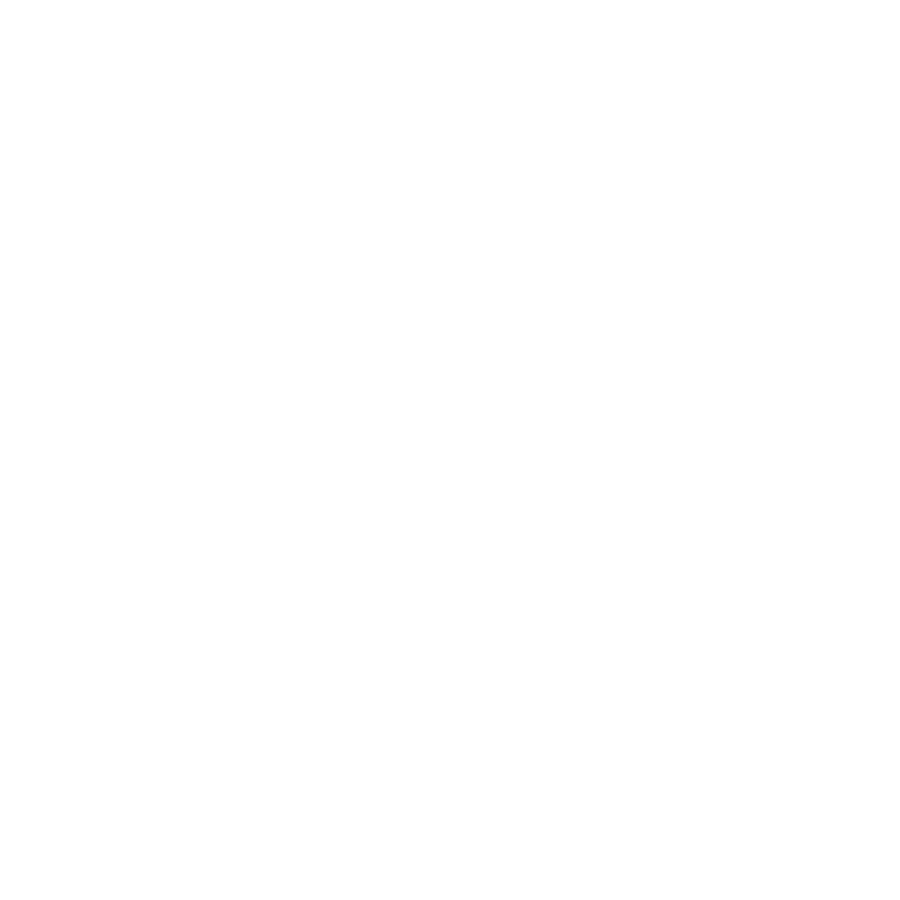

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_LIPv
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1426
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [5.9273 0.0058]
wRSq 0.07800537263103358
wCC prediction 0.2792944192622429


<IPython.core.display.Javascript object>


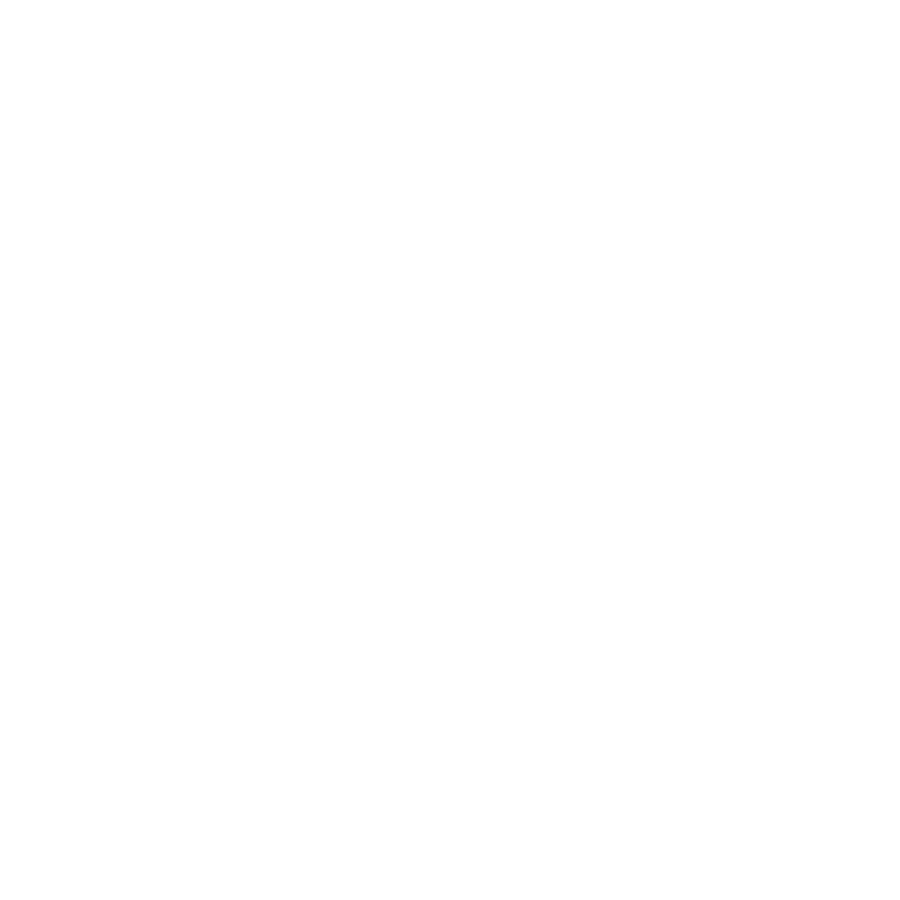

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_LO1
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 586
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-6.8175 -0.0047]
wRSq 0.10363878799613668
wCC prediction 0.3219297873700672


<IPython.core.display.Javascript object>


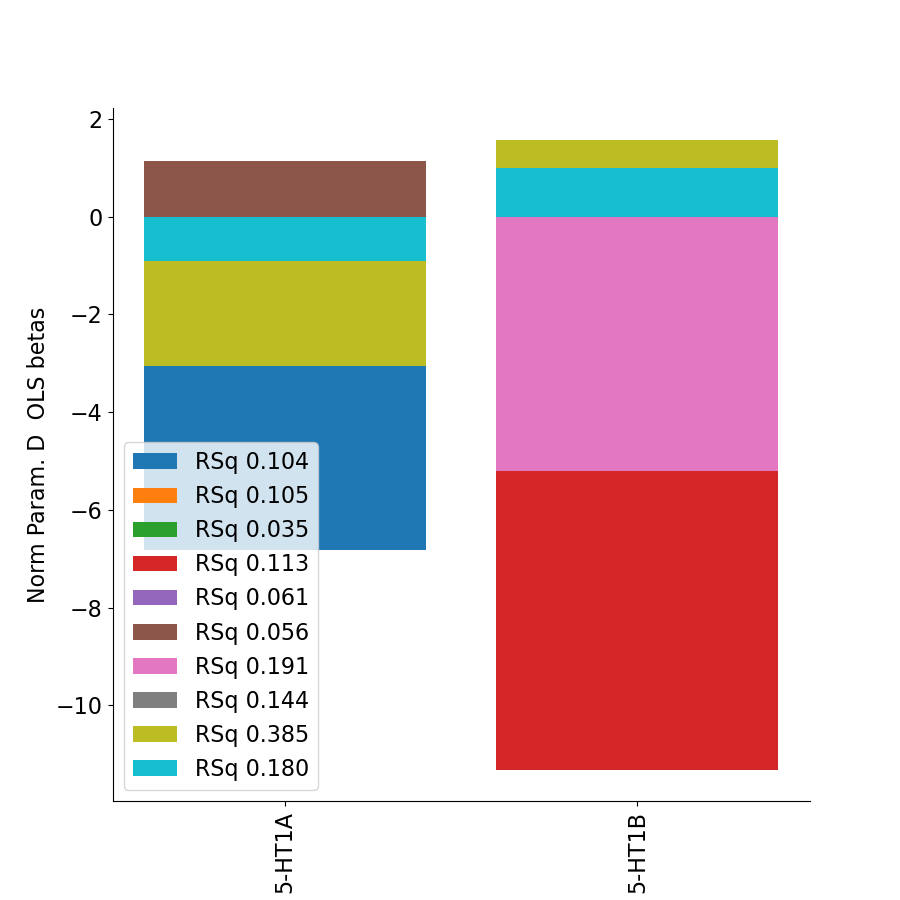

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_LO2
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 543
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-17.0059   0.147 ]
wRSq 0.36384901219067345
wCC prediction 0.6031989822526835


<IPython.core.display.Javascript object>


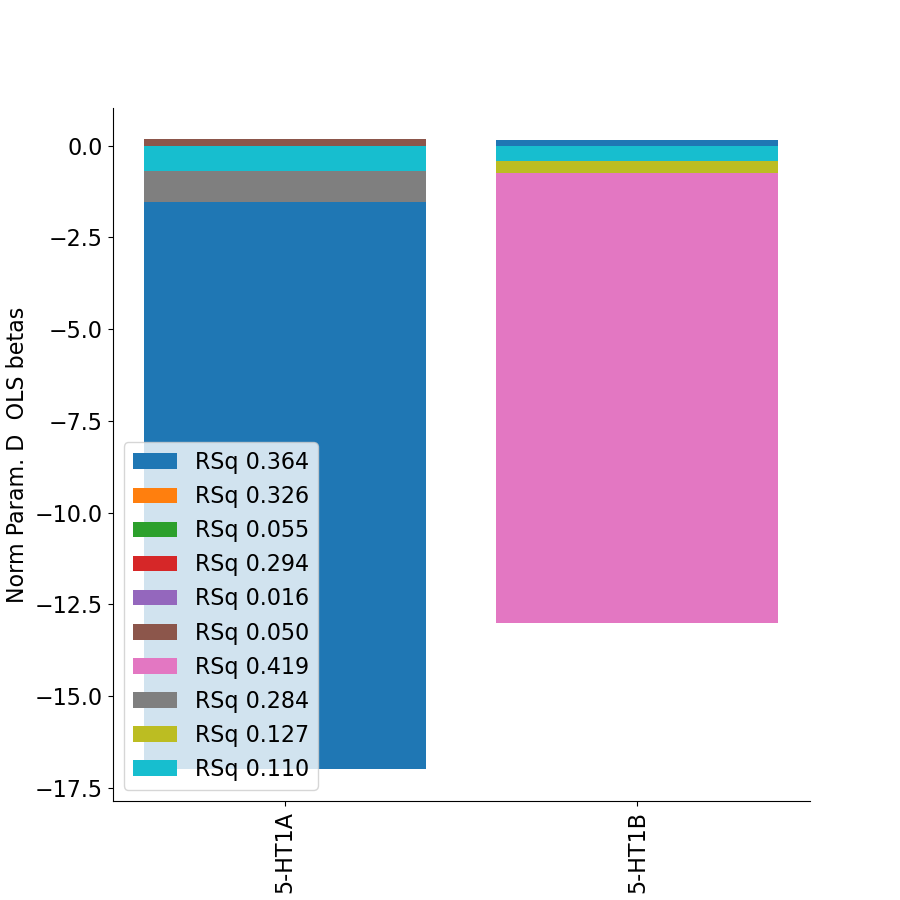

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_LO3
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 672
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-2.2308  0.0358]
wRSq 0.007892073490760487
wCC prediction 0.08883734288439926


<IPython.core.display.Javascript object>


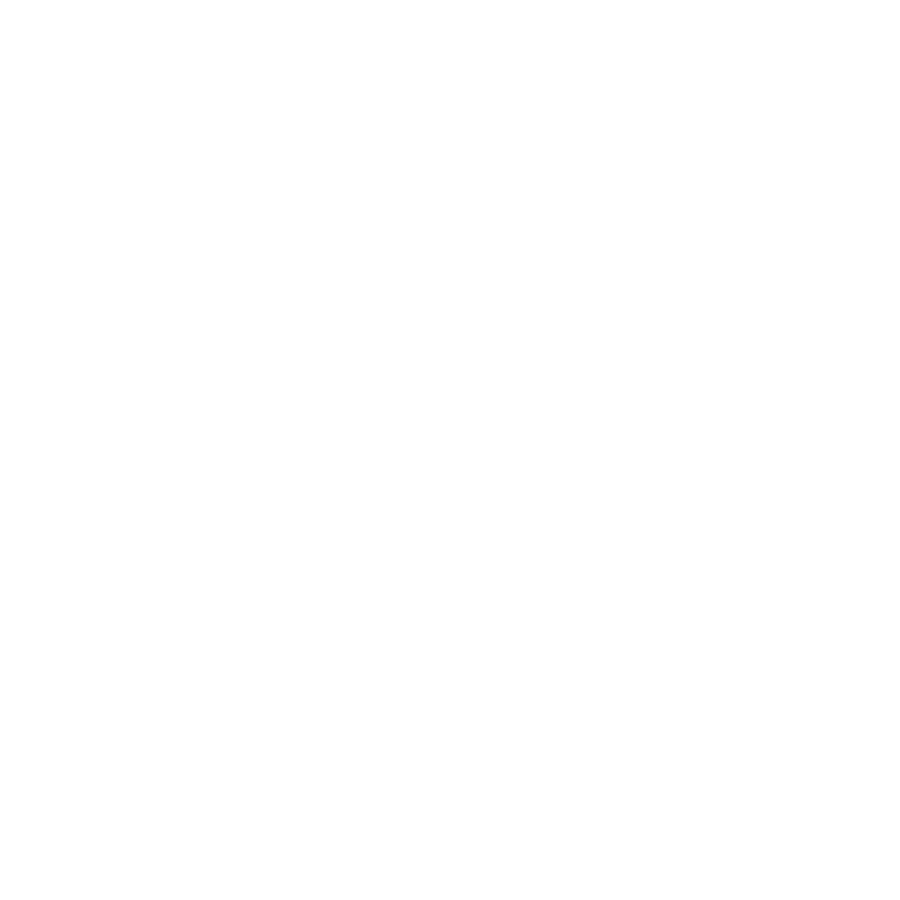

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MBelt
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MI
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MIP
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1433
performing OLS (1D y)
Estimated OLS betas 

<IPython.core.display.Javascript object>


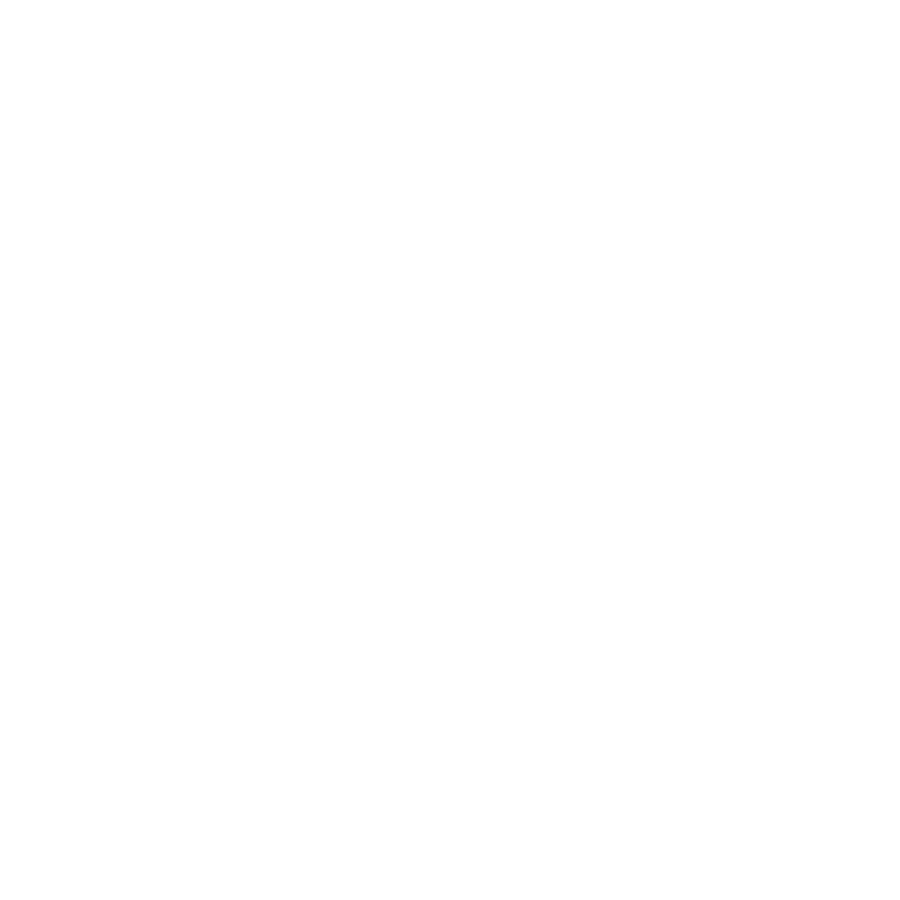

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MST
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 745
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-3.1832 -0.0363]
wRSq 0.13503939182211144
wCC prediction 0.36747706298776167


<IPython.core.display.Javascript object>


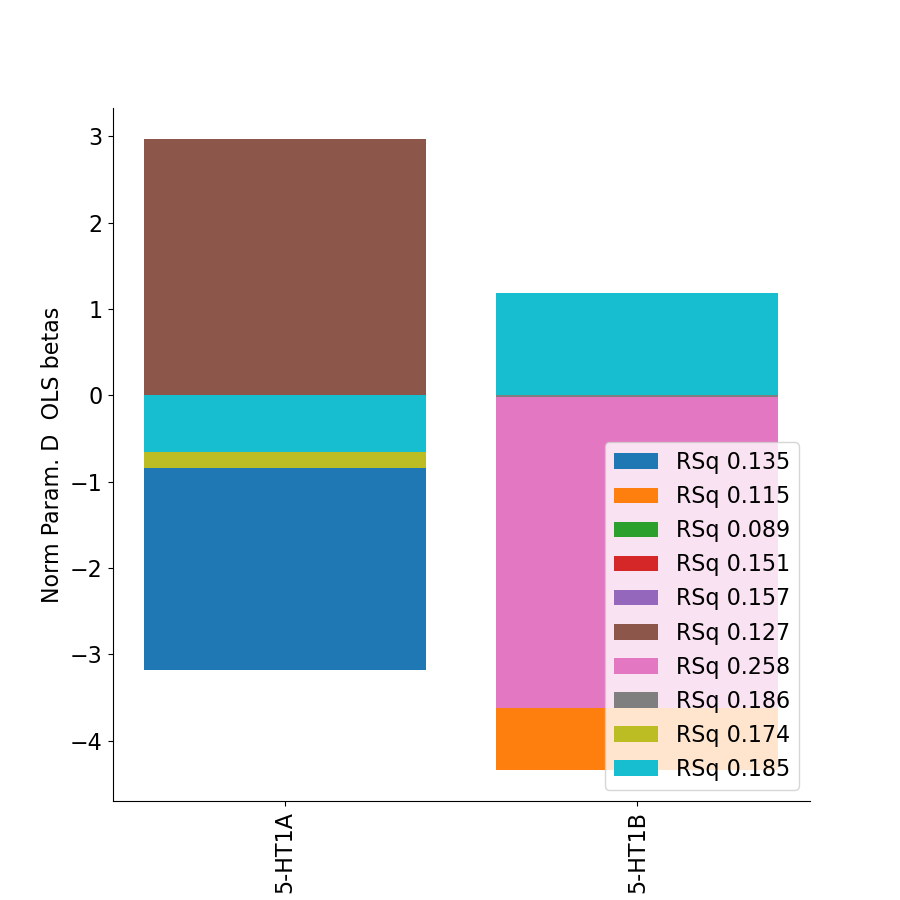

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MT
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 586
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-3.9285 -0.0188]
wRSq 0.0879085163621175
wCC prediction 0.2964937037478494


<IPython.core.display.Javascript object>


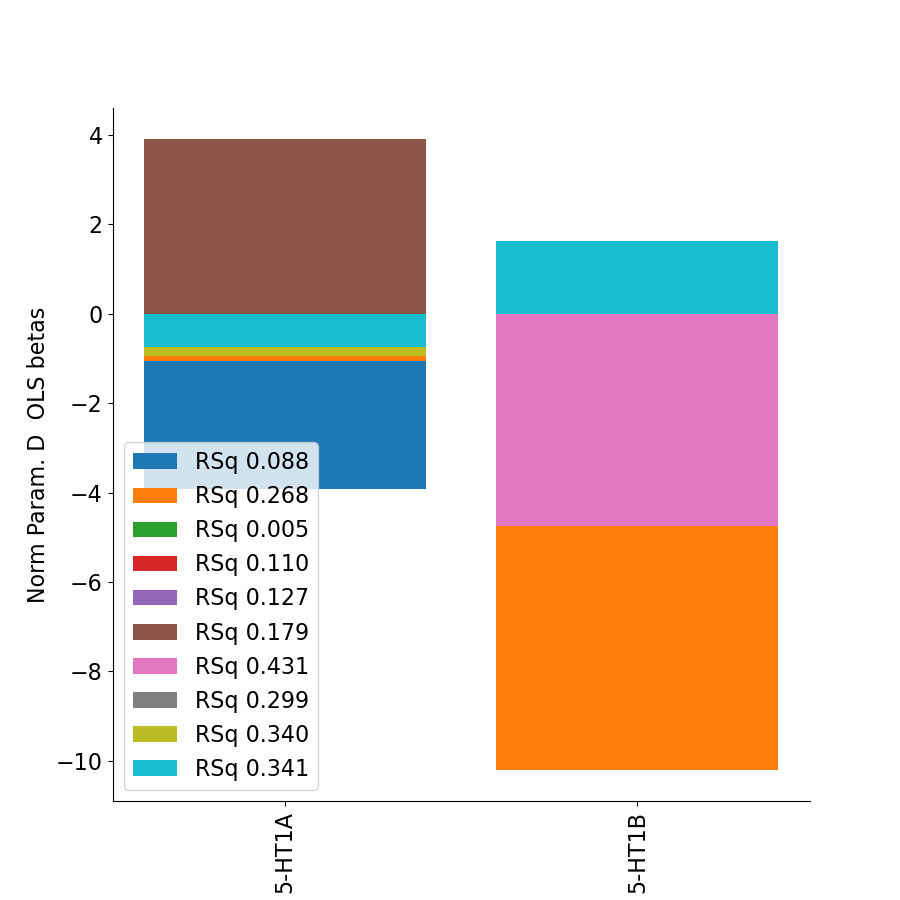

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_OFC
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_OP1
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_OP2-3
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq gl

<IPython.core.display.Javascript object>


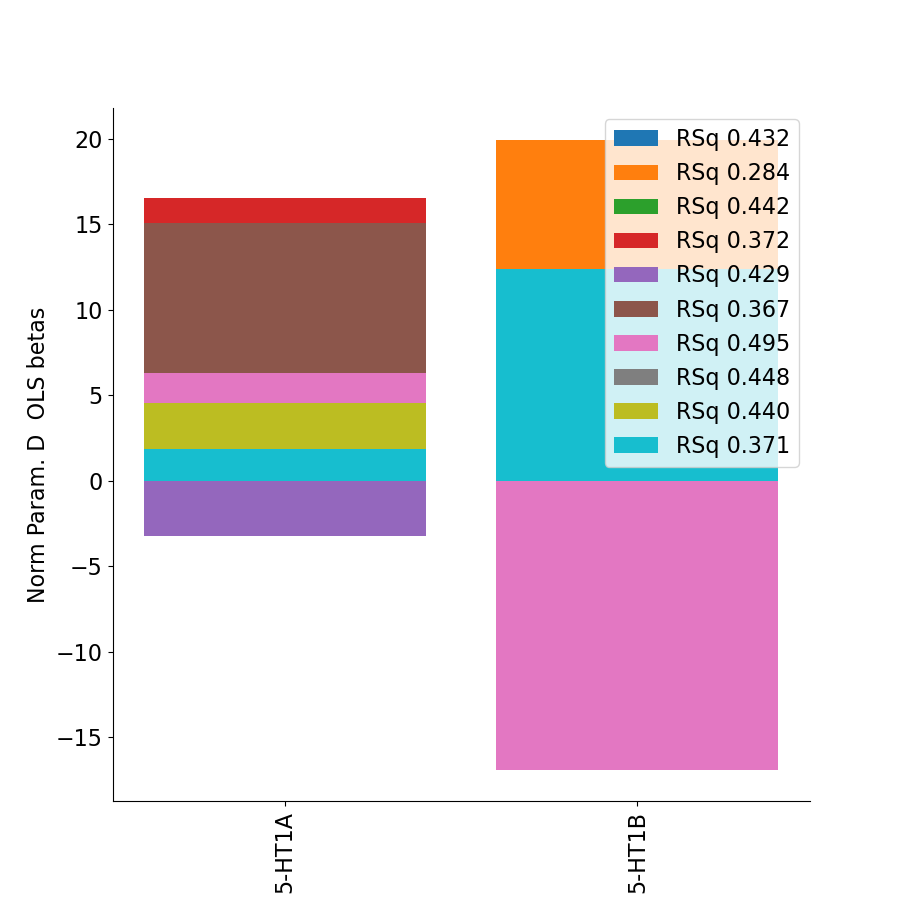

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_p47r
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_p9-46v
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 93
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [7.0441 0.195 ]
wRSq 0.08161089880016303
wCC prediction 0.2856762132207772


<IPython.core.display.Javascript object>


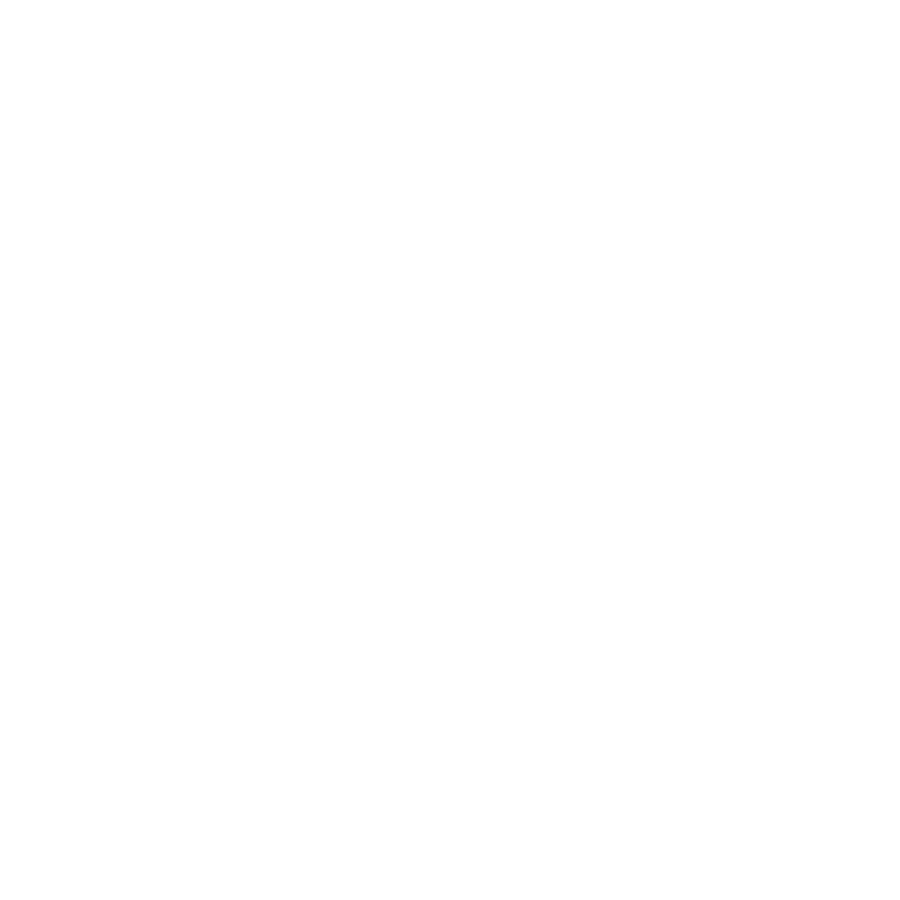

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PBelt
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PCV
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 237
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-8.3819  0.083 ]
wRSq 0.09634132035281684
wCC prediction 0.3103889823315529


<IPython.core.display.Javascript object>


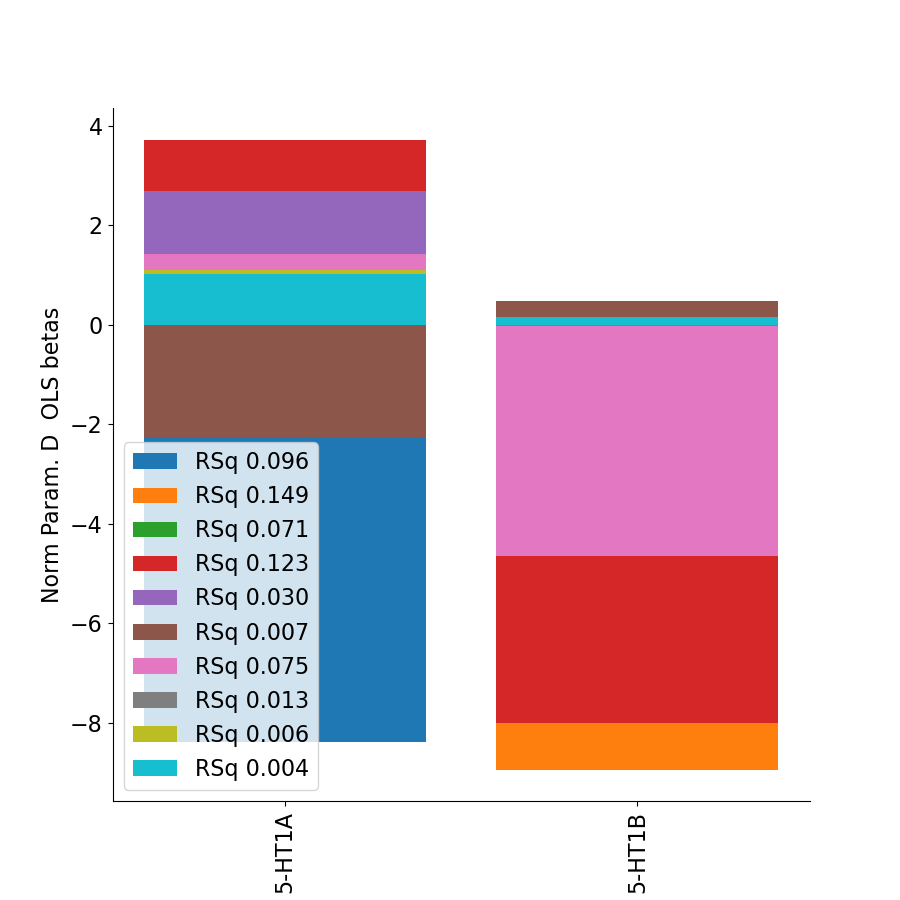

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PeEc
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PEF
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 705
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [0.9947 0.0299]
wRSq 0.044335123209866434
wCC prediction 0.2105590729697161


<IPython.core.display.Javascript object>


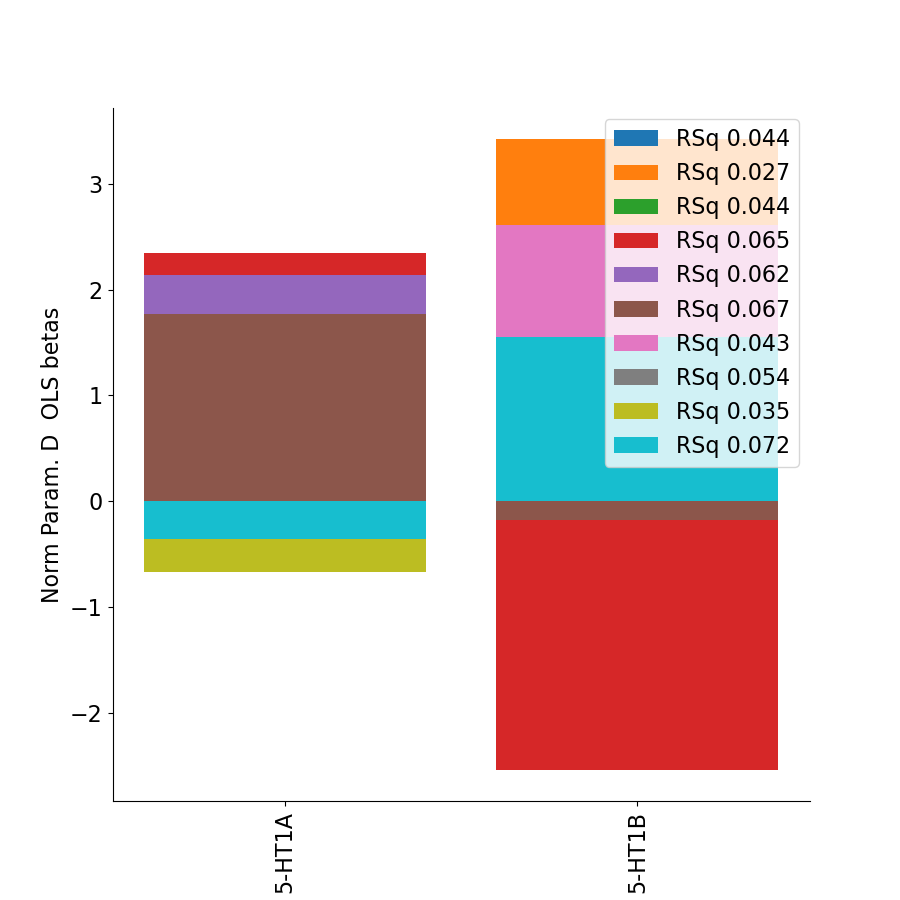

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PF
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 404
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 7.7415 -0.0457]
wRSq 0.06322228716346057
wCC prediction 0.2514404246804011


<IPython.core.display.Javascript object>


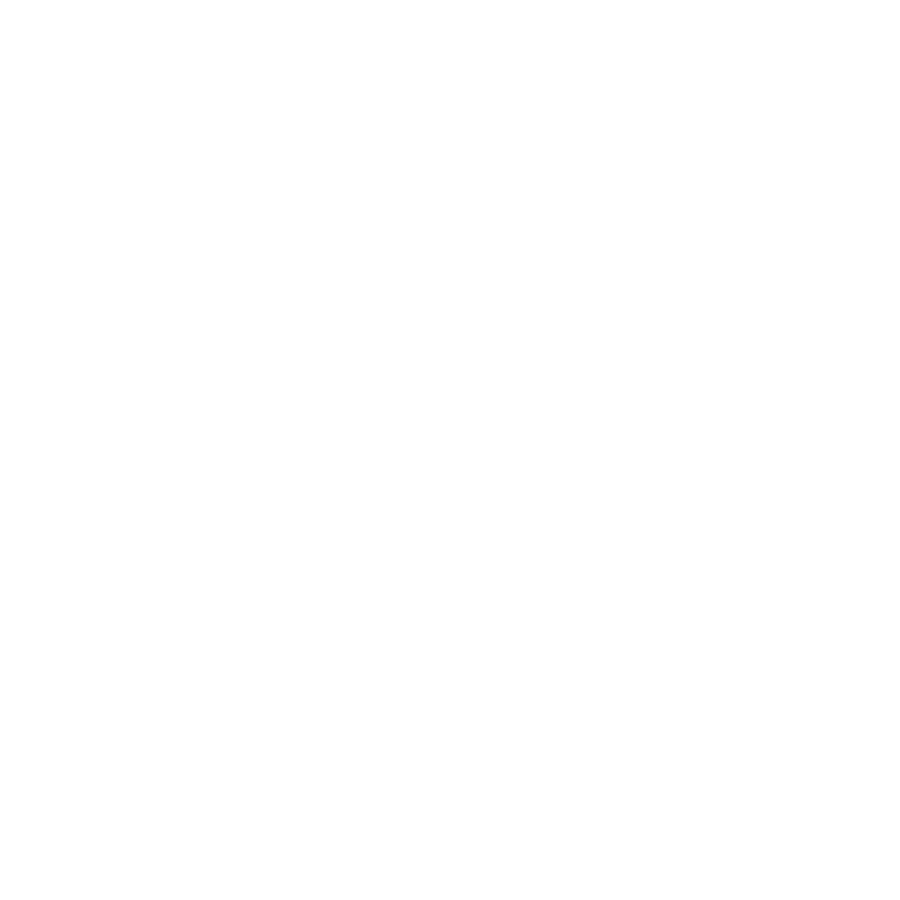

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PFcm
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PFm
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PFop
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 412
performing OLS (1D y)
Estimated OLS betas 

<IPython.core.display.Javascript object>


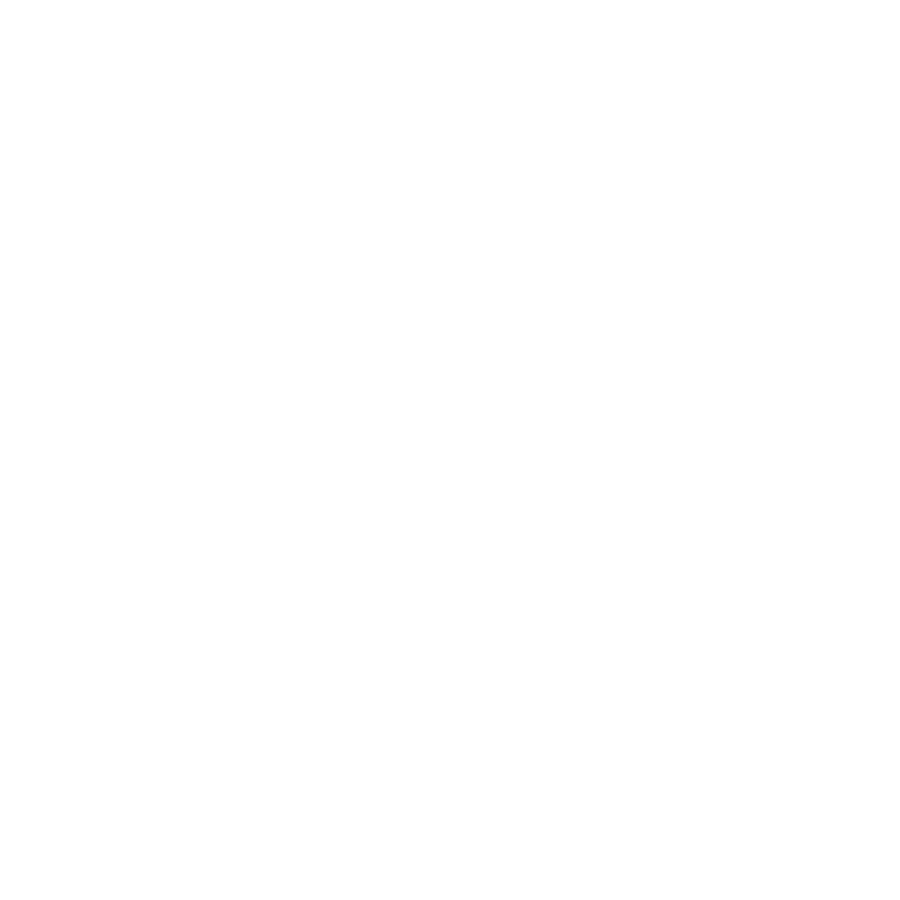

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PFt
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1721
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 4.8307 -0.032 ]
wRSq 0.07103543932547707
wCC prediction 0.26652474430243267


<IPython.core.display.Javascript object>


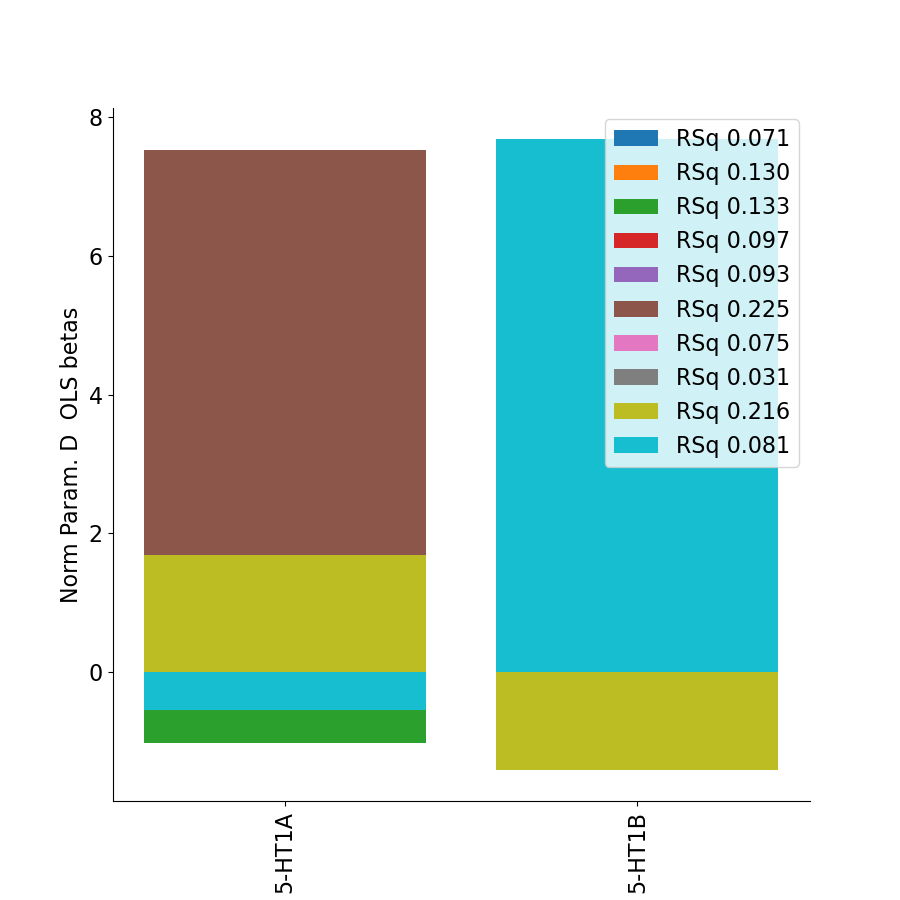

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PGi
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PGp
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1116
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-10.042   -0.0237]
wRSq 0.17040289771196615
wCC prediction 0.412798858661172


<IPython.core.display.Javascript object>


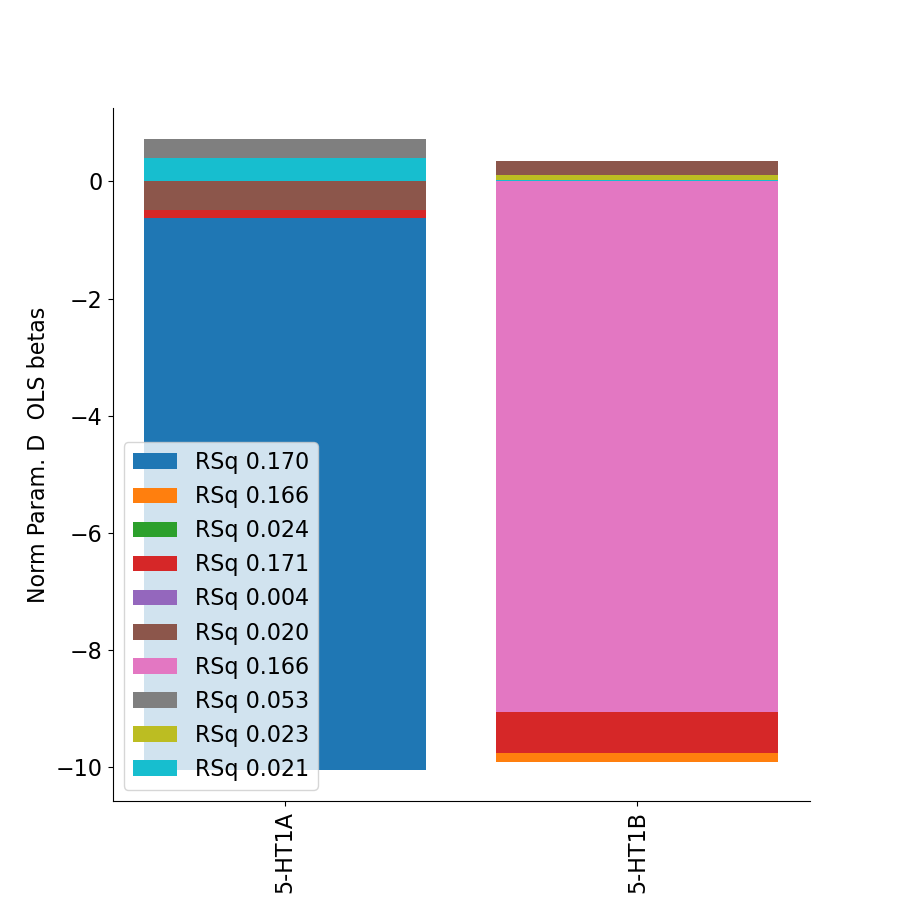

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PGs
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PH
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1312
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [3.0614 0.0069]
wRSq 0.0061264500127937715
wCC prediction 0.07827164245621611


<IPython.core.display.Javascript object>


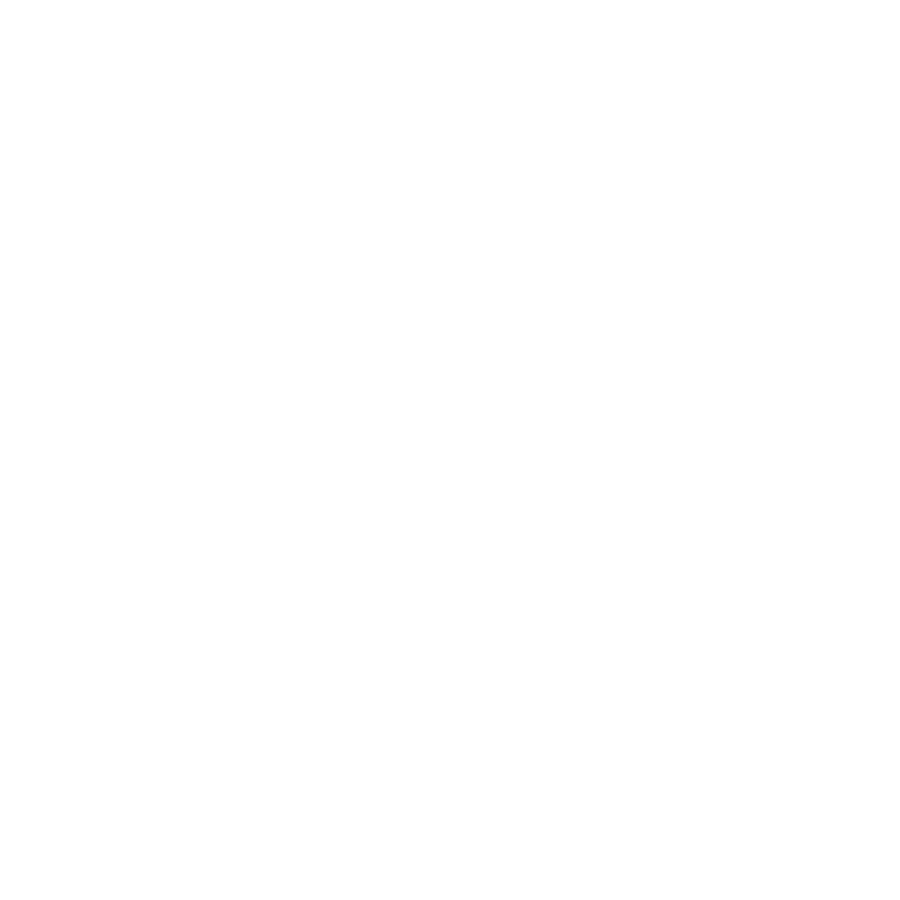

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PHA1
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PHA2
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PHA3
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 216
performing OLS (1D y)
Estimated OLS betas

<IPython.core.display.Javascript object>


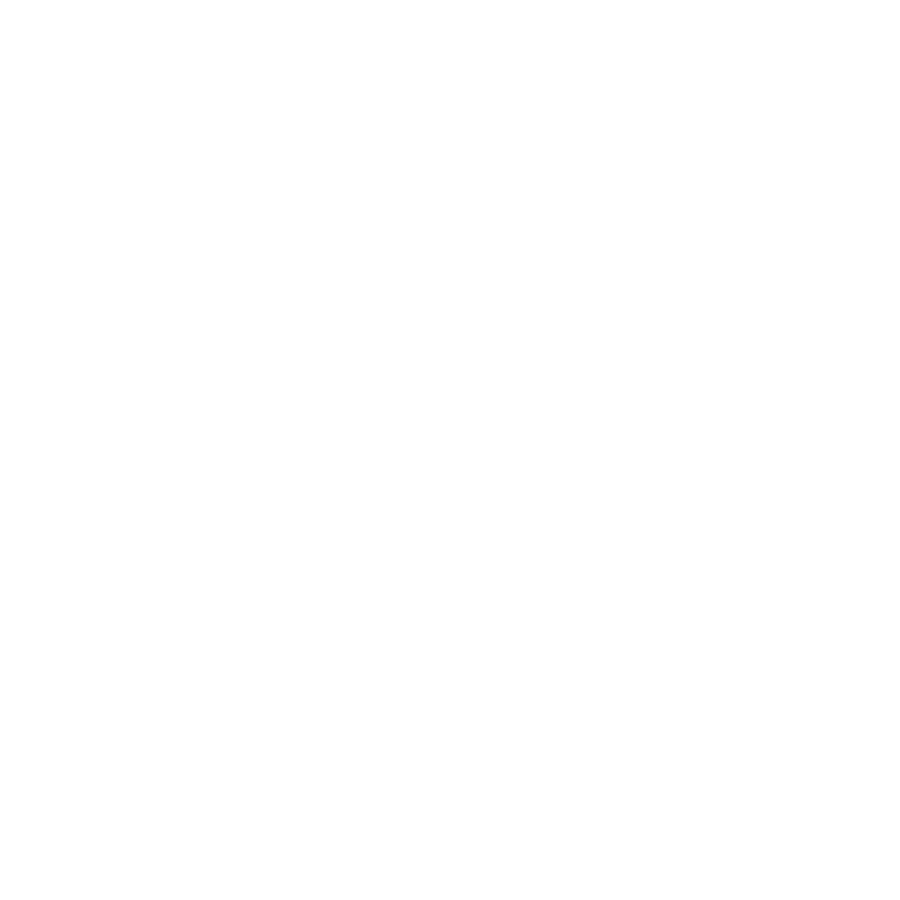

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PHT
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 81
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 1.8419 -0.0632]
wRSq 0.011344880093149379
wCC prediction 0.10651234713942437


<IPython.core.display.Javascript object>


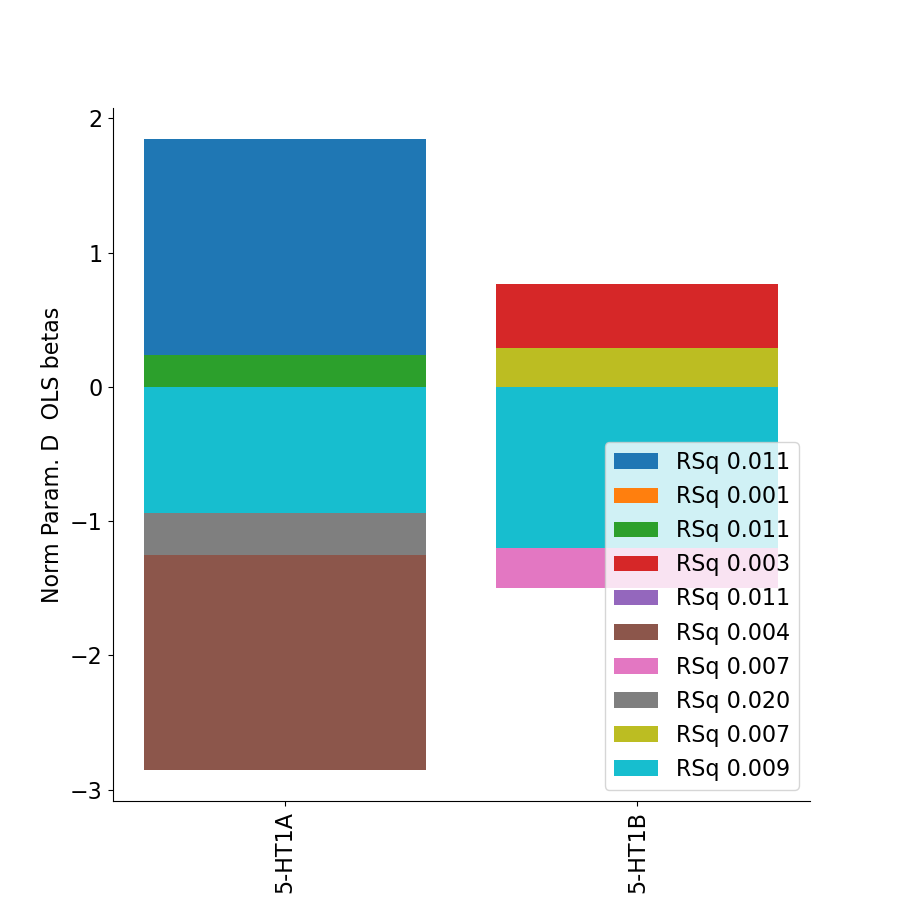

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PI
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_Pir
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PIT
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 678
performing OLS (1D y)
Estimated OLS betas Nor

<IPython.core.display.Javascript object>


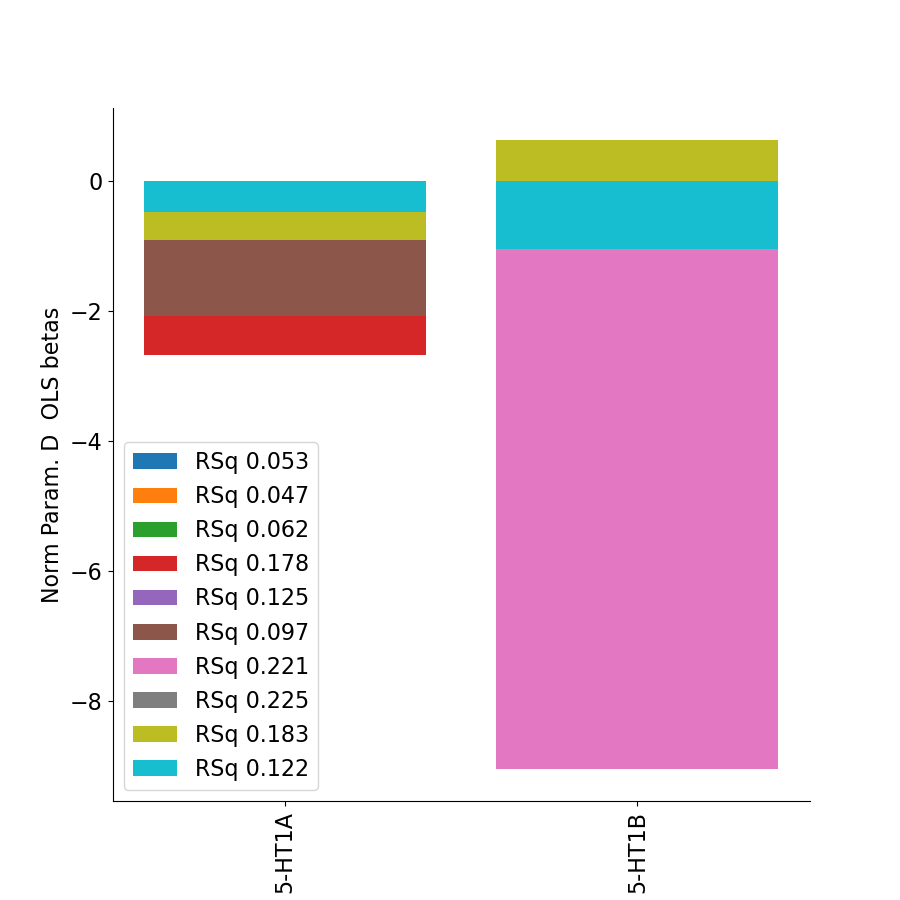

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_pOFC
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PoI1
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PoI2
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq g

<IPython.core.display.Javascript object>


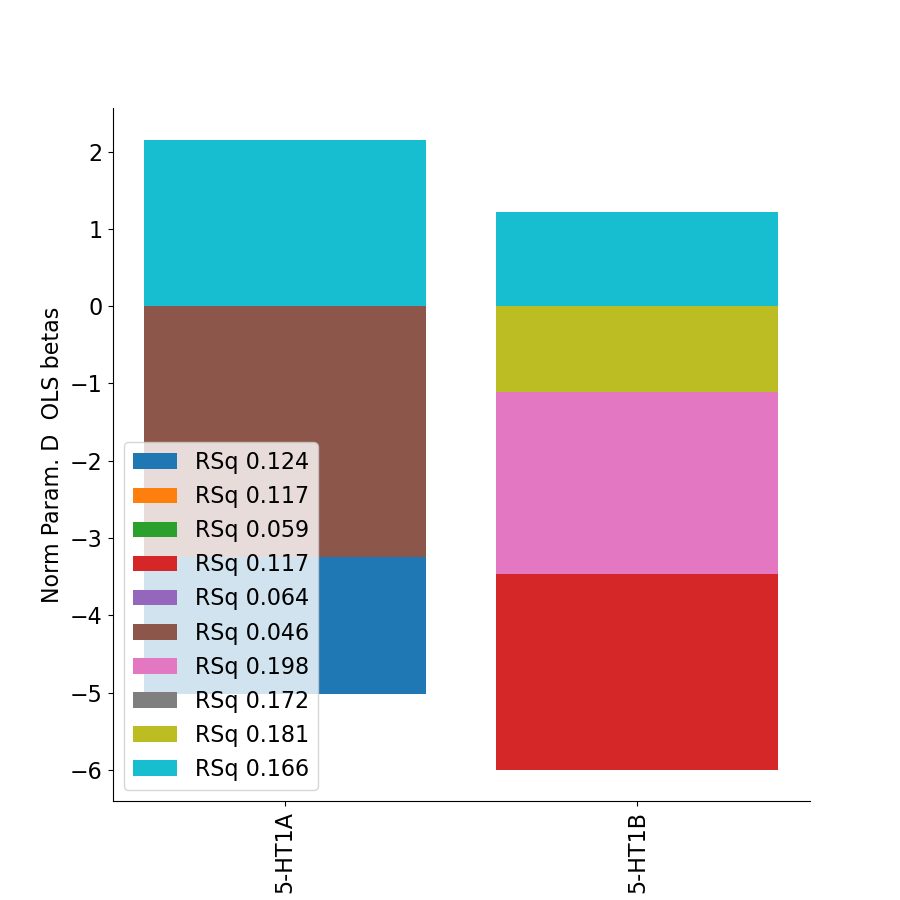

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PreS
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_ProS
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PSL
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1
fit-task-BAR_fit-runs-all fsaverage_cvrsq gl

<IPython.core.display.Javascript object>


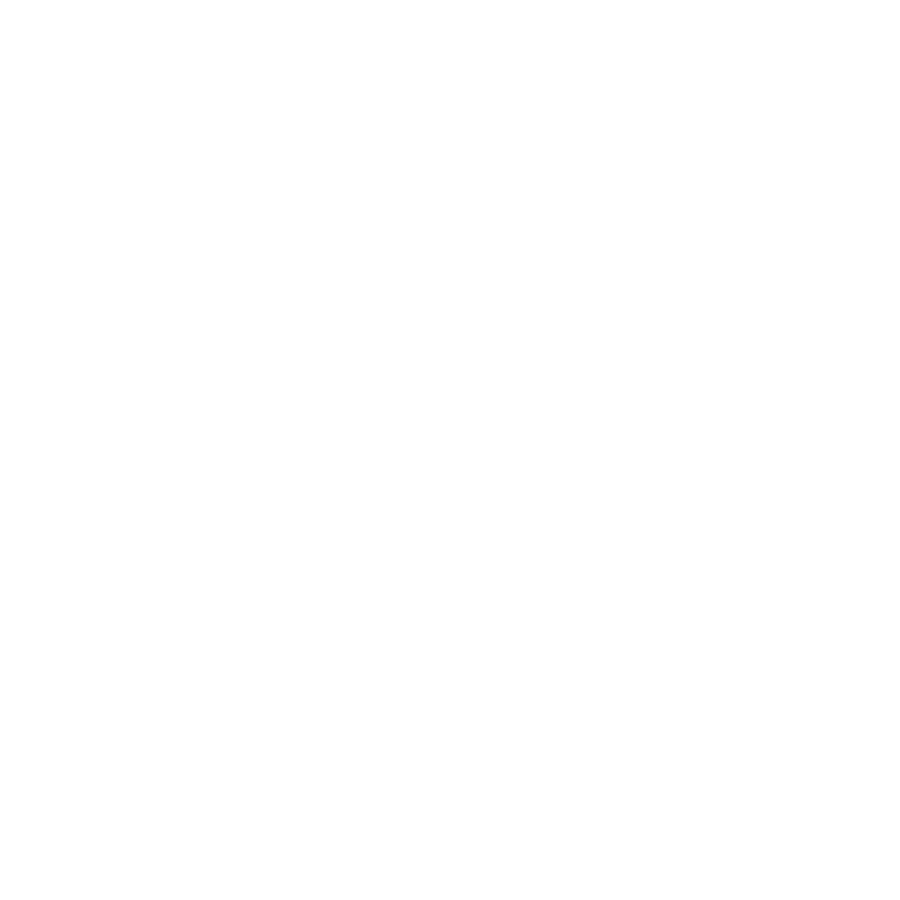

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_SFL
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_STGa
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_STSda
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq g

<IPython.core.display.Javascript object>


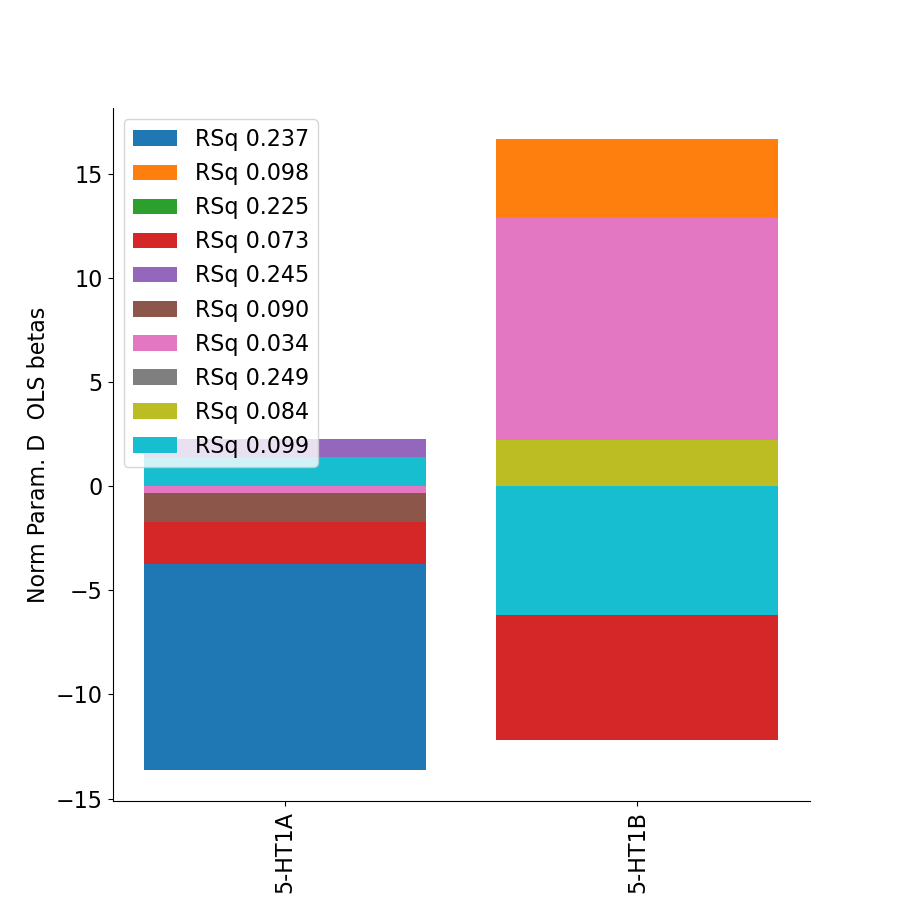

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_TF
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 30
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-38.9759  -0.0282]
wRSq 0.05735881747893046
wCC prediction 0.23949700933191292


<IPython.core.display.Javascript object>


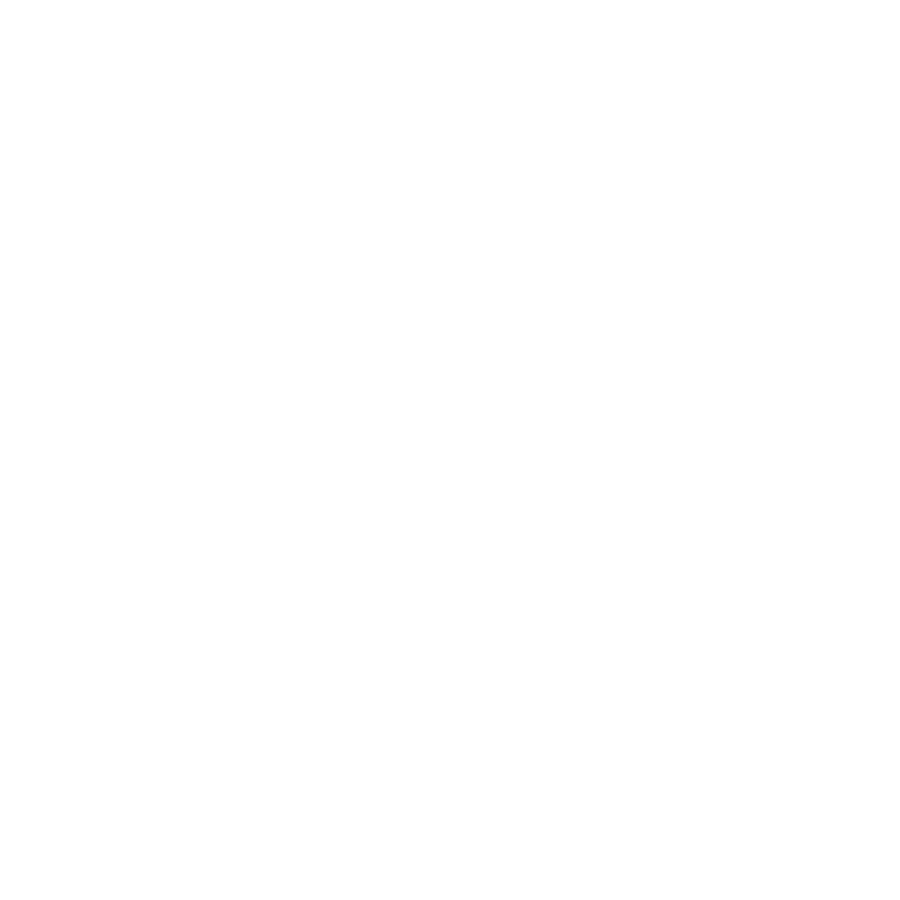

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_TGd
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_TGv
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_TPOJ1
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq gl

<IPython.core.display.Javascript object>


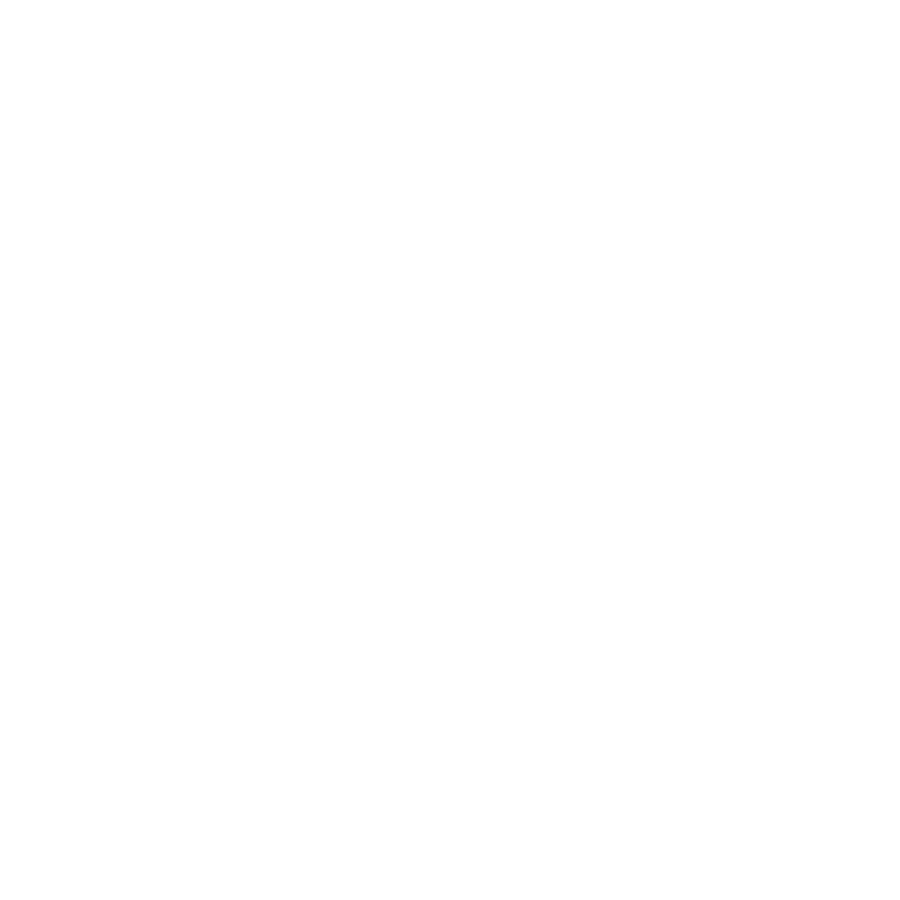

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_TPOJ3
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 580
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-1.4763 -0.015 ]
wRSq 0.024888893488109853
wCC prediction 0.15776214212576434


<IPython.core.display.Javascript object>


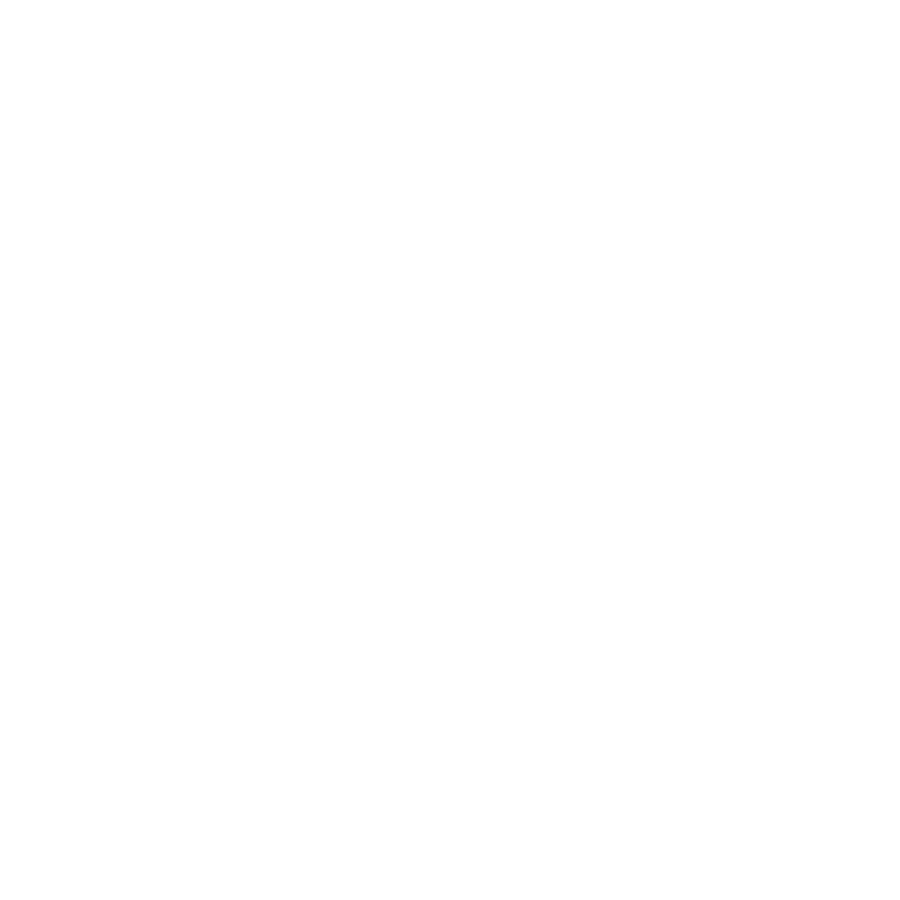

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V1
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 4593
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [15.9004 -0.0008]
wRSq 0.45837091529595164
wCC prediction 0.6770309559362501


<IPython.core.display.Javascript object>


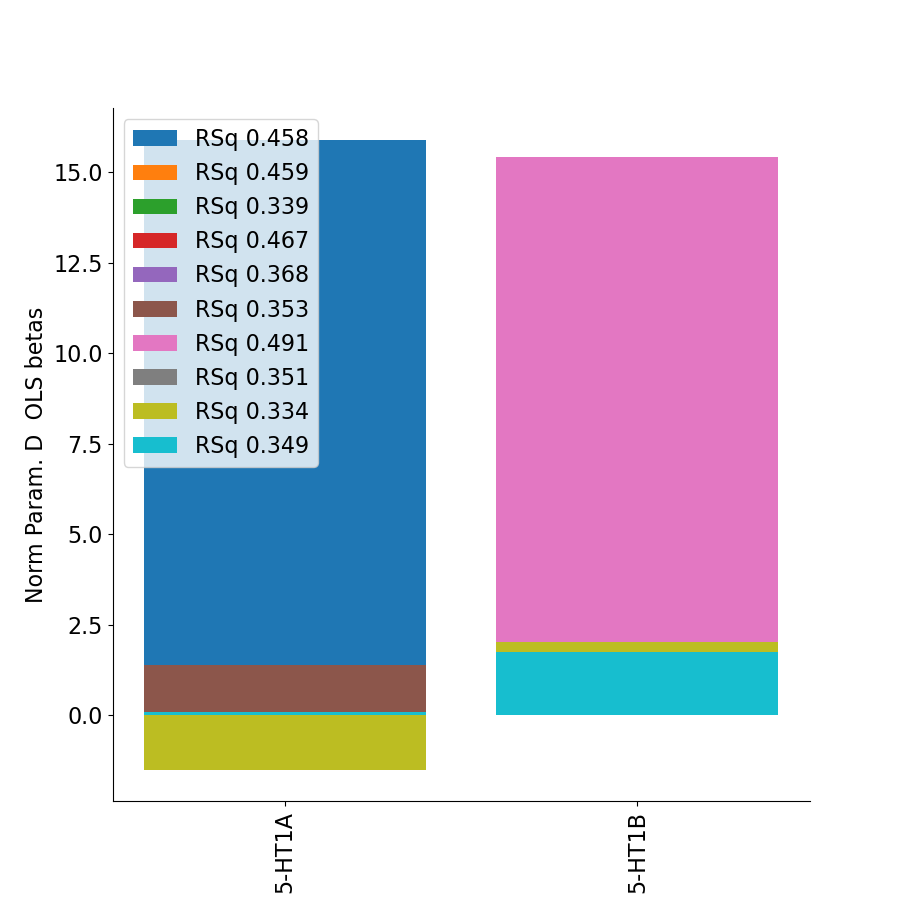

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V2
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 3472
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [9.8033 0.0153]
wRSq 0.19815134543919322
wCC prediction 0.4451419385310634


<IPython.core.display.Javascript object>


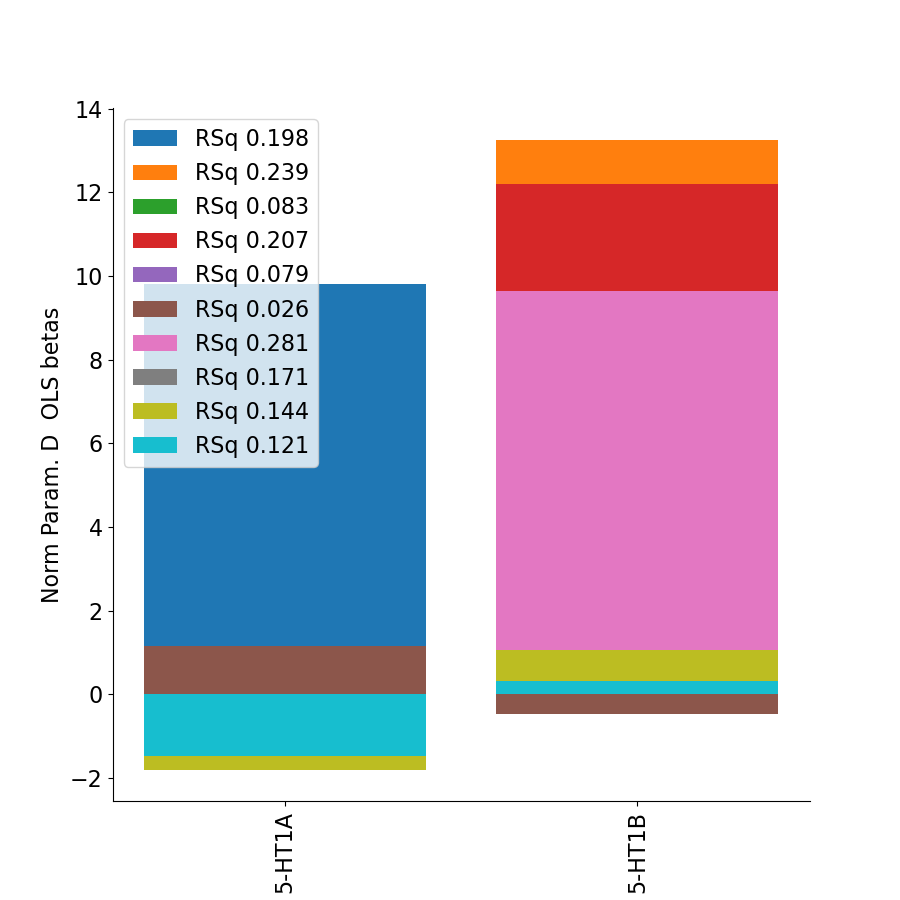

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_v23ab
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V3
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 2929
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 2.0821 -0.0743]
wRSq 0.06385723738851556
wCC prediction 0.2526998959012755


<IPython.core.display.Javascript object>


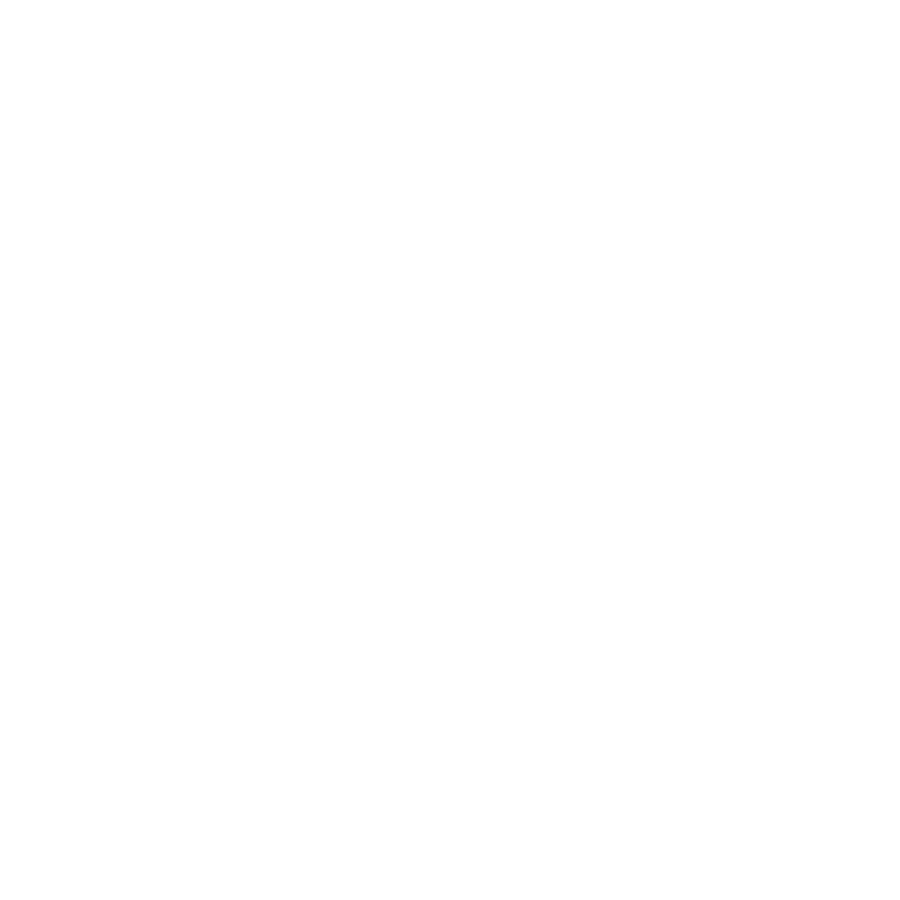

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V3A
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1205
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-3.2469  0.333 ]
wRSq 0.17859574744556672
wCC prediction 0.422605900864584


<IPython.core.display.Javascript object>


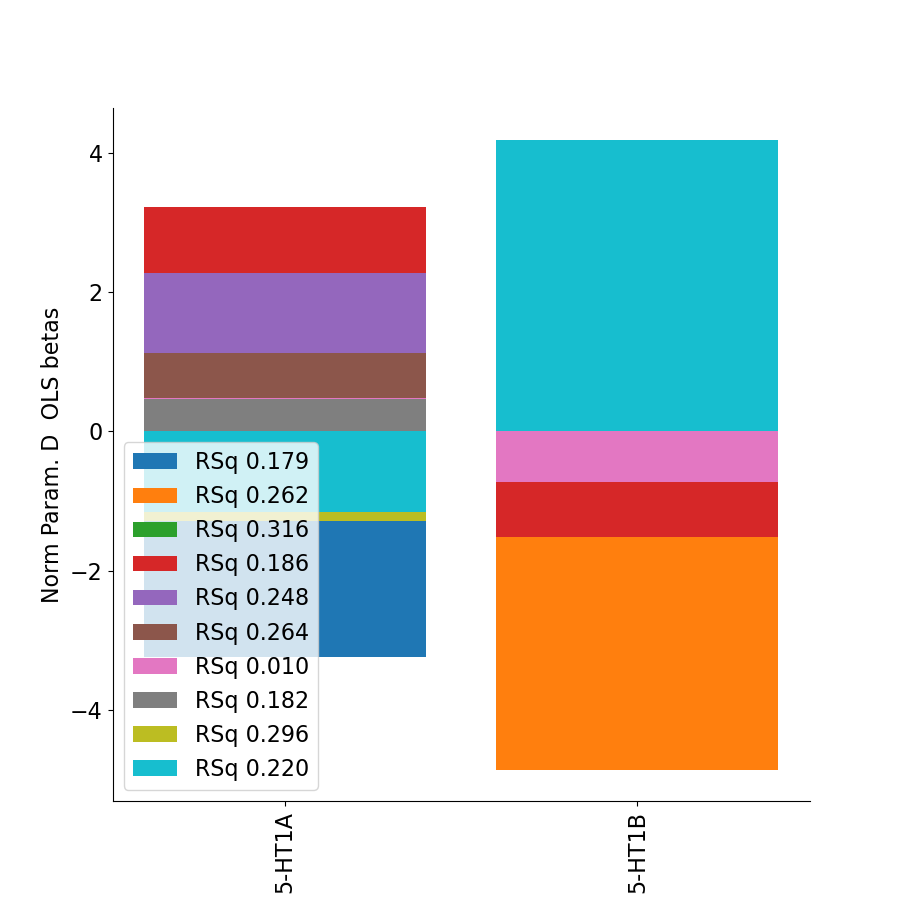

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V3B
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 734
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [6.953  0.0187]
wRSq 0.36609014485774827
wCC prediction 0.605053836330081


<IPython.core.display.Javascript object>


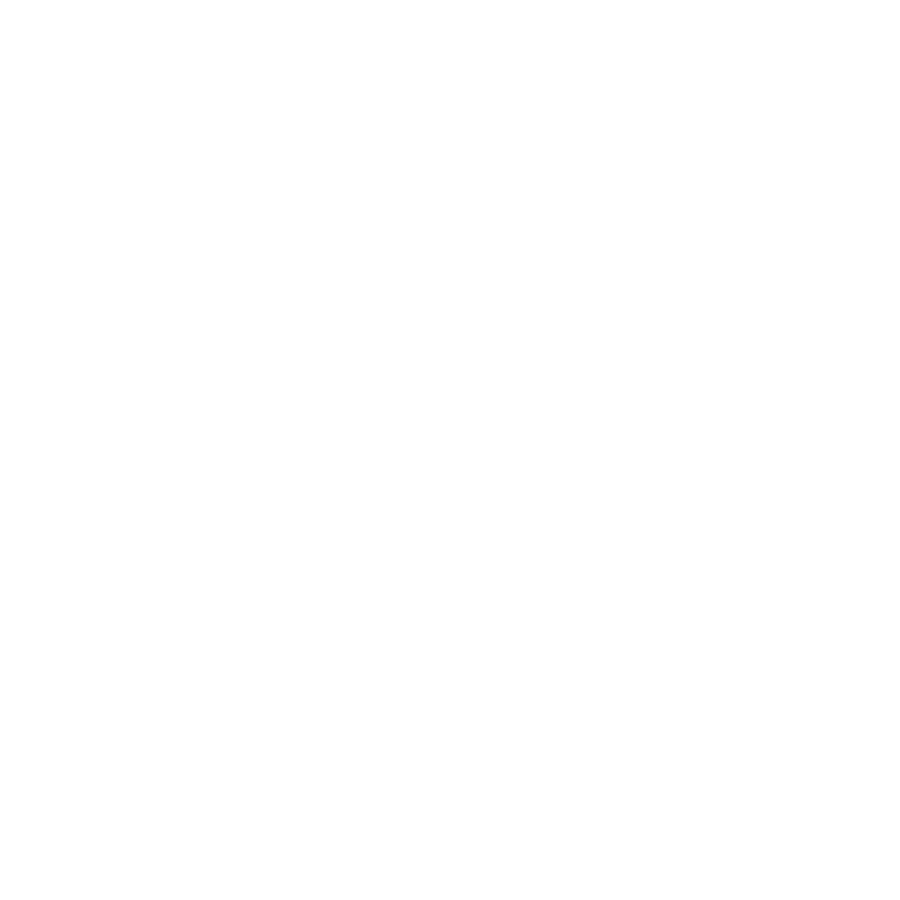

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V3CD
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 768
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 3.2814 -0.0367]
wRSq 0.12230235767788444
wCC prediction 0.34971753984878173


<IPython.core.display.Javascript object>


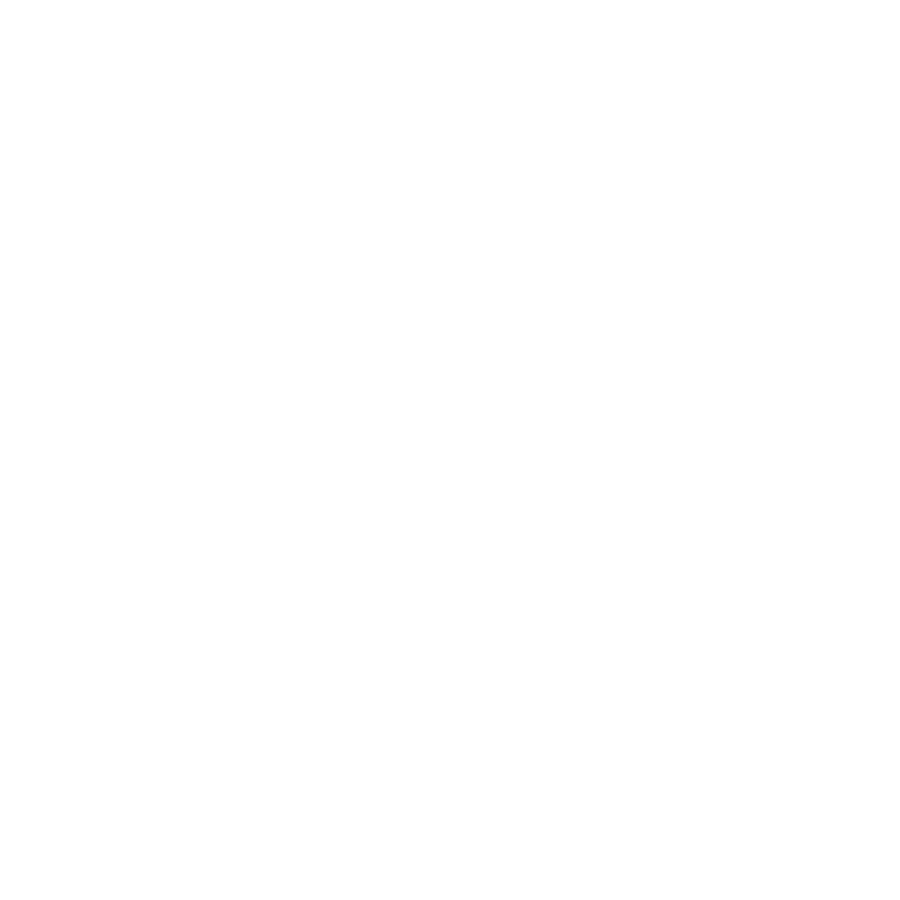

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V4
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 2858
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-3.1574 -0.0984]
wRSq 0.1156874508264053
wCC prediction 0.3401285798435723


<IPython.core.display.Javascript object>


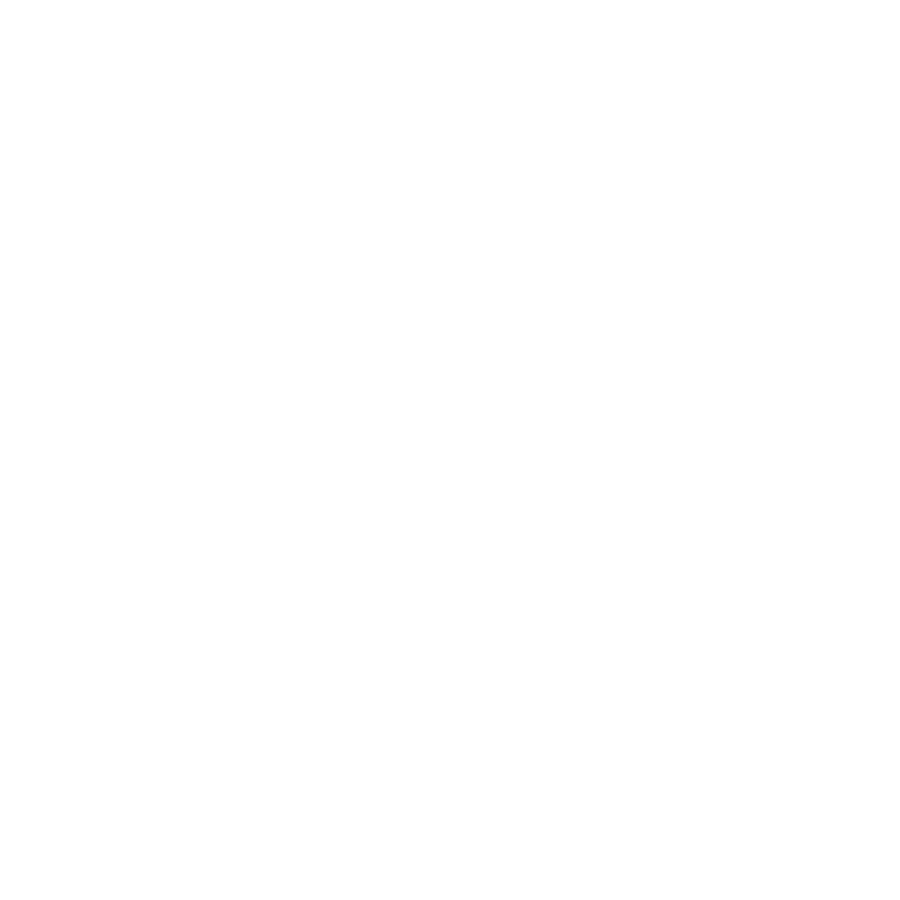

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V4t
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 455
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 1.3604 -0.1418]
wRSq 0.11719204154157525
wCC prediction 0.34233323172250624


<IPython.core.display.Javascript object>


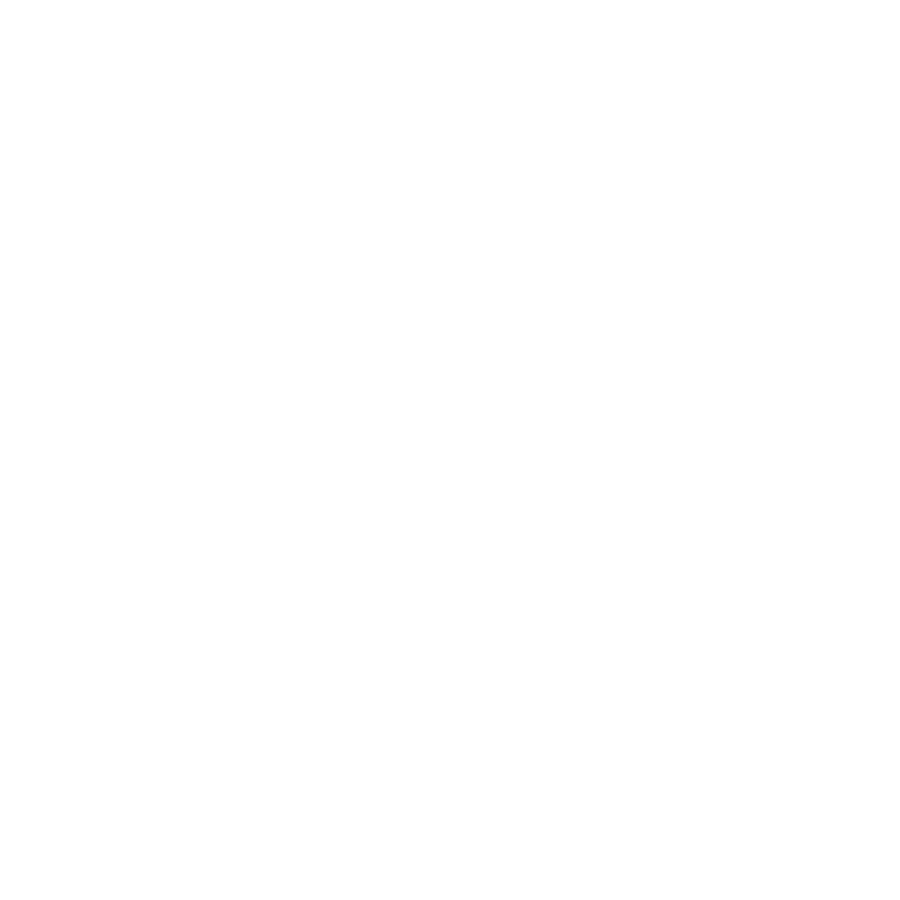

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V6
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 246
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-4.1815 -0.0108]
wRSq 0.03926440591826719
wCC prediction 0.1981524814840009


<IPython.core.display.Javascript object>


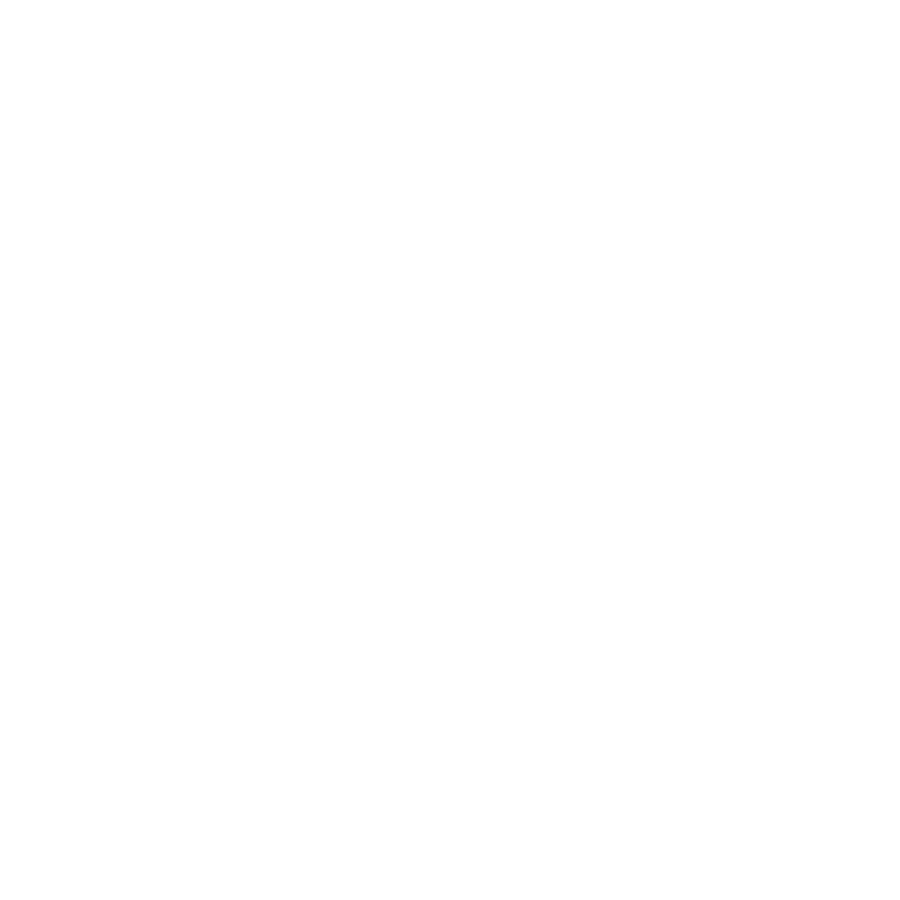

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V6A
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 493
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [1.2129 0.067 ]
wRSq 0.00880855897463606
wCC prediction 0.09385392359745036


<IPython.core.display.Javascript object>


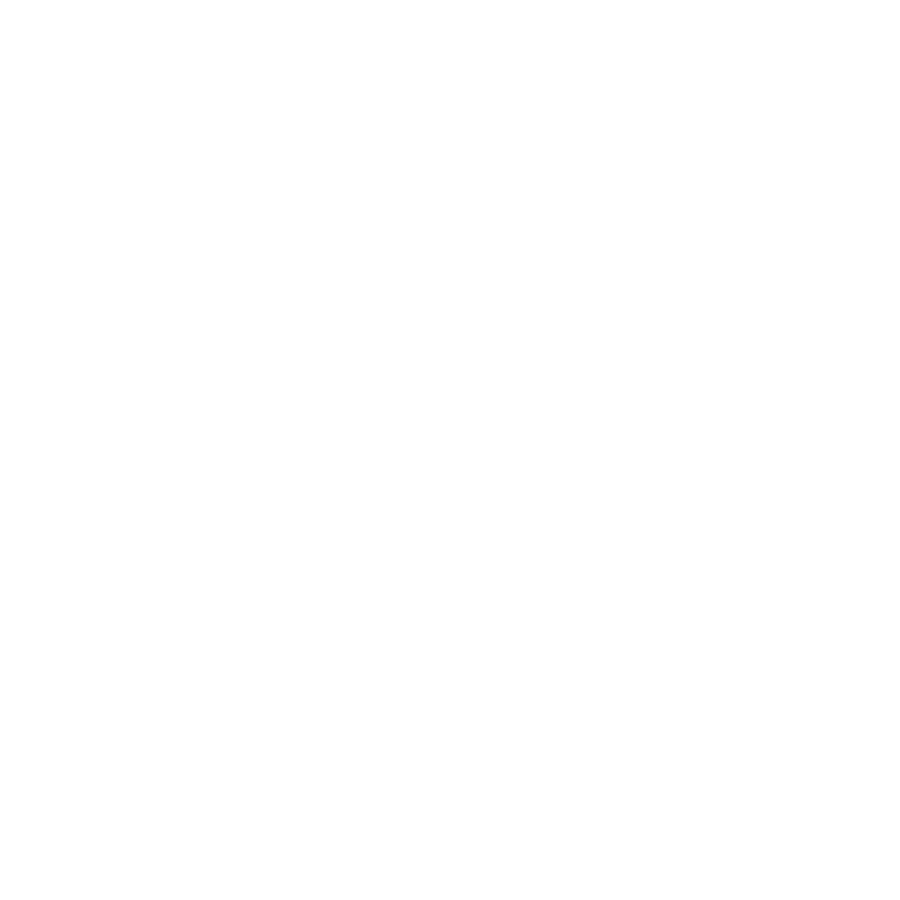

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V7
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 560
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [2.1393 0.0392]
wRSq 0.05368618941519021
wCC prediction 0.23170280407278254


<IPython.core.display.Javascript object>


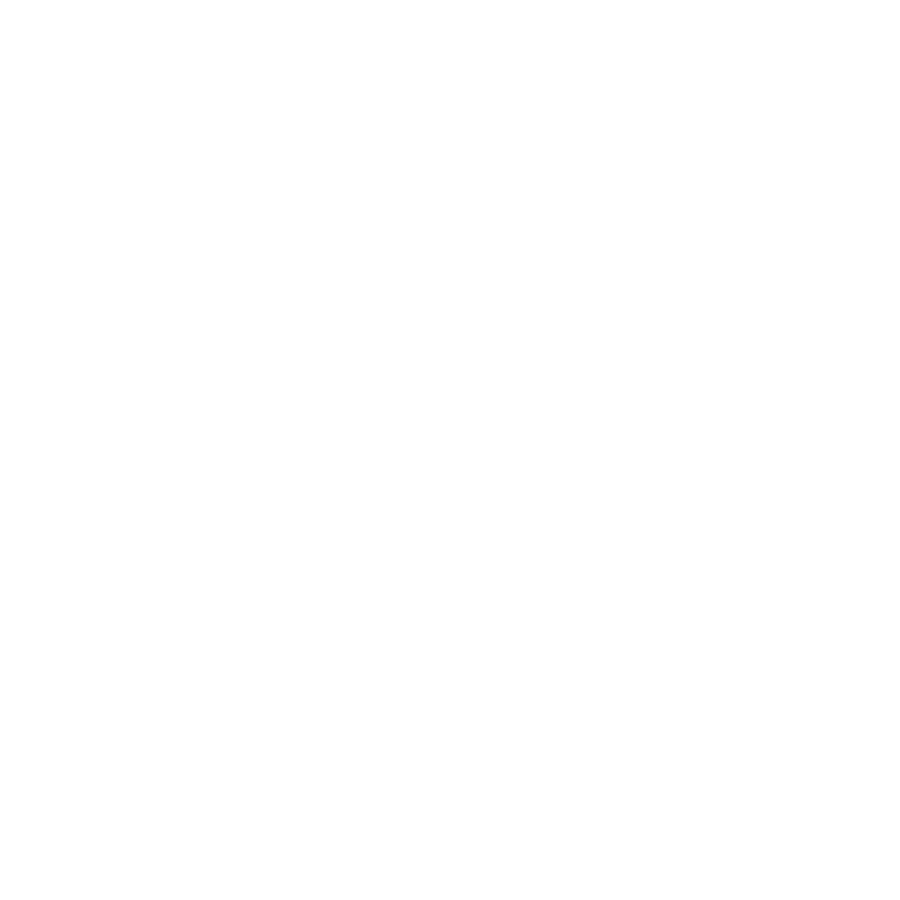

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V8
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 653
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-6.7132  0.0043]
wRSq 0.22498445463741024
wCC prediction 0.4743252624912678


<IPython.core.display.Javascript object>


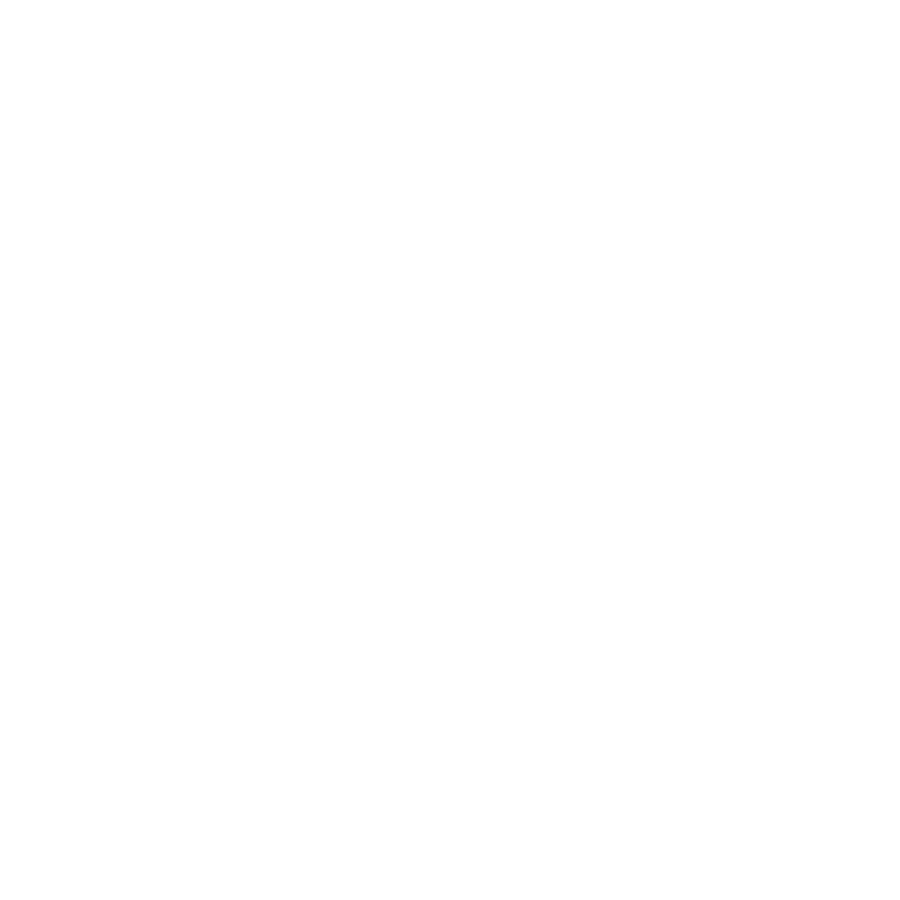

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_VIP
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1224
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-8.1785  0.0004]
wRSq 0.09872804160656512
wCC prediction 0.31421018698725395


<IPython.core.display.Javascript object>


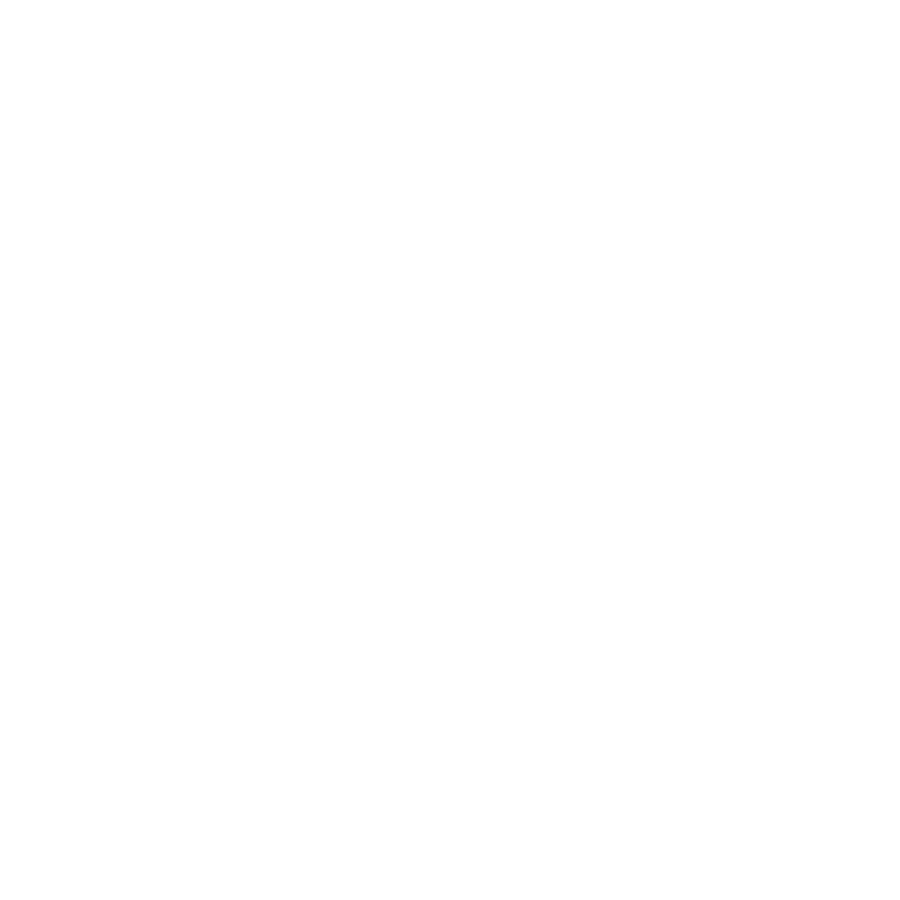

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_VMV1
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 44
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 4.1518 -0.1319]
wRSq 0.36596438709959567
wCC prediction 0.6049499046198747


<IPython.core.display.Javascript object>


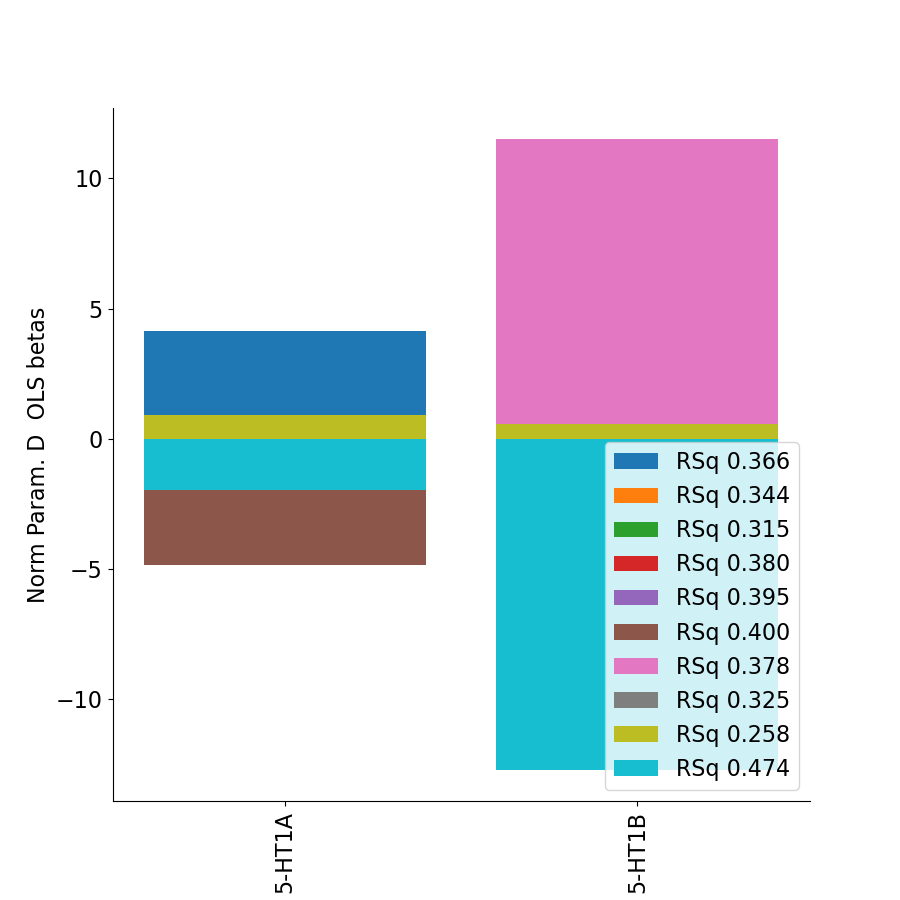

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_VMV2
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 541
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 4.1081 -0.0548]
wRSq 0.207469051596466
wCC prediction 0.45548770740434474


<IPython.core.display.Javascript object>


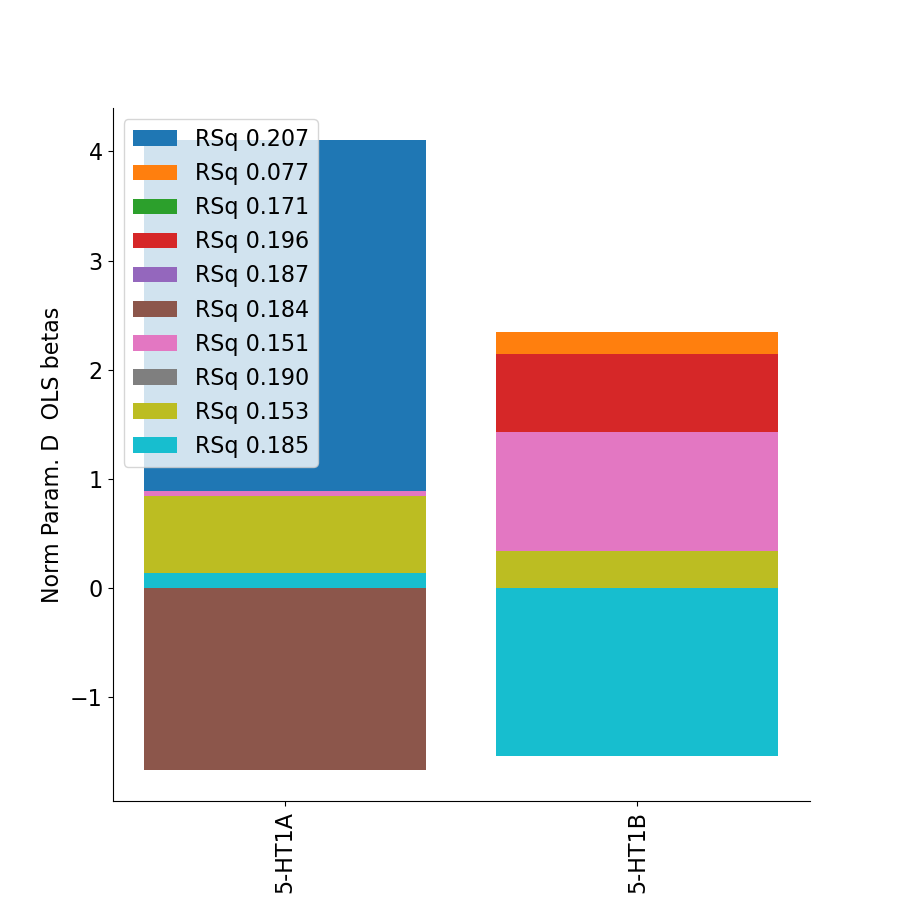

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_VMV3
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 662
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-4.3786 -0.027 ]
wRSq 0.08334362182773569
wCC prediction 0.2886929542398562


<IPython.core.display.Javascript object>


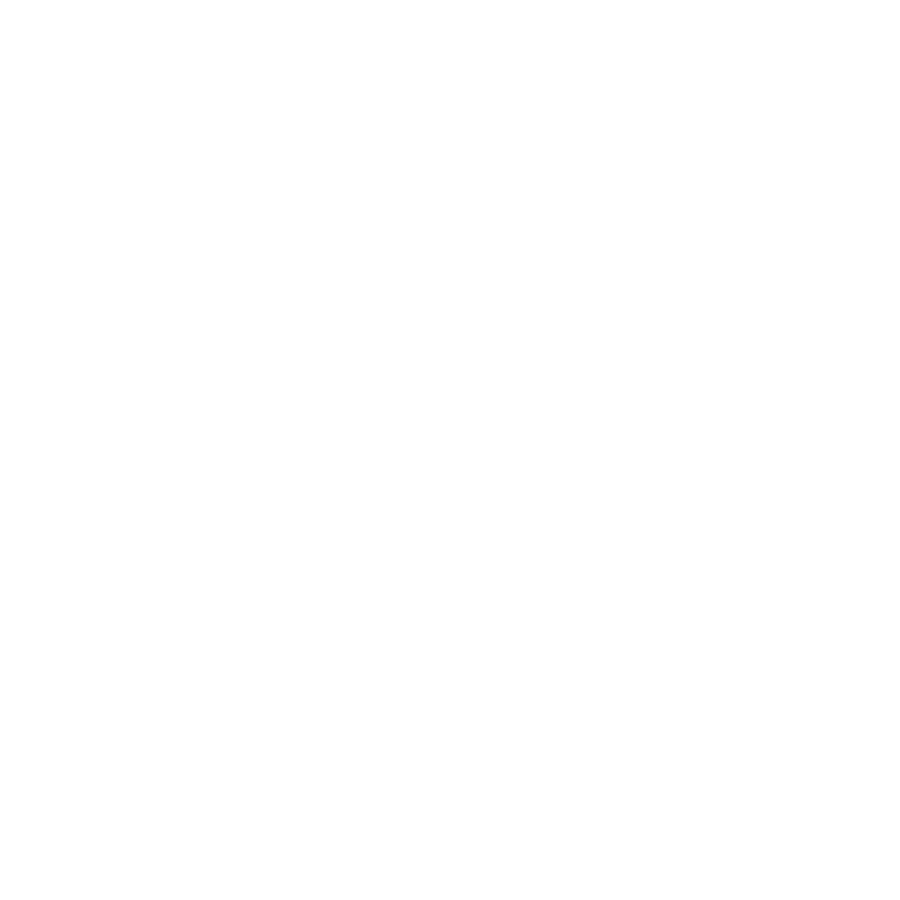

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_VVC
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1002
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 1.0975 -0.1069]
wRSq 0.15415144776695489
wCC prediction 0.3926212523118879


<IPython.core.display.Javascript object>


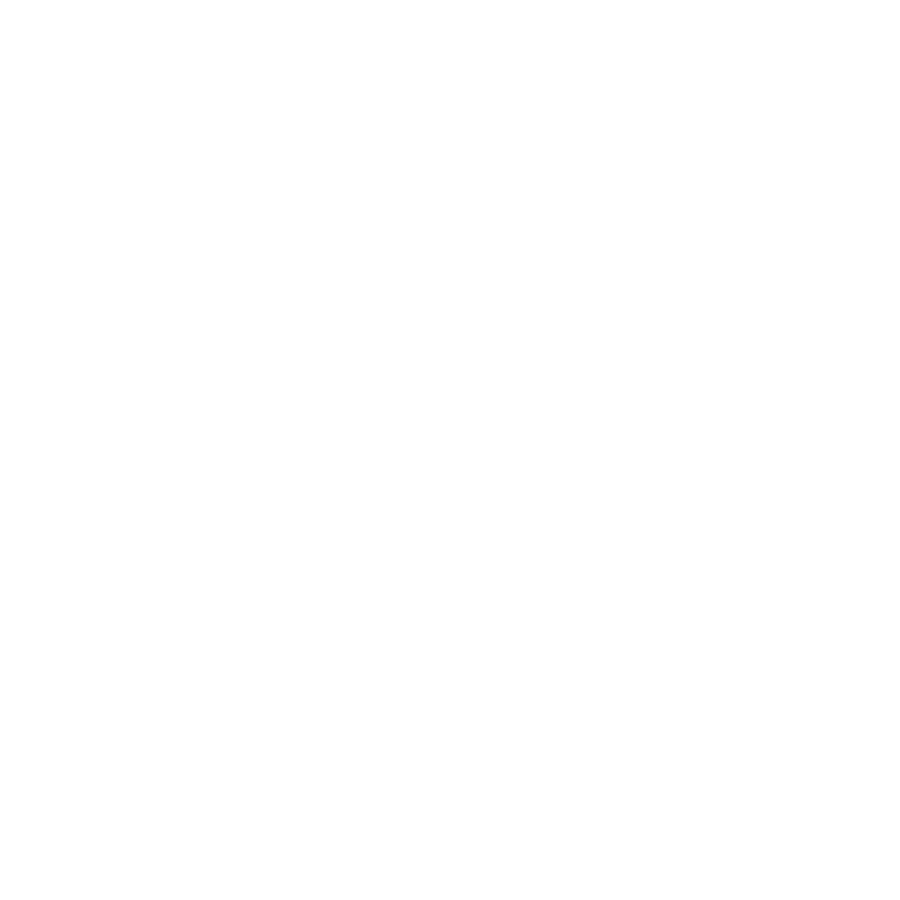

fit-task-BAR_fit-runs-all fsaverage_cvrsq combined
X-dims: ['5-HTT', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HTT', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 59942
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [2.3073 0.0907]
wRSq 0.45760389377637356
wCC prediction 0.676464259053184


<IPython.core.display.Javascript object>


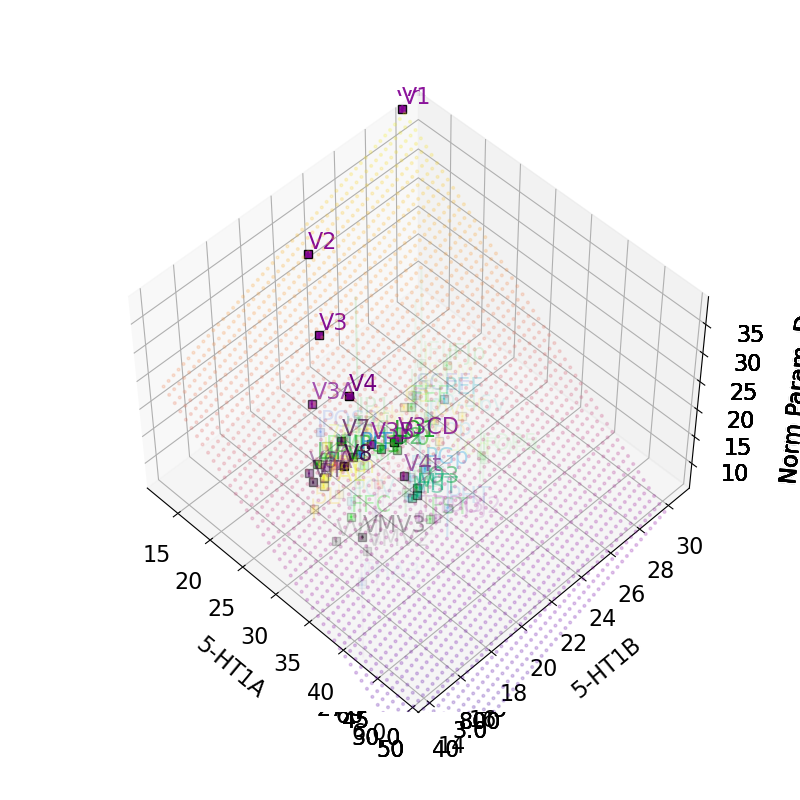

wR2 (fit on full data, eval on roi means), by sklearn: 0.018
wCC prediction (fit on full data, eval on roi means) 0.5198

wR2 (fit on roi means, eval on roi means), by sklearn: 0.3159
wCC prediction (fit on roi means, eval on roi means) 0.5620
Estimated OLS betas (fit on roi means) Norm Param. D Norm_abcd [-1.6899  0.0851]

wR2 (fit on full data, eval on full data), by sklearn: 0.4576
wCC prediction (fit on full data, eval on full data) 0.6765
Estimated OLS betas (fit on full data) Norm Param. D Norm_abcd [2.3073 0.0907]


<IPython.core.display.Javascript object>


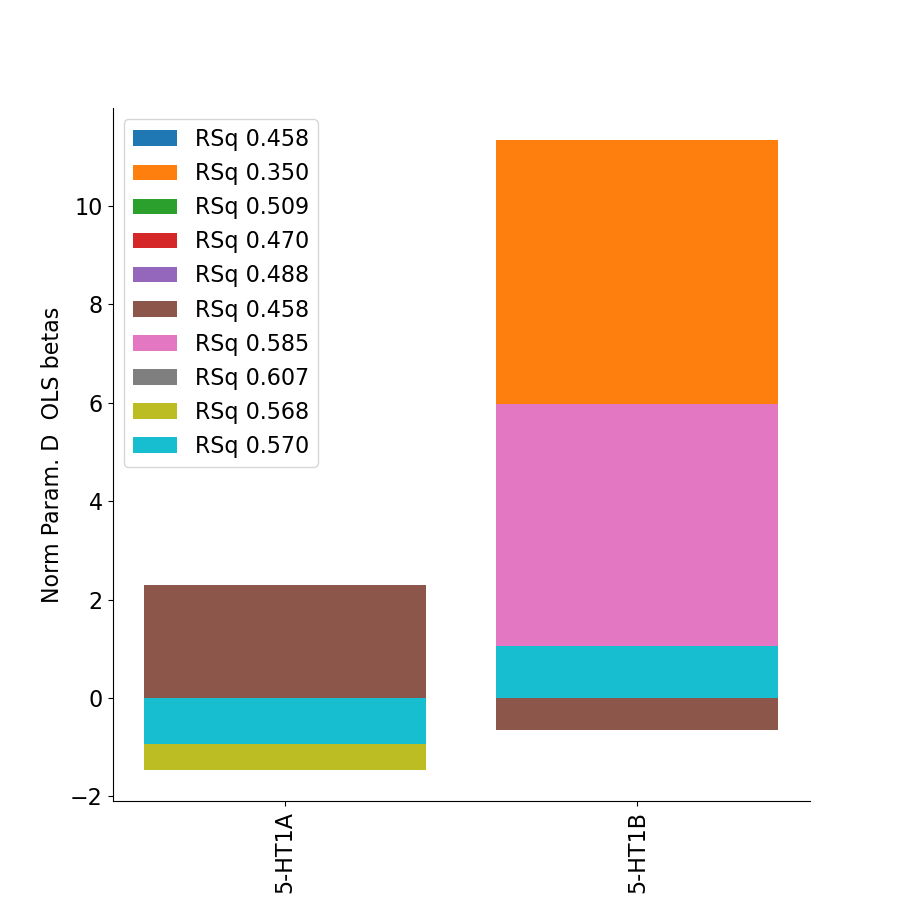

fsaverage fit-task-BAR_fit-runs-all fsaverage_cvrsq
Make sure bold_voxel_volume is specified in mm^3
Upsampling correction factor: [2.1213]
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimens

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimen

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_45
X-dims: ['5-HT2A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT2A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_46
X-dims: ['5-HT2A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT2A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 407
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-0.5006 -0.4539]
wRSq 0.011643826278820657
wCC prediction 0.10790656272359185
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_47l
X-dims: ['5-HT2A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT2A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FFC
X-dims: ['5-HT2A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT2A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1265
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-0.4166  3.686 ]
wRSq 0.08604542960797579
wCC prediction 0.29333501258454614
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FOP1
X-dims: ['5-HT2A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT2A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FOP2
X-dims: ['5-HT2A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT2A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PHA1
X-dims: ['5-HT2A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT2A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PHA2
X-dims: ['5-HT2A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT2A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PHA3
X-dims: ['5-HT2A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT2A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 216
performing OLS (1D y)
Estimated OLS betas

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V7
X-dims: ['5-HT2A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT2A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 560
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [0.2229 3.4742]
wRSq 0.053977972050291645
wCC prediction 0.23233159933657702
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V8
X-dims: ['5-HT2A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT2A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 653
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-0.3273 -6.9824]
wRSq 0.2403264677631003
wCC prediction 0.49023103508764126
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_VIP
X-dims: ['5-HT2A', '5-

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimen

Estimated OLS betas Norm Param. D Norm_abcd [ 0.7689 -0.0973]
wRSq 0.2645360453236818
wCC prediction 0.514330677019835
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_6a
X-dims: ['5-HT2A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT2A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 2974
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-0.0013  0.0254]
wRSq 0.019741043300423256
wCC prediction 0.14050282310481652
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_6d
X-dims: ['5-HT2A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT2A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 153
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 0.2151 -0.102 ]
wRSq 0.04

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FOP5
X-dims: ['5-HT2A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT2A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 101
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-2.332   0.1293]
wRSq 0.15222559543414982
wCC prediction 0.390160986560868
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FST
X-dims: ['5-HT2A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT2A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 781
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-0.2195  0.0173]
wRSq 0.008999538969790999
wCC prediction 0.09486589993138118
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_H
X-dims: ['5-HT2A

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PeEc
X-dims: ['5-HT2A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT2A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PEF
X-dims: ['5-HT2A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT2A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 705
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-0.048   0.0313]
wRSq 0.043729729612798196
wCC prediction 0.2091165455261685
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PF
X-dims: ['5-HT2A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT2A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A',

Estimated OLS betas Norm Param. D Norm_abcd [-0.8267 -0.0725]
wRSq 0.09529976087086711
wCC prediction 0.3087065935007984
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V3A
X-dims: ['5-HT2A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT2A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1205
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [0.7879 0.2134]
wRSq 0.3160002778198151
wCC prediction 0.5621390200117895
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V3B
X-dims: ['5-HT2A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT2A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 734
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [0.1607 0.0317]
wRSq 0.19383

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimen

Estimated OLS betas Norm Param. D Norm_abcd [-1.2574  1.1963]
wRSq 0.004299644770627498
wCC prediction 0.06557167658850312
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_47l
X-dims: ['5-HT1B', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_47m
X-dims: ['5-HT1B', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_47s
X-dims: ['5-HT1B', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Par

Estimated OLS betas Norm Param. D Norm_abcd [0.0226 5.5923]
wRSq 0.07082267076320525
wCC prediction 0.26612529147603636
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FOP1
X-dims: ['5-HT1B', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FOP2
X-dims: ['5-HT1B', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FOP3
X-dims: ['5-HT1B', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Par

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_p47r
X-dims: ['5-HT1B', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_p9-46v
X-dims: ['5-HT1B', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 93
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-4.4509 -0.4704]
wRSq 0.028628781216161858
wCC prediction 0.16920041730492852
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PBelt
X-dims: ['5-HT1B', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A',

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V2
X-dims: ['5-HT1B', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 3472
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-0.7874 12.2028]
wRSq 0.20747704634241237
wCC prediction 0.4554964833480193
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_v23ab
X-dims: ['5-HT1B', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V3
X-dims: ['5-HT1B', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HT

fsaverage fit-task-BAR_fit-runs-all fsaverage_cvrsq
Make sure bold_voxel_volume is specified in mm^3
Upsampling correction factor: [2.1213]
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimens

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimen

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_5m
X-dims: ['5-HT1B', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_5mv
X-dims: ['5-HT1B', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 370
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 3.582  -0.0635]
wRSq 0.11672322719584105
wCC prediction 0.3416478116362534
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_6a
X-dims: ['5-HT1B', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5

performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-0.328  -0.0599]
wRSq 0.09621695542235775
wCC prediction 0.31018858041900543
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FOP1
X-dims: ['5-HT1B', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FOP2
X-dims: ['5-HT1B', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FOP3
X-dims: ['5-HT1B', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A'

Estimated OLS betas Norm Param. D Norm_abcd [ 3.0951 -0.0416]
wRSq 0.1273980089786202
wCC prediction 0.3569285768590407
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_OFC
X-dims: ['5-HT1B', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_OP1
X-dims: ['5-HT1B', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_OP2-3
X-dims: ['5-HT1B', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Nor

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_TPOJ3
X-dims: ['5-HT1B', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 580
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-0.9277 -0.0116]
wRSq 0.044399977705235516
wCC prediction 0.2107130221539131
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V1
X-dims: ['5-HT1B', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 4593
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [1.0949 0.0625]
wRSq 0.36800284954246143
wCC prediction 0.6066323841853993
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V2
X-dims: ['5-HT1B

wR2 (fit on full data, eval on roi means), by sklearn: 0.286
wCC prediction (fit on full data, eval on roi means) 0.6409

wR2 (fit on roi means, eval on roi means), by sklearn: 0.4326
wCC prediction (fit on roi means, eval on roi means) 0.6577
Estimated OLS betas (fit on roi means) Norm Param. D Norm_abcd [1.3276 0.0405]

wR2 (fit on full data, eval on full data), by sklearn: 0.4881
wCC prediction (fit on full data, eval on full data) 0.6986
Estimated OLS betas (fit on full data) Norm Param. D Norm_abcd [0.9488 0.0692]
fsaverage fit-task-BAR_fit-runs-all fsaverage_cvrsq
Make sure bold_voxel_volume is specified in mm^3
Upsampling correction factor: [2.1213]
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimen

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_33pr
X-dims: ['5-HT1B', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_3a
X-dims: ['5-HT1B', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_3b
X-dims: ['5-HT1B', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_AVI
X-dims: ['5-HT1B', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 58
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-6.9994  0.8295]
wRSq 0.11093332599919137
wCC prediction 0.3330665489045567
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_d23ab
X-dims: ['5-HT1B', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_d32
X-dims: ['5-HT1B', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A',

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_LO3
X-dims: ['5-HT1B', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 672
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [1.0873 0.0768]
wRSq 0.024700763454690744
wCC prediction 0.15716476530918316
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MBelt
X-dims: ['5-HT1B', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MI
X-dims: ['5-HT1B', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A',

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_STGa
X-dims: ['5-HT1B', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_STSda
X-dims: ['5-HT1B', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_STSdp
X-dims: ['5-HT1B', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage

Estimated OLS betas Norm Param. D Norm_abcd [ 0.8358 -0.1631]
wRSq 0.04373661889744118
wCC prediction 0.2091330172341065
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_VMV1
X-dims: ['5-HT1B', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 44
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-4.848   0.4839]
wRSq 0.39980811557206763
wCC prediction 0.6323038158765668
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_VMV2
X-dims: ['5-HT1B', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1B', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 541
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-1.6597  0.0982]
wRSq 0.

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimen

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_44
X-dims: ['5-HT1A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 2
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_45
X-dims: ['5-HT1A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_46
X-dims: ['5-HT1A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 407
performing OLS (1D y)
Estimated OLS betas Norm 

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_AVI
X-dims: ['5-HT1A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 58
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [  2.0015 -36.7352]
wRSq 0.0844946057328625
wCC prediction 0.29067955850534566
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_d23ab
X-dims: ['5-HT1A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_d32
X-dims: ['5-HT1A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-

performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 0.0297 -0.5762]
wRSq 0.0007415686463497773
wCC prediction 0.027231758047354844
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MBelt
X-dims: ['5-HT1A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MI
X-dims: ['5-HT1A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MIP
X-dims: ['5-HT1A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V3A
X-dims: ['5-HT1A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1205
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 0.4814 -0.7277]
wRSq 0.009595113869733773
wCC prediction 0.097954652108686
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V3B
X-dims: ['5-HT1A', '5-HTT']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HTT', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 734
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [0.2903 8.8163]
wRSq 0.36228159355401524
wCC prediction 0.6018983249303951
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V3CD
X-dims: ['5-HT1A', '

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimen

ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_5mv
X-dims: ['5-HT1A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 370
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 2.3197 -0.0985]
wRSq 0.14786559716928416
wCC prediction 0.38453295979575525
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_6a
X-dims: ['5-HT1A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 2974
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_EC
X-dims: ['5-HT1A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FEF
X-dims: ['5-HT1A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1242
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 0.6159 -0.0056]
wRSq 0.038592231937579546
wCC prediction 0.1964490568508271
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FFC
X-dims: ['5-HT1A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A',

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MBelt
X-dims: ['5-HT1A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MI
X-dims: ['5-HT1A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MIP
X-dims: ['5-HT1A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1433
performing OLS (1D y)
Estimated OLS 

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_s6-8
X-dims: ['5-HT1A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_SCEF
X-dims: ['5-HT1A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 297
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-2.9674  0.2149]
wRSq 0.07086138661730979
wCC prediction 0.2661980214376317
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_SFL
X-dims: ['5-HT1A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A'

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_VIP
X-dims: ['5-HT1A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1224
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 0.3579 -0.0368]
wRSq 0.04668077189635855
wCC prediction 0.2160573347432544
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_VMV1
X-dims: ['5-HT1A', 'GABA_A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', 'GABA_A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 44
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 0.344  -0.2326]
wRSq 0.3247665306795895
wCC prediction 0.5698829096223096
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_VMV2
X-dims: ['5-HT1

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimen

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_45
X-dims: ['5-HT1A', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_46
X-dims: ['5-HT1A', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 407
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-1.4899 -0.2836]
wRSq 0.03648072925162771
wCC prediction 0.190999291233312
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_47l
X-dims: ['5-HT1A', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_8C
X-dims: ['5-HT1A', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 8
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_9-46d
X-dims: ['5-HT1A', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 32
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-3.5587 -2.6501]
wRSq 0.19313528718884077
wCC prediction 0.43947159997984014
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_9a
X-dims: ['5-HT1A', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', 

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_IPS1
X-dims: ['5-HT1A', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1187
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-0.0374 -0.2839]
wRSq 0.029888901644274046
wCC prediction 0.17288406995519898
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_LBelt
X-dims: ['5-HT1A', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_LIPd
X-dims: ['5-HT1A', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PGs
X-dims: ['5-HT1A', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PH
X-dims: ['5-HT1A', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1312
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [0.266  0.0474]
wRSq 0.015979259892984543
wCC prediction 0.1264090973505642
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PHA1
X-dims: ['5-HT1A', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', 

Estimated OLS betas Norm Param. D Norm_abcd [-1.2221  0.1359]
wRSq 0.30476124359857604
wCC prediction 0.5520518486506278
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V4
X-dims: ['5-HT1A', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 2858
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-2.1271  0.4833]
wRSq 0.4981815988201852
wCC prediction 0.7058198061971523
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V4t
X-dims: ['5-HT1A', '5-HT2A']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT2A', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 455
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [ 0.4687 -0.861 ]
wRSq 0.03

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Ordered dimen

Estimated OLS betas Norm Param. D Norm_abcd [-5.6928  8.214 ]
wRSq 0.08600924409152999
wCC prediction 0.2932733265940322
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_47l
X-dims: ['5-HT1A', '5-HT1B']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT1B', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_47m
X-dims: ['5-HT1A', '5-HT1B']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT1B', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_47s
X-dims: ['5-HT1A', '5-HT1B']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT1B', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_d23ab
X-dims: ['5-HT1A', '5-HT1B']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT1B', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_d32
X-dims: ['5-HT1A', '5-HT1B']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT1B', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_DVT
X-dims: ['5-HT1A', '5-HT1B']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT1B', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 728
performing OLS (1D y)
Estimated OLS 

Estimated OLS betas Norm Param. D Norm_abcd [0.0155 1.0502]
wRSq 0.023166360571331035
wCC prediction 0.1522049952246339
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MBelt
X-dims: ['5-HT1A', '5-HT1B']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT1B', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MI
X-dims: ['5-HT1A', '5-HT1B']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT1B', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MIP
X-dims: ['5-HT1A', '5-HT1B']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT1B', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_s6-8
X-dims: ['5-HT1A', '5-HT1B']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT1B', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_SCEF
X-dims: ['5-HT1A', '5-HT1B']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT1B', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 297
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-1.8105  7.9132]
wRSq 0.028725028708330824
wCC prediction 0.1694845972598413
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_SFL
X-dims: ['5-HT1A', '5-HT1B']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT1B', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A

Estimated OLS betas Norm Param. D Norm_abcd [-0.946   1.8073]
wRSq 0.042072168791218
wCC prediction 0.20511501356852965
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V8
X-dims: ['5-HT1A', '5-HT1B']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT1B', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 653
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [-0.3358  0.2133]
wRSq 0.040531475260585315
wCC prediction 0.20132430370073368
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_VIP
X-dims: ['5-HT1A', '5-HT1B']
Y-dims: ['Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT1B', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd']
Sample size: 1224
performing OLS (1D y)
Estimated OLS betas Norm Param. D Norm_abcd [0.1727 1.2791]
wRSq 0.04

0

In [18]:
#%%capture
#display(HTML("<style>div.output_scroll { height: 150em; }</style>"))
pl.close('all')
#fsnative vox vol for correction: 4.8270
#generalized quantitative parameter plots
#'Eccentricity'#'Suppression Index (full)'#'Suppression Index#'Size (fwhmax)'#'Surround Size (fwatmin)'
#'Norm Param. B'#''Ratio (B/D)'#'Norm Param. D'#'RSq'#'CCrsq_task-1R'#'CSS Exponent'#'Amplitude'
#'Surround Amplitude'#'Size (sigma_1)'##'Size (sigma_2)'
#'Size ratio (sigma_2/sigma_1)'#C/A#'B/A'#'D/C'#'D/A'#'B/C'#'Surround volume (full)'#'Centre volume (full)'
#'(A+B)/(C+D)'#'(A*B)/(C*D)'#'(A*D)/(C*B)'#'(A+D)/(C+B)'#'Point-stim derivative'#'(C(A+B))/(A(C+D))'
#'Min/Max Response Ratio'#'Max/Min Response Ratio'#'A(C+D)/C(A+B)'##Min/Max Response Ratio (with BD)'
#'A/C'
####DoG
#'Surround volume (full)'
#'Surround/Centre Amplitude' 
#'Surround-Centre Amplitude'
#'Surround-Centre Volume'

#parameters = ['Eccentricity', 'Norm Param. B', 'Norm Param. D', 'Size (sigma_1)','Size (sigma_2)', 'Amplitude','Surround Amplitude', 'Polar Angle',
#              '5-HT1A', '5-HT1B', '5-HT2A', '5-HT4', '5-HTT', 'GABA_A','Amplitude','Surround Amplitude', 'RSq']#,]#'Size ratio (sigma_2/sigma_1)']# 'Size (sigma_1)', 'Size (sigma_2)', 'Amplitude','Surround Amplitude']

parameters = ['5-HT1A', '5-HT1B', '5-HT2A', 'GABA_A', '5-HTT','Norm Param. B', 'Norm Param. D','RSq']#, 'Eccentricity','Size (sigma_1)','Size (sigma_2)']#

x_dims_idx = [0,3]
y_dims_idx = [6]

#rois = ['custom.V1', 'custom.V2', 'custom.V3','custom.V3AB','custom.hV4','custom.LO','custom.TO','custom.IPS','all_custom']
#rois = ['V1', 'V2', 'V3','V3AB','hV4','LO','TO','VO','IPS']#, 'combined']#['Brain'] #'V1', 'V2', 'V3','V3AB','hV4','LO','TO','IPS','combined', 
#rois = [ 'V1', 'V2', 'V3', 'hV4', 'VO1', 'VO2', 'PHC1', 'PHC2', 'LO1', 'LO2', 'TO1', 'TO2', 'V3A', 'V3B', 'IPS0', 'IPS1', 'IPS2', 'IPS3', 'IPS4', 'IPS5', 'SPL1', 'FEF']
#rois = ['all_custom']
rois = [roi for roi in vis_res.idx_rois['fsaverage'] if 'glasser' in roi]
# rois = ['glasser_V1','glasser_V2','glasser_V3','glasser_V4','glasser_V3A','glasser_V7','glasser_V3B','glasser_V3CD',
# 'glasser_LO1','glasser_LO2','glasser_PIT','glasser_V8','glasser_VMV3',
# 'glasser_IPS1','glasser_IP0','glasser_PGp','glasser_LO3','glasser_MT','glasser_V4t','glasser_FFC']
rois.append('combined')
        
rsq_thresh = 0.0
save_figures= False
figure_path = '/Volumes/Crucial X8/PRFMapping/Figures/attemptwnames_wang_ecc65rsq015/ols'

space_names = 'fsaverage'
#set to 'all' to plot all analyses
analysis_names = 'fit-task-BAR_fit-runs-all'#-CVmedian

subject_ids = ['fsaverage_cvrsq']#'fsaverage_hcp1sthalf', 'fsaverage_hcp2ndhalf']

threshold_li = filters.threshold_li(vis_res.main_dict[space_names][analysis_names][subject_ids[0]]['Processed Results']['#Subjects with CVRSq>0']['Norm_abcd'])

vis_res.set_alpha(only_models=['Norm_abcd'], ecc_min=0.0, ecc_max=8.0, min_number_sjs=threshold_li)

#for y_dims_idx in [[5],[6]]:
#    for x_dims_idx in [[3, 4], [2, 4], [2, 3], [1, 4], [1, 3], [1, 2], [0, 4], [0, 3], [0, 2], [0, 1]]:
for x_dims_idx in [[3, 4], [2, 4], [2, 3], [1, 4], [1, 3], [1, 2], [0, 4], [0, 3], [0, 2], [0, 1]]:    

    vis_res.multidim_analysis(parameters, rois, rsq_thresh, save_figures, figure_path, space_names = space_names, parameter_toplevel='Receptor Maps', rsq_weights= True,
                    analysis_names = analysis_names, subject_ids = subject_ids, x_dims_idx=x_dims_idx, y_dims_idx=y_dims_idx,
                          zscore_data= False, zscore_data_across_rois = False, 
                          size_response_curves = False, plot_corr_matrix = False, perform_ols = True, polar_plots = False,
                             cv_regression = False, bold_voxel_volume=4.096, zconfint_err_alpha=None, quantile_exclusion=0.999,
                          #vis_pca_comps_rois: fr which rois to make pca comp beta plots; 
                          #vis_pca_comps_axes: which comps to use in 2d plot of mean pca comp per roi
                        perform_pca = False, vis_pca_pycortex = True, vis_pca_comps_rois = ['combined'], vis_pca_comps_axes = [0,1], rsq_alpha_pca_plot = True,
                          perform_pls = False, vis_pls_pycortex = False)

os.system(f"open {sound_file}")


## PCA

HCP fit-task-BAR_fit-runs-all 100610
HCP fit-task-BAR_fit-runs-all 102311
HCP fit-task-BAR_fit-runs-all 102816
HCP fit-task-BAR_fit-runs-all 104416
HCP fit-task-BAR_fit-runs-all 105923
HCP fit-task-BAR_fit-runs-all 108323
HCP fit-task-BAR_fit-runs-all 109123
HCP fit-task-BAR_fit-runs-all 111312
HCP fit-task-BAR_fit-runs-all 111514
HCP fit-task-BAR_fit-runs-all 114823
HCP fit-task-BAR_fit-runs-all 115017
HCP fit-task-BAR_fit-runs-all 115825
HCP fit-task-BAR_fit-runs-all 116726
HCP fit-task-BAR_fit-runs-all 118225
HCP fit-task-BAR_fit-runs-all 125525
HCP fit-task-BAR_fit-runs-all 126426
HCP fit-task-BAR_fit-runs-all 128935
HCP fit-task-BAR_fit-runs-all 130114
HCP fit-task-BAR_fit-runs-all 130518
HCP fit-task-BAR_fit-runs-all 131217
HCP fit-task-BAR_fit-runs-all 131722
HCP fit-task-BAR_fit-runs-all 132118
HCP fit-task-BAR_fit-runs-all 134627
HCP fit-task-BAR_fit-runs-all 134829
HCP fit-task-BAR_fit-runs-all 135124
HCP fit-task-BAR_fit-runs-all 137128
HCP fit-task-BAR_fit-runs-all 140117
H

fsaverage fit-task-BAR_fit-runs-all 165436
fsaverage fit-task-BAR_fit-runs-all 167036
fsaverage fit-task-BAR_fit-runs-all 167440
fsaverage fit-task-BAR_fit-runs-all 169040
fsaverage fit-task-BAR_fit-runs-all 169343
fsaverage fit-task-BAR_fit-runs-all 169444
fsaverage fit-task-BAR_fit-runs-all 169747
fsaverage fit-task-BAR_fit-runs-all 171633
fsaverage fit-task-BAR_fit-runs-all 172130
fsaverage fit-task-BAR_fit-runs-all 173334
fsaverage fit-task-BAR_fit-runs-all 175237
fsaverage fit-task-BAR_fit-runs-all 176542
fsaverage fit-task-BAR_fit-runs-all 177140
fsaverage fit-task-BAR_fit-runs-all 177645
fsaverage fit-task-BAR_fit-runs-all 177746
fsaverage fit-task-BAR_fit-runs-all 178142
fsaverage fit-task-BAR_fit-runs-all 178243
fsaverage fit-task-BAR_fit-runs-all 178647
fsaverage fit-task-BAR_fit-runs-all 180533
fsaverage fit-task-BAR_fit-runs-all 181232
fsaverage fit-task-BAR_fit-runs-all 181636
fsaverage fit-task-BAR_fit-runs-all 182436
fsaverage fit-task-BAR_fit-runs-all 182739
fsaverage f

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size ratio (sigma_2/sigma_1) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size ratio (sigma_2/sigma_1) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size ratio (sigma_2/sigma_1) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size ratio (sigma_2/sigma_1) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size ratio (sigma_2/sigma_1) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size ratio (sigma_2/sigma_1) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size ratio (sigma_2/sigma_1) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size ratio (sigma_2/sigma_1) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size ratio (sigma_2/sigma_1) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size ratio (sigma_2/sigma_1) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size ratio (sigma_2/sigma_1) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size ratio (sigma_2/sigma_1) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size ratio (sigma_2/sigma_1) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size ratio (sigma_2/sigma_1) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size ratio (sigma_2/sigma_1) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size ratio (sigma_2/sigma_1) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_23c
X-dims: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A']
Y-dims: ['Size ratio (sigma_2/sigma_1) Norm_abcd', 'Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Size ratio (sigma_2/sigma_1) Norm_abcd', 'Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size ratio (sigma_2/sigma_1) Norm_abcd']
Sample size: 264
performing PCA
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_23d
X-dims: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A']
Y-dims: ['Size ratio (sigma_2/sigma_1) Norm_abcd', 'Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd']
alldims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Size ratio (sigma_2/sigma_1) Norm_abcd', 'Ecc

<IPython.core.display.Javascript object>


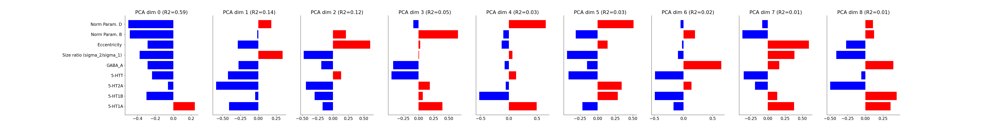

rsq thresh<0.15. setting pca pycortex vmax2=0.15
rsq thresh<0.15. setting pca pycortex vmax2=0.15
rsq thresh<0.15. setting pca pycortex vmax2=0.15
rsq thresh<0.15. setting pca pycortex vmax2=0.15
rsq thresh<0.15. setting pca pycortex vmax2=0.15
rsq thresh<0.15. setting pca pycortex vmax2=0.15
rsq thresh<0.15. setting pca pycortex vmax2=0.15
rsq thresh<0.15. setting pca pycortex vmax2=0.15
rsq thresh<0.15. setting pca pycortex vmax2=0.15


<IPython.core.display.Javascript object>


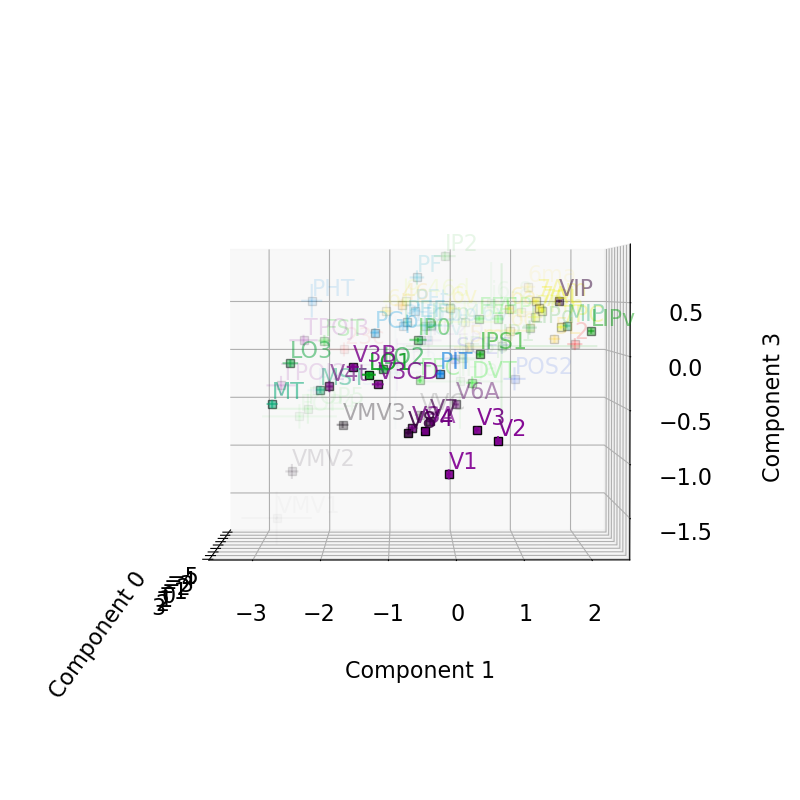

Started server on port 24717


0

In [58]:
#%%capture
#display(HTML("<style>div.output_scroll { height: 150em; }</style>"))
pl.close('all')
#generalized quantitative parameter plots
#'Eccentricity'#'Suppression Index (full)'#'Suppression Index#'Size (fwhmax)'#'Surround Size (fwatmin)'
#'Norm Param. B'#''Ratio (B/D)'#'Norm Param. D'#'RSq'#'CCrsq_task-1R'#'CSS Exponent'#'Amplitude'
#'Surround Amplitude'#'Size (sigma_1)'##'Size (sigma_2)'
#'Size ratio (sigma_2/sigma_1)'#C/A#'B/A'#'D/C'#'D/A'#'B/C'#'Surround volume (full)'#'Centre volume (full)'
#'(A+B)/(C+D)'#'(A*B)/(C*D)'#'(A*D)/(C*B)'#'(A+D)/(C+B)'#'Point-stim derivative'#'(C(A+B))/(A(C+D))'
#'Min/Max Response Ratio'#'Max/Min Response Ratio'#'A(C+D)/C(A+B)'##Min/Max Response Ratio (with BD)'
#'A/C'
####DoG
#'Surround volume (full)'
#'Surround/Centre Amplitude' 
#'Surround-Centre Amplitude'
#'Surround-Centre Volume'

#parameters = ['Eccentricity', 'Norm Param. B', 'Norm Param. D', 'Size (sigma_1)','Size (sigma_2)', 'Amplitude','Surround Amplitude', 'Polar Angle',
#              '5-HT1A', '5-HT1B', '5-HT2A', '5-HT4', '5-HTT', 'GABA_A','Amplitude','Surround Amplitude', 'RSq']#,]#'Size ratio (sigma_2/sigma_1)']# 'Size (sigma_1)', 'Size (sigma_2)', 'Amplitude','Surround Amplitude']

parameters = ['5-HT1A', '5-HT1B', '5-HT2A', 'GABA_A', '5-HTT', 'Eccentricity','Norm Param. B', 'Norm Param. D', 'Size ratio (sigma_2/sigma_1)','RSq']#

x_dims_idx = [0,1,2,3,4]
y_dims_idx = [5,6,7,8]

#rois = ['custom.V1', 'custom.V2', 'custom.V3','custom.V3AB','custom.hV4','custom.LO','custom.TO','custom.IPS','all_custom']
#rois = ['V1', 'V2', 'V3','V3AB','hV4','LO','TO','IPS', 'combined']#['Brain'] #'V1', 'V2', 'V3','V3AB','hV4','LO','TO','IPS','combined', 
#rois = [ 'V1', 'V2', 'V3', 'hV4', 'VO1', 'VO2', 'PHC1', 'PHC2', 'TO2', 'TO1', 'LO2', 'LO1', 'V3B', 'V3A', 'IPS0', 'IPS1', 'IPS2', 'IPS3', 'IPS4', 'IPS5', 'SPL1']#, 'combined']
#rois = ['all_custom']
rois = [roi for roi in vis_res.idx_rois['fsaverage'] if 'glasser' in roi]
#rois = ['glasser_V1','glasser_V2','glasser_V3','glasser_V4','glasser_V3A','glasser_V7','glasser_V3B','glasser_V3CD',
#'glasser_LO1','glasser_LO2','glasser_PIT','glasser_V8','glasser_VMV3',
#'glasser_IPS1','glasser_IP0','glasser_PGp','glasser_LO3','glasser_MT','glasser_V4t','glasser_FFC']
rois.append('combined')
        
rsq_thresh = 0.0
save_figures= False
figure_path = '/Volumes/Crucial X8/PRFMapping/Figures/attemptwnames_glasser_ecc65rsq030/pca'

space_names = 'fsaverage'
#set to 'all' to plot all analyses
analysis_names = 'fit-task-BAR_fit-runs-all'#''fit-task-BAR_fit-runs-CVmedian'# 'fit-task-BAR_fit-runs-all'#'fit-task-BAR_fit-runs-CVmedian'

subject_ids = ['fsaverage_cvrsq']#'fsaverage_hcp1sthalf', 'fsaverage_hcp2ndhalf']

threshold_li = filters.threshold_li(vis_res.main_dict[space_names][analysis_names][subject_ids[0]]['Processed Results']['#Subjects with CVRSq>0']['Norm_abcd'])

vis_res.set_alpha(only_models=['Norm_abcd'], ecc_min=0.0, ecc_max=8.0, min_number_sjs=threshold_li)

vis_res.multidim_analysis(parameters, rois, rsq_thresh, save_figures, figure_path, space_names = space_names, parameter_toplevel='Receptor Maps', rsq_weights= True,
                    analysis_names = analysis_names, subject_ids = subject_ids, x_dims_idx=x_dims_idx, y_dims_idx=y_dims_idx,
                          zscore_data= False, zscore_data_across_rois = True, 
                          size_response_curves = False, plot_corr_matrix = False, perform_ols = False, polar_plots = False,
                             cv_regression = False, bold_voxel_volume=4.096, zconfint_err_alpha=None, quantile_exclusion=0.999,
                          #vis_pca_comps_rois: fr which rois to make pca comp beta plots; 
                          #vis_pca_comps_axes: which comps to use in 2d plot of mean pca comp per roi
                        perform_pca = True, vis_pca_pycortex = True, vis_pca_comps_rois = ['combined'], vis_pca_comps_axes = [0,1,3], rsq_alpha_pca_plot = True,
                          perform_pls = False, vis_pls_pycortex = False)

os.system(f"open {sound_file}")


## PLS

HCP fit-task-BAR_fit-runs-all 100610
HCP fit-task-BAR_fit-runs-all 102311
HCP fit-task-BAR_fit-runs-all 102816
HCP fit-task-BAR_fit-runs-all 104416
HCP fit-task-BAR_fit-runs-all 105923
HCP fit-task-BAR_fit-runs-all 108323
HCP fit-task-BAR_fit-runs-all 109123
HCP fit-task-BAR_fit-runs-all 111312
HCP fit-task-BAR_fit-runs-all 111514
HCP fit-task-BAR_fit-runs-all 114823
HCP fit-task-BAR_fit-runs-all 115017
HCP fit-task-BAR_fit-runs-all 115825
HCP fit-task-BAR_fit-runs-all 116726
HCP fit-task-BAR_fit-runs-all 118225
HCP fit-task-BAR_fit-runs-all 125525
HCP fit-task-BAR_fit-runs-all 126426
HCP fit-task-BAR_fit-runs-all 128935
HCP fit-task-BAR_fit-runs-all 130114
HCP fit-task-BAR_fit-runs-all 130518
HCP fit-task-BAR_fit-runs-all 131217
HCP fit-task-BAR_fit-runs-all 131722
HCP fit-task-BAR_fit-runs-all 132118
HCP fit-task-BAR_fit-runs-all 134627
HCP fit-task-BAR_fit-runs-all 134829
HCP fit-task-BAR_fit-runs-all 135124
HCP fit-task-BAR_fit-runs-all 137128
HCP fit-task-BAR_fit-runs-all 140117
H

fsaverage fit-task-BAR_fit-runs-all 155938
fsaverage fit-task-BAR_fit-runs-all 156334
fsaverage fit-task-BAR_fit-runs-all 157336
fsaverage fit-task-BAR_fit-runs-all 158035
fsaverage fit-task-BAR_fit-runs-all 158136
fsaverage fit-task-BAR_fit-runs-all 159239
fsaverage fit-task-BAR_fit-runs-all 162935
fsaverage fit-task-BAR_fit-runs-all 164131
fsaverage fit-task-BAR_fit-runs-all 164636
fsaverage fit-task-BAR_fit-runs-all 165436
fsaverage fit-task-BAR_fit-runs-all 167036
fsaverage fit-task-BAR_fit-runs-all 167440
fsaverage fit-task-BAR_fit-runs-all 169040
fsaverage fit-task-BAR_fit-runs-all 169343
fsaverage fit-task-BAR_fit-runs-all 169444
fsaverage fit-task-BAR_fit-runs-all 169747
fsaverage fit-task-BAR_fit-runs-all 171633
fsaverage fit-task-BAR_fit-runs-all 172130
fsaverage fit-task-BAR_fit-runs-all 173334
fsaverage fit-task-BAR_fit-runs-all 175237
fsaverage fit-task-BAR_fit-runs-all 176542
fsaverage fit-task-BAR_fit-runs-all 177140
fsaverage fit-task-BAR_fit-runs-all 177645
fsaverage f

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param.

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param.

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param.

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param.

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_1
X-dims: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A']
Y-dims: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
alldims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_10d
X-dims: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT',

Performing PLS with 5 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [-0.0229 -0.0116  0.016  -0.0948 -0.1671], total beta: 0.312
5-HT1B: [ 0.0346 -0.0167 -0.0242 -0.0058 -0.0986], total beta: 0.180
5-HT2A: [0.003  0.0383 0.0683 0.0167 0.0527], total beta: 0.179
5-HTT: [-0.2847  0.0616 -0.0192 -0.3204  0.1278], total beta: 0.814
GABA_A: [-0.0428  0.0052 -0.1715 -0.0443 -0.1155], total beta: 0.379
RSq total 0.348182610460875
RSq predictions [0.6078 0.1645 0.1298 0.7646 0.0743]
corr predictions [0.7736 0.4663 0.3602 0.8721 0.298 ]

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_5m
X-dims: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A']
Y-dims: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
alldims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Eccentricity Norm_abcd'

Performing PLS with 3 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [ 0.0194  0.1015 -0.0425  0.0082  0.0838], total beta: 0.255
5-HT1B: [ 0.0164 -0.0256  0.028  -0.0241 -0.0796], total beta: 0.174
5-HT2A: [-0.0342  0.0157  0.0614 -0.1161 -0.1901], total beta: 0.418
5-HTT: [ 0.042  -0.0087 -0.0064  0.0263  0.0143], total beta: 0.098
GABA_A: [-0.0113  0.0368  0.0357 -0.0828 -0.1245], total beta: 0.291
RSq total 0.2644271970339517
RSq predictions [0.3273 0.353  0.0275 0.4426 0.1719]
corr predictions [0.5595 0.5851 0.1513 0.6618 0.401 ]

Performing PLS with 4 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [ 0.0217  0.0894 -0.1707  0.0582  0.1675], total beta: 0.507
5-HT1B: [ 0.0202 -0.0453 -0.1801  0.0571  0.0563], total beta: 0.359
5-HT2A:

RSq total 0.2308932007893211
RSq predictions [0.3702 0.0505 0.04   0.4818 0.2119]
corr predictions [0.6129 0.2065 0.1718 0.6801 0.478 ]

Performing PLS with 4 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [-0.0187  0.0105  0.0582  0.0093 -0.1192], total beta: 0.216
5-HT1B: [0.0941 0.0094 0.0185 0.1798 0.056 ], total beta: 0.358
5-HT2A: [-0.1517 -0.0037 -0.0267 -0.1147  0.1056], total beta: 0.402
5-HTT: [-0.1555 -0.0021  0.0161 -0.1938 -0.0905], total beta: 0.458
GABA_A: [-0.0897 -0.0037 -0.0032 -0.0561  0.0801], total beta: 0.233
RSq total 0.23493473429585032
RSq predictions [0.3701 0.0563 0.0426 0.4938 0.2119]
corr predictions [0.613  0.2273 0.1835 0.6925 0.478 ]

Performing PLS with 5 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [-0.

RSq total 0.2934402457128428
RSq predictions [0.3632 0.1718 0.0918 0.4735 0.367 ]
corr predictions [0.6272 0.4073 0.3159 0.7035 0.6233]

Performing PLS with 4 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [ 0.0367 -0.283   0.0903  0.0676  0.1343], total beta: 0.612
5-HT1B: [-0.0355  0.112  -0.0382 -0.1065  0.1574], total beta: 0.450
5-HT2A: [-0.0765  0.3975 -0.2168 -0.0653 -0.3679], total beta: 1.124
5-HTT: [-0.0079 -0.2501  0.2982  0.2636 -0.9404], total beta: 1.760
GABA_A: [ 0.0756 -0.1279 -0.3526 -0.0875  0.9629], total beta: 1.607
RSq total 0.3107926691310991
RSq predictions [0.3637 0.1933 0.1086 0.5172 0.3712]
corr predictions [0.6286 0.4267 0.3307 0.7323 0.6362]

Performing PLS with 5 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: 

Performing PLS with 3 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [-0.0927  0.      0.0286 -0.0939  0.006 ], total beta: 0.221
5-HT1B: [ 0.1078  0.0148 -0.0853  0.2002  0.1896], total beta: 0.598
5-HT2A: [-0.0556  0.0036  0.0183 -0.0715 -0.0169], total beta: 0.166
5-HTT: [ 0.2451  0.0133 -0.0349  0.094  -0.2719], total beta: 0.659
GABA_A: [-0.1178 -0.0009  0.0276 -0.0926  0.0548], total beta: 0.294
RSq total 0.20853249723072928
RSq predictions [0.3587 0.0325 0.0702 0.3848 0.1965]
corr predictions [0.5937 0.2047 0.2906 0.6035 0.417 ]

Performing PLS with 4 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [-0.0209 -0.0101  0.0096 -0.0312  0.0123], total beta: 0.084
5-HT1B: [ 0.1482  0.0091 -0.0959  0.2354  0.1932], total beta: 0.682
5-HT2A

Performing PLS with 5 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [-0.0313 -0.4086 -0.0093  0.0363  0.2197], total beta: 0.705
5-HT1B: [-0.0301  1.1651 -1.1326  0.1285 -0.5554], total beta: 3.012
5-HT2A: [ 0.0269 -0.9942 -0.2005  0.0755 -0.5035], total beta: 1.801
5-HTT: [ 0.0055  0.2986 -0.1048  0.1149 -0.3632], total beta: 0.887
GABA_A: [ 0.0347  0.2575  1.1529 -0.0884  0.8962], total beta: 2.430
RSq total 0.2209397473185072
RSq predictions [0.008  0.1895 0.2292 0.4752 0.2028]
corr predictions [0.1158 0.4632 0.4588 0.6904 0.4839]

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_FST
X-dims: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A']
Y-dims: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
alldims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Eccentricity Nor

RSq total 0.23559791132150032
RSq predictions [0.6709 0.0078 0.1964 0.2626 0.0403]
corr predictions [0.7852 0.1582 0.387  0.5035 0.1092]

Performing PLS with 3 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [-0.0178  0.0055  0.0522 -0.0041  0.072 ], total beta: 0.152
5-HT1B: [ 0.2559 -0.01   -0.3081  0.1948 -0.2192], total beta: 0.988
5-HT2A: [-0.0271  0.0059  0.0588 -0.0065  0.0722], total beta: 0.170
5-HTT: [ 0.2331 -0.0136 -0.2011  0.0505 -0.0686], total beta: 0.567
GABA_A: [-0.0526  0.0071  0.0869 -0.0207  0.0898], total beta: 0.257
RSq total 0.28946872823442965
RSq predictions [ 0.7187 -0.001   0.2468  0.4173  0.0655]
corr predictions [0.8242 0.1651 0.4573 0.5855 0.2375]

Performing PLS with 4 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5

Performing PLS with 5 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [-0.0733 -0.0256  0.1084  0.0072  0.1155], total beta: 0.330
5-HT1B: [ 0.0496  0.0428 -0.0361 -0.0287 -0.0313], total beta: 0.188
5-HT2A: [-0.065  -0.0058 -0.0713 -0.1881 -0.4745], total beta: 0.805
5-HTT: [-0.1639  0.032   0.1764 -0.1357 -0.1537], total beta: 0.662
GABA_A: [ 0.0568 -0.0068 -0.1213  0.0662 -0.045 ], total beta: 0.296
RSq total 0.29447850567644057
RSq predictions [0.4844 0.0887 0.1178 0.4606 0.3209]
corr predictions [0.6857 0.285  0.3306 0.6673 0.5651]

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_LIPv
X-dims: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A']
Y-dims: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
alldims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Eccentricity N

RSq total 0.40823495326088893
RSq predictions [0.6139 0.0136 0.166  0.7382 0.5095]
corr predictions [0.7688 0.1236 0.4369 0.8406 0.7268]

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MST
X-dims: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A']
Y-dims: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
alldims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
Sample size: 745
Performing PLS with 1 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_ab

Performing PLS with 4 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [-0.0118 -0.1973 -0.0729  0.0526  0.1386], total beta: 0.473
5-HT1B: [-0.0097 -0.0482  0.0511  0.0109  0.1041], total beta: 0.224
5-HT2A: [0.056  0.0813 0.0065 0.0444 0.1244], total beta: 0.313
5-HTT: [-0.0433  0.14    0.0215 -0.0644 -0.0818], total beta: 0.351
GABA_A: [-0.0018 -0.2359  0.0392  0.0568  0.1803], total beta: 0.514
RSq total 0.2739212061409673
RSq predictions [0.4436 0.5031 0.0625 0.1554 0.205 ]
corr predictions [0.6537 0.707  0.268  0.4777 0.4195]

Performing PLS with 5 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [-0.0408 -0.1541  0.0009  0.0033  0.1937], total beta: 0.393
5-HT1B: [-0.1319  0.1337  0.3614 -0.1965  0.3359], total beta: 1.159
5-HT2A: [ 0.

Performing PLS with 1 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [ 0.0584 -0.0136 -0.0296  0.1318  0.0595], total beta: 0.293
5-HT1B: [ 0.1938 -0.045  -0.0981  0.4374  0.1975], total beta: 0.972
5-HT2A: [ 0.0382 -0.0089 -0.0194  0.0863  0.039 ], total beta: 0.192
5-HTT: [-0.0278  0.0065  0.0141 -0.0627 -0.0283], total beta: 0.139
GABA_A: [-0.0075  0.0017  0.0038 -0.0168 -0.0076], total beta: 0.037
RSq total 0.20406077101458298
RSq predictions [0.2525 0.1063 0.0255 0.5119 0.1241]
corr predictions [0.5315 0.3494 0.1939 0.7336 0.3411]

Performing PLS with 2 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [ 0.003  -0.0114  0.0012  0.1044  0.0729], total beta: 0.193
5-HT1B: [ 0.3197 -0.0499 -0.1679  0.4996  0.1672], total beta: 1.204
5-HT2A

Performing PLS with 4 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [-0.0067  0.1194  0.269   0.1493  0.375 ], total beta: 0.919
5-HT1B: [0.136  0.1044 0.1901 0.1603 0.4722], total beta: 1.063
5-HT2A: [-0.064   0.0473  0.012  -0.0539 -0.0414], total beta: 0.219
5-HTT: [ 0.076   0.0682 -0.227   0.051  -0.2598], total beta: 0.682
GABA_A: [-0.0528 -0.0144 -0.0556 -0.1145 -0.1145], total beta: 0.352
RSq total 0.3329241605635227
RSq predictions [0.5442 0.3443 0.2257 0.3262 0.2242]
corr predictions [0.7433 0.6264 0.5211 0.569  0.492 ]

Performing PLS with 5 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [-0.023   0.1106  0.308   0.1371  0.3335], total beta: 0.912
5-HT1B: [0.1448 0.1091 0.1693 0.1668 0.4943], total beta: 1.084
5-HT2A: [-0.0312 

Performing PLS with 5 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [-0.2802  0.0072  0.104  -0.2343 -0.0315], total beta: 0.657
5-HT1B: [-0.2892 -0.0052 -0.1002 -0.2547 -0.0479], total beta: 0.697
5-HT2A: [ 1.1857 -0.0027 -0.0674  0.3902 -0.2985], total beta: 1.945
5-HTT: [ 0.4468 -0.0089 -0.1051  0.3296 -0.2506], total beta: 1.141
GABA_A: [-0.4703  0.0004 -0.0028 -0.1888  0.1418], total beta: 0.804
RSq total 0.3113840206200214
RSq predictions [0.7468 0.0064 0.0776 0.4291 0.2971]
corr predictions [0.86   0.1029 0.2934 0.6599 0.5325]

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V1
X-dims: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A']
Y-dims: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
alldims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Eccentricity Norm

RSq total 0.4503767395052714
RSq predictions [0.6323 0.3552 0.4814 0.5578 0.2251]
corr predictions [0.8234 0.5502 0.7172 0.7733 0.5032]

Performing PLS with 4 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [ 0.1152 -0.2117 -0.3497  0.1807 -0.1975], total beta: 1.055
5-HT1B: [-0.3788 -0.2232 -0.1335 -0.0663  0.0324], total beta: 0.834
5-HT2A: [-0.2256 -0.0848 -0.1591 -0.0159 -0.2149], total beta: 0.700
5-HTT: [ 0.7353  0.1172  0.1639  0.2995 -0.0999], total beta: 1.416
GABA_A: [-0.2215 -0.1224 -0.1337 -0.079   0.1456], total beta: 0.702
RSq total 0.45953743578450634
RSq predictions [0.6331 0.3879 0.4818 0.555  0.2398]
corr predictions [0.8234 0.5698 0.7187 0.7828 0.5099]

Performing PLS with 5 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A:

Performing PLS with 5 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [ 0.03   -0.023  -0.1585  0.2535  0.3415], total beta: 0.807
5-HT1B: [ 0.1509  0.0086 -0.0927  0.1469 -0.0602], total beta: 0.459
5-HT2A: [ 0.163   0.0031  0.0192  0.0157 -0.2472], total beta: 0.448
5-HTT: [ 0.1677  0.0274  0.0549  0.0995 -0.3229], total beta: 0.672
GABA_A: [-0.1402 -0.0151  0.0245 -0.1118  0.0714], total beta: 0.363
RSq total 0.6213328894312261
RSq predictions [0.8009 0.4054 0.3736 0.7461 0.7807]
corr predictions [0.89   0.6287 0.6072 0.85   0.8874]

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V4
X-dims: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A']
Y-dims: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
alldims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Eccentricity Norm

Performing PLS with 5 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [ 0.7017  0.0481 -0.1581  0.2712 -0.5912], total beta: 1.770
5-HT1B: [ 0.8266  0.0496 -0.2466  0.3795 -0.6842], total beta: 2.186
5-HT2A: [-1.3223 -0.0484  0.5447 -0.4868  1.0066], total beta: 3.409
5-HTT: [ 0.4415  0.0073 -0.2919  0.061  -0.2134], total beta: 1.015
GABA_A: [ 0.1758  0.0247 -0.1353 -0.0039 -0.3858], total beta: 0.725
RSq total 0.2781240424862723
RSq predictions [0.4989 0.0436 0.266  0.3683 0.2139]
corr predictions [0.6861 0.219  0.4827 0.6257 0.466 ]

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V6A
X-dims: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A']
Y-dims: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
alldims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', 'GABA_A', 'Eccentricity Nor

Performing PLS with 3 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [-0.4469  0.0859 -0.3483 -0.0666  0.7483], total beta: 1.696
5-HT1B: [ 0.0701  0.0428 -0.2684 -0.0064  0.0219], total beta: 0.410
5-HT2A: [ 0.1638  0.034  -0.0139  0.0354 -0.0744], total beta: 0.322
5-HTT: [-0.0471  0.0326 -0.0102  0.0071  0.1632], total beta: 0.260
GABA_A: [-0.1719  0.0608 -0.3925 -0.0469  0.3405], total beta: 1.013
RSq total 0.34646340530405767
RSq predictions [0.5585 0.235  0.3383 0.0321 0.5685]
corr predictions [0.702  0.4876 0.6079 0.1832 0.7358]

Performing PLS with 4 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [-0.4006  0.0349 -0.6279 -0.0885  0.8229], total beta: 1.975
5-HT1B: [ 0.1289 -0.022  -0.6237 -0.0342  0.1168], total beta: 0.926
5-HT2A

<IPython.core.display.Javascript object>


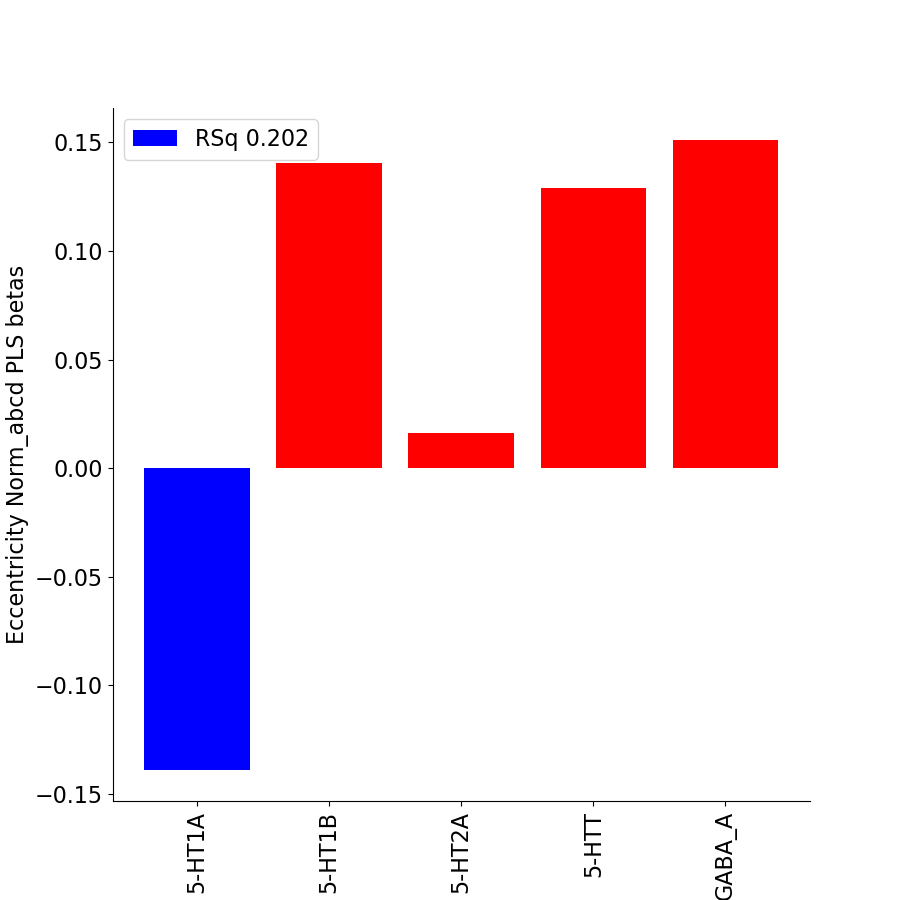

<IPython.core.display.Javascript object>


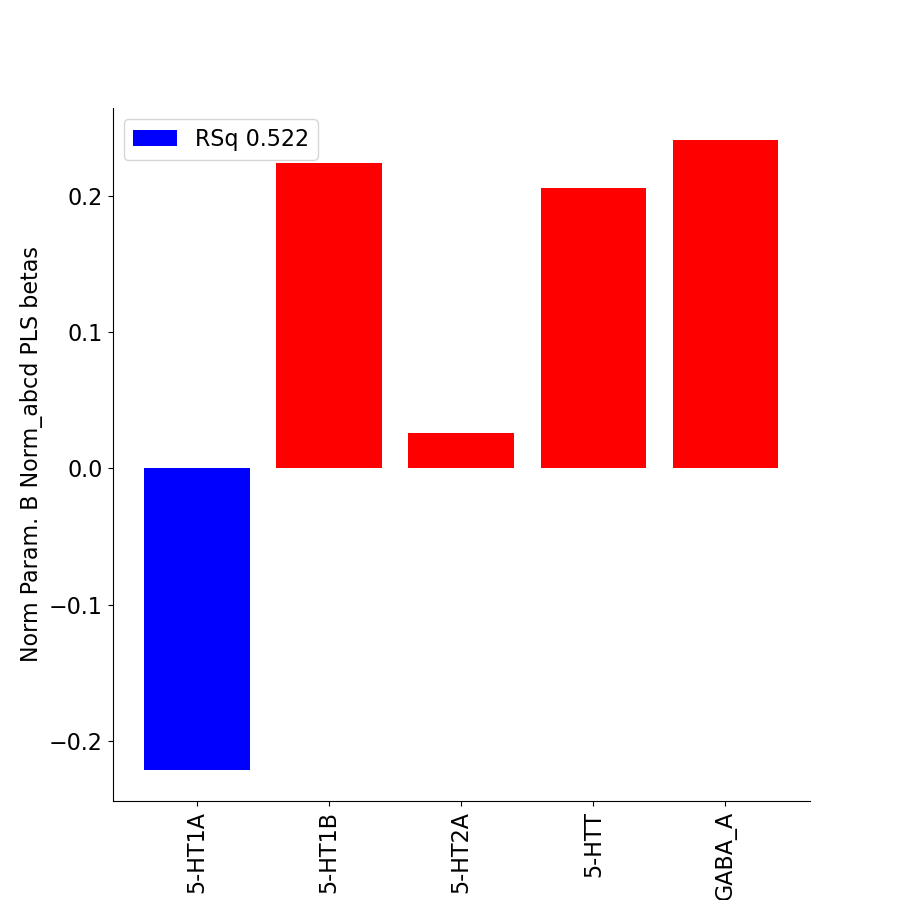

<IPython.core.display.Javascript object>


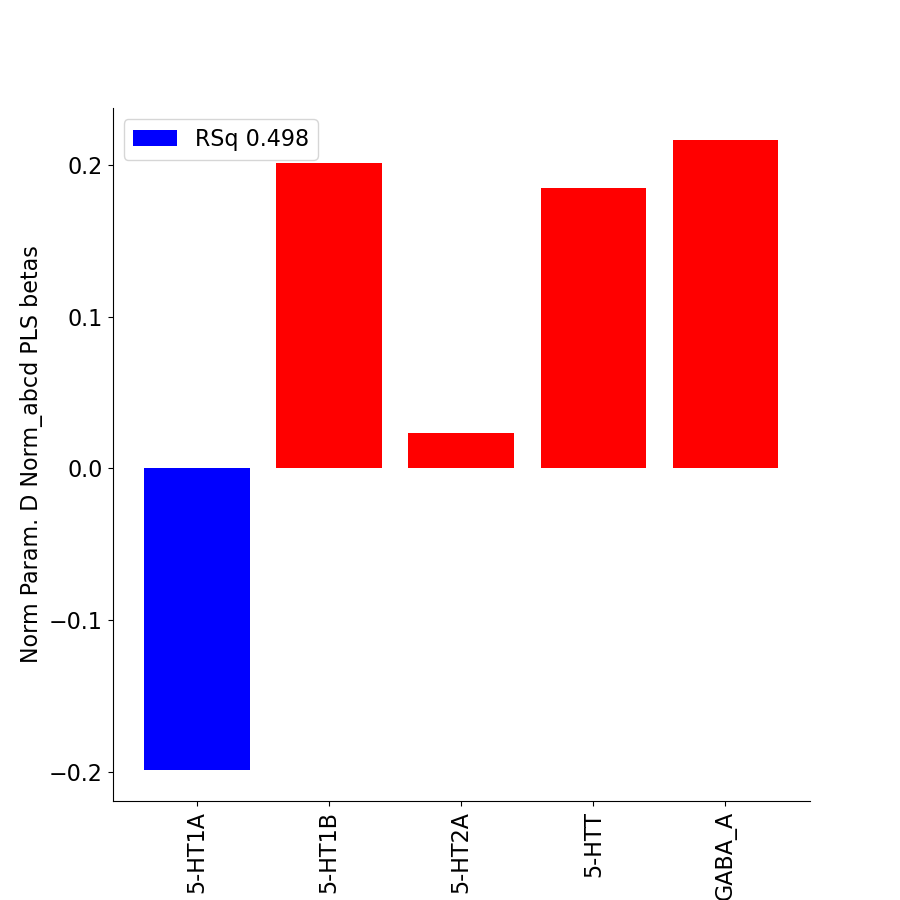

<IPython.core.display.Javascript object>


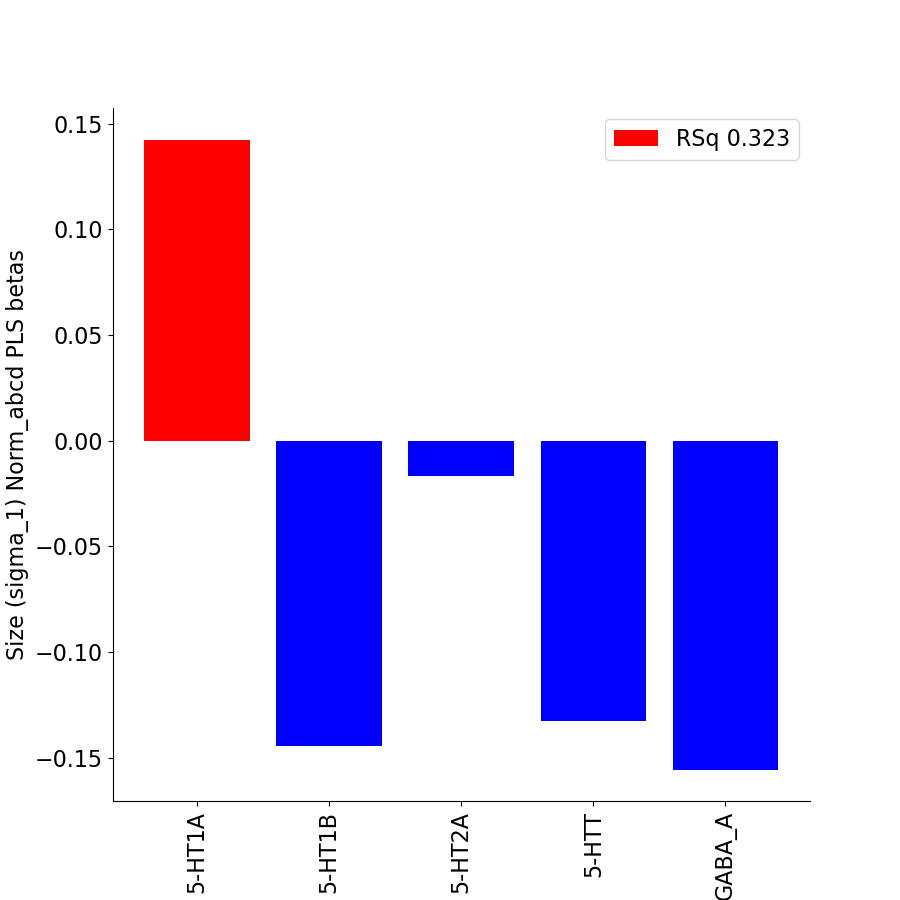

<IPython.core.display.Javascript object>


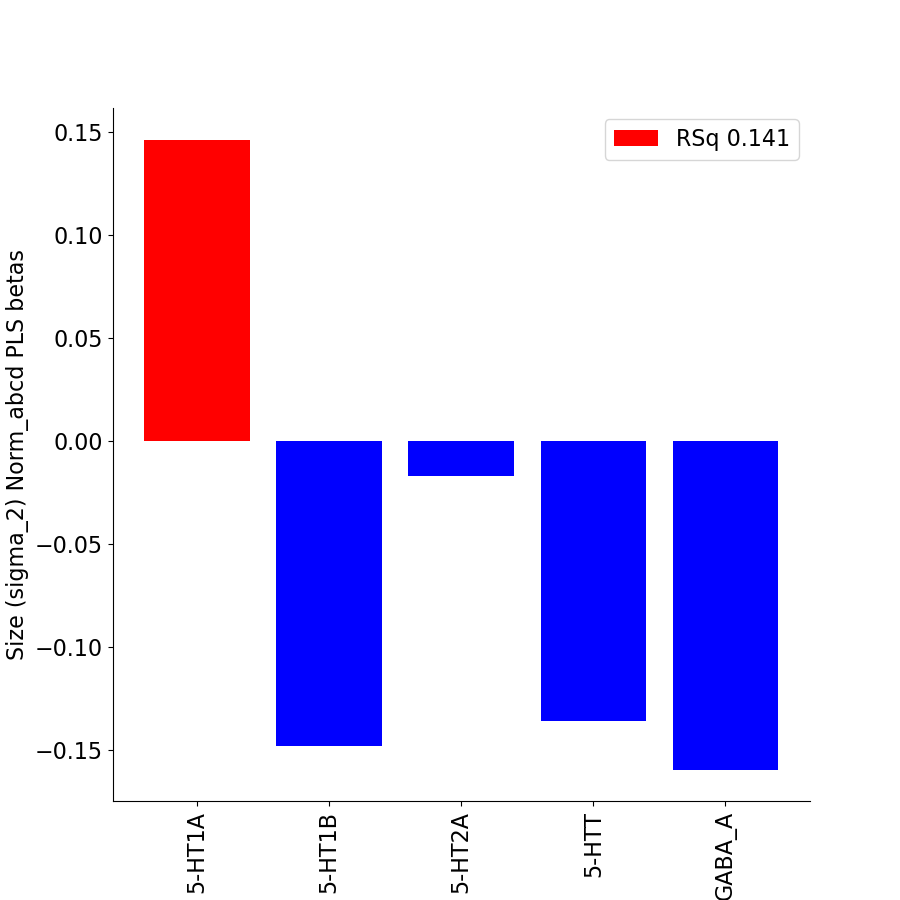

<IPython.core.display.Javascript object>


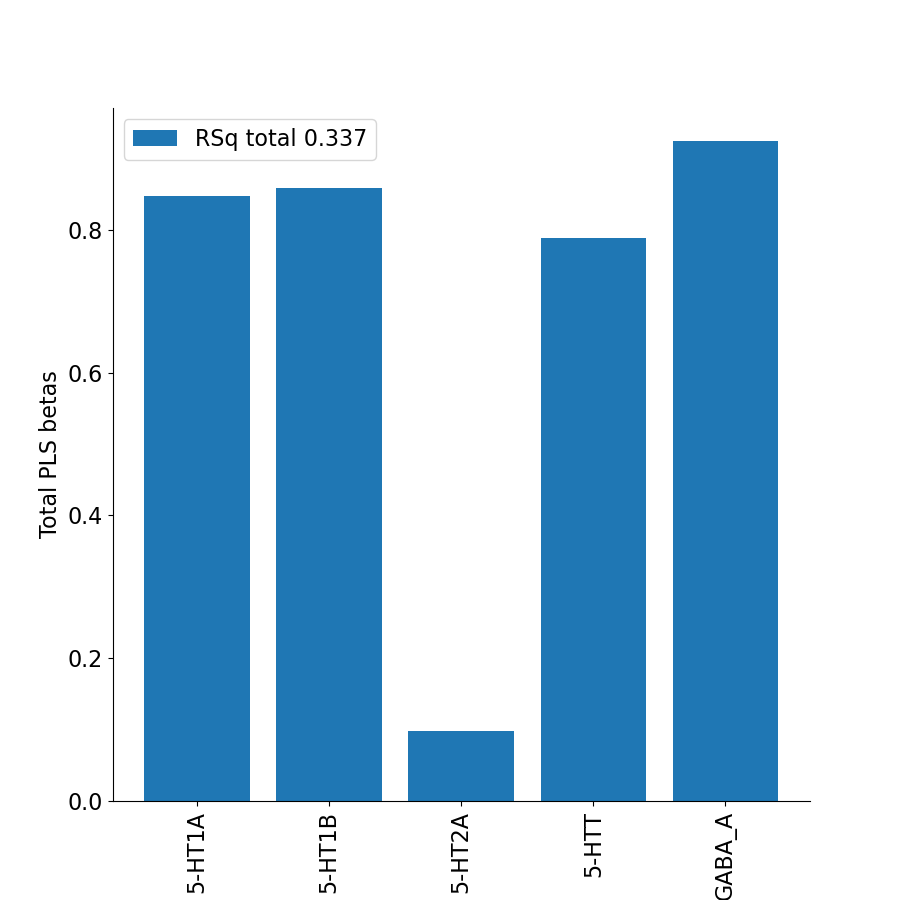

Performing PLS with 2 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [-0.0316 -0.2734 -0.2693  0.2687  0.1136], total beta: 0.957
5-HT1B: [ 0.0352  0.2756  0.271  -0.2687 -0.1162], total beta: 0.967
5-HT2A: [ 0.0755 -0.0033 -0.0161  0.0534 -0.0352], total beta: 0.184
5-HTT: [ 0.2867  0.1284  0.0806  0.0533 -0.1845], total beta: 0.733
GABA_A: [ 0.1739  0.2301  0.2018 -0.1288 -0.1666], total beta: 0.901
RSq total 0.37999270776298494
RSq predictions [0.2708 0.534  0.5247 0.4132 0.1572]
corr predictions [0.4889 0.6926 0.6332 0.5205 0.4581]



<IPython.core.display.Javascript object>


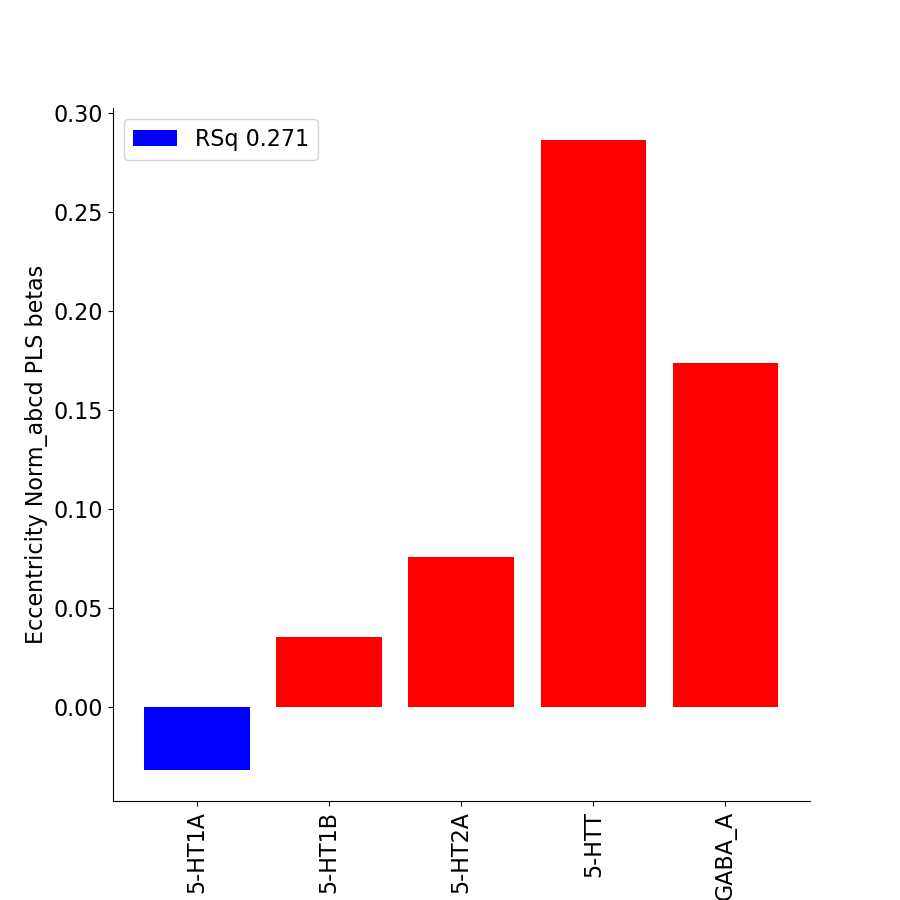

<IPython.core.display.Javascript object>


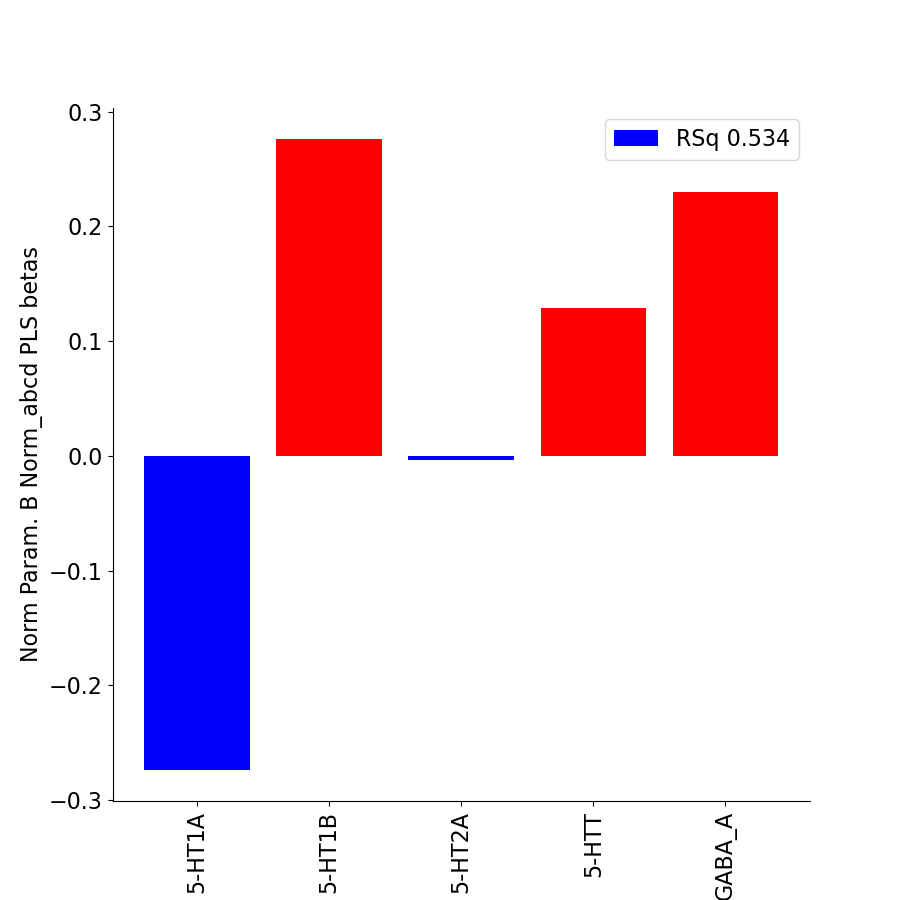

<IPython.core.display.Javascript object>


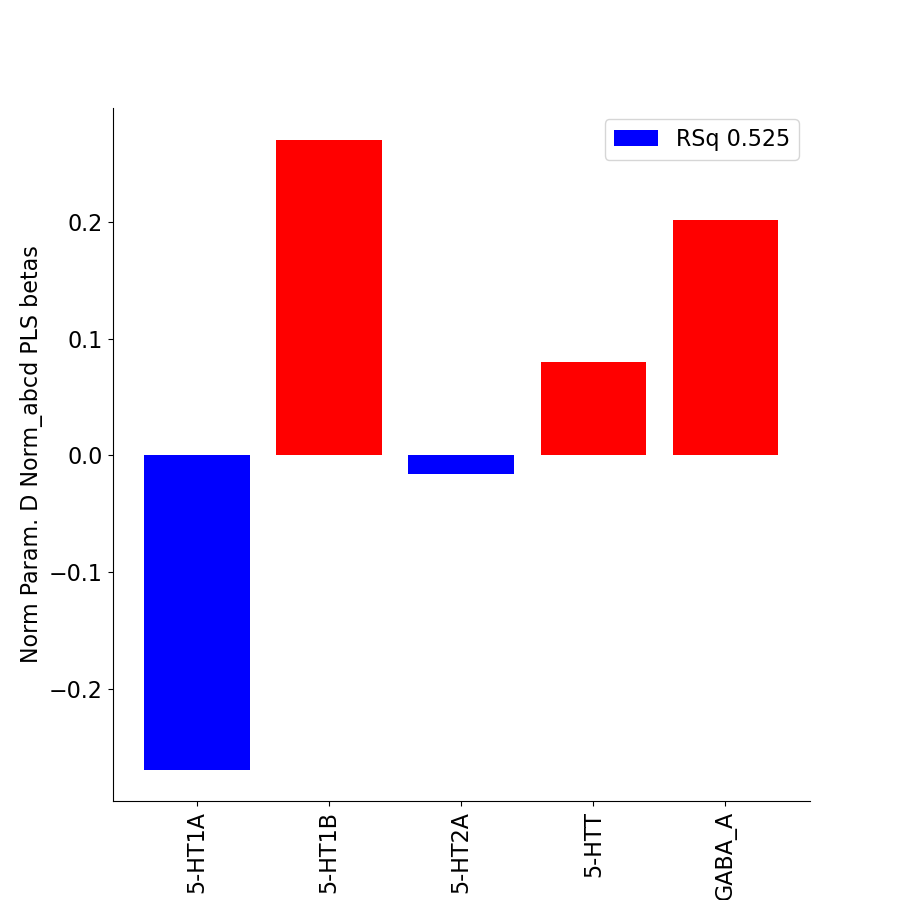

<IPython.core.display.Javascript object>


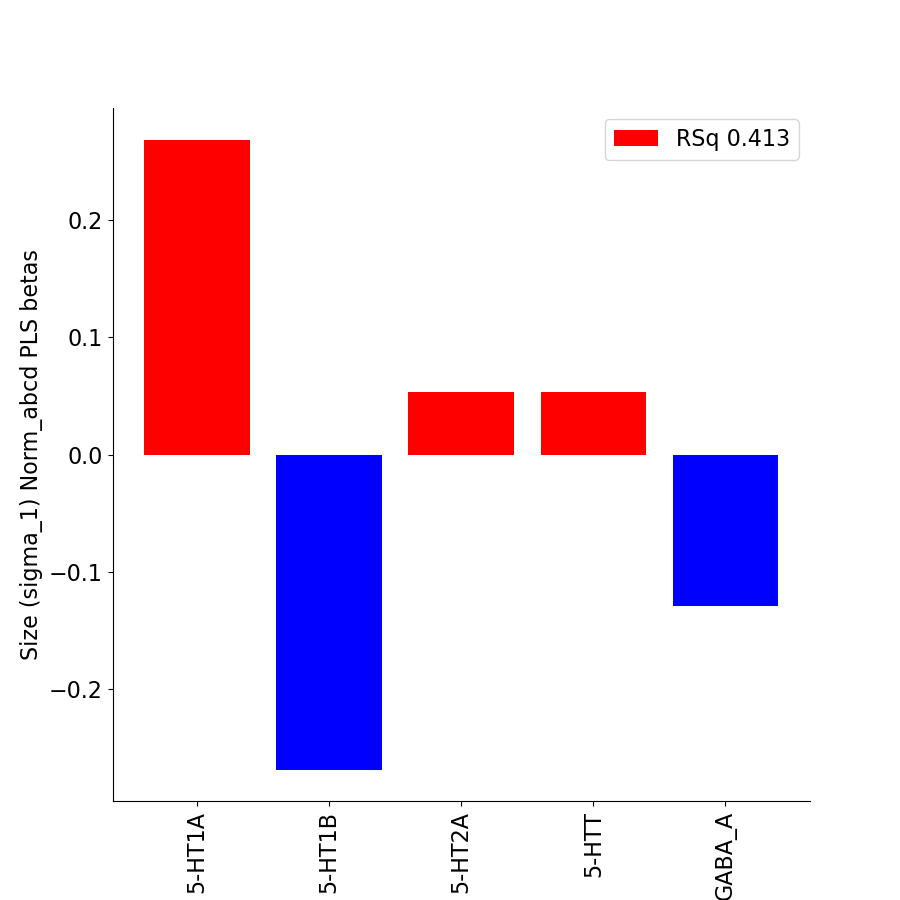

<IPython.core.display.Javascript object>


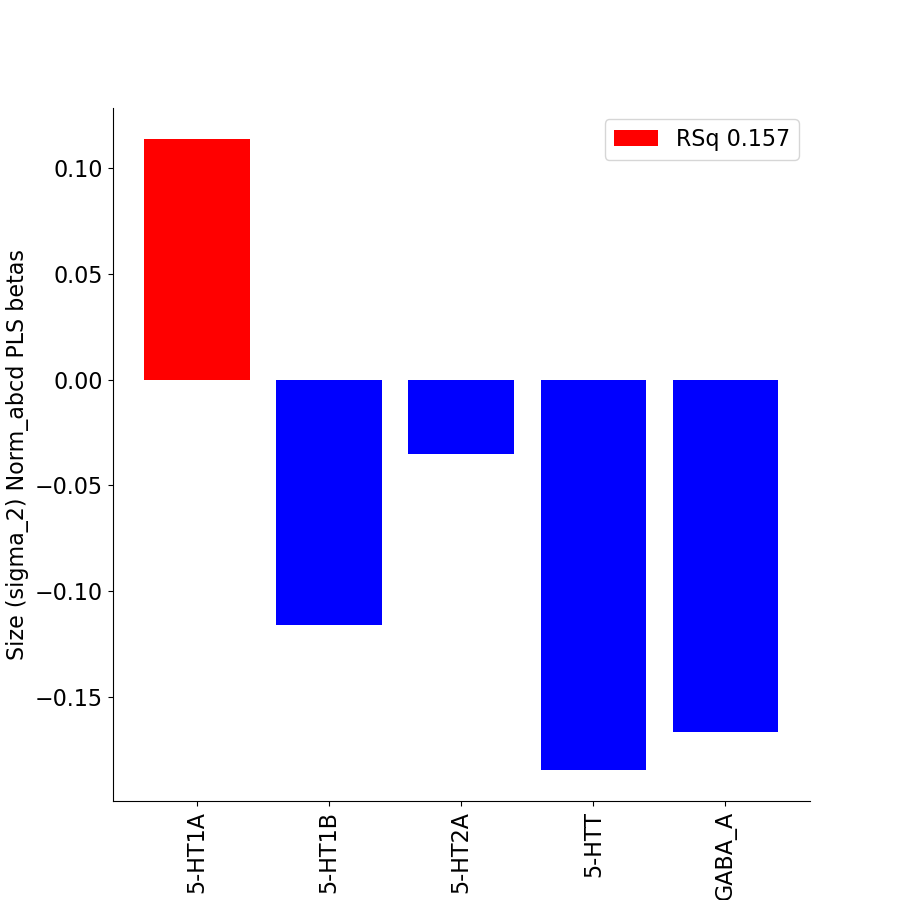

<IPython.core.display.Javascript object>


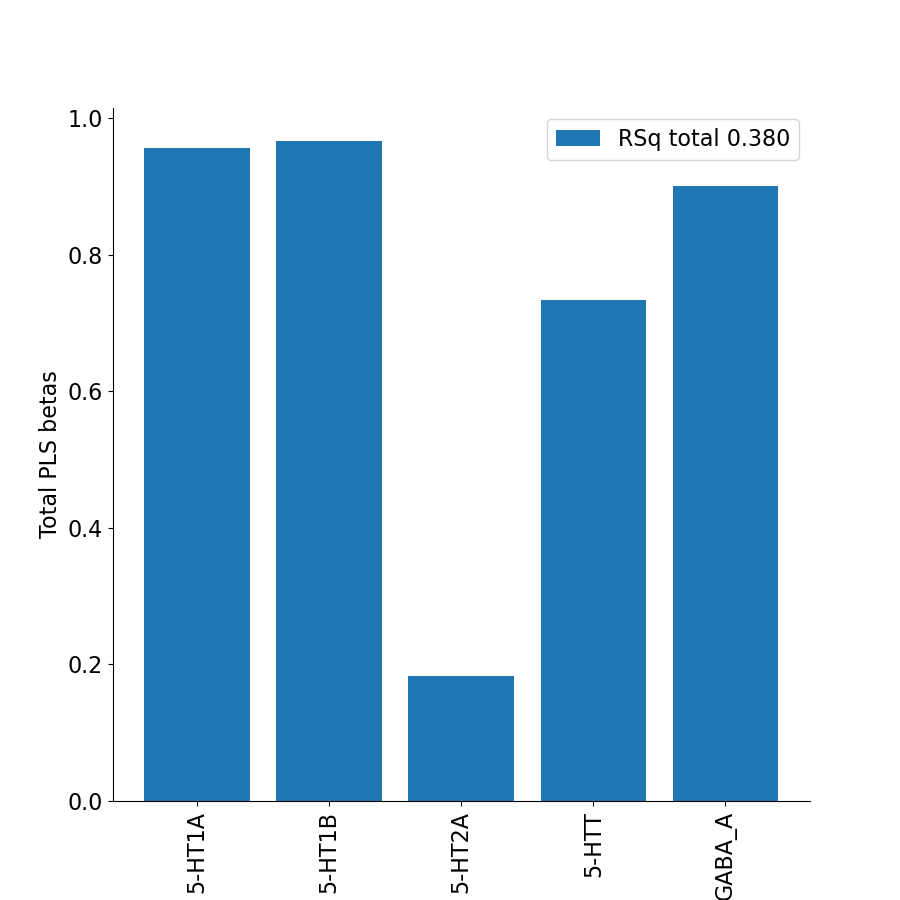

Performing PLS with 3 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [-0.1446 -0.2956 -0.2876  0.2568  0.1766], total beta: 1.161
5-HT1B: [-0.1586  0.2375  0.2397 -0.289  -0.0081], total beta: 0.933
5-HT2A: [-0.1122 -0.0402 -0.0464  0.0336  0.0694], total beta: 0.302
5-HTT: [ 0.5149  0.1733  0.1174  0.0773 -0.3117], total beta: 1.195
GABA_A: [ 0.1533  0.226   0.1984 -0.131  -0.1552], total beta: 0.864
RSq total 0.42093196223192875
RSq predictions [0.3887 0.5388 0.5369 0.4074 0.2328]
corr predictions [0.5861 0.6955 0.6353 0.5216 0.4923]



<IPython.core.display.Javascript object>


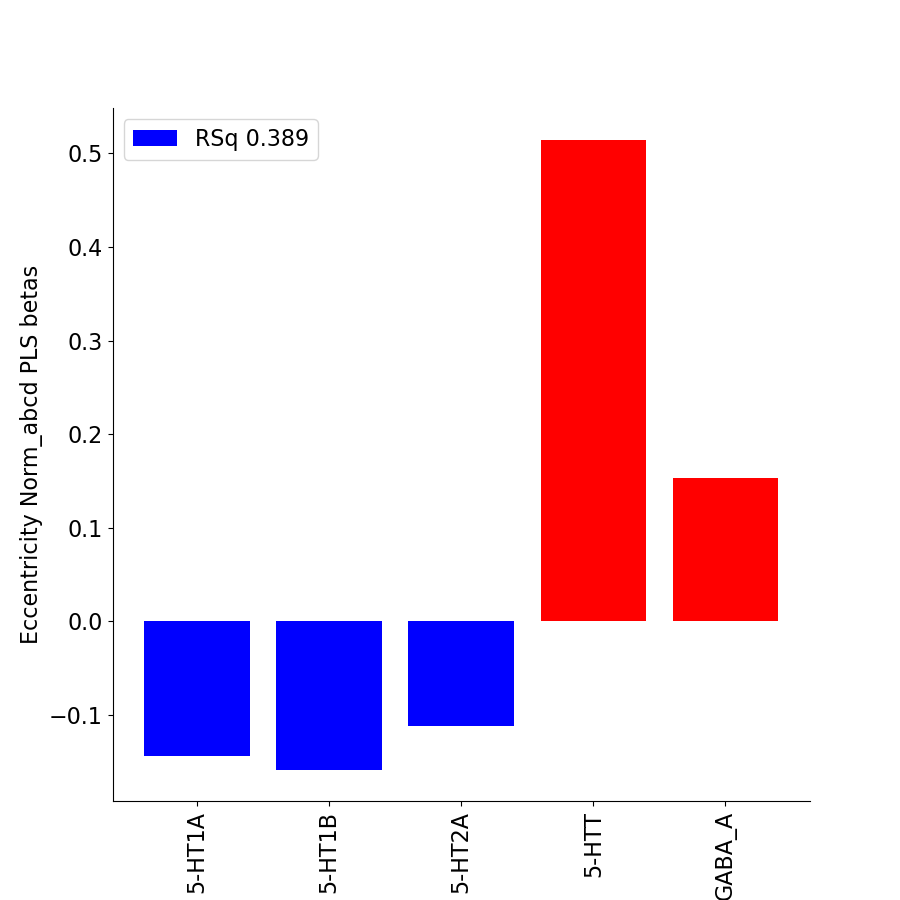

<IPython.core.display.Javascript object>


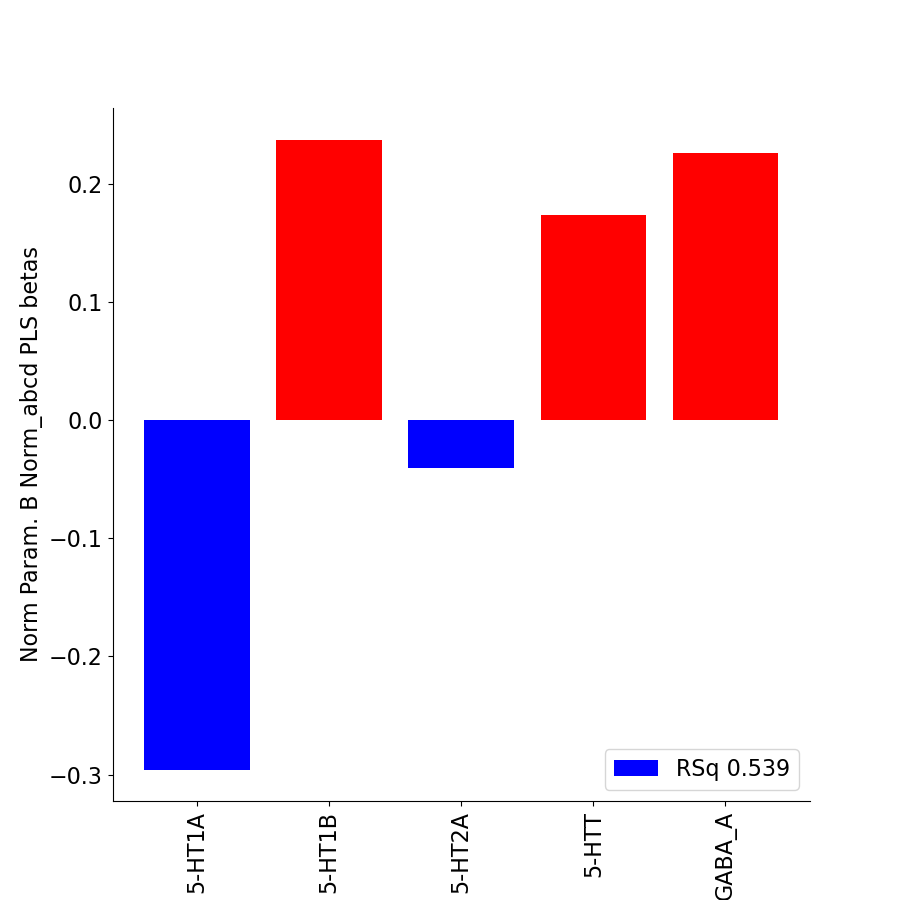

<IPython.core.display.Javascript object>


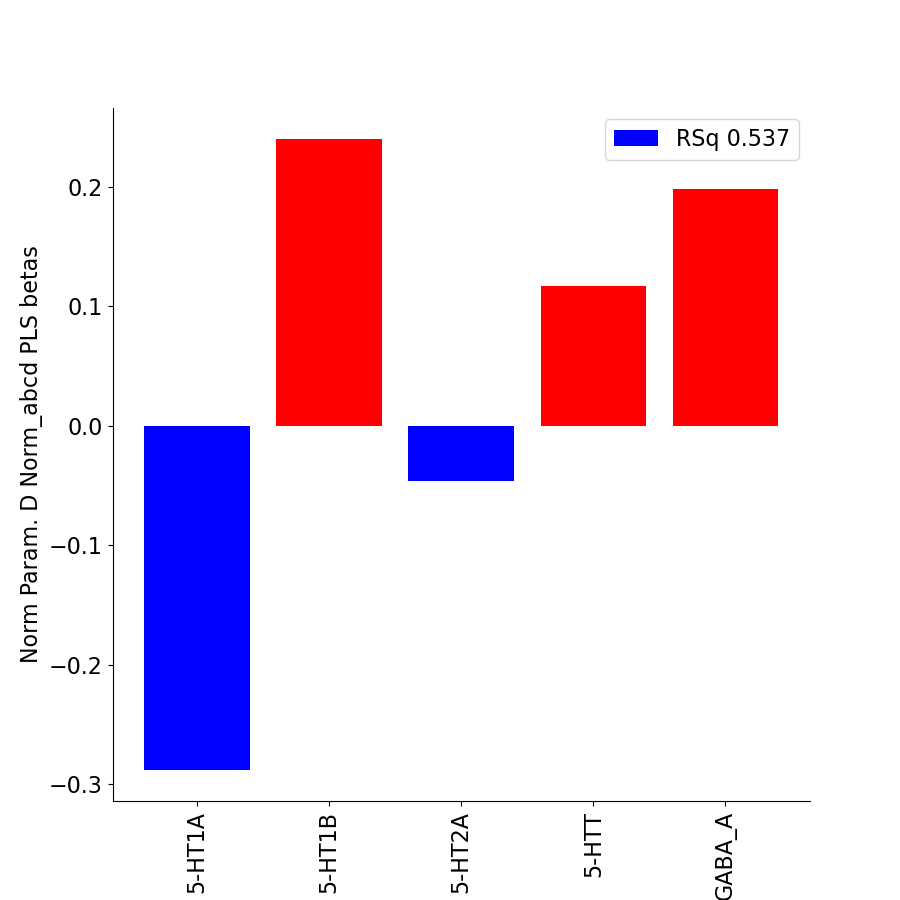

<IPython.core.display.Javascript object>


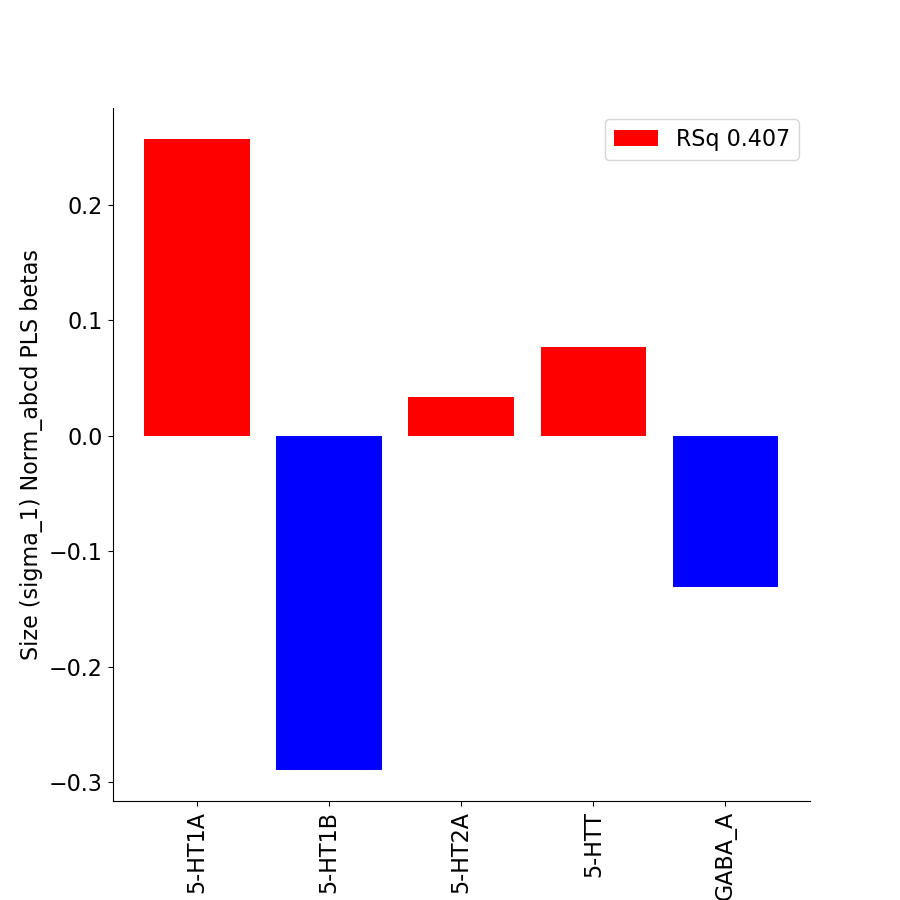

<IPython.core.display.Javascript object>


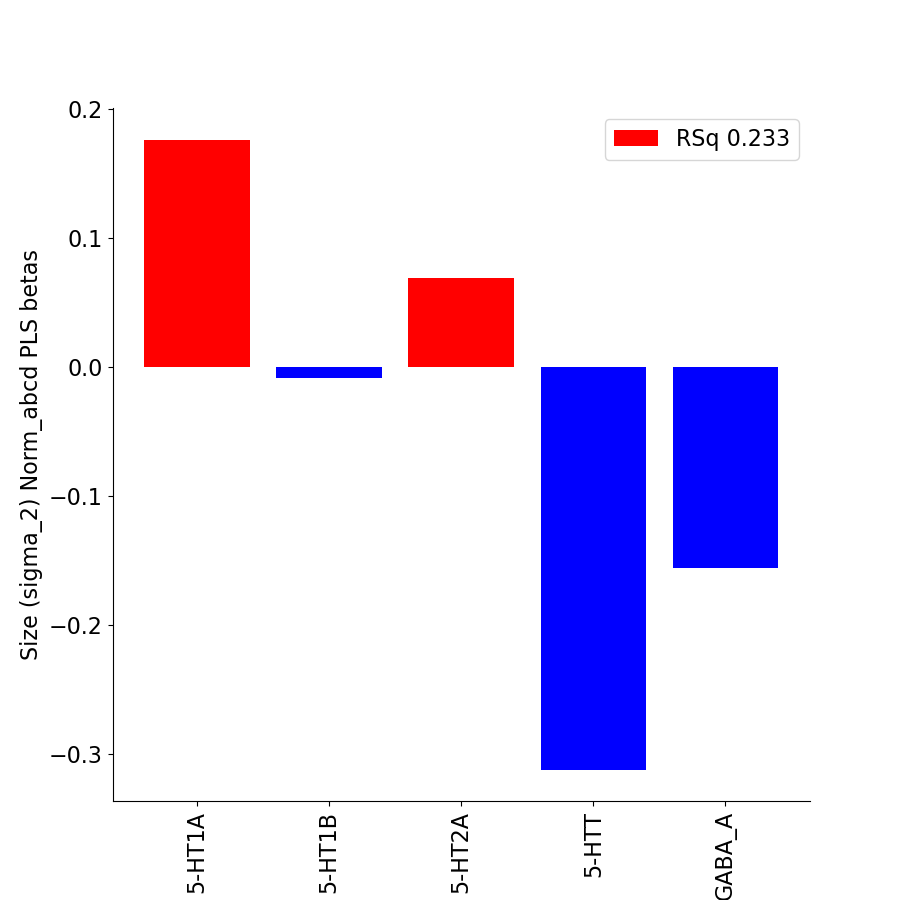

<IPython.core.display.Javascript object>


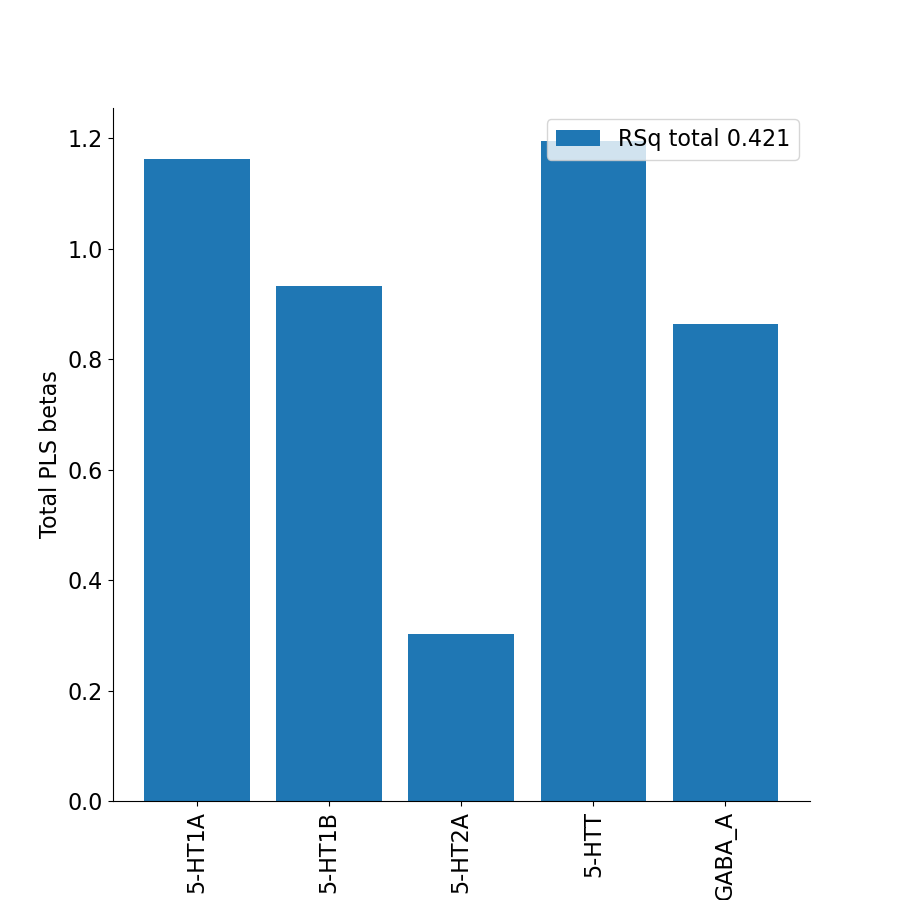

Performing PLS with 4 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [-0.2209 -0.1543 -0.2655  0.3052  0.4361], total beta: 1.382
5-HT1B: [-0.2197  0.3508  0.2574 -0.2503  0.2   ], total beta: 1.278
5-HT2A: [-0.0366 -0.1804 -0.0683 -0.0143 -0.1878], total beta: 0.487
5-HTT: [ 0.5093  0.1838  0.119   0.0809 -0.2925], total beta: 1.185
GABA_A: [ 0.1385  0.2535  0.2027 -0.1216 -0.1047], total beta: 0.821
RSq total 0.43905027935391194
RSq predictions [0.3919 0.5438 0.5353 0.4145 0.3097]
corr predictions [0.588  0.701  0.6355 0.5225 0.5177]



<IPython.core.display.Javascript object>


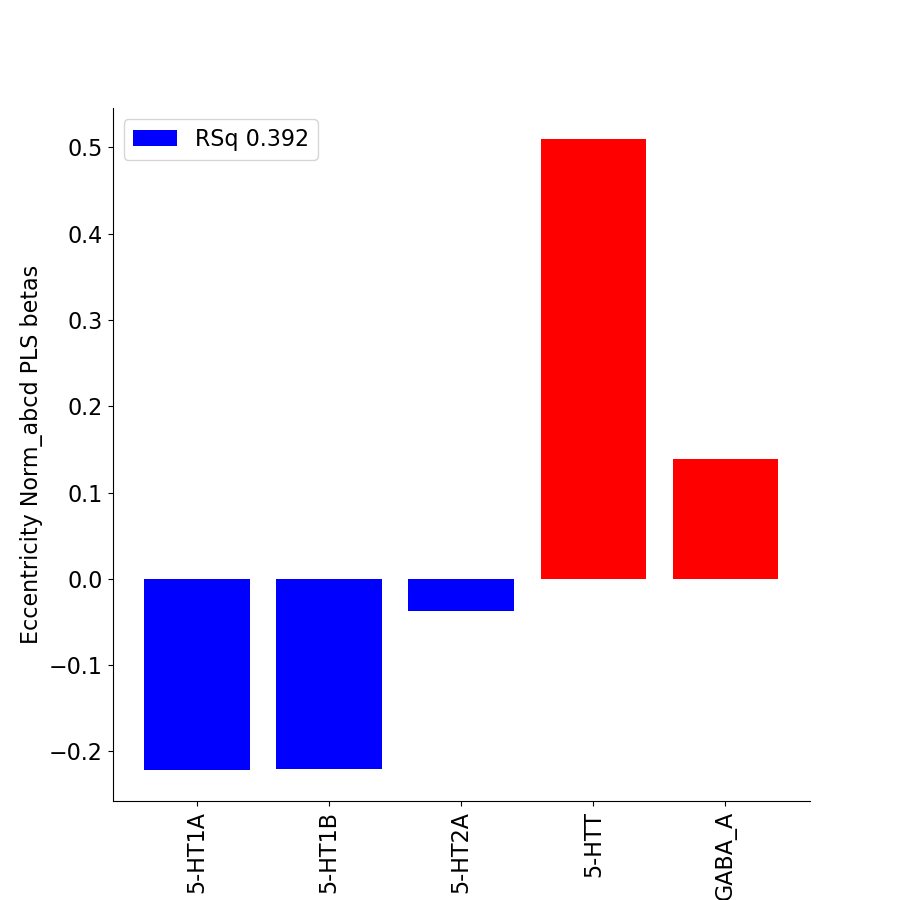

<IPython.core.display.Javascript object>


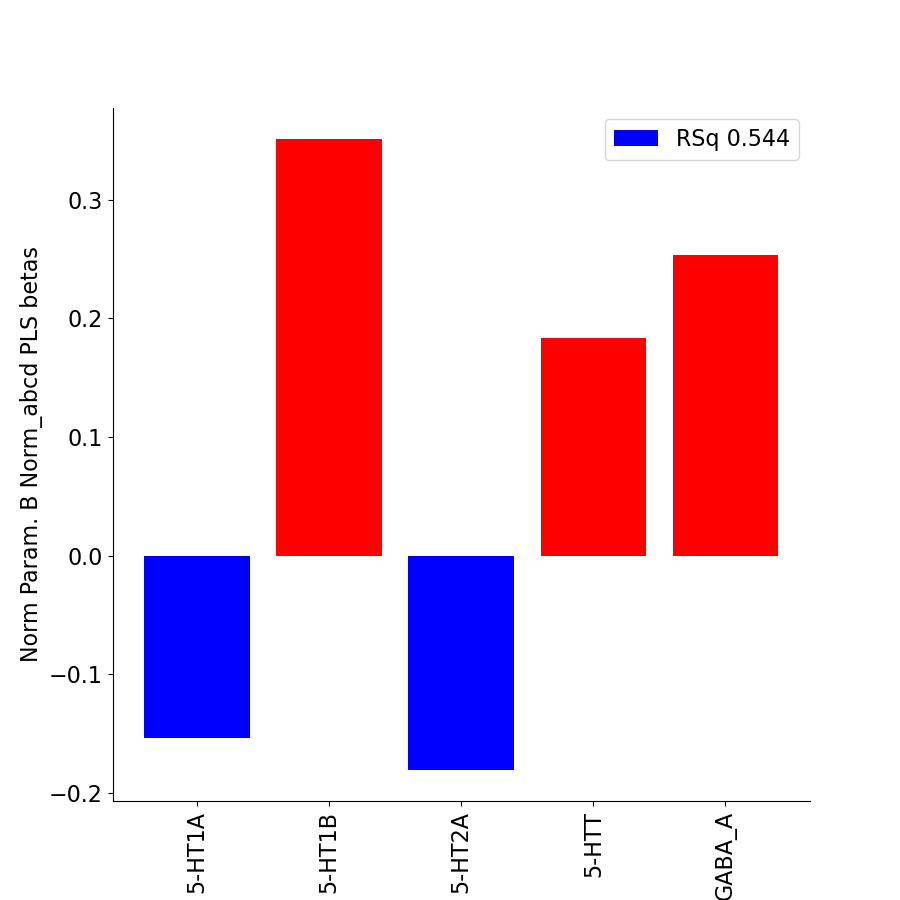

<IPython.core.display.Javascript object>


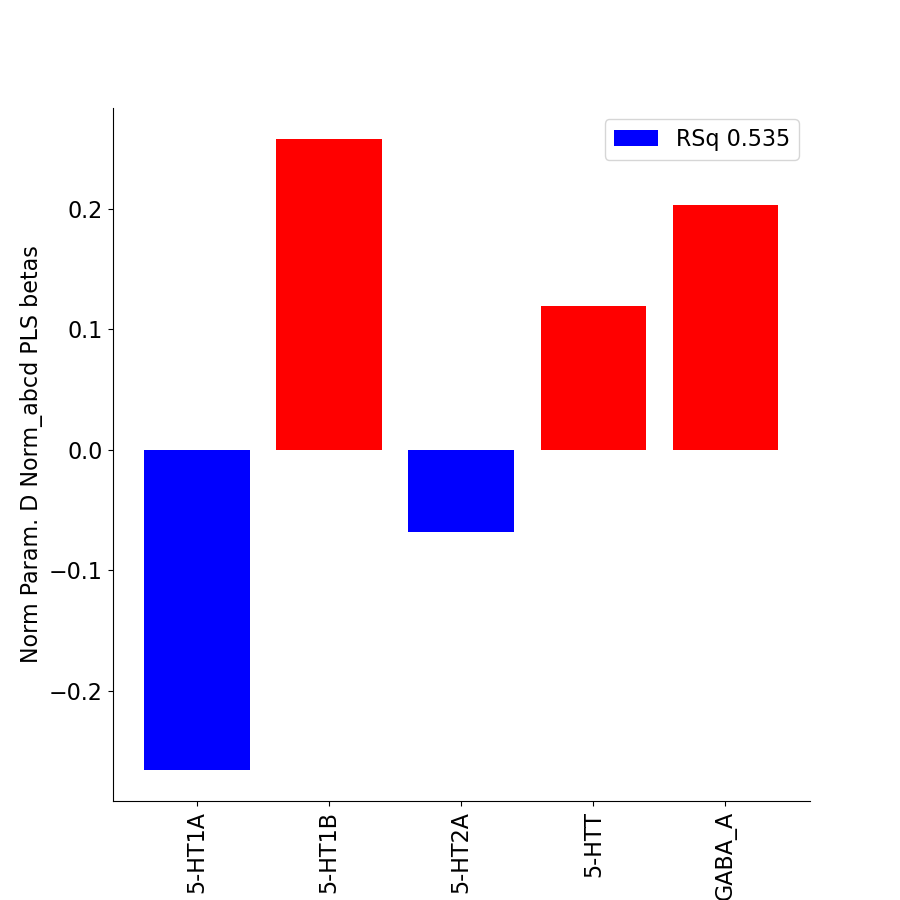

<IPython.core.display.Javascript object>


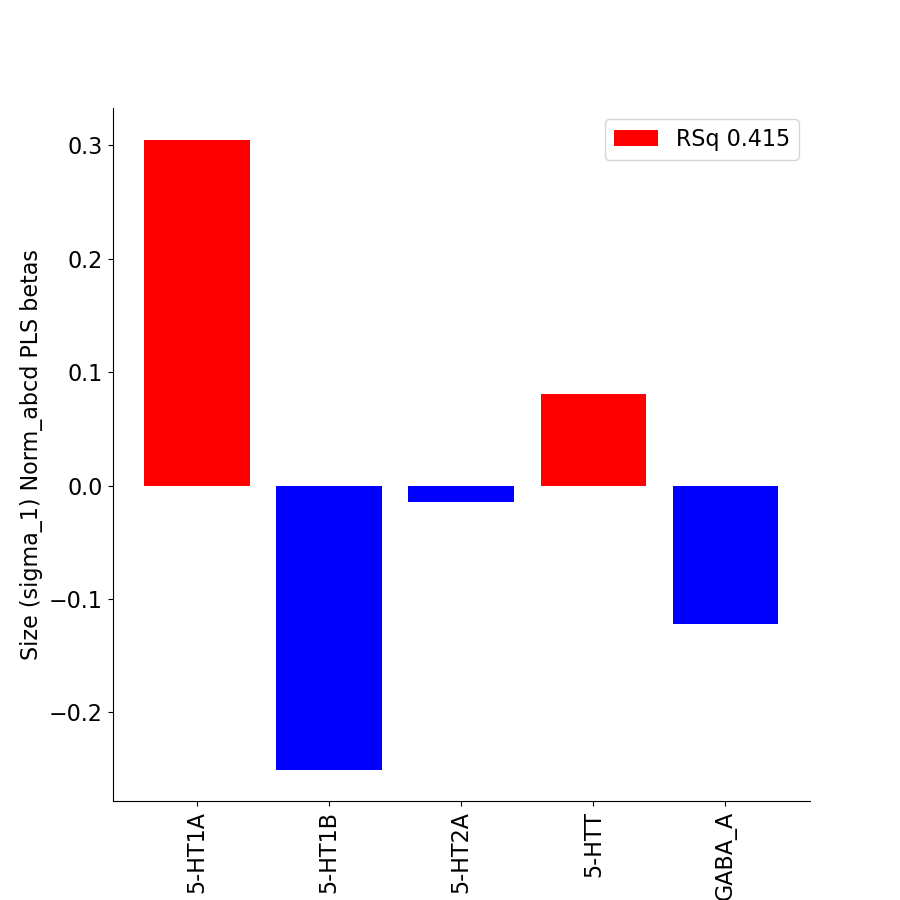

<IPython.core.display.Javascript object>


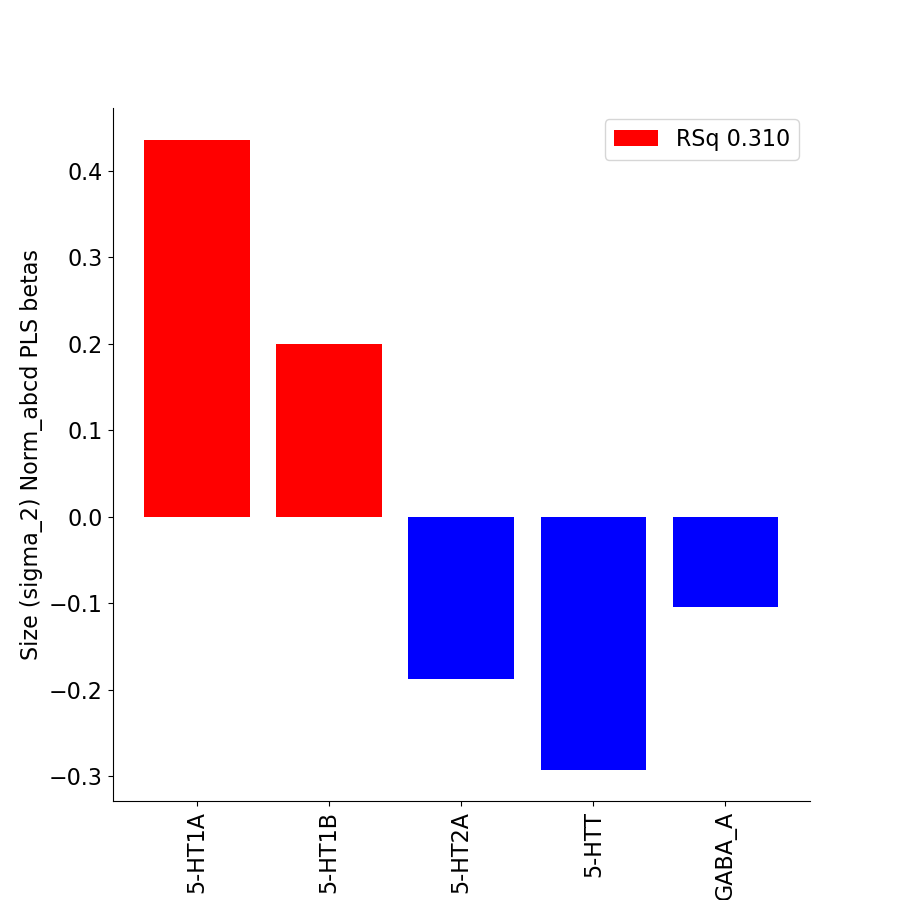

<IPython.core.display.Javascript object>


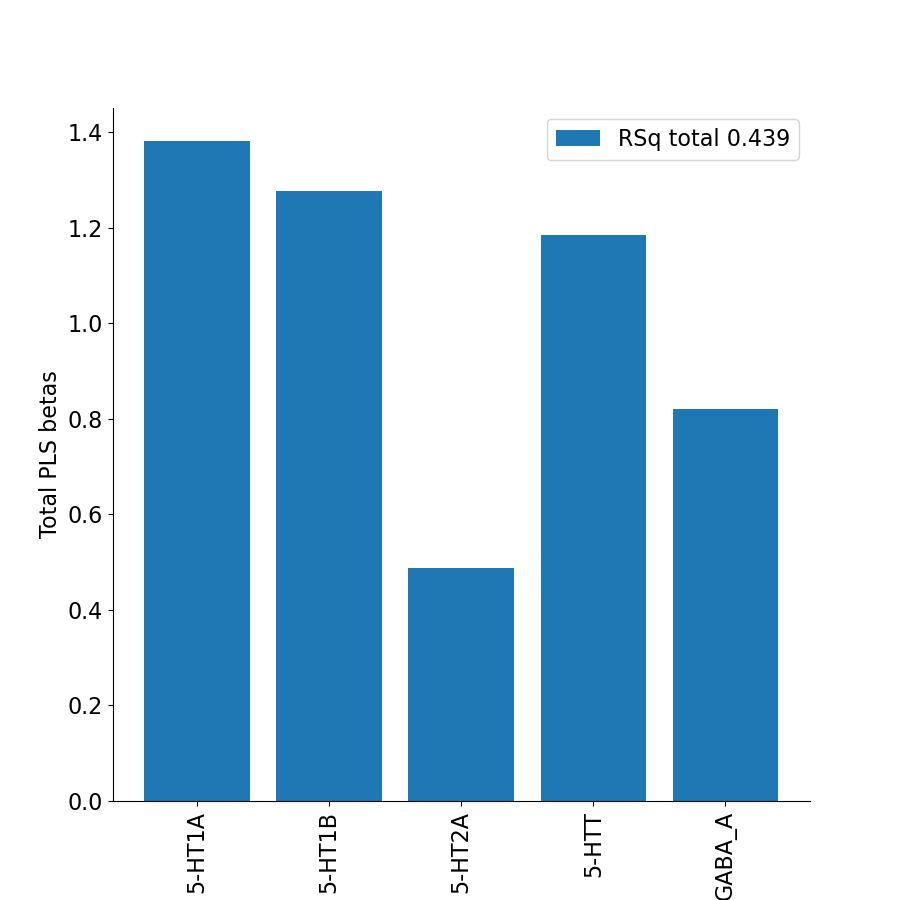

Performing PLS with 5 components
Estimated betas: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
5-HT1A: [-0.2598 -0.1685 -0.2576  0.2757  0.4638], total beta: 1.425
5-HT1B: [-0.1849  0.3635  0.2503 -0.2239  0.1752], total beta: 1.198
5-HT2A: [ 0.0073 -0.1643 -0.0772  0.019  -0.219 ], total beta: 0.487
5-HTT: [ 0.5825  0.2106  0.1041  0.1364 -0.3446], total beta: 1.378
GABA_A: [ 0.0059  0.205   0.2297 -0.2222 -0.0104], total beta: 0.673
RSq total 0.4458399816732646
RSq predictions [0.4092 0.545  0.5356 0.4281 0.3113]
corr predictions [0.5927 0.7015 0.6357 0.5255 0.5204]



<IPython.core.display.Javascript object>


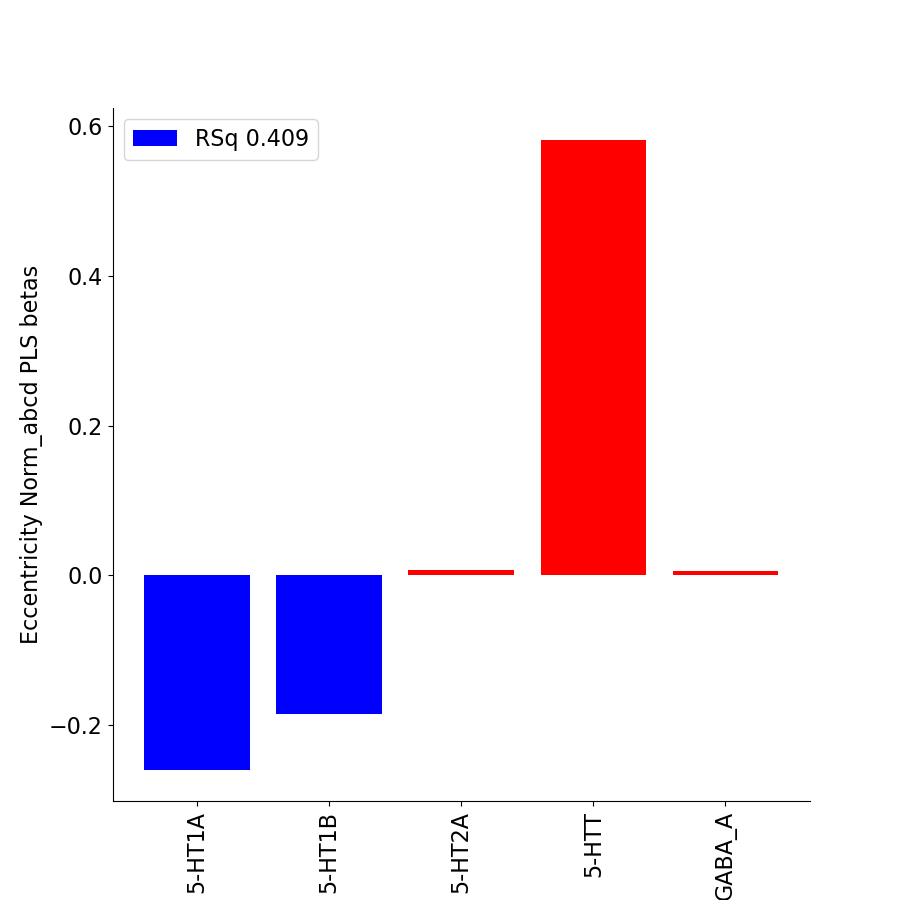

<IPython.core.display.Javascript object>


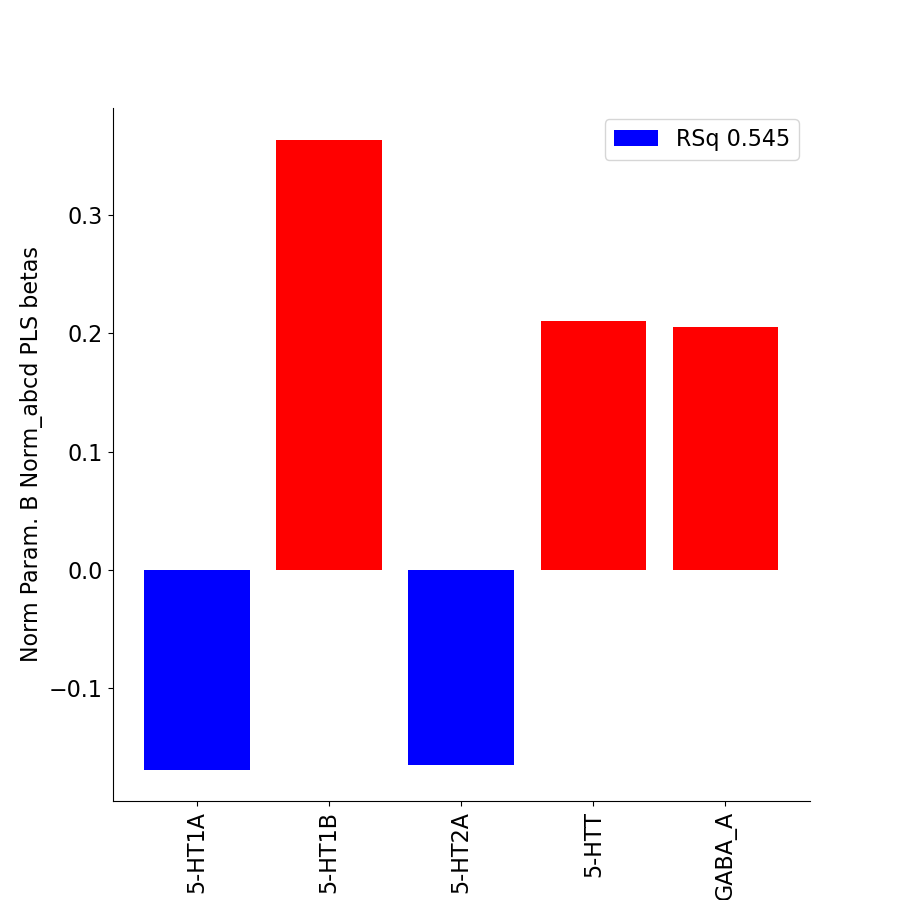

<IPython.core.display.Javascript object>


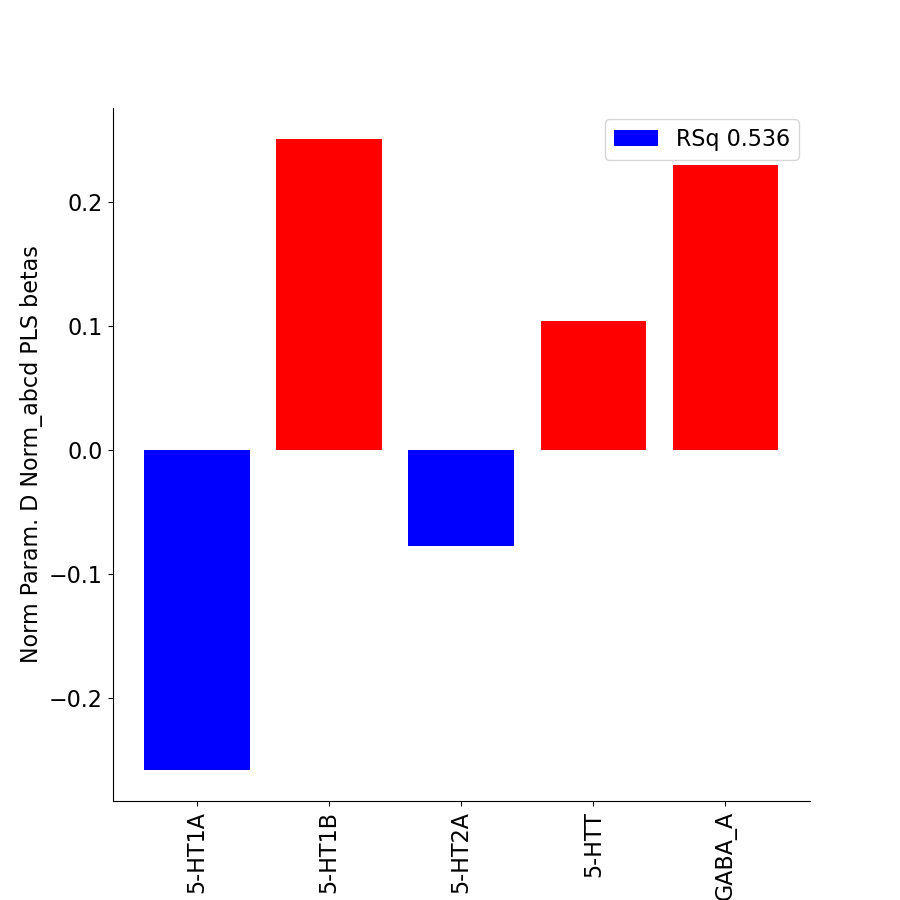

<IPython.core.display.Javascript object>


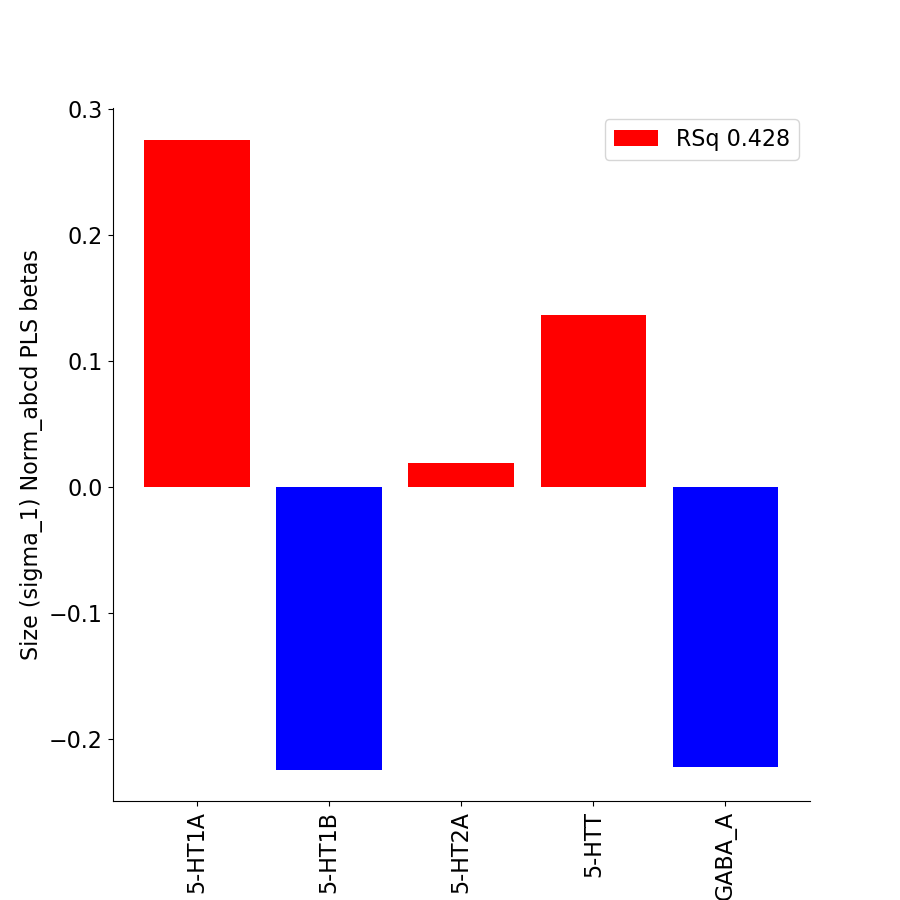

<IPython.core.display.Javascript object>


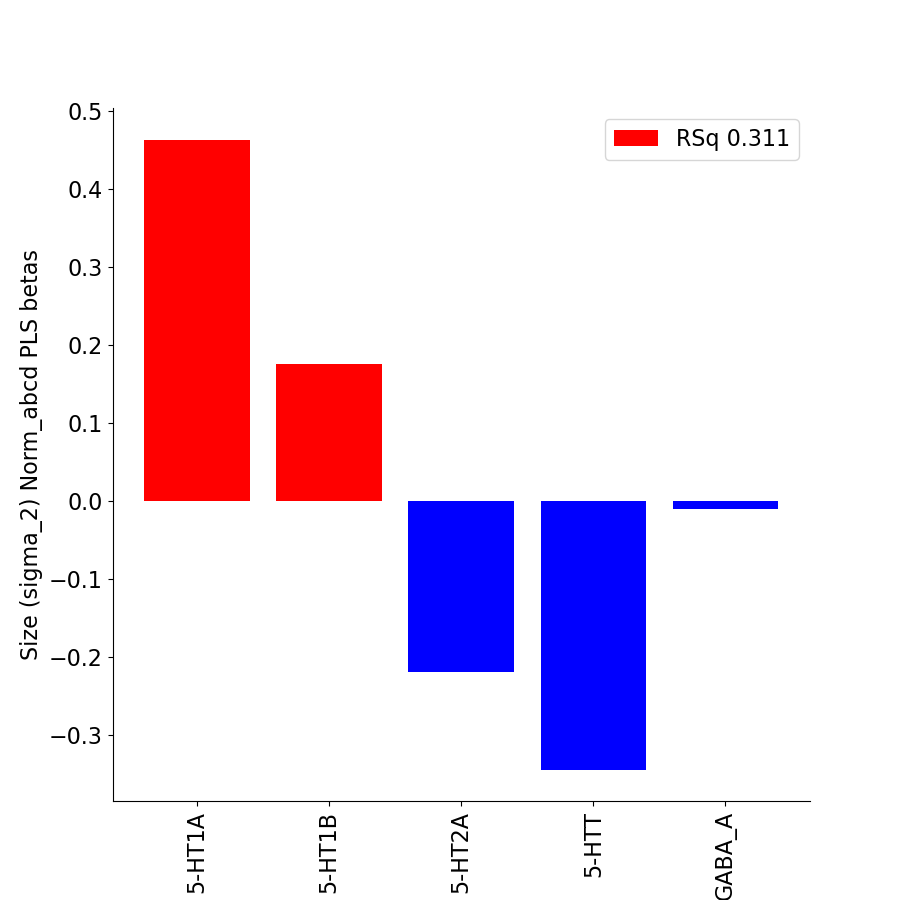

<IPython.core.display.Javascript object>


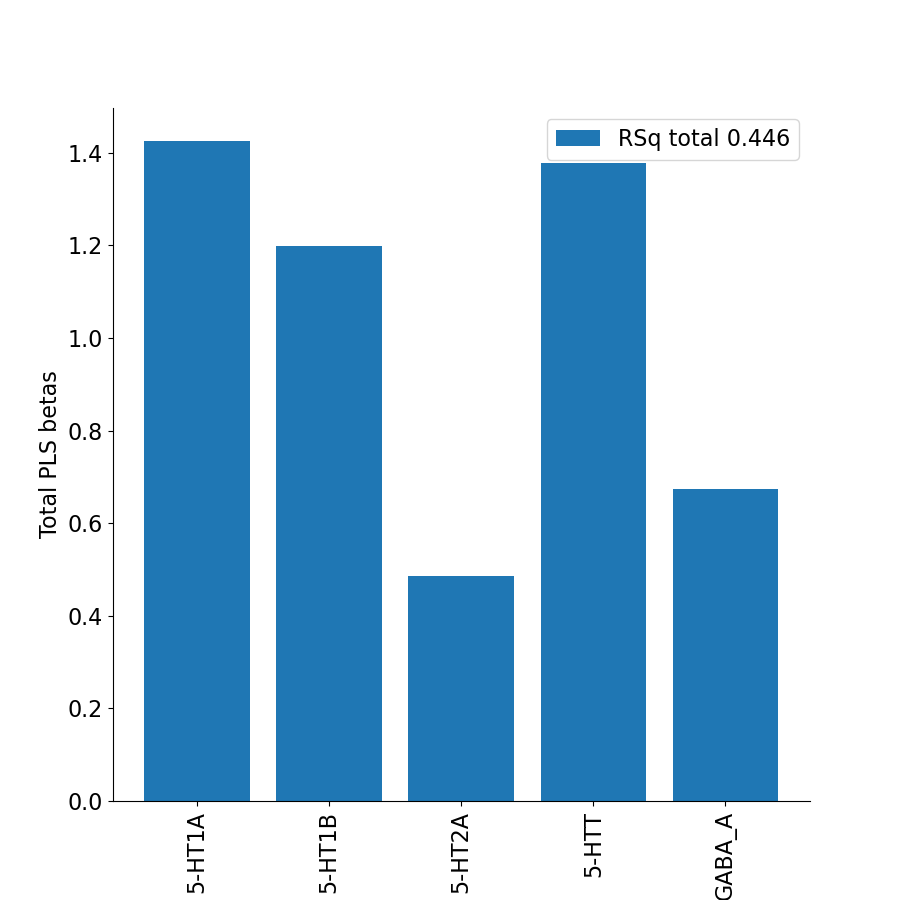

0

In [18]:
#%%capture
#display(HTML("<style>div.output_scroll { height: 150em; }</style>"))
pl.close('all')
#generalized quantitative parameter plots
#'Eccentricity'#'Suppression Index (full)'#'Suppression Index#'Size (fwhmax)'#'Surround Size (fwatmin)'
#'Norm Param. B'#''Ratio (B/D)'#'Norm Param. D'#'RSq'#'CCrsq_task-1R'#'CSS Exponent'#'Amplitude'
#'Surround Amplitude'#'Size (sigma_1)'##'Size (sigma_2)'
#'Size ratio (sigma_2/sigma_1)'#C/A#'B/A'#'D/C'#'D/A'#'B/C'#'Surround volume (full)'#'Centre volume (full)'
#'(A+B)/(C+D)'#'(A*B)/(C*D)'#'(A*D)/(C*B)'#'(A+D)/(C+B)'#'Point-stim derivative'#'(C(A+B))/(A(C+D))'
#'Min/Max Response Ratio'#'Max/Min Response Ratio'#'A(C+D)/C(A+B)'##Min/Max Response Ratio (with BD)'
#'A/C'
####DoG
#'Surround volume (full)'
#'Surround/Centre Amplitude' 
#'Surround-Centre Amplitude'
#'Surround-Centre Volume'

#parameters = ['Eccentricity', 'Norm Param. B', 'Norm Param. D', 'Size (sigma_1)','Size (sigma_2)', 'Amplitude','Surround Amplitude', 'Polar Angle',
#              '5-HT1A', '5-HT1B', '5-HT2A', '5-HT4', '5-HTT', 'GABA_A','Amplitude','Surround Amplitude', 'RSq']#,]#'Size ratio (sigma_2/sigma_1)']# 'Size (sigma_1)', 'Size (sigma_2)', 'Amplitude','Surround Amplitude']

parameters = ['5-HT1A', '5-HT1B', '5-HT2A', 'GABA_A', '5-HTT', 'Eccentricity','Norm Param. B', 'Norm Param. D', 'Size (sigma_1)','Size (sigma_2)','RSq']#

x_dims_idx = [0,1,2,3,4]
y_dims_idx = [5,6,7,8,9]

#rois = ['custom.V1', 'custom.V2', 'custom.V3','custom.V3AB','custom.hV4','custom.LO','custom.TO','custom.IPS','all_custom']
#rois = ['V1', 'V2', 'V3','V3AB','hV4','LO','TO','IPS', 'combined']#['Brain'] #'V1', 'V2', 'V3','V3AB','hV4','LO','TO','IPS','combined', 
#rois = [ 'V1', 'V2', 'V3', 'hV4', 'VO1', 'VO2', 'PHC1', 'PHC2', 'TO2', 'TO1', 'LO2', 'LO1', 'V3B', 'V3A', 'IPS0', 'IPS1', 'IPS2', 'IPS3', 'IPS4', 'IPS5', 'SPL1']#, 'combined']
#rois = ['all_custom']
rois = [roi for roi in vis_res.idx_rois['fsaverage'] if 'glasser' in roi]
#rois = ['glasser_V1','glasser_V2','glasser_V3','glasser_V4','glasser_V3A','glasser_V7','glasser_V3B','glasser_V3CD',
#'glasser_LO1','glasser_LO2','glasser_PIT','glasser_V8','glasser_VMV3',
#'glasser_IPS1','glasser_IP0','glasser_PGp','glasser_LO3','glasser_MT','glasser_V4t','glasser_FFC']
rois.append('combined')
        
rsq_thresh = 0.0
save_figures= False
figure_path = '/Volumes/Crucial X8/PRFMapping/Figures/attemptwnames_glasser_ecc65rsq030/pls'

space_names = 'fsaverage'
#set to 'all' to plot all analyses
analysis_names = 'fit-task-BAR_fit-runs-all'#'fit-task-BAR_fit-runs-CVmedian'

subject_ids = ['fsaverage_cvrsq']#['fsaverage_hcp1sthalf', 'fsaverage_hcp2ndhalf']

threshold_li = filters.threshold_li(vis_res.main_dict[space_names][analysis_names][subject_ids[0]]['Processed Results']['#Subjects with CVRSq>0']['Norm_abcd'])

vis_res.set_alpha(only_models=['Norm_abcd'], ecc_min=0.0, ecc_max=6.5, min_number_sjs=threshold_li)

vis_res.multidim_analysis(parameters, rois, rsq_thresh, save_figures, figure_path, space_names = space_names, parameter_toplevel='Receptor Maps', rsq_weights= True,
                    analysis_names = analysis_names, subject_ids = subject_ids, x_dims_idx=x_dims_idx, y_dims_idx=y_dims_idx,
                          zscore_data= False, zscore_data_across_rois = True, 
                          size_response_curves = False, plot_corr_matrix = False, perform_ols = False, polar_plots = False,
                             cv_regression = False, bold_voxel_volume=4.096, zconfint_err_alpha=None, quantile_exclusion=0.999,
                          #vis_pca_comps_rois: fr which rois to make pca comp beta plots; 
                          #vis_pca_comps_axes: which comps to use in 2d plot of mean pca comp per roi
                        perform_pca = False, vis_pca_pycortex = False, vis_pca_comps_rois = ['combined'], vis_pca_comps_axes = [0,1], rsq_alpha_pca_plot = True,
                          perform_pls = True, vis_pls_pycortex = False)

os.system(f"open {sound_file}")


## Size-response curves

In [19]:
vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage_cvrsq']['analysis_info'] = vis_res.main_dict['HCP']['fit-task-BAR_fit-runs-all']['100610']['analysis_info']

HCP fit-task-BAR_fit-runs-all 100610
HCP fit-task-BAR_fit-runs-all 102311
HCP fit-task-BAR_fit-runs-all 102816
HCP fit-task-BAR_fit-runs-all 104416
HCP fit-task-BAR_fit-runs-all 105923
HCP fit-task-BAR_fit-runs-all 108323
HCP fit-task-BAR_fit-runs-all 109123
HCP fit-task-BAR_fit-runs-all 111312
HCP fit-task-BAR_fit-runs-all 111514
HCP fit-task-BAR_fit-runs-all 114823
HCP fit-task-BAR_fit-runs-all 115017
HCP fit-task-BAR_fit-runs-all 115825
HCP fit-task-BAR_fit-runs-all 116726
HCP fit-task-BAR_fit-runs-all 118225
HCP fit-task-BAR_fit-runs-all 125525
HCP fit-task-BAR_fit-runs-all 126426
HCP fit-task-BAR_fit-runs-all 128935
HCP fit-task-BAR_fit-runs-all 130114
HCP fit-task-BAR_fit-runs-all 130518
HCP fit-task-BAR_fit-runs-all 131217
HCP fit-task-BAR_fit-runs-all 131722
HCP fit-task-BAR_fit-runs-all 132118
HCP fit-task-BAR_fit-runs-all 134627
HCP fit-task-BAR_fit-runs-all 134829
HCP fit-task-BAR_fit-runs-all 135124
HCP fit-task-BAR_fit-runs-all 137128
HCP fit-task-BAR_fit-runs-all 140117
H

fsaverage fit-task-BAR_fit-runs-all 165436
fsaverage fit-task-BAR_fit-runs-all 167036
fsaverage fit-task-BAR_fit-runs-all 167440
fsaverage fit-task-BAR_fit-runs-all 169040
fsaverage fit-task-BAR_fit-runs-all 169343
fsaverage fit-task-BAR_fit-runs-all 169444
fsaverage fit-task-BAR_fit-runs-all 169747
fsaverage fit-task-BAR_fit-runs-all 171633
fsaverage fit-task-BAR_fit-runs-all 172130
fsaverage fit-task-BAR_fit-runs-all 173334
fsaverage fit-task-BAR_fit-runs-all 175237
fsaverage fit-task-BAR_fit-runs-all 176542
fsaverage fit-task-BAR_fit-runs-all 177140
fsaverage fit-task-BAR_fit-runs-all 177645
fsaverage fit-task-BAR_fit-runs-all 177746
fsaverage fit-task-BAR_fit-runs-all 178142
fsaverage fit-task-BAR_fit-runs-all 178243
fsaverage fit-task-BAR_fit-runs-all 178647
fsaverage fit-task-BAR_fit-runs-all 180533
fsaverage fit-task-BAR_fit-runs-all 181232
fsaverage fit-task-BAR_fit-runs-all 181636
fsaverage fit-task-BAR_fit-runs-all 182436
fsaverage fit-task-BAR_fit-runs-all 182739
fsaverage f

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HT4', '5-HTT', 'Amplitude Norm_abcd', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Polar Angle Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd', 'Surround Amplitude Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HT4', '5-HTT', 'Amplitude Norm_abcd', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Polar Angle Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd', 'Surround Amplitude Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HT4', '5-HTT', 'Amplitude Norm_abcd', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Polar Angle Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd', 'Surround Amplitude Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HT4', '5-H

Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HT4', '5-HTT', 'Amplitude Norm_abcd', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Polar Angle Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd', 'Surround Amplitude Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HT4', '5-HTT', 'Amplitude Norm_abcd', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Polar Angle Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd', 'Surround Amplitude Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HT4', '5-HTT', 'Amplitude Norm_abcd', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Polar Angle Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd', 'Surround Amplitude Norm_abcd']
Ordered dimensions: ['5-HT1A', '5-HT1B', '5-HT2A', '5-HT4', '5-H

Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_POS1
X-dims: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Polar Angle Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd']
Y-dims: ['Amplitude Norm_abcd', 'Surround Amplitude Norm_abcd']
alldims ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Polar Angle Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd', 'Amplitude Norm_abcd', 'Surround Amplitude Norm_abcd']
ord dims ['5-HT1A', '5-HT1B', '5-HT2A', '5-HT4', '5-HTT', 'Amplitude Norm_abcd', 'Eccentricity Norm_abcd', 'GABA_A', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Polar Angle Norm_abcd', 'RSq Norm_abcd', 'Size (sigma_1) Norm_abcd', 'Size (sigma_2) Norm_abcd', 'Surround Amplitude Norm_abcd']
Sample size: 0
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_POS2
X-dims: ['Eccentricity Norm_abcd', 'Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Polar Angl

<IPython.core.display.Javascript object>


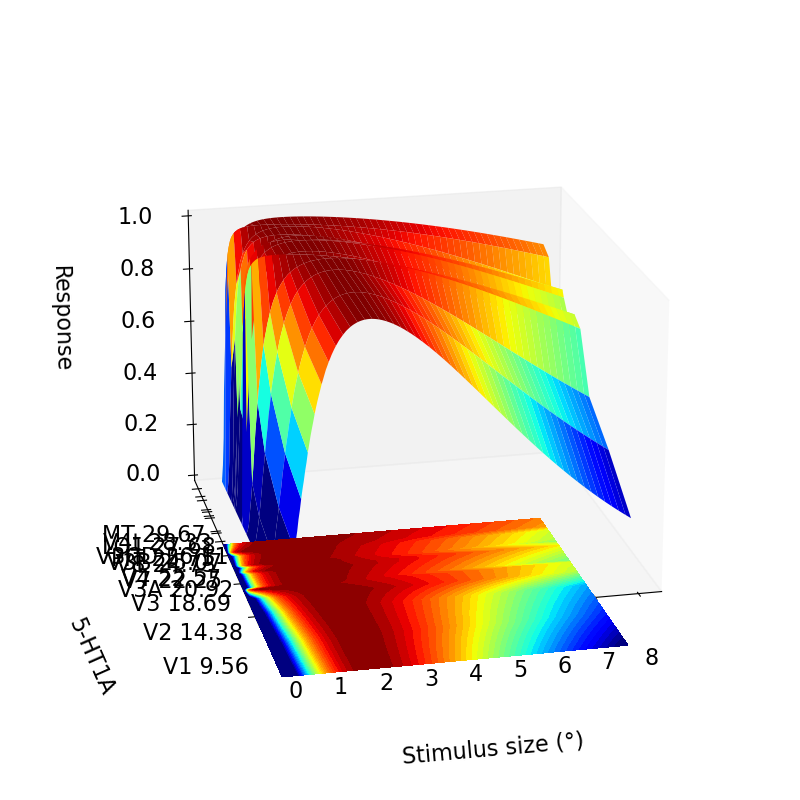

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_1
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_10d
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_10pp
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_10r
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_10v
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_11l
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_13l
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_2
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_23c
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_23d
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_24dd
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_24dv
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_25
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_31a
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_31pd
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_31pv
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_33pr
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_3a
fit-task-BAR_fit-runs-all fs

<IPython.core.display.Javascript object>


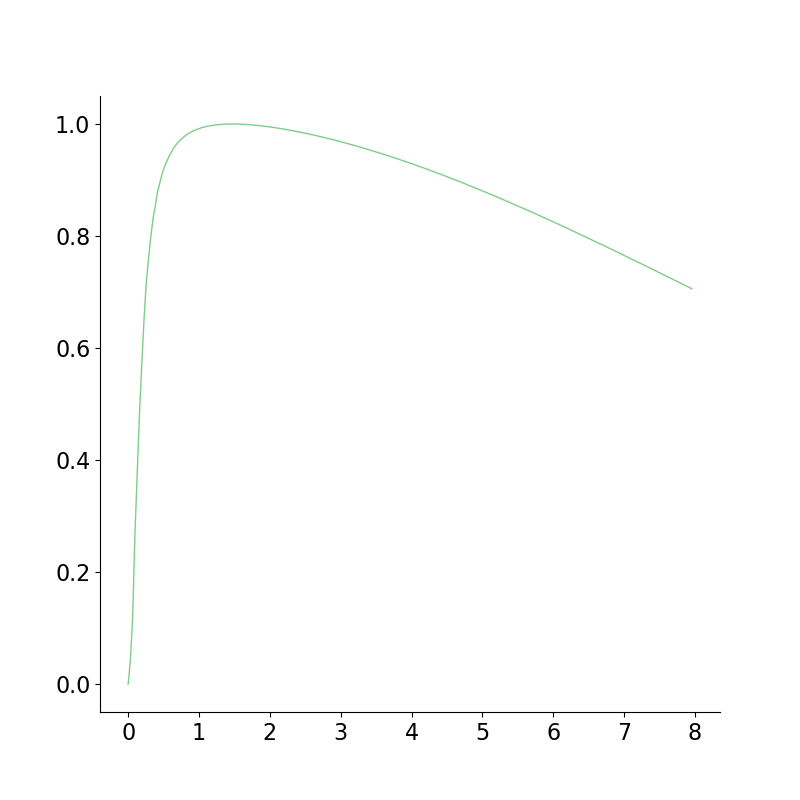

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_LO2
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_LO3
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MBelt
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MI
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MIP
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MST
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_MT


<IPython.core.display.Javascript object>


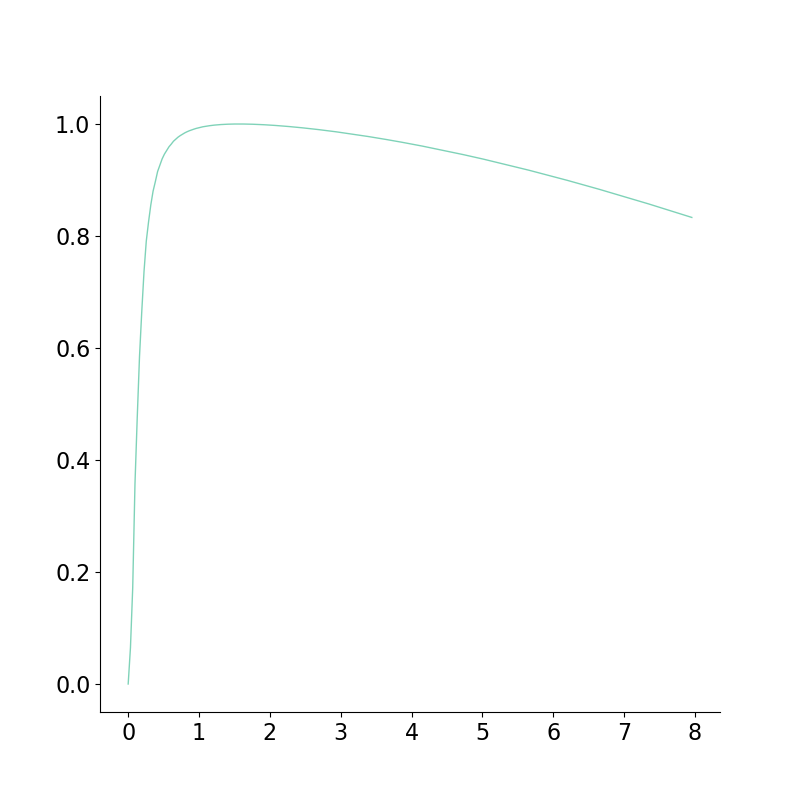

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_OFC
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_OP1
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_OP2-3
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_OP4
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_p10p
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_p24
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_p24pr
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_p32
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_p32pr
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_p47r
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_p9-46v
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PBelt
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PCV
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PeEc
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PEF
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PF
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PFcm
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PFm
fit-task-BAR_f

<IPython.core.display.Javascript object>


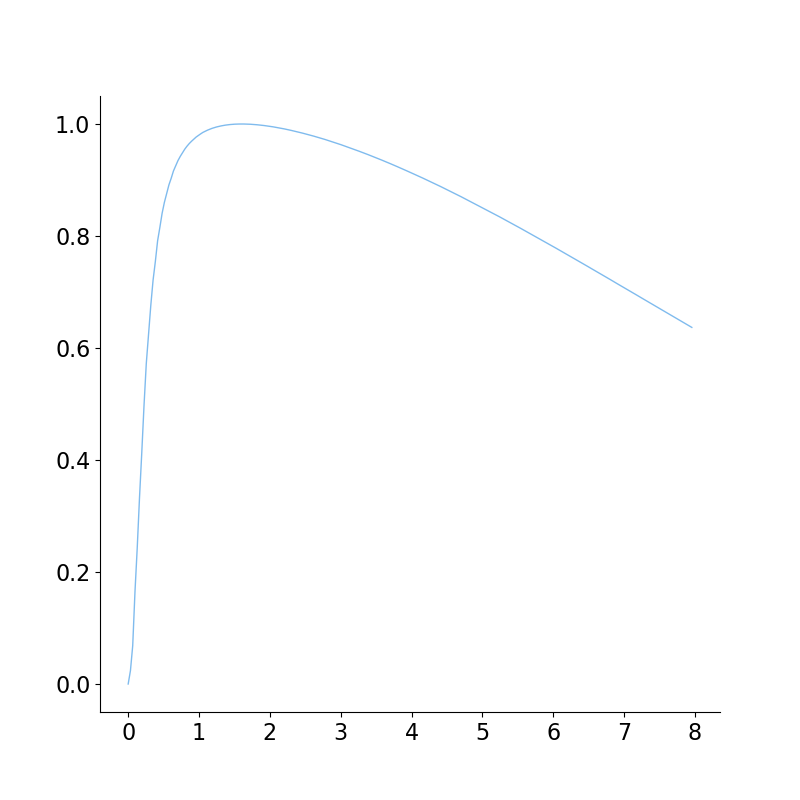

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_pOFC
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PoI1
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PoI2
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_POS1
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_POS2
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PreS
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_ProS
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_PSL
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_RI
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_RSC
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_s32
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_s6-8
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_SCEF
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_SFL
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_STGa
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_STSda
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_STSdp
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_STSva
fit-task-BAR_

<IPython.core.display.Javascript object>


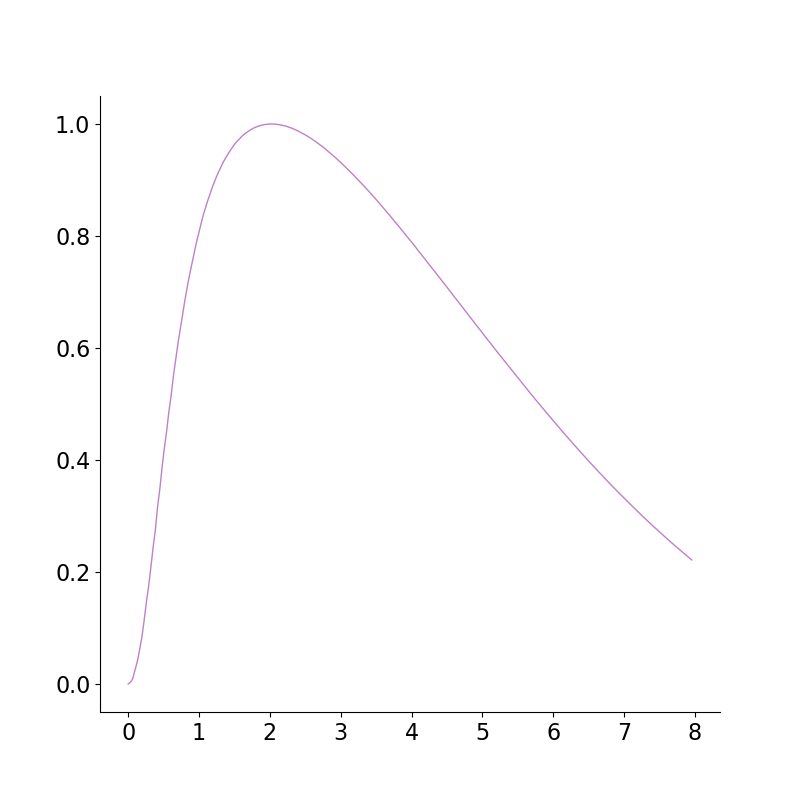

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V2


<IPython.core.display.Javascript object>


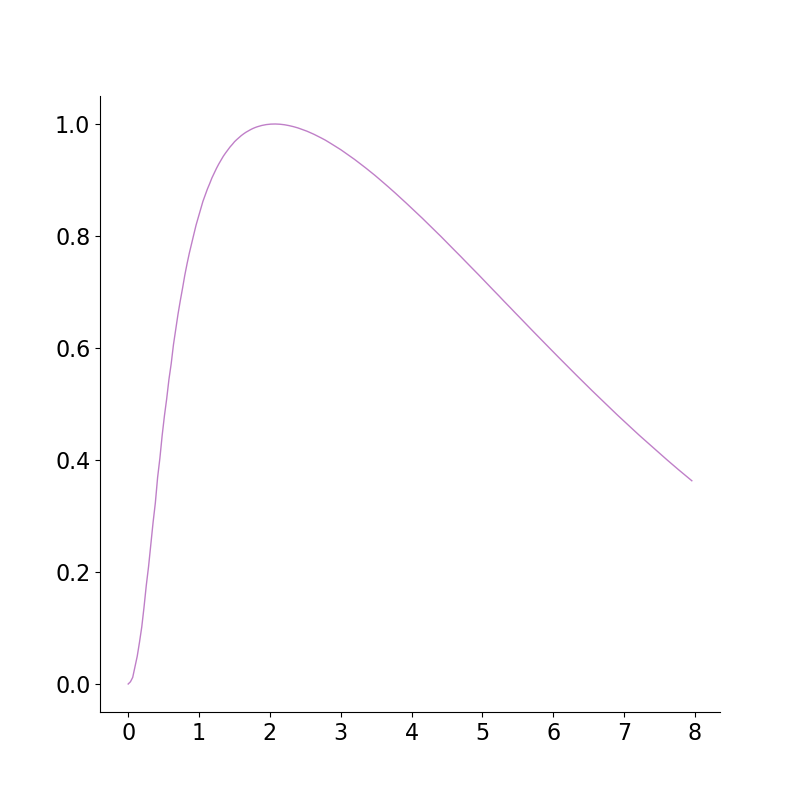

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_v23ab
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V3


<IPython.core.display.Javascript object>


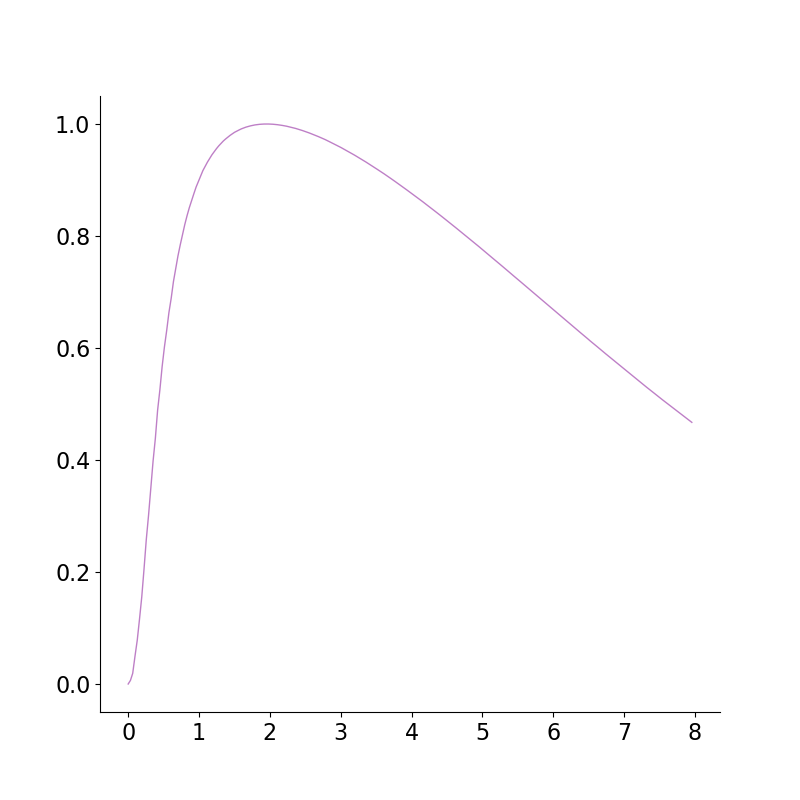

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V3A


<IPython.core.display.Javascript object>


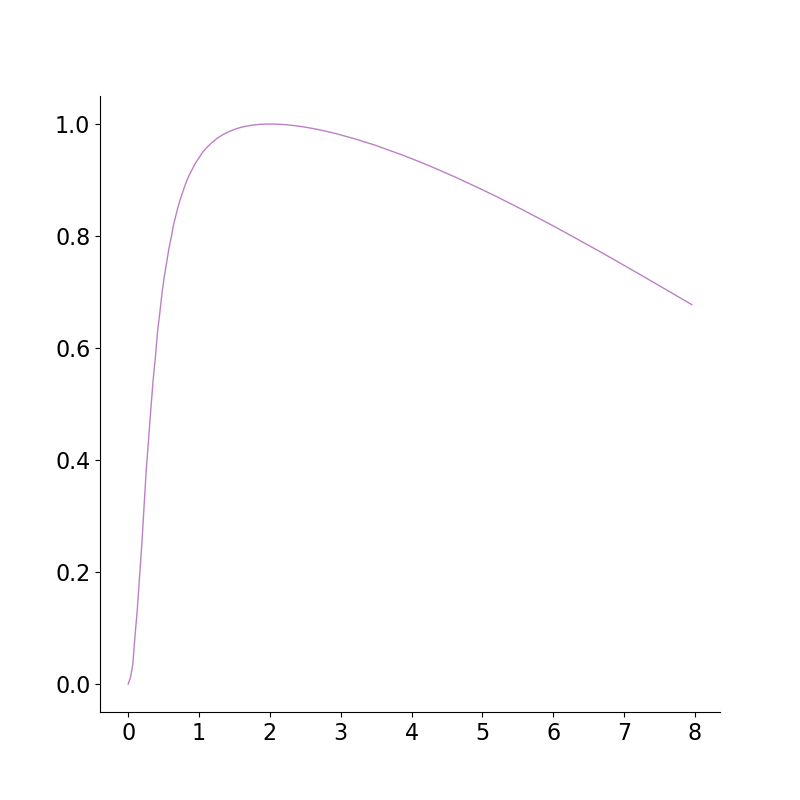

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V3B


<IPython.core.display.Javascript object>


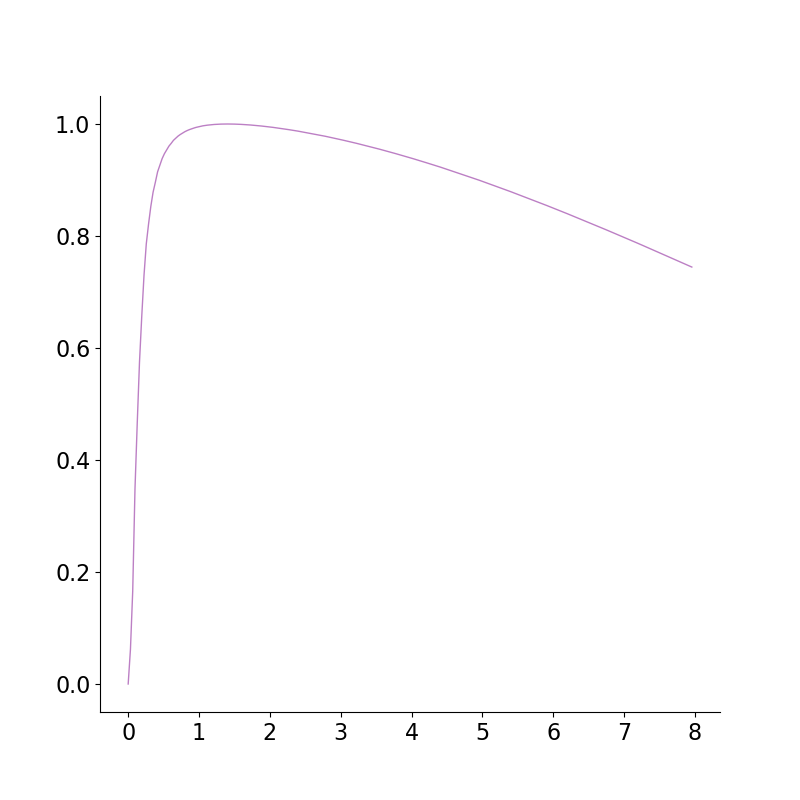

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V3CD


<IPython.core.display.Javascript object>


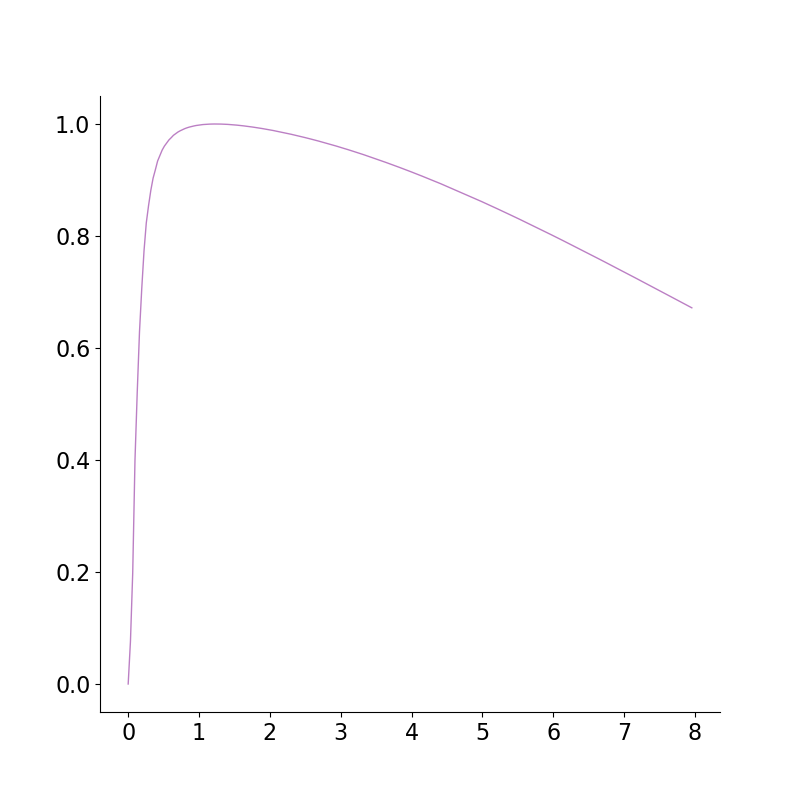

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V4


<IPython.core.display.Javascript object>


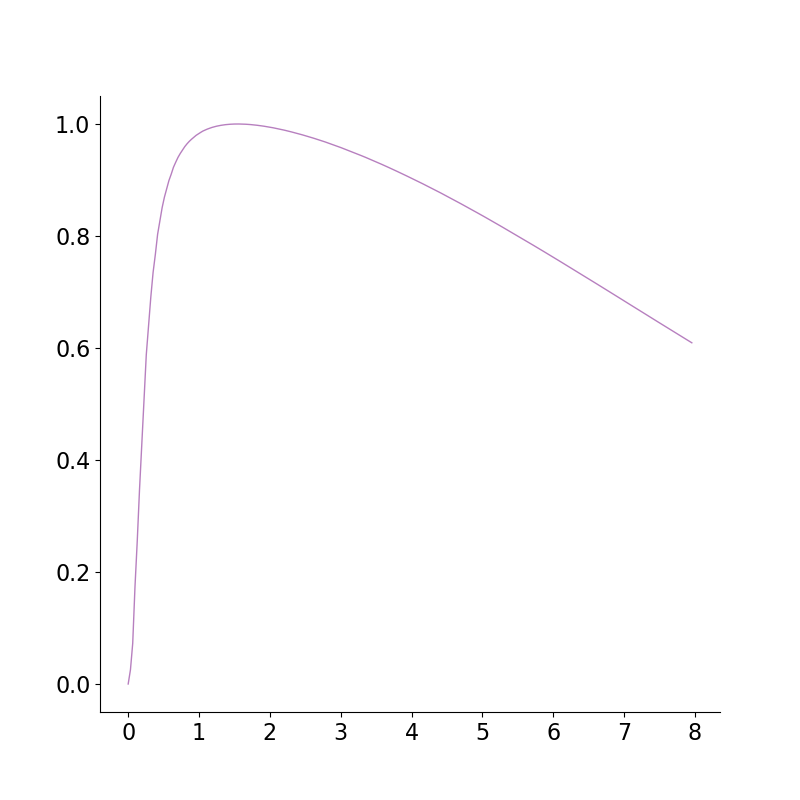

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V4t


<IPython.core.display.Javascript object>


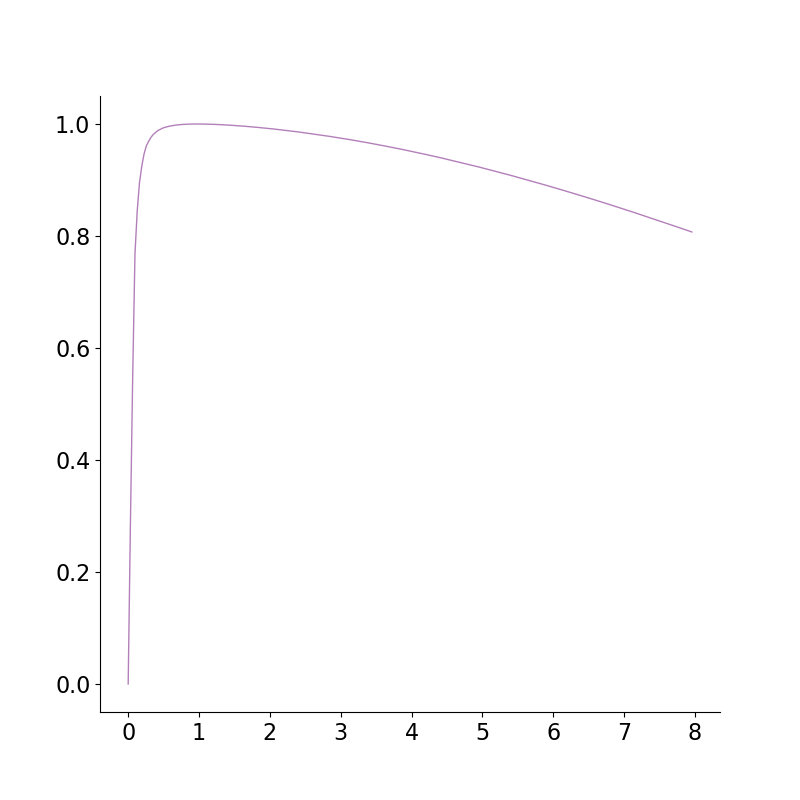

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V6
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V6A
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V7


<IPython.core.display.Javascript object>


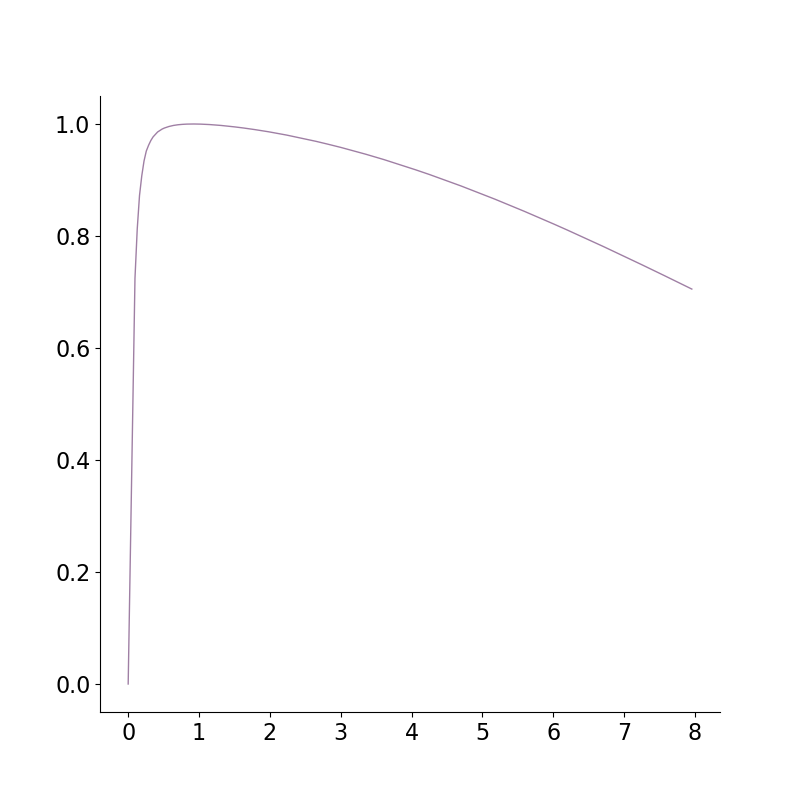

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_V8


<IPython.core.display.Javascript object>


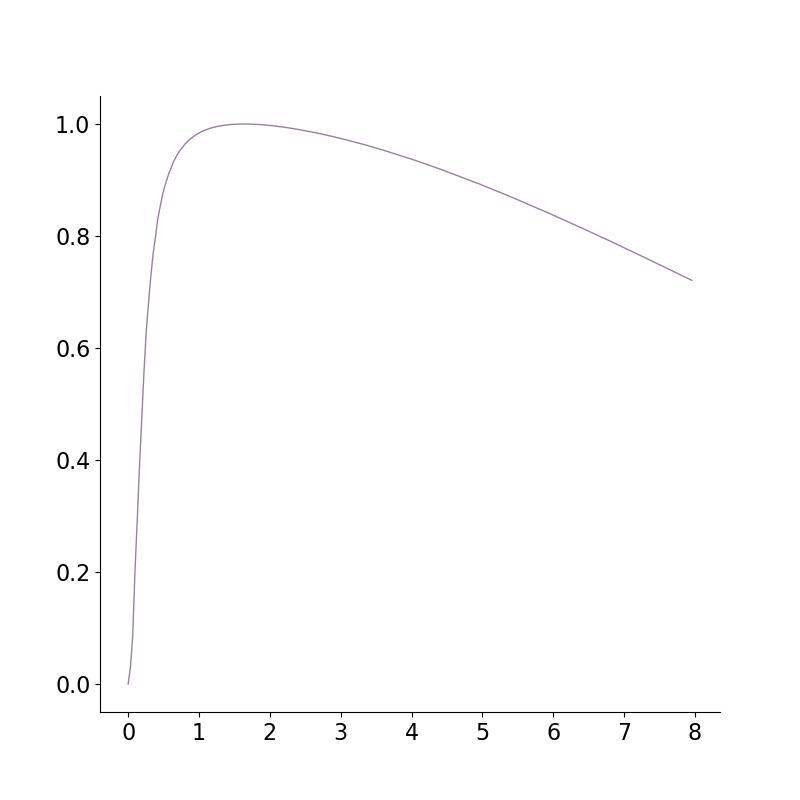

fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_VIP
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_VMV1
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_VMV2
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_VMV3
fit-task-BAR_fit-runs-all fsaverage_cvrsq glasser_VVC


0

In [22]:
#%%capture
#display(HTML("<style>div.output_scroll { height: 150em; }</style>"))
pl.close('all')
#generalized quantitative parameter plots
#'Eccentricity'#'Suppression Index (full)'#'Suppression Index#'Size (fwhmax)'#'Surround Size (fwatmin)'
#'Norm Param. B'#''Ratio (B/D)'#'Norm Param. D'#'RSq'#'CCrsq_task-1R'#'CSS Exponent'#'Amplitude'
#'Surround Amplitude'#'Size (sigma_1)'##'Size (sigma_2)'
#'Size ratio (sigma_2/sigma_1)'#C/A#'B/A'#'D/C'#'D/A'#'B/C'#'Surround volume (full)'#'Centre volume (full)'
#'(A+B)/(C+D)'#'(A*B)/(C*D)'#'(A*D)/(C*B)'#'(A+D)/(C+B)'#'Point-stim derivative'#'(C(A+B))/(A(C+D))'
#'Min/Max Response Ratio'#'Max/Min Response Ratio'#'A(C+D)/C(A+B)'##Min/Max Response Ratio (with BD)'
#'A/C'
####DoG
#'Surround volume (full)'
#'Surround/Centre Amplitude' 
#'Surround-Centre Amplitude'
#'Surround-Centre Volume'

parameters = ['Eccentricity', 'Norm Param. B', 'Norm Param. D', 'Size (sigma_1)','Size (sigma_2)', 'Polar Angle',
              '5-HT1A', '5-HT1B', '5-HT2A', '5-HT4', '5-HTT', 'GABA_A','Amplitude','Surround Amplitude', 'RSq']#,'Amplitude','Surround Amplitude']#'Size ratio (sigma_2/sigma_1)']# 'Size (sigma_1)', 'Size (sigma_2)', 'Amplitude','Surround Amplitude']

x_dims_idx = [0,1,2,3,4,5]
y_dims_idx = [12,13]

third_dim_sr_curves = '5-HT1A'#'Norm Param. D Norm_abcd'

#rois = ['custom.V1', 'custom.V2', 'custom.V3','custom.V3AB','custom.hV4','custom.LO','custom.TO','custom.VO','custom.IPS']
#rois = ['V1', 'V2', 'V3','V3AB','hV4','LO','TO','VO','IPS']#,'combined']#[roi for roi in vis_res.idx_rois['fsaverage'] if 'glasser' in roi] #'V1', 'V2', 'V3','V3AB','hV4','LO','TO','IPS','combined', 
rois = [roi for roi in vis_res.idx_rois['fsaverage'] if 'glasser' in roi]
#rois = ['glasser_V1','glasser_V2','glasser_V3','glasser_V4','glasser_V3A','glasser_V7','glasser_V3B','glasser_V3CD',
#'glasser_LO1','glasser_LO2','glasser_PIT','glasser_V8','glasser_VMV3',
#'glasser_IPS1','glasser_IP0','glasser_PGp','glasser_LO3','glasser_MT','glasser_V4t','glasser_FFC']
#rois = [ 'V1', 'V2', 'V3', 'hV4', 'VO1', 'VO2', 'PHC1', 'PHC2', 'TO2', 'TO1', 'LO2', 'LO1', 'V3B', 'V3A', 'IPS0', 'IPS1', 'IPS2', 'IPS3', 'IPS4', 'IPS5', 'SPL1', 'combined']
#rois = ['all_custom']
        
rsq_thresh = 0.2
save_figures = False
figure_path = '/Volumes/Crucial X8/PRFMapping/Figures/newfsarsqwmlowthr/size_response_glasser'

space_names = 'fsaverage'
#set to 'all' to plot all analyses
analysis_names = 'fit-task-BAR_fit-runs-all'

subject_ids = ['fsaverage_cvrsq']#'fsaverage_hcp1sthalf', 'fsaverage_hcp2ndhalf']

threshold_li = filters.threshold_li(vis_res.main_dict[space_names][analysis_names][subject_ids[0]]['Processed Results']['#Subjects with CVRSq>0']['Norm_abcd'])

vis_res.set_alpha(only_models=['Norm_abcd'], ecc_min=0.0, ecc_max=6.5, min_number_sjs=threshold_li)

vis_res.multidim_analysis(parameters, rois, rsq_thresh, save_figures, figure_path, space_names = space_names, parameter_toplevel='Receptor Maps', rsq_weights= True,
                    analysis_names = analysis_names, subject_ids = subject_ids, x_dims_idx=x_dims_idx, y_dims_idx=y_dims_idx,
                          zscore_data = False, zscore_data_across_rois = False, 
                          size_response_curves = True, third_dim_sr_curves = third_dim_sr_curves,
                          plot_corr_matrix = False, perform_ols = False, polar_plots = False,
                             cv_regression = False, bold_voxel_volume=4.096, zconfint_err_alpha=None, quantile_exclusion=0.999,
                            #vis_pca_comps_rois: fr which rois to make pca comp beta plots; 
                          #vis_pca_comps_axes: which comps to use in 2d plot of mean pca comp per roi
                        perform_pca = False, vis_pca_pycortex = False, vis_pca_comps_rois = ['combined'], vis_pca_comps_axes = [0,1], rsq_alpha_pca_plot = True,
                          perform_pls = False, vis_pls_pycortex = False)

os.system(f"open {sound_file}")

In [ ]:
[[3, 4], [2, 4], [2, 3], [1, 4], [1, 3], [1, 2], [0, 4], [0, 3], [0, 2], [0, 1]]

In [54]:
import itertools

N = 4
numbers = list(range(N+1))

combinations = []
for i in range(1, N+2):
    combinations.extend(itertools.combinations(numbers, i))

print(combinations[::-1])

[(0, 1, 2, 3, 4), (1, 2, 3, 4), (0, 2, 3, 4), (0, 1, 3, 4), (0, 1, 2, 4), (0, 1, 2, 3), (2, 3, 4), (1, 3, 4), (1, 2, 4), (1, 2, 3), (0, 3, 4), (0, 2, 4), (0, 2, 3), (0, 1, 4), (0, 1, 3), (0, 1, 2), (3, 4), (2, 4), (2, 3), (1, 4), (1, 3), (1, 2), (0, 4), (0, 3), (0, 2), (0, 1), (4,), (3,), (2,), (1,), (0,)]


# Old Cells (seaborn rsq plots, filters, visres develop)

<IPython.core.display.Javascript object>


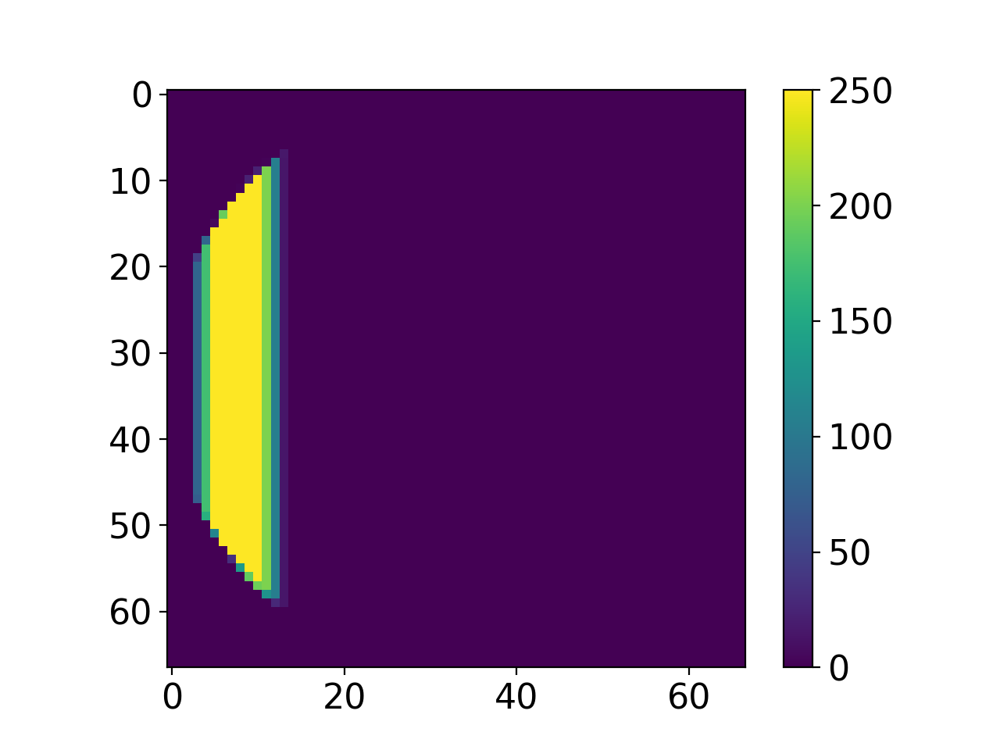

<IPython.core.display.Javascript object>


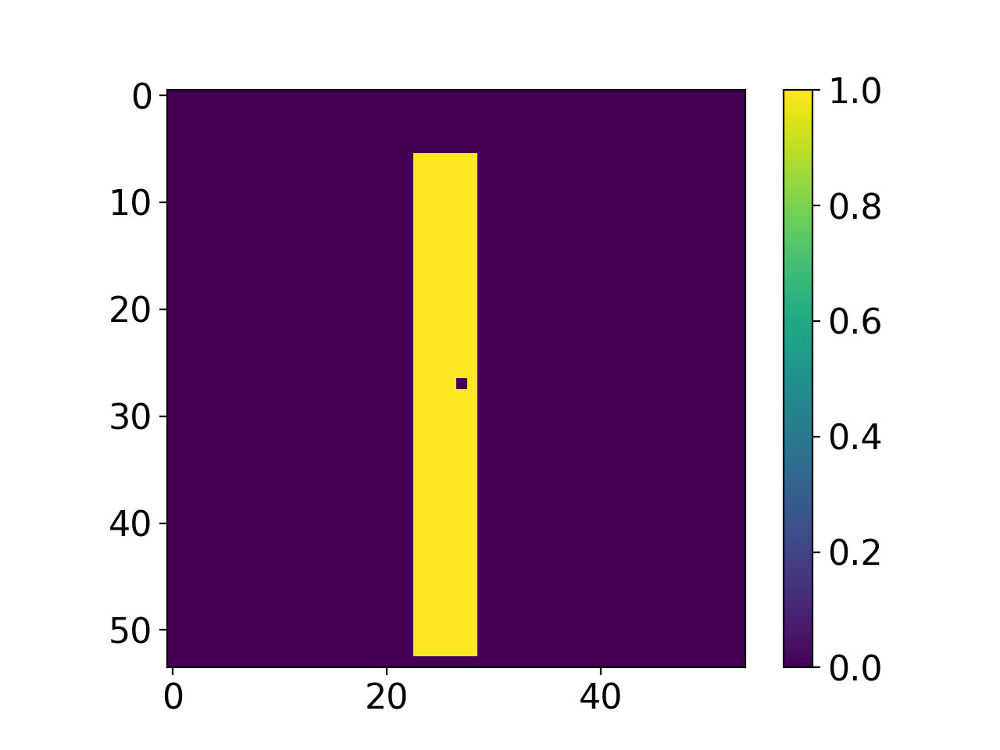

In [158]:
pl.figure()
#dm_hcp_old = np.copy(prf_stim_HCP.design_matrix)
pl.imshow(prf_stim_HCP.design_matrix[:,:,20])
pl.colorbar()
pl.figure()
pl.imshow(prf_stim_2R.design_matrix[:,:,20])
pl.colorbar()
prf_stim_HCP.design_matrix /= np.max(prf_stim_HCP.design_matrix)
prf_stim_HCP.design_matrix = np.copy(dm_hcp_old)

[ -1.6247  -1.8492  11.0807  36.263    0.       5.131   31.9523 263.0399
  53.5966]


<IPython.core.display.Javascript object>


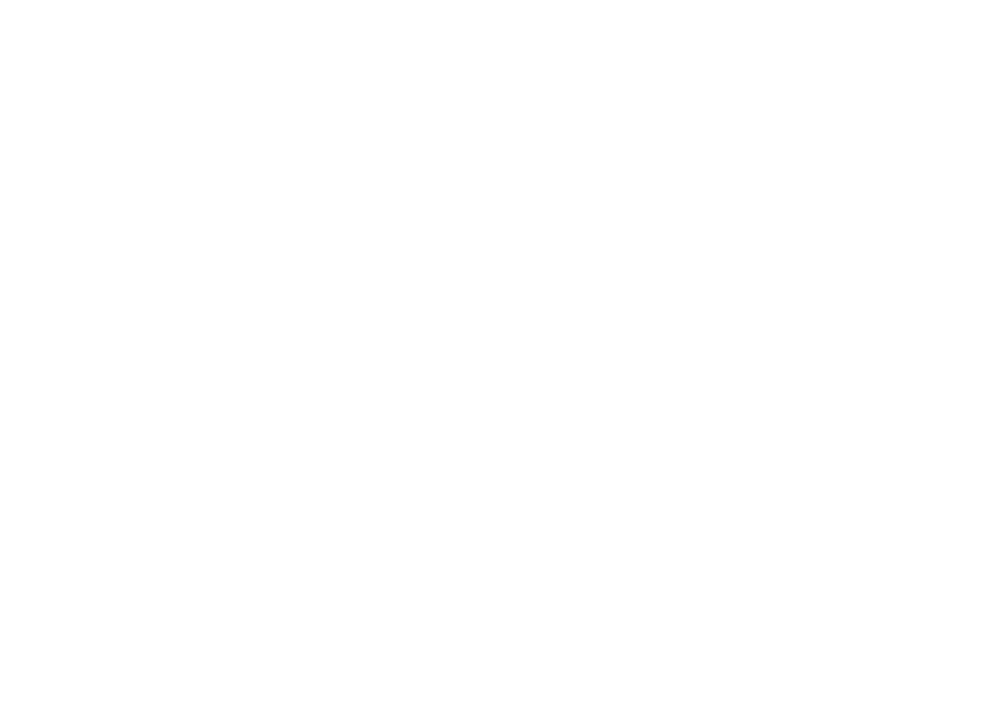

AttributeError: 'visualize_results' object has no attribute 'prf_models'

In [159]:
#params = np.copy(vis_res.main_dict['HCP']['fit-task-BAR_fit-runs-all']['148133']['Results']['Norm_abcd'][87097,:-1])
params = np.array([ -1.6247,  -1.8492,  11.0807,  36.263,  0.,  5.131 ,  31.9523, 263.0399, 53.5966])
print(params)

# rf_fig, rf_axs = pl.subplots(1, 2, figsize=(12,5))
# rf_1 = create_model_rf_wrapper('Norm_abcd',prf_stim_HCP,params,False)[0]
# if rf_1.min() < 0:
#     im_1 = rf_axs[0].imshow(rf_1, cmap='RdBu_r', vmin=rf_1.min(), vmax=-rf_1.min())
# else:
#     im_1 = rf_axs[0].imshow(rf_1, cmap='RdBu_r', vmax=rf_1.max(), vmin=-rf_1.max())
# cbar_2 = colorbar(im_1)
    
fig, axs = pl.subplots(2, 3, figsize=(14,10))
lw = 0.8

vis_res.prf_models['Norm_abcd'].stimulus = prf_stim_HCP
axs[0,0].set_title('HCPBAR')
pred_1_HCP = vis_res.prf_models['Norm_abcd'].return_prediction(*list(params))[0]
axs[0,0].plot(pred_1_HCP, linewidth=lw)

vis_res.prf_models['Norm_abcd'].stimulus = prf_stim_1R
axs[0,1].set_title('1R')
pred_1_1R = vis_res.prf_models['Norm_abcd'].return_prediction(*list(params))[0]
axs[0,1].plot(pred_1_1R, linewidth=lw)
vis_res.prf_models['Norm_abcd'].stimulus = prf_stim_1S
axs[0,2].set_title('1S')
pred_1_1S = vis_res.prf_models['Norm_abcd'].return_prediction(*list(params))[0]
axs[0,2].plot(pred_1_1S, linewidth=lw)
vis_res.prf_models['Norm_abcd'].stimulus = prf_stim_2R
axs[1,0].set_title('2R')
pred_1_2R = vis_res.prf_models['Norm_abcd'].return_prediction(*list(params))[0]
axs[1,0].plot(pred_1_2R, linewidth=lw)
vis_res.prf_models['Norm_abcd'].stimulus = prf_stim_4F
axs[1,1].set_title('4F')
pred_1_4F = vis_res.prf_models['Norm_abcd'].return_prediction(*list(params))[0]
axs[1,1].plot(pred_1_4F, linewidth=lw)
vis_res.prf_models['Norm_abcd'].stimulus = prf_stim_4R
axs[1,2].set_title('4R')
pred_1_4R = vis_res.prf_models['Norm_abcd'].return_prediction(*list(params))[0]
axs[1,2].plot(pred_1_4R, linewidth=lw)

params[-2:] *= 10
#params[3] *= 10
#params[5] *= 10


# rf_2 = create_model_rf_wrapper('Norm_abcd',prf_stim_HCP,params,False)[0]
# if rf_2.min() < 0:
#     im_2 = rf_axs[1].imshow(rf_2, cmap='RdBu_r', vmin=rf_2.min(), vmax=-rf_2.min())
# else:
#     im_2 = rf_axs[1].imshow(rf_2, cmap='RdBu_r', vmax=rf_2.max(), vmin=-rf_2.max())
# cbar_2 = colorbar(im_2)

# rf_fig.subplots_adjust(left=0, right=0.95)


vis_res.prf_models['Norm_abcd'].stimulus = prf_stim_HCP
pred_2_HCP = vis_res.prf_models['Norm_abcd'].return_prediction(*list(params))[0]
axs[0,0].plot(pred_2_HCP, linewidth=lw)
axs[0,0].fill_between(np.arange(len(pred_1_HCP)),pred_1_HCP,pred_2_HCP,alpha=0.3, color='gray')

vis_res.prf_models['Norm_abcd'].stimulus = prf_stim_1R
pred_2_1R = vis_res.prf_models['Norm_abcd'].return_prediction(*list(params))[0]
axs[0,1].plot(pred_2_1R, linewidth=lw)
axs[0,1].fill_between(np.arange(len(pred_1_1R)), pred_1_1R,pred_2_1R,alpha=0.3, color='gray')
vis_res.prf_models['Norm_abcd'].stimulus = prf_stim_1S
pred_2_1S = vis_res.prf_models['Norm_abcd'].return_prediction(*list(params))[0]
axs[0,2].plot(pred_2_1S, linewidth=lw)
axs[0,2].fill_between(np.arange(len(pred_1_1S)),pred_1_1S,pred_2_1S,alpha=0.3, color='gray')
vis_res.prf_models['Norm_abcd'].stimulus = prf_stim_2R
pred_2_2R = vis_res.prf_models['Norm_abcd'].return_prediction(*list(params))[0]
axs[1,0].plot(pred_2_2R, linewidth=lw)
axs[1,0].fill_between(np.arange(len(pred_1_2R)),pred_1_2R,pred_2_2R,alpha=0.3, color='gray')
vis_res.prf_models['Norm_abcd'].stimulus = prf_stim_4F
pred_2_4F = vis_res.prf_models['Norm_abcd'].return_prediction(*list(params))[0]
axs[1,1].plot(pred_2_4F, linewidth=lw)
axs[1,1].fill_between(np.arange(len(pred_1_4F)),pred_1_4F,pred_2_4F,alpha=0.3, color='gray')
vis_res.prf_models['Norm_abcd'].stimulus = prf_stim_4R
pred_2_4R = vis_res.prf_models['Norm_abcd'].return_prediction(*list(params))[0]
axs[1,2].plot(pred_2_4R, linewidth=lw)
axs[1,2].fill_between(np.arange(len(pred_1_4R)),pred_1_4R,pred_2_4R,alpha=0.3, color='gray')


pl.tight_layout()

fsnative fit-task-1R_fit-runs-all sub-001
fsnative fit-task-1R_fit-runs-all sub-002
fsnative fit-task-1R_fit-runs-all sub-003
fsnative fit-task-1R_fit-runs-all sub-004
fsnative fit-task-1R_fit-runs-all sub-005
fsnative fit-task-1R_fit-runs-all sub-006
fsnative fit-task-1R_fit-runs-all sub-007
fsnative fit-task-1S_fit-runs-all sub-001
fsnative fit-task-1S_fit-runs-all sub-002
fsnative fit-task-1S_fit-runs-all sub-003
fsnative fit-task-1S_fit-runs-all sub-004
fsnative fit-task-1S_fit-runs-all sub-005
fsnative fit-task-1S_fit-runs-all sub-006
fsnative fit-task-1S_fit-runs-all sub-007
fsnative fit-task-2R_fit-runs-all sub-001
fsnative fit-task-2R_fit-runs-all sub-002
fsnative fit-task-2R_fit-runs-all sub-003
fsnative fit-task-2R_fit-runs-all sub-004
fsnative fit-task-2R_fit-runs-all sub-005
fsnative fit-task-2R_fit-runs-all sub-006
fsnative fit-task-2R_fit-runs-all sub-007
fsnative fit-task-4F_fit-runs-all sub-001
fsnative fit-task-4F_fit-runs-all sub-002
fsnative fit-task-4F_fit-runs-all 

../utils/visualize_results.py:1835: RuntimeWarning: invalid value encountered in less
  alpha[analysis][subj][roi] *= (subj_res['Processed Results'][param][model]<supp_max)


fsnative fit-task-1R_fit-runs-all sub-003
fsnative fit-task-1R_fit-runs-all sub-004
fsnative fit-task-1R_fit-runs-all sub-005
fsnative fit-task-1R_fit-runs-all sub-006
fsnative fit-task-1R_fit-runs-all sub-007
fsnative fit-task-1R_fit-runs-all Group
fsnative fit-task-1S_fit-runs-all sub-001
fsnative fit-task-1S_fit-runs-all sub-002
fsnative fit-task-1S_fit-runs-all sub-003
fsnative fit-task-1S_fit-runs-all sub-004
fsnative fit-task-1S_fit-runs-all sub-005
fsnative fit-task-1S_fit-runs-all sub-006
fsnative fit-task-1S_fit-runs-all sub-007
fsnative fit-task-1S_fit-runs-all Group
fsnative fit-task-2R_fit-runs-all sub-001
fsnative fit-task-2R_fit-runs-all sub-002
fsnative fit-task-2R_fit-runs-all sub-003
fsnative fit-task-2R_fit-runs-all sub-004
fsnative fit-task-2R_fit-runs-all sub-005
fsnative fit-task-2R_fit-runs-all sub-006
fsnative fit-task-2R_fit-runs-all sub-007
fsnative fit-task-2R_fit-runs-all Group
fsnative fit-task-4F_fit-runs-all sub-001
fsnative fit-task-4F_fit-runs-all sub-00

<IPython.core.display.Javascript object>


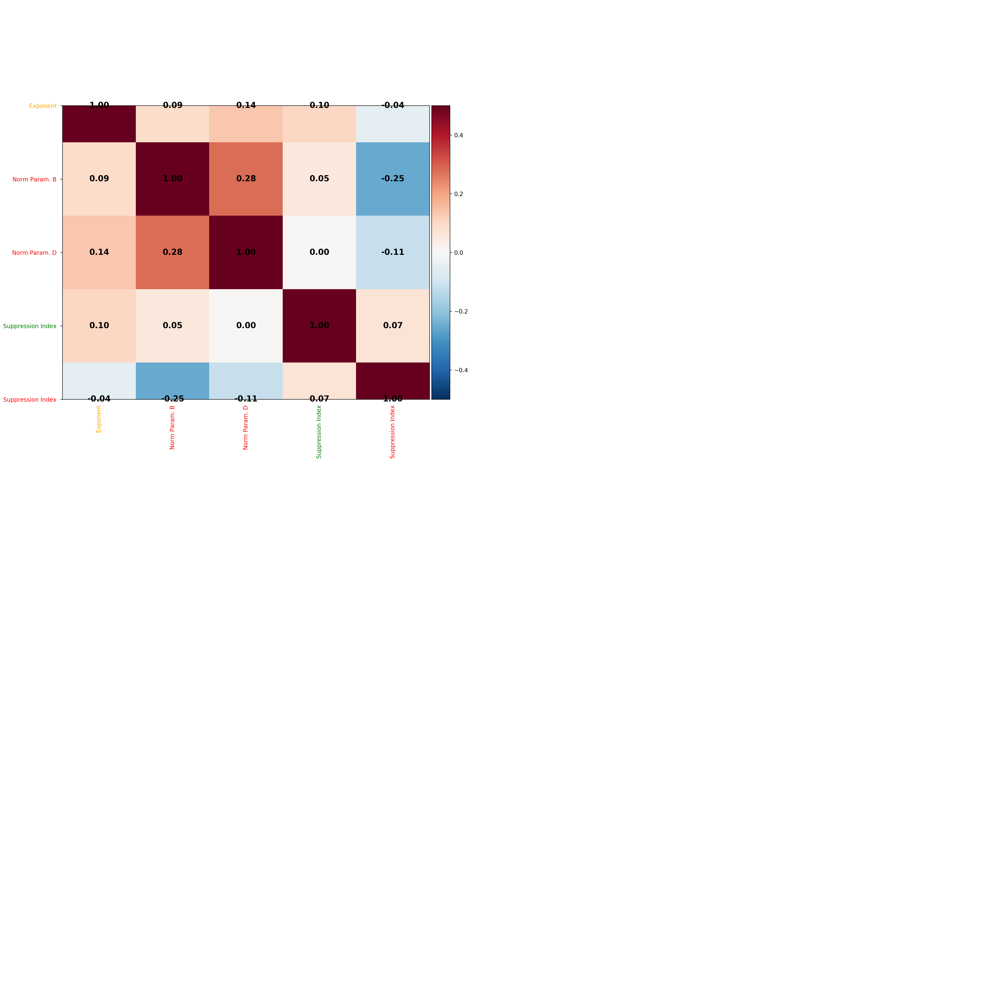

['Norm Param. B Norm_abcd', 'Norm Param. D Norm_abcd', 'Suppression Index Norm_abcd']
1D y
Estimated betas CSS Exponent CSS [ 0.0563014   0.11781437 -0.01566805]
RSq 0.02186111852627759
Estimated betas Suppression Index DoG [ 0.07614899 -0.00708576  0.08707675]
RSq 0.009908396878212213


0

In [34]:
pl.close('all')
display(HTML("<style>div.output_scroll { height: 50em; }</style>"))
#generalized quantitative parameter plots
#'Eccentricity'#'Suppression Index (full)'#'Suppression Index#'Size (fwhmax)'#'Surround Size (fwatmin)'
#'Norm Param. B'#''Ratio (B/D)'#'Norm Param. D'#'RSq'#'CCrsq_task-1R'#'CSS Exponent'#'Amplitude'
#'Surround Amplitude'#'Size (sigma_1)'##'Size (sigma_2)'
#'Size ratio (sigma_2/sigma_1)'#C/A#'B/A'#'D/C'#'D/A'#'B/C'#'Surround volume (full)'#'Centre volume (full)'
#'(A+B)/(C+D)'#'(A*B)/(C*D)'#'(A*D)/(C*B)'#'(A+D)/(C+B)'#'Point-stim derivative'#'(C(A+B))/(A(C+D))'
#'Min/Max Response Ratio'#'Max/Min Response Ratio'#'A(C+D)/C(A+B)'##Min/Max Response Ratio (with BD)'
#'A/C'
####DoG
#'Surround volume (full)'
#'Surround/Centre Amplitude' 
#'Surround-Centre Amplitude'
#'Surround-Centre Volume'

parameters = ['Suppression Index', 
              'CSS Exponent', 'Norm Param. B','Norm Param. D']

rois = ['all_custom']
        
rsq_thresh = 0.3
save_figures=False

space_names = 'fsnative'

#set to 'all' to plot all analyses
analysis_names = ['fit-task-2R_fit-runs-all',
                  'fit-task-4F_fit-runs-all', 
                  'fit-task-1S_fit-runs-all',
                 'fit-task-1R_fit-runs-all',
                 'fit-task-4R_fit-runs-all']

subject_ids = 'all'

vis_res.set_alpha(only_models=['DoG', 'CSS', 'Norm_abcd'], ecc_min=0, ecc_max=4.5)


vis_res.multidim_analysis(parameters, rois, rsq_thresh, save_figures, space_names = space_names, plot_receptors=False,
                    analysis_names = analysis_names, subject_ids = subject_ids)

os.system(f"open {sound_file}")


# Old Cells

fsnative fit-task-all_fit-runs-5050CVmedian sub-007
fsnative fit-task-all_fit-runs-5050CVmedian sub-006


<IPython.core.display.Javascript object>


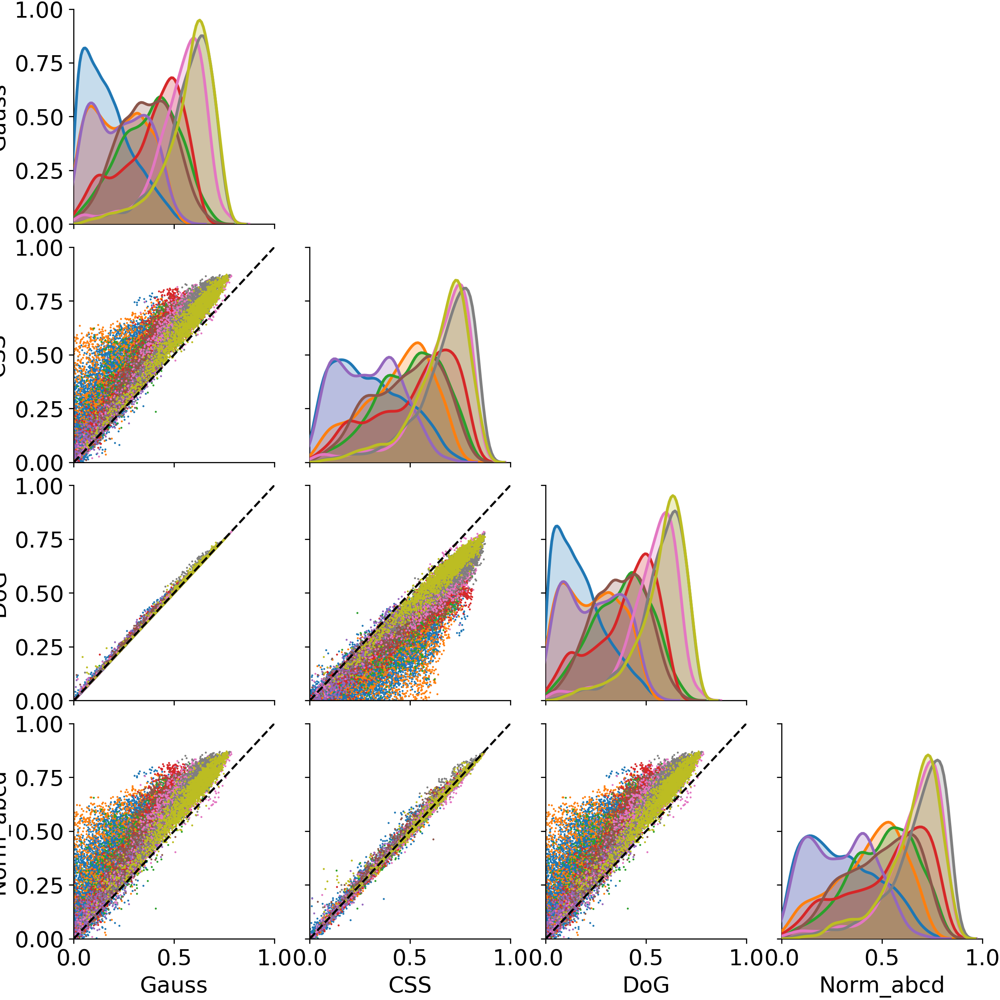

In [74]:
vis_res.set_alpha()


scatter_rois = ['custom.V1','custom.V2', 'custom.V3', 'custom.hV4','custom.VO',
                      'custom.V3AB','custom.LO','custom.TO','custom.IPS'][::-1]#,'custom.FO'
#scatter_rois = ['custom.V1','custom.V2', 'custom.V3']

#scatter_rois = ['custom.LO','custom.TO']

dataframes = []

for subj in ['sub-006', 'sub-007']:

    subj_res = vis_res.main_dict['fsnative']['fit-task-all_fit-runs-5050CVmedian'][subj]
    for roi in scatter_rois:
        alpha_roi = (roi_mask(vis_res.idx_rois[subj][roi], subj_res['Processed Results']['Alpha']['all'])>0.0)
        surround_voxels = subj_res['Processed Results']['RSq']['DoG'][alpha_roi]>subj_res['Processed Results']['RSq']['Gauss'][alpha_roi]
        nonlinear_voxels = subj_res['Processed Results']['RSq']['CSS'][alpha_roi]>subj_res['Processed Results']['RSq']['Gauss'][alpha_roi]
        nonlinear_surround_voxels = nonlinear_voxels * surround_voxels

        models = ['Gauss', 'CSS', 'DoG', 'Norm_abcd']
        
        #which voxels to compare. nonl/surr/all
        mode = 'all'
        
        if mode=='nonl':
            data={model:subj_res['Processed Results']['RSq'][model][alpha_roi][nonlinear_voxels] for model in models}
            data['ROI'] = [roi] * np.sum(nonlinear_voxels)
        elif mode=='surr':
            data={model:subj_res['Processed Results']['RSq'][model][alpha_roi][surround_voxels] for model in models}
            data['ROI'] = [roi] * np.sum(surround_voxels)
        else:
            data={model:subj_res['Processed Results']['RSq'][model][alpha_roi] for model in models}
            data['ROI'] = [roi] * np.sum(alpha_roi)
            
        dataframes.append(pds.DataFrame(data))



test = pds.concat(dataframes)


g = sns.PairGrid(test, hue="ROI")
#map_lower, map_upper also exist
g.map_offdiag(sns.scatterplot,  s=2, alpha=1, markers='o', linewidth=0)#, linewidth=0.5, edgecolor='white')
#g = g.add_legend(loc=2)
def hide_current_axis(*args, **kwds):
    pl.gca().set_visible(False)

for ax in g.axes.flat[np.arange(len(g.axes.flat))%(len(models)+1)!=0]:
    ax.plot((0, 1), (0, 1), ls="--", color='black')
    ax.set_xlim(0,1)
    ax.set_ylim(0,1)
g.map_diag(sns.kdeplot, lw=2, shade=True)
g.map_upper(hide_current_axis)

In [ ]:
#the following cells are in case we want to quickly look at some specific model/data timecourse

In [20]:
analysis_settings = '/Users/marcoaqil/analysis_settings_cartesius.yml'

with open(analysis_settings) as f:
    analysis_info = yaml.safe_load(f)

analysis_info=vis_res.main_dict['fsnative']['fit-task-1R_fit-runs-all']['sub-006']['analysis_info']
    
# note that screenshot paths and task names should be in the same order
n_pix = analysis_info["n_pix"]
discard_volumes = analysis_info["discard_volumes"]
screenshot_paths = analysis_info["screenshot_paths"]
screen_size_cm = analysis_info["screen_size_cm"]
screen_distance_cm = analysis_info["screen_distance_cm"]
TR = analysis_info["TR"]

task_names = analysis_info["task_names"]
data_path = analysis_info["data_path"]
fitting_space = analysis_info["fitting_space"]
save_raw_timecourse = analysis_info["save_raw_timecourse"]

filter_predictions = analysis_info["filter_predictions"]
filter_type = analysis_info["filter_type"]

first_modes_to_remove = analysis_info["first_modes_to_remove"]
last_modes_to_remove_percent = analysis_info["last_modes_to_remove_percent"]

window_length = analysis_info["window_length"]
polyorder = analysis_info["polyorder"]
highpass = analysis_info["highpass"]
add_mean = analysis_info["add_mean"]

filter_params = {x:analysis_info[x] for x in ["first_modes_to_remove",
                                              "last_modes_to_remove_percent",
                                              "window_length",
                                              "polyorder",
                                              "highpass",
                                              "add_mean"]}

n_jobs = analysis_info["n_jobs"]
hrf = analysis_info["hrf"]
verbose = analysis_info["verbose"]
rsq_threshold = analysis_info["rsq_threshold"]
models_to_fit = analysis_info["models_to_fit"]
n_batches = analysis_info["n_batches"]
fit_hrf = analysis_info["fit_hrf"]
fix_bold_baseline = analysis_info["fix_bold_baseline"]
if fix_bold_baseline:
    norm_bold_baseline = analysis_info["norm_bold_baseline"]


crossvalidate = analysis_info["crossvalidate"]
save_noise_ceiling = False

if crossvalidate and "fit_task" in analysis_info and "fit_runs" in analysis_info:
    print("Can only specify one between fit_task and fit_runs for crossvalidation.")
    raise IOError
elif crossvalidate and "fit_task" in analysis_info:
    print("Performing crossvalidation over tasks.") 
    fit_task = analysis_info["fit_task"]
    fit_runs = None
elif crossvalidate and "fit_runs" in analysis_info:
    print("Performing crossvalidation over runs.")    
    fit_task = None
    fit_runs = analysis_info["fit_runs"]
    save_noise_ceiling = analysis_info["save_noise_ceiling"]
else:
    print("Not performing crossvalidation.")
    fit_task = None
    fit_runs = None        

single_hrf = analysis_info["single_hrf"]
return_noise_ceiling_fraction = analysis_info["return_noise_ceiling_fraction"]
    
xtol = analysis_info["xtol"]
ftol = analysis_info["ftol"]

dm_edges_clipping = analysis_info["dm_edges_clipping"]
baseline_volumes_begin_end = analysis_info["baseline_volumes_begin_end"]
min_percent_var = analysis_info["min_percent_var"]

param_bounds = analysis_info["param_bounds"]
pos_prfs_only = analysis_info["pos_prfs_only"]
normalize_RFs = analysis_info["normalize_RFs"]


param_constraints = analysis_info["param_constraints"]
surround_sigma_larger_than_centre = analysis_info["surround_sigma_larger_than_centre"]
positive_centre_only = analysis_info["positive_centre_only"]

n_chunks = analysis_info["n_chunks"]
refit_mode = analysis_info["refit_mode"].lower()

if "norm" in models_to_fit and "norm_model_variant" in analysis_info:
    norm_model_variant = analysis_info["norm_model_variant"]
else:
    norm_model_variant = "abcd"

if "roi_idx_path" in analysis_info:
    roi_idx_path = analysis_info["roi_idx_path"].replace("$subj$", subj)
    if os.path.exists(roi_idx_path):
        roi_idx = np.load(roi_idx_path)
        print(f"Using ROI mask from: {roi_idx_path}")
    else:
        print("ROI mask does not exist. Fitting all.")
        roi_idx = None
else:
    roi_idx = None

if "data_scaling" in analysis_info:
    data_scaling = analysis_info["data_scaling"]
else:
    data_scaling = None

if not param_bounds and norm_model_variant != "abcd":
    print("Norm model variant "+norm_model_variant+" was selected, \
          but param_bounds=False. param_bounds will be set to True.")
    param_bounds = True
    
 
screenshot_paths = [f"/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/FS7_results/timecourses/task-{task}_screenshots" for task in task_names]

data_path = "/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires"

Not performing crossvalidation.


In [24]:
#create stim
prf_stim = create_full_stim(screenshot_paths,
                n_pix,
                discard_volumes,
                baseline_volumes_begin_end,                                         
                dm_edges_clipping,
                screen_size_cm,
                screen_distance_cm,
                TR,
                task_names)

test_prf_stim = prf_stim


Design matrix completed
{'periods': array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  58,  59,
        60,  61,  62, 108, 109, 110, 111, 158, 159, 160, 161, 208, 209,
       210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220]), '1R': array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  58,  59,
        60,  61,  62, 108, 109, 110, 111, 158, 159, 160, 161, 208, 209,
       210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220])}


In [25]:
print(prf_stim.late_iso_dict['1R'])

[  0   1   2   3   4   5   6   7   8   9  10  58  59  60  61  62 108 109
 110 111 158 159 160 161 208 209 210 211 212 213 214 215 216 217 218 219
 220]


In [23]:
from utils.preproc_utils import prepare_data
tc_full_iso_nonzerovar_dict = prepare_data('sub-001',
                                           prf_stim,
                                           test_prf_stim,

                                           discard_volumes,
                                           min_percent_var,
                                           fix_bold_baseline,

                                           filter_type,

                                           filter_params,

                                           data_path,
                                           fitting_space,
                                           data_scaling,
                                           roi_idx,
                                           save_raw_timecourse,

                                           crossvalidate,
                                           fit_runs,
                                           fit_task,
                                           save_noise_ceiling)

For task 1R, hemisphere L of subject sub-001, a total of 0 runs were found.


IndexError: invalid index to scalar variable.

In [88]:
#initialize models 
prf_stim = vis_res.prf_stim
gg = Iso2DGaussianModel(stimulus=prf_stim,
                          hrf=hrf,
                          filter_predictions=filter_predictions,
                          filter_type=filter_type,
                          filter_params=filter_params,
                          normalize_RFs=normalize_RFs)


In [25]:
timecourse_example = tc_full_iso_nonzerovar_dict['tc'][:5000]
if crossvalidate:
    timecourse_example_test = tc_full_iso_nonzerovar_dict['tc_test'][:5000]

gf = Iso2DGaussianFitter(
    data=timecourse_example, model=gg, n_jobs=8, fit_hrf=fit_hrf)


# gauss grid params
grid_nr = 20
max_ecc_size = prf_stim.screen_size_degrees/2.0
sizes, eccs, polars = max_ecc_size * np.linspace(0.25, 1, grid_nr)**2, \
    max_ecc_size * np.linspace(0.1, 1, grid_nr)**2, \
    np.linspace(0, 2*np.pi, grid_nr)


gf.grid_fit(ecc_grid=eccs,
                polar_grid=polars,
                size_grid=sizes,
                verbose=True,
                n_batches=5,
                pos_prfs_only=pos_prfs_only)

Each batch contains approx. 1000 voxels.


[Parallel(n_jobs=8)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done   2 out of   5 | elapsed:   36.7s remaining:   55.1s
[Parallel(n_jobs=8)]: Done   5 out of   5 | elapsed:   36.8s finished


In [ ]:
ss=prf_stim.screen_size_degrees
inf=np.inf
eps=0.1
gauss_bounds = [(-2*ss, 2*ss),  # x
                    (-2*ss, 2*ss),  # y
                    (eps, 2*ss),  # prf size
                    (0, +inf),  # prf amplitude
                    (0, +inf)]  # bold baseline


gf.iterative_fit(rsq_threshold=rsq_threshold, verbose=True,
                         bounds=gauss_bounds,
                         constraints=[],
                             xtol=0.01,
                             ftol=0.01)

In [ ]:
gf.iterative_search_params[gf.iterative_search_params[:,-1]>0.05,-1].mean()

In [67]:
gf.crossvalidate_fit(timecourse_example_test,
                    test_stimulus=test_prf_stim,
                    single_hrf=False)

In [89]:
#initialize models
gg_css = CSS_Iso2DGaussianModel(stimulus=prf_stim,
                          hrf=hrf,
                          filter_predictions=False,
                          filter_type=filter_type,
                          filter_params=filter_params,
                          normalize_RFs=normalize_RFs)

gg_norm = Norm_Iso2DGaussianModel(stimulus=prf_stim,
                                    hrf=hrf,
                                    filter_predictions=False,
                                  filter_type=filter_type,
                                  filter_params=filter_params,
                                    normalize_RFs=normalize_RFs)

gg_dog = DoG_Iso2DGaussianModel(stimulus=prf_stim,
                                  hrf=hrf,
                                  filter_predictions=False,
                                  filter_type=filter_type,
                                  filter_params=filter_params,
                                  normalize_RFs=normalize_RFs)

fsnative fit-task-all_fit-runs-5050CVmedian sub-007
fsnative fit-task-all_fit-runs-5050CVmedian sub-006
Norm: [  2.47778173   2.55227566   1.60557033   2.29009813 100.
   0.13843336   5.45019057  10.69314631   6.57266898   0.79871721]
DoG: [  3.33367434   4.02407948   3.15275621   0.66442862 100.
   0.62023766   3.23889284   0.66422295]
Gauss: [  2.98813896   3.23119819   1.5598178    0.04754444 100.
   0.61688427]
CSS: [  2.66988154   2.60702748   0.41547665   3.50564888 100.
   0.13159887   0.72318679]


<IPython.core.display.Javascript object>


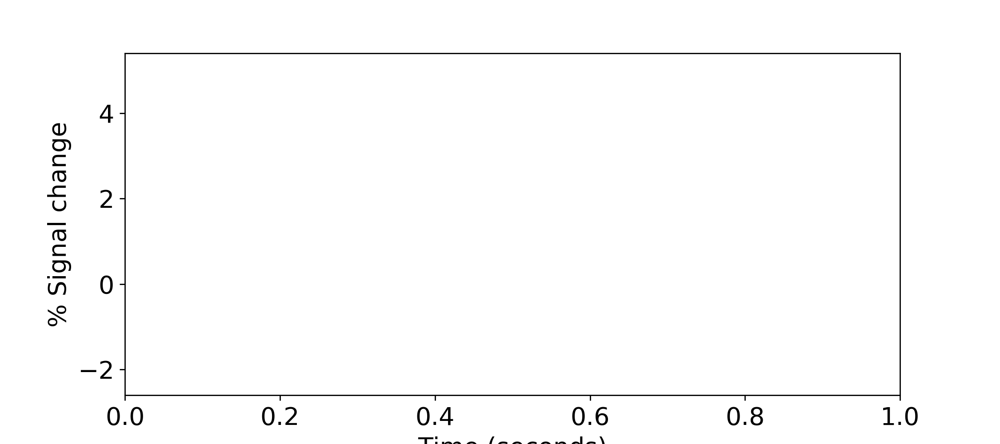

KeyError: 'timecourse_analysis_time'

In [81]:
subj='sub-006'
vis_res.set_alpha(only_models=['Gauss','CSS','DoG','Norm_abcd'])
pl.close('all')

subj_res=vis_res.main_dict['fsnative']['fit-task-1S_fit-runs-all'][subj]


#timecourse = [np.load(f'/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/timecourses_folder/{subj}_timecourse_space-fsnative_task-2R_run-{num}.npy') for num in range(6)]


rois = ['custom.V1', 'custom.V2', 'custom.V3' ,'custom.hV4','custom.VO',
                      'custom.V3AB','custom.LO','custom.TO','custom.IPS']
rsq_thresh = 0.6

alpha_roi = (roi_mask(np.concatenate(tuple([vis_res.idx_rois[subj][roi] for roi in rois])), subj_res['Processed Results']['Alpha']['all']))>rsq_thresh#*(subj_res['Processed Results']['Surround Size (fwatmin)']['Norm']<6)
norm_css_diff = subj_res['Processed Results']['RSq']['Norm_abcd']-subj_res['Processed Results']['RSq']['CSS']
norm_dog_diff = subj_res['Processed Results']['RSq']['Norm_abcd']-subj_res['Processed Results']['RSq']['DoG']
dog_gauss_diff = subj_res['Processed Results']['RSq']['DoG']-subj_res['Processed Results']['RSq']['Gauss']

alpha_roi *= (norm_css_diff>0.1)
alpha_roi *= (norm_dog_diff>0.1)
#alpha_roi *= (subj_res['Processed Results']['RSq']['DoG']-subj_res['Processed Results']['RSq']['Gauss'] >0.05)
#alpha_roi *= (subj_res['Processed Results']['RSq']['CSS']-subj_res['Processed Results']['RSq']['Gauss'] >0.08)

#res_num = np.argsort((subj_res['Processed Results']['RSq']['DoG'][alpha_roi]-subj_res['Processed Results']['RSq']['Gauss'][alpha_roi]))

res_num = np.argsort((norm_css_diff[alpha_roi]))#+(norm_dog_diff[alpha_roi]))
#also with alpha max ecc 5
#nonlinear poster: 5,6 norm_dog_diff subj006 thresh 0.6
#surround poster: 17,18 norm_css_diff subj006 thresh 0.4
for i in range(1,10):
    
    v_num = np.where(np.nonzero(subj_res['mask'])[0] == np.nonzero(alpha_roi)[0][res_num[-i]])[0][0]

    np.set_printoptions(suppress=True)
    print(f"Norm: {subj_res['Results']['Norm_abcd'][v_num]}")
    print(f"DoG: {subj_res['Results']['DoG'][v_num]}")
    print(f"Gauss: {subj_res['Results']['Gauss'][v_num]}")
    print(f"CSS: {subj_res['Results']['CSS'][v_num]}")

    pl.figure(str(i), figsize=(9, 4)) #figsize=(18, 7
    pl.ylim((-2.6,5.4))
    #pl.xlim((0,330))
    pl.ylabel("% Signal change")
    pl.xlabel("Time (seconds)")
    
    cmap = cm.get_cmap('tab10')

    #tc_train = np.load(f"/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/FS7_results/timecourses/{subj}_timecourse_space-fsnative{subj_res['analysis_info']['timecourse_analysis_time']}.npy")[v_num]#np.mean(timecourse[1::2],axis=0)[v_num]#np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/timecourses_folder/sub-006_timecourse_space-fsnative2020-04-20-12-22-52.npy')[v_num]#
    #tc_train *= (100/tc_train.mean())
    #tc_train += (tc_train.mean() - np.median(tc_train[prf_stim.late_iso_dict['2R']]))
    
    #pl.plot(tc_train, label='train', linestyle = ':', color='blue')

    #tc_test = np.load(f"/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/FS7_results/timecourses/{subj}_timecourse-test_space-fsnative{subj_res['analysis_info']['timecourse_analysis_time']}.npy")[v_num]#np.mean(timecourse[::2],axis=0)[v_num]#np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/timecourses_folder/sub-006_timecourse-test_space-fsnative2020-04-20-12-22-52.npy')[v_num]#
    #tc_test *= (100/tc_test.mean())
    #tc_test += (tc_test.mean() - np.median(tc_test[prf_stim.late_iso_dict['2R']]))
    
    mean_data = -100+(tc_train+tc_test)/2
    norm_pred = -100+gg_norm.return_prediction(*list(subj_res['Results']['Norm_abcd'][v_num,:-1].T))[0]
    dog_pred = -100+gg_dog.return_prediction(*list(subj_res['Results']['DoG'][v_num,:-1].T))[0]
    css_pred = -100+gg_css.return_prediction(*list(subj_res['Results']['CSS'][v_num,:-1].T))[0]
    gauss_pred = -100+gg.return_prediction(*list(subj_res['Results']['Gauss'][v_num,:-1].T))[0]
    
    pl.plot(1.5*np.arange(len(tc_test)),np.zeros(len(tc_test)),linestyle='--',linewidth=0.5)
    pl.plot(1.5*np.arange(len(tc_test)),norm_pred, color=cmap(3), label=f"Norm ({subj_res['Results']['Norm_abcd'][v_num][-1]:.2f})")
    pl.plot(1.5*np.arange(len(tc_test)),dog_pred, color=cmap(2), label=f"DoG ({subj_res['Results']['DoG'][v_num][-1]:.2f})")
    pl.plot(1.5*np.arange(len(tc_test)),css_pred, color=cmap(1), label=f"CSS ({subj_res['Results']['CSS'][v_num][-1]:.2f})")    
    pl.plot(1.5*np.arange(len(tc_test)),gauss_pred, color=cmap(0), label=f"Gauss ({subj_res['Results']['Gauss'][v_num][-1]:.2f})") #divide by /noise_ceiling[v_num] to get NC frac
    pl.plot(1.5*np.arange(len(tc_test)),mean_data, label='Data', linestyle = ':', marker='s', markersize=2, color='black', linewidth=1)
    
    pl.fill_between(1.5*np.arange(len(tc_test)), np.min([norm_pred,dog_pred],axis=0), gauss_pred, label='Surround suppression', alpha=0.25,color='gray')
    
    print(f"Norm: {subj_res['Processed Results']['RSq']['Norm_abcd'][alpha_roi][res_num[-i]]}")
    print(f"DoG: {subj_res['Processed Results']['RSq']['DoG'][alpha_roi][res_num[-i]]}")
    print(f"Gauss: {subj_res['Processed Results']['RSq']['Gauss'][alpha_roi][res_num[-i]]}")
    print(f"CSS: {subj_res['Processed Results']['RSq']['CSS'][alpha_roi][res_num[-i]]}")
    pl.legend(ncol=3, fontsize='small')

    print(1-np.sum((gg_norm.return_prediction(*list(subj_res['Results']['Norm_abcd'][v_num,:-1].T))[0]-tc_test)**2, axis=-1)/(tc_test.var(-1)*tc_test.shape[-1]))
    print(1-np.sum((gg.return_prediction(*list(subj_res['Results']['Gauss'][v_num,:-1].T))[0]-tc_test)**2, axis=-1)/(tc_test.var(-1)*tc_test.shape[-1]))
    print(1-np.sum((gg_dog.return_prediction(*list(subj_res['Results']['DoG'][v_num,:-1].T))[0]-tc_test)**2, axis=-1)/(tc_test.var(-1)*tc_test.shape[-1]))

    #print(np.median(tc_test[prf_stim.late_iso_dict['2R']]))

In [340]:
pl.savefig(f"/Users/marcoaqil/PRFMapping/Figures/some_tc.pdf", bbox_inches='tight')

In [73]:
vis_res.main_dict['fsnative']['fit-task-all_fit-runs-all']['sub-001']['Results']['Norm_abcd'].shape

(244679, 10)

<IPython.core.display.Javascript object>


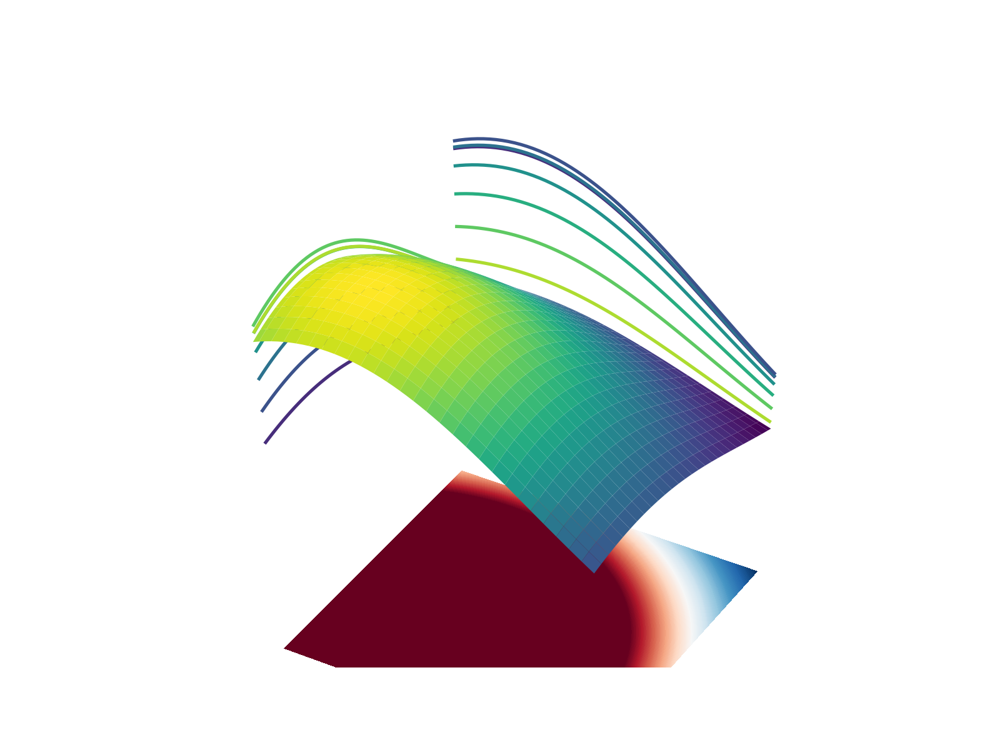

<IPython.core.display.Javascript object>


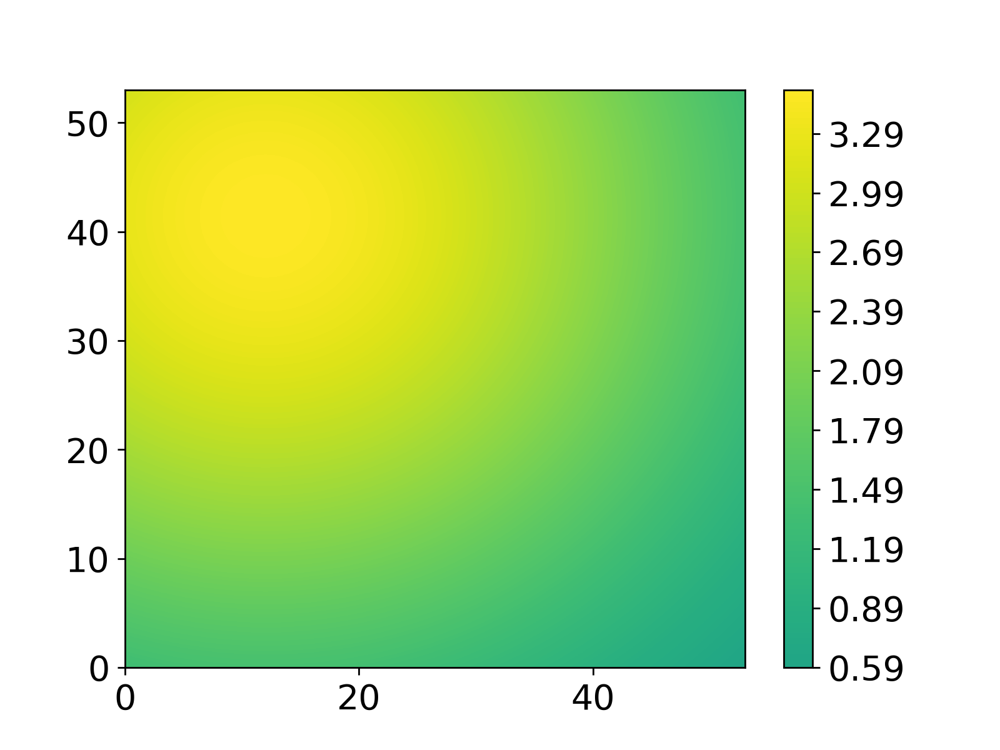

In [306]:
from prfpy.rf import gauss2D_iso_cart
from mpl_toolkits.mplot3d import Axes3D

for model in ['Norm_abcd']:#, 'Gauss', 'CSS', 'DoG']:

    fig = pl.figure(model)
    ax = fig.add_subplot(111, projection='3d', azim=210, elev=50)

    # Hide grid lines
    ax.grid(False)
    # Hide axes ticks
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_zticks([])
    ax.set_axis_off()
    
    params = subj_res['Results'][model][v_num]
    prf = params[3]*np.rot90(gauss2D_iso_cart(x=prf_stim.x_coordinates[...,np.newaxis],
                               y=prf_stim.y_coordinates[...,np.newaxis],
                               mu=(params[0], params[1]),
                               sigma=params[2],
                              normalize_RFs=False).T, axes=(1,2))
    if model == 'CSS':
        prf **= params[5]
    elif model == 'DoG':
        prf -= params[5]*np.rot90(gauss2D_iso_cart(x=prf_stim.x_coordinates[...,np.newaxis],
                               y=prf_stim.y_coordinates[...,np.newaxis],
                               mu=(params[0], params[1]),
                               sigma=params[6],
                              normalize_RFs=False).T, axes=(1,2))
    elif model == 'Norm_abcd':
        prf += params[7]
        prf /= (params[5]*np.rot90(gauss2D_iso_cart(x=prf_stim.x_coordinates[...,np.newaxis],
                               y=prf_stim.y_coordinates[...,np.newaxis],
                               mu=(params[0], params[1]),
                               sigma=params[6],
                              normalize_RFs=False).T, axes=(1,2)) + params[8])
        prf -= params[7]/params[8]
        
    
    surf = ax.plot_surface(X=prf_stim.x_coordinates, Y=prf_stim.y_coordinates, Z=prf[0], cmap='viridis', alpha=1)#, vmin=-0.1, vmax=0.1)
    
    contour_filled = ax.contourf(X=prf_stim.x_coordinates, Y=prf_stim.y_coordinates, Z=prf[0], offset=-prf[0].max()/2, cmap='RdBu_r', levels=300, vmin=prf[0].min(), vmax=prf[0].max()/2)
    contour_side_y = ax.contour(X=prf_stim.x_coordinates, Y=prf_stim.y_coordinates, Z=prf[0], offset=5.3, cmap='viridis', zdir='y')
    contour_side_x = ax.contour(X=prf_stim.x_coordinates, Y=prf_stim.y_coordinates, Z=prf[0], offset=5.3, cmap='viridis', zdir='x')

    #level_surf = ax.plot_surface(X=prf_stim.x_coordinates, Y=prf_stim.y_coordinates, Z=np.zeros_like(prf[0]), alpha=0.5, color='black')
    
    #if model in ['DoG', 'Norm_abcd']:
    #    contour_border = ax.contour(X=prf_stim.x_coordinates, Y=prf_stim.y_coordinates, Z=prf[0], levels=np.array([0]), colors='black', offset=-prf[0].max()/2)  
    #fig.colorbar(surf)
    
    fig2 = pl.figure(model+'flat')
    ax2 = fig2.add_subplot(111)
    #flatsurf = ax2.imshow(prf[0], cmap='RdBu')#, vmin=-0.1, vmax=0.1)
    flatsurf = ax2.contourf(prf[0], cmap='viridis', levels=300, vmin=-prf[0].max(), vmax=prf[0].max())#vmin=-prf[0].max(), vmax=prf[0].max()

    fig2.colorbar(flatsurf)
    #if model in ['DoG', 'Norm_abcd']:
        #ax2.contour(prf[0], levels=np.array([prf[0].min()/2]), colors='black')
    


In [ ]:
##################

In [37]:
noise_ceiling_dict=dict()

subj='sub-006'
timecourse = np.load(f'/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABD_1S/{subj}_timecourse_space-fsnative.npy')
timecourse_test = np.load(f'/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABD_1S/{subj}_timecourse-test_space-fsnative.npy')

subj_res=vis_res.main_dict['fsnative']['ABD_1S_smallbounds'][subj]

n_timepoints = timecourse.shape[-1]
noise_ceiling_scaled_odd = []
noise_ceiling_scaled_even = []

vox_data = timecourse
prediction = timecourse_test

for i in range(timecourse.shape[0]):
   
    sum_pred = np.sum(prediction[i])
    square_norm_pred = np.linalg.norm(prediction[i], ord=2)**2    
    sumd = np.sum(vox_data[i])    
    
    best_slope = (n_timepoints * np.dot(vox_data[i], prediction[i].T) - sumd *
          sum_pred) / (n_timepoints * square_norm_pred - sum_pred**2)
    best_baseline = (sumd - best_slope * sum_pred) / n_timepoints
    
    scaled_pred = prediction[i]*best_slope + best_baseline
    
    rsq = 1-np.sum((vox_data[i]-scaled_pred)**2, axis=-1)/(vox_data[i].shape[-1]*vox_data[i].var(-1))
    
    noise_ceiling_scaled_odd.append(rsq)

vox_data = timecourse_test
prediction = timecourse

for i in range(timecourse.shape[0]):
   
    sum_pred = np.sum(prediction[i])
    square_norm_pred = np.linalg.norm(prediction[i], ord=2)**2    
    sumd = np.sum(vox_data[i])    
    
    best_slope = (n_timepoints * np.dot(vox_data[i], prediction[i].T) - sumd *
          sum_pred) / (n_timepoints * square_norm_pred - sum_pred**2)
    best_baseline = (sumd - best_slope * sum_pred) / n_timepoints
    
    scaled_pred = prediction[i]*best_slope + best_baseline
    
    rsq = 1-np.sum((vox_data[i]-scaled_pred)**2, axis=-1)/(vox_data[i].shape[-1]*vox_data[i].var(-1))
    
    noise_ceiling_scaled_even.append(rsq)   


noise_ceiling_scaled_odd = np.array(noise_ceiling_scaled_odd)
noise_ceiling_scaled_even = np.array(noise_ceiling_scaled_even)
    

noise_ceiling = (noise_ceiling_scaled_odd+noise_ceiling_scaled_even) / 2
noise_ceiling_full = np.zeros(subj_res['Results']['mask'].shape)
noise_ceiling_full[subj_res['Results']['mask']] = noise_ceiling
noise_ceiling_dict[subj] = noise_ceiling_full

In [ ]:
#######various testing cells

<IPython.core.display.Javascript object>


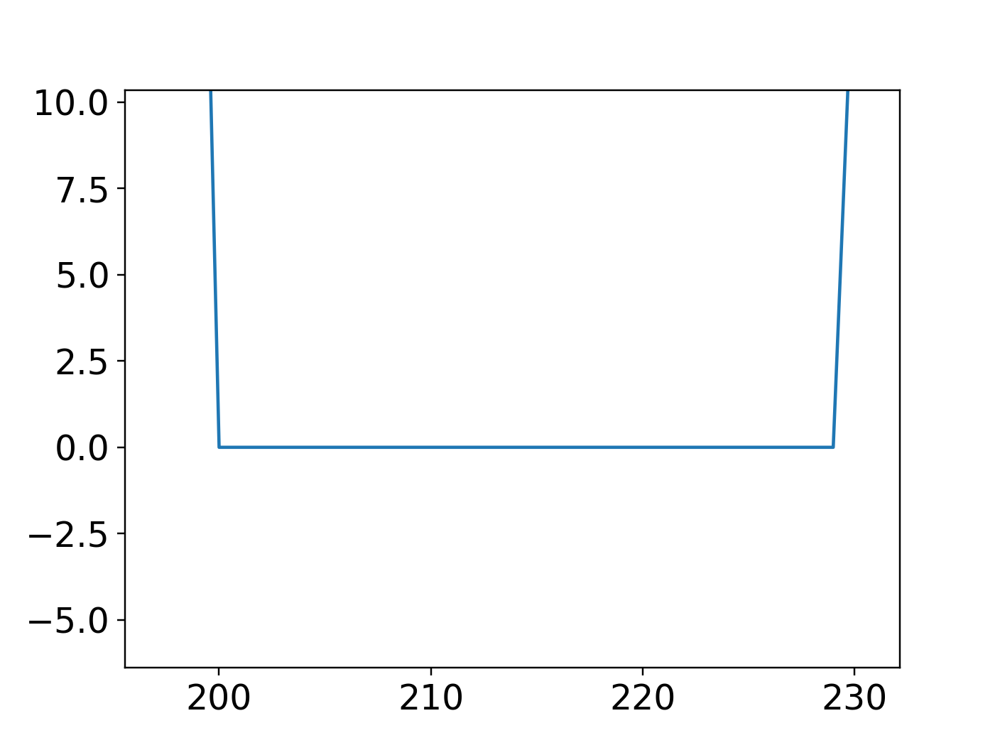

In [369]:
bar_passes = prf_stim.design_matrix.sum((0,1))
fig=pl.figure()
pl.imshow(prf_stim.design_matrix[:,:,13])
fig=pl.figure()
pl.plot(bar_passes)

(2, 27)


<IPython.core.display.Javascript object>


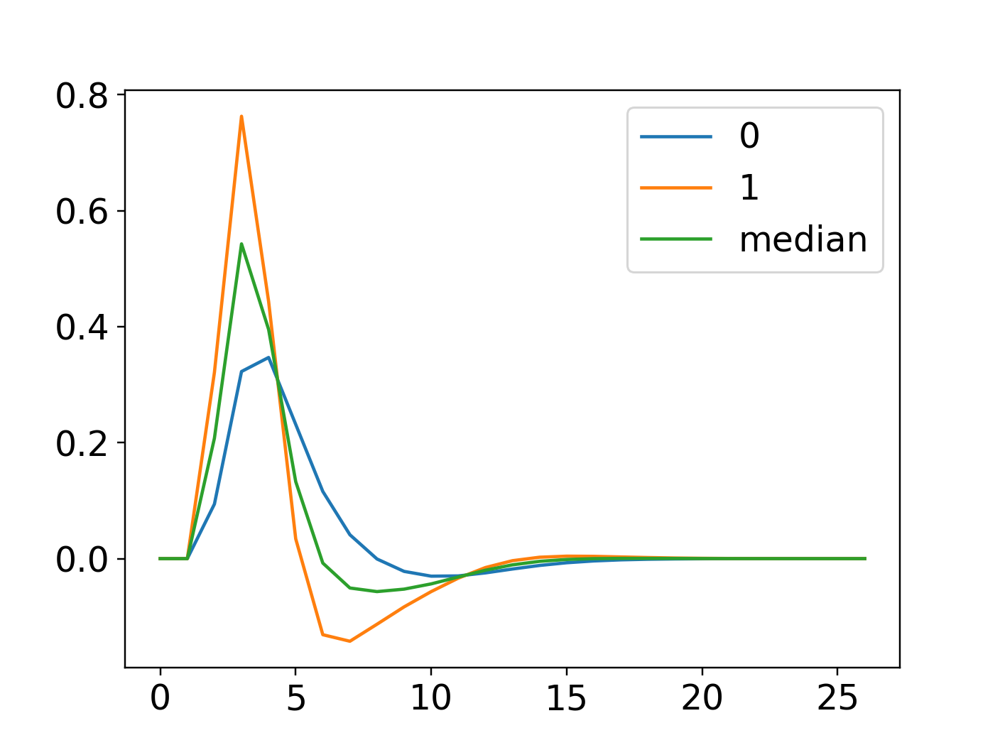

11.477048509899728
5.3548203719686995


In [569]:
current_hrf = gg_norm.create_hrf([[1.0,1.0],[1.0,4.6],[0,0]])
print(current_hrf.shape)
neural_tc = np.ones((1,100))
#neural_tc[1]=1
#neural_tc[2]=2
pl.figure()

for i in range(current_hrf.shape[0]):
    pl.plot(current_hrf[i].T, label=f"{i}")
    print(current_hrf[i].max()/np.abs(current_hrf[i].min()))
pl.plot(np.median(current_hrf, axis=0).T, label='median')
pl.legend()

<IPython.core.display.Javascript object>


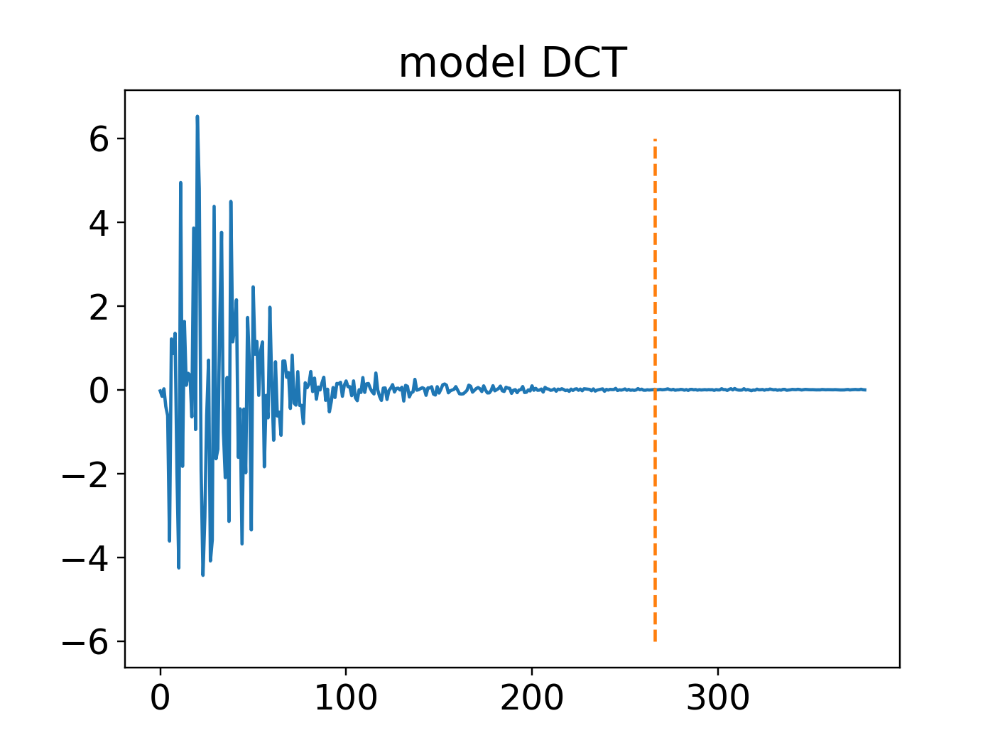

<IPython.core.display.Javascript object>


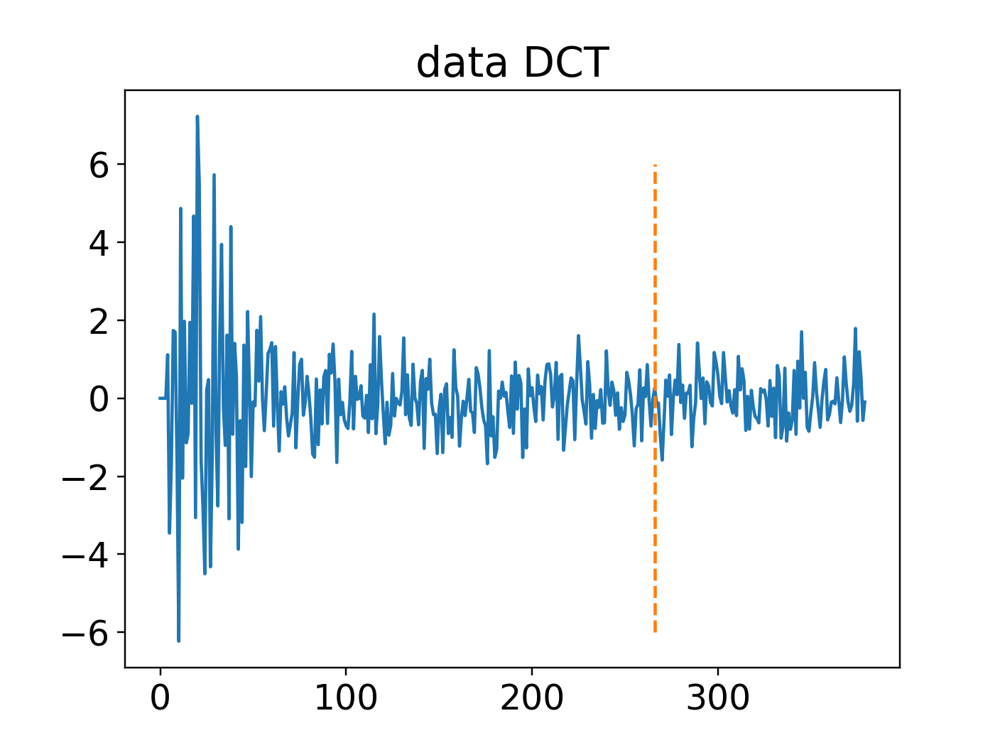

In [468]:
pl.figure()
pl.title('model DCT')
pl.plot(sp.fftpack.dct(gg_norm.return_prediction(*list(subj_res['Results']['Norm'][v_num,:-1].T))[0], norm='ortho', axis=-1)[1:])
pl.plot((380-114)*np.ones(13), np.arange(-6,7), linestyle='--')

pl.figure()
pl.title('data DCT')
pl.plot(sp.fftpack.dct(timecourse[v_num], norm='ortho', axis=-1)[1:])
pl.plot((380-114)*np.ones(13), np.arange(-6,7), linestyle='--')

In [1130]:
current_nc = 1-np.sum((timecourse-timecourse_test)**2, axis=-1)/(timecourse_test.var(-1)*timecourse_test.shape[-1])

print(np.median(current_nc[current_nc>0.0]))

tc_filt = sgfilter_predictions(timecourse,
                                                     window_length=139,
                                                     polyorder=1,
                                                     highpass=True,
                                                     add_mean=True)


tc_filt *= (100/tc_filt.mean(-1)[...,np.newaxis])

#tc_filt *= (100/np.median(tc_filt[...,prf_stim.late_iso_dict['1S']])[np.newaxis,...])
#tc_filt = sp.stats.zscore(tc_filt, axis=-1)
tc_filt += (100-np.median(tc_filt[...,prf_stim.late_iso_dict['1S']], axis=-1))[...,np.newaxis]

tc_test_filt = sgfilter_predictions(timecourse_test,
                                                     window_length=139,
                                                     polyorder=1,
                                                     highpass=True,
                                                     add_mean=True)

tc_test_filt *= (100/tc_test_filt.mean(-1)[...,np.newaxis])

#tc_test_filt = sp.stats.zscore(tc_test_filt,axis=-1)
tc_test_filt += (100-np.median(tc_test_filt[...,prf_stim.late_iso_dict['1S']], axis=-1))[...,np.newaxis]

nc_filt = 1-np.sum((tc_filt-tc_test_filt)**2, axis=-1)/(tc_test_filt.var(-1)*tc_test_filt.shape[-1])

print(np.median(nc_filt[current_nc>0.0]))


0.31834036
0.42667404


In [1231]:
current_nc = 1-np.sum((timecourse-timecourse_test)**2, axis=-1)/(timecourse_test.var(-1)*timecourse_test.shape[-1])

print(np.median(current_nc[current_nc>0.0]))
print(np.sum(current_nc>0.0))

for modes in [5]:
    print(modes)
    for modes_last in [250]:#np.arange(300,380,5):
        print(modes_last)
        trans = sp.fftpack.dct(timecourse, norm='ortho', axis=-1)
        trans[:, :modes] = 0
        trans[:, -modes_last:] = 0

        tc_filt = sp.fftpack.idct(trans, norm='ortho', axis=-1)

        tc_filt += timecourse.mean(-1)[...,np.newaxis]

        tc_filt *= (100/tc_filt.mean(-1))[...,np.newaxis]

        #tc_filt = sp.stats.zscore(tc_filt, axis=-1)
        #tc_filt += (100-np.median(tc_filt[...,prf_stim.late_iso_dict['1S']], axis=-1))[...,np.newaxis]

        trans_test = sp.fftpack.dct(timecourse_test, norm='ortho', axis=-1)
        trans_test[:, :modes] = 0
        trans_test[:, -modes_last:] = 0

        tc_test_filt = sp.fftpack.idct(trans_test, norm='ortho', axis=-1)

        tc_test_filt += timecourse_test.mean(-1)[...,np.newaxis]
        tc_test_filt *= (100/tc_test_filt.mean(-1))[...,np.newaxis]

        #tc_test_filt = sp.stats.zscore(tc_test_filt,axis=-1)
        #tc_test_filt += (100-np.median(tc_test_filt[...,prf_stim.late_iso_dict['1S']], axis=-1))[...,np.newaxis]

        nc_filt = 1-np.sum((tc_filt-tc_test_filt)**2, axis=-1)/(tc_test_filt.var(-1)*tc_test_filt.shape[-1])

        print(np.median(nc_filt[current_nc>0.0]))
        print(np.sum(nc_filt>0.0))


0.31834036
7488
5
250
0.6927979
16392


In [1149]:
prf_stim.late_iso_dict['1S'] = np.array([0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10, 375, 376, 377, 378, 379, 380])

In [1154]:
np.mean(tc_filt[...,prf_stim.late_iso_dict['1S']], axis=-1)

array([100.000015, 100.      ,  99.999985, ...,  99.999985, 100.000015,
        99.99998 ], dtype=float32)

In [721]:
gf_norm.iterative_search_params = subj_res['Results']['Norm']
gf_norm.rsq_mask = subj_res['Results']['Norm'][:,-1]>0.0
gf_norm.crossvalidate_fit(timecourse_test)

In [729]:
np.median(timecourse[v_num, late_iso_dict['1S']])

100.0

<IPython.core.display.Javascript object>


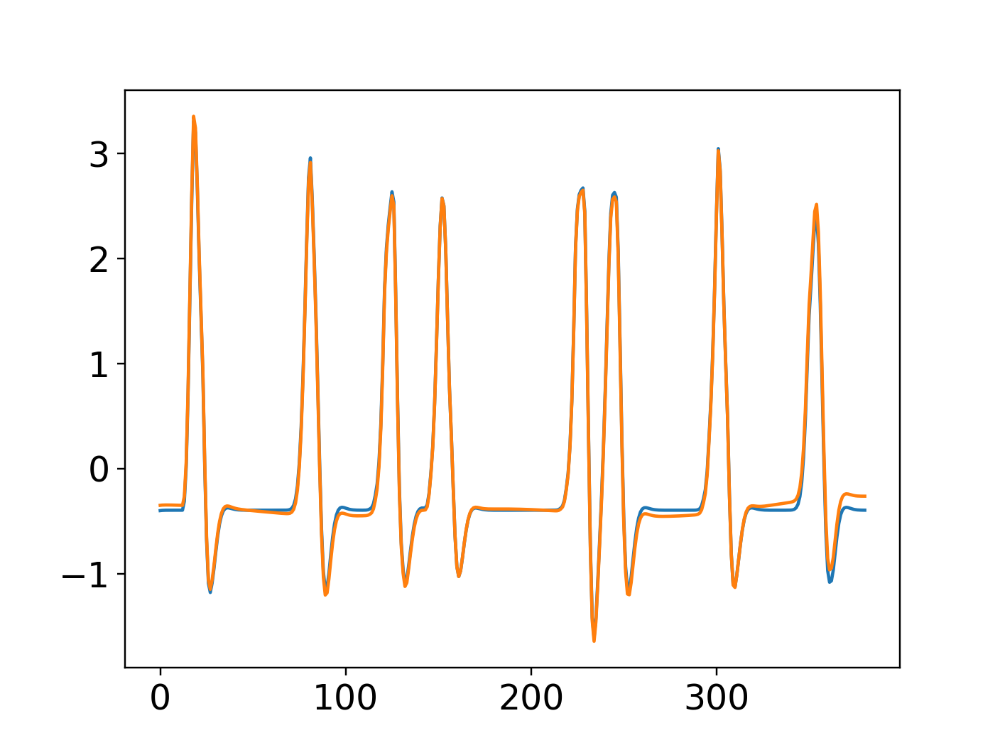

In [1020]:
trans = sp.fftpack.dct(gg_norm.return_prediction(*list(subj_res['Results']['Norm'][v_num,:-1].T))[0], norm='ortho')
pl.figure()
pl.plot(sp.stats.zscore(gg_norm.return_prediction(*list(subj_res['Results']['Norm'][v_num,:-1].T))[0]))
trans[:5]=0
pl.plot(sp.stats.zscore(sp.fftpack.idct(trans, norm='ortho')))

In [694]:
gg_norm.polyorder=1
gg_norm.window_length='adaptive'
gg_norm.add_mean=True
gg_norm.filter_predictions=True
gg_norm.highpass=True

In [573]:
norm_tc_fft=gg_norm.return_prediction(*list(np.array([[0,0,1,0.8,100,0.1,3,1,2],
                                                      [0,0,1,0.8,100,0.1,3,1,2]]).T))+0.5*np.random.rand(norm_tc_fft.shape[0], norm_tc_fft.shape[1])

norm_tc_ndi=gg_norm.return_prediction(*list(gf_norm.iterative_search_params[:,:-1].T))
print(gf_norm.iterative_search_params)

KeyboardInterrupt: 

In [496]:
gf_norm = Norm_Iso2DGaussianFitter(data=timecourse,
                                       model=gg_norm,
                                       n_jobs=1)

In [546]:
gf_norm.iterative_search_params=np.array([[0,0,1,0.8,100,0.1,3.0,1,2,2,0,1],
                                                      [0,0,1,0.8,100,0.1,3.0,1,2,2,0,1]])

gf_norm.iterative_search_params=np.ones((tc_full_iso_nonzerovar_dict['tc'].shape[0],10))
gf_norm.rsq_mask=np.ones(tc_full_iso_nonzerovar_dict['tc'].shape[0]).astype('bool')
gf_norm.crossvalidate_fit(tc_full_iso_nonzerovar_dict['tc_test'])#norm_tc_fft+0.5*np.random.rand(norm_tc_fft.shape[0], norm_tc_fft.shape[1]))

Error occurred during predictions savgol filtering.                  Using unfiltered prediction instead


In [838]:
gf_norm.crossvalidate_fit(timecourse_test)

0.043622790158751576

In [535]:
gf_norm.iterative_search_params

array([[  0.        ,   0.        ,   1.        ,   0.8       ,
        100.        ,   0.1       ,   3.        ,   1.        ,
          2.        ,   2.        ,   0.        ,   0.55912334],
       [  0.        ,   0.        ,   1.        ,   0.8       ,
        100.        ,   0.1       ,   3.        ,   1.        ,
          2.        ,   2.        ,   0.        ,   0.497631  ]])

0.9979048968921437


<IPython.core.display.Javascript object>


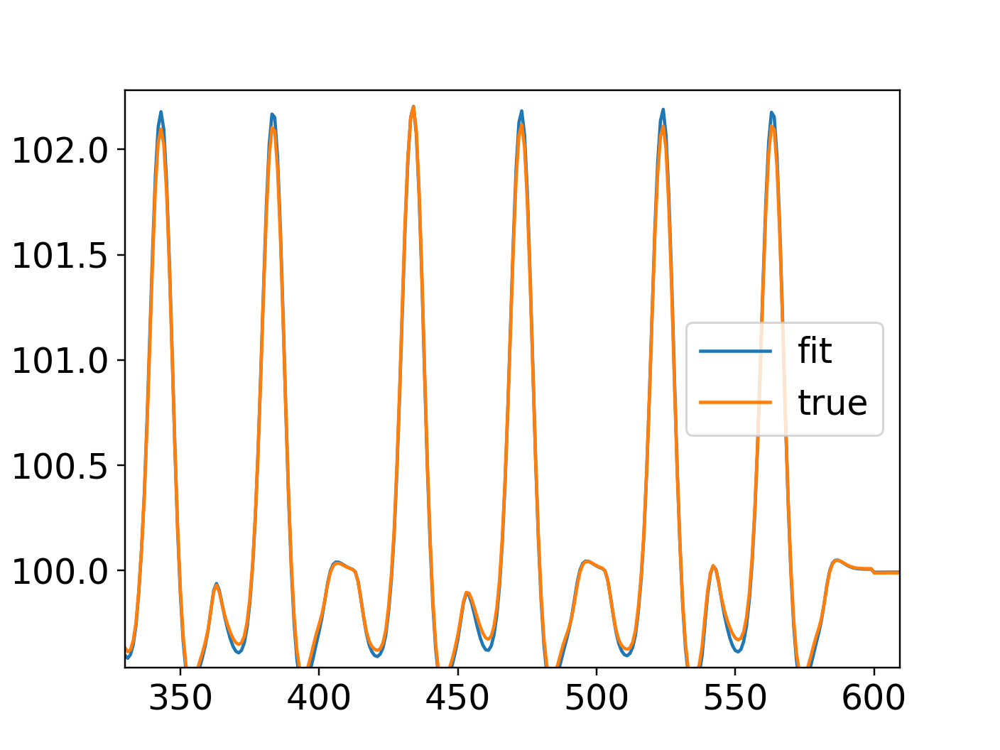

In [411]:
print(1-((norm_tc_ndi[0]-norm_tc_fft[0])**2).sum()/(len(norm_tc_fft[0])*norm_tc_fft[0].var()))
pl.figure()

pl.plot(norm_tc_ndi[0],label='fit')
pl.plot(norm_tc_fft[0],label='true')

pl.legend()

In [431]:
late_iso_dict = prf_stim.late_iso_dict

task_lengths = prf_stim.task_lengths
print(np.any(np.median(tc_full_iso_nonzerovar_dict['tc_test'][:,late_iso_dict['1S']], axis=-1) != 100 ))

False


In [436]:
np.corrcoef(tc_full_iso_nonzerovar_dict['tc_test'][0:2],tc_full_iso_nonzerovar_dict['tc'][0:2])

array([[ 1.        ,  0.27455435,  0.00772459,  0.01178409],
       [ 0.27455435,  1.        , -0.00728552, -0.00978152],
       [ 0.00772459, -0.00728552,  1.        ,  0.24647118],
       [ 0.01178409, -0.00978152,  0.24647118,  1.        ]])

In [365]:
#print(np.max(norm_tc_fft[0]))
print(norm_tc_fft[0][late_iso_dict['1R']].mean())
print(norm_tc_fft[0][task_lengths[0]+late_iso_dict['1S']].mean())
print(norm_tc_fft[0][np.sum(task_lengths[:2])+late_iso_dict['2R']].mean())
print(norm_tc_fft[0][np.sum(task_lengths[:3])+late_iso_dict['4F']].mean())
print(norm_tc_fft[0][np.sum(task_lengths[:4])+late_iso_dict['4R']].mean())

99.28377
99.30392
99.81529
99.64278
99.63825


<IPython.core.display.Javascript object>


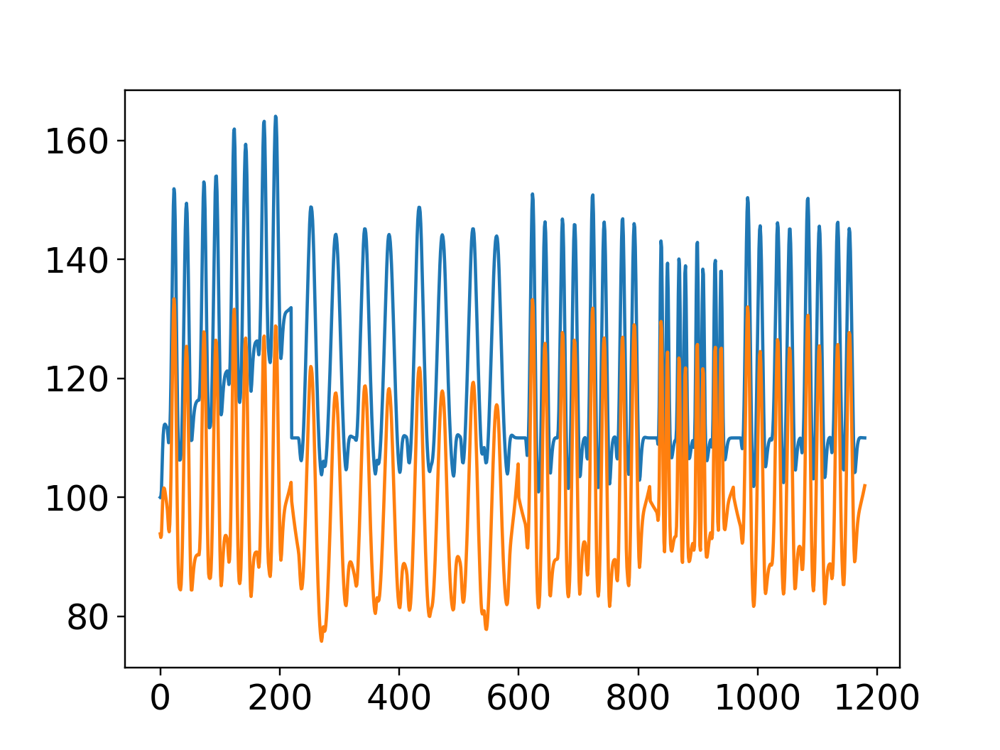

In [840]:
norm_tc_ndi[0][:220] += 0.1*np.arange(220)
pl.figure()
pl.plot(norm_tc_ndi[0])
norm_tc_fft = 100+sgfilter_predictions(norm_tc_ndi, window_length=139, polyorder=3,
                         highpass=True, add_mean=True, task_lengths=task_lengths,
                         task_names=task_names, late_iso_dict=late_iso_dict)
pl.plot(norm_tc_fft[0])

In [124]:
timecourse = np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/smaller_bounds/sub-006_timecourse_space-fsnative.npy')


In [13]:

tc_vox = timecourse[12,:]

In [ ]:
%matplotlib notebook
rsq_thresh=0.7

roi = 'visual_system'
#alpha_roi = roi_mask(idx_rois[roi],alpha)>rsq_thresh

alpha_roi = alpha>rsq_thresh#roi_mask(idx_rois[roi],alpha)>rsq_thresh

#create timecourses
vox_num=np.argmin((rsq[:,3]-rsq[:,1])*alpha_roi)#50370



vox_num = np.sum(nonzerovar_mask[:vox_num])
tc_vox=timecourse[vox_num] - 100




#norm_grid_tc=gg_norm.return_prediction(*list(norm_grid[vox_num,:-1]))
norm_tc=gg_norm.return_prediction(*list(norm_res[vox_num,:-1]))  - 100
gauss_tc=gg.return_prediction(*list(gauss[vox_num,:-1])) - 100
css_tc=gg_css.return_prediction(*list(css_res[vox_num,:-1])) - 100
dog_tc=gg_dog.return_prediction(*list(dog_res[vox_num,:-1])) - 100
norm_updated=gg_norm.return_prediction(*list(gf_norm.iterative_search_params[0,:-1])) - 100
css_updated=gg_css.return_prediction(*list(gf_css.iterative_search_params[0,:-1])) - 100

times=np.arange(len(tc_vox))*1.5

fig=pl.figure(figsize=(4, 9))
pl.plot(times[:task_lengths[0]], tc_vox[:task_lengths[0]], label='Data (Cond. a)', marker='s', markersize=4, color='black', linestyle='-') 
pl.plot(times[task_lengths[0]:np.sum(task_lengths[:2])], tc_vox[task_lengths[0]:np.sum(task_lengths[:2])], label='Cond. b', marker='o', markersize=4, color='black', linestyle='-') 
pl.plot(times[np.sum(task_lengths[:2]):np.sum(task_lengths[:3])], tc_vox[np.sum(task_lengths[:2]):np.sum(task_lengths[:3])], label='Cond. c', marker='^', markersize=4, color='black', linestyle='-') 
pl.plot(times[np.sum(task_lengths[:3]):np.sum(task_lengths[:4])], tc_vox[np.sum(task_lengths[:3]):np.sum(task_lengths[:4])], label='Cond. d', marker='v', markersize=4, color='black', linestyle='-') 
pl.plot(times[np.sum(task_lengths[:4]):np.sum(task_lengths[:5])], tc_vox[np.sum(task_lengths[:4]):np.sum(task_lengths[:5])], label='Cond. e', marker='D', markersize=4, color='black', linestyle='-') 

pl.plot(times, gauss_tc, color='blue',linewidth=2)#,label='Gauss')
pl.plot(times, css_tc, color='orange',linewidth=2)#,label='CSS')
pl.plot(times, dog_tc, color='green',linewidth=2)#,label='DoG')
pl.plot(times, norm_tc, color='red',linewidth=2)#, label='Norm')


pl.plot(norm_updated,label='new norm')
pl.plot(css_updated,label='new css')
pl.legend(loc=1)


pl.xlabel('Time (s)')
#pl.ylabel('BOLD signal change (%)')

#pl.xlim(42,82)
#pl.xlim(350,390)
#pl.xlim(905,945)
#pl.xlim(1226.5,1266.5)
#pl.xlim(1663,1703)
#pl.ylim(-3,6)

np.set_printoptions(suppress=True)

print("gauss rsq: "+str(1-np.sum((tc_vox-gauss_tc)**2)/(timecourse.shape[-1]*np.var(tc_vox))))
print("css rsq: "+str(1-np.sum((tc_vox-css_tc)**2)/(timecourse.shape[-1]*np.var(tc_vox))))
print("dog rsq: "+str(1-np.sum((tc_vox-dog_tc)**2)/(timecourse.shape[-1]*np.var(tc_vox))))
print("norm rsq: "+str(1-np.sum((tc_vox-norm_tc)**2)/(timecourse.shape[-1]*np.var(tc_vox))))
print("new norm rsq: "+str(1-np.sum((tc_vox-norm_updated)**2)/(timecourse.shape[-1]*np.var(tc_vox))))

print("new css rsq: "+str(1-np.sum((tc_vox-css_updated)**2)/(timecourse.shape[-1]*np.var(tc_vox))))


print("gauss params")
print(gauss[vox_num])
print("css params")
print(css_res[vox_num])
print("dog params")
print(dog_res[vox_num])
print("norm params")
print(norm_res[vox_num])

#print("new norm params")
#print(gf_norm.iterative_search_params[0])

#norm_res[vox_num] = gf_norm.iterative_search_params[0]

#pl.savefig('/Users/marcoaqil/PRFMapping/Figures/'+subj+'_1S_tc.png', dpi=200, bbox_inches='tight')

In [653]:
print(tc_vox[late_iso_dict['1R']].mean())
print(tc_vox[task_lengths[0]+late_iso_dict['1S']].mean())
print(tc_vox[np.sum(task_lengths[:2])+late_iso_dict['2R']].mean())
print(tc_vox[np.sum(task_lengths[:3])+late_iso_dict['4F']].mean())
print(tc_vox[np.sum(task_lengths[:4])+late_iso_dict['4R']].mean())

80890.47
80890.46
80890.45
80890.45
80890.45


In [486]:
from scipy.optimize import LinearConstraint, NonlinearConstraint

inf = 1e6
eps = 1e-1
ss = prf_stim.screen_size_degrees


gf_norm = Norm_Iso2DGaussianFitter(data=norm_tc_fft,
                                       model=gg_norm,
                                       n_jobs=1)
# gf_css = CSS_Iso2DGaussianFitter(data=tc_vox.reshape(-1,tc_vox.shape[-1]),
#                                        model=gg_css,
#                                        n_jobs=1)


constraints_dog = []
constraints_norm = []

In [134]:
#enforcing surround size larger than prf size
A_ssc_dog = np.array([[0,0,-1,0,0,0,1]])
A_ssc_norm = np.array([[0,0,-1,0,0,0,1,0,0]])

constraints_dog.append(LinearConstraint(A_ssc_dog,
                                                lb=0,
                                                ub=+inf))

constraints_norm.append(LinearConstraint(A_ssc_norm,
                                                lb=0,
                                                ub=+inf))

if pos_prfs_only:
        #enforcing positive central amplitude
    def positive_centre_prf_dog(x):
        if normalize_RFs:
            return x[3]/(2*np.pi*x[2]**2)-x[5]/(2*np.pi*x[6]**2)
        else:
            return x[3] - x[5]

    def positive_centre_prf_norm(x):
        if normalize_RFs:
            return (x[3]/(2*np.pi*x[2]**2)+x[7])/(x[5]/(2*np.pi*x[6]**2)+x[8]) - x[7]/x[8]
        else:
            return (x[3]+x[7])/(x[5]+x[8]) - x[7]/x[8]

    constraints_dog.append(NonlinearConstraint(positive_centre_prf_dog,
                                                lb=0,
                                                ub=+inf))
    constraints_norm.append(NonlinearConstraint(positive_centre_prf_norm,
                                            lb=0,
                                            ub=+inf))

In [327]:
start = np.ones((1,10))#np.copy(norm_res[vox_num].reshape(-1,10))
#start = np.insert(start, -1, 1.0, axis=-1)
#start = np.insert(start, -1, 0.0, axis=-1)
#start[0,4] = 60000
#start[0,8] = 1
#start[0,7] = 0
#print(gf_norm.rsq_mask.shape)
gf_norm.iterative_fit(rsq_threshold=0.0, verbose=True,
                              starting_params=start,#norm_grid[vox_num].reshape(-1,norm_grid[vox_num].shape[-1]),
                                      bounds=[(-2*ss, 2*ss),  # x
                                               (-2*ss, 2*ss),  # y
                                               (1e-2, 2*ss),  # prf size
                                               (0, inf),  # prf amplitude
                                               (100, 100),  # bold baseline
                                               (1, 1),  # surround amplitude
                                               (1e-2, 4*ss),  # surround size
                                               (0, inf),  # neural baseline
                                               (1, 1)],#, # surround baseline
                                             #(0,10),
                                             #(0,10)],  
                                       fit_hrf=False,
                                         constraints=[],
                     xtol=1e-10,
                     ftol=1e-10)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Performing bounded, constrained minimization (trust-constr).


/Users/marcoaqil/anaconda3/envs/prfpy_intel_env/lib/python3.6/site-packages/scipy/optimize/_hessian_update_strategy.py:187: UserWarning: delta_grad == 0.0. Check if the approximated function is linear. If the function is linear better results can be obtained by defining the Hessian as zero instead of using quasi-Newton approximations.
  'approximations.', UserWarning)
/Users/marcoaqil/anaconda3/envs/prfpy_intel_env/lib/python3.6/site-packages/scipy/optimize/_hessian_update_strategy.py:187: UserWarning: delta_grad == 0.0. Check if the approximated function is linear. If the function is linear better results can be obtained by defining the Hessian as zero instead of using quasi-Newton approximations.
  'approximations.', UserWarning)
/Users/marcoaqil/anaconda3/envs/prfpy_intel_env/lib/python3.6/site-packages/scipy/optimize/_hessian_update_strategy.py:187: UserWarning: delta_grad == 0.0. Check if the approximated function is linear. If the function is linear better results can be obtained

/Users/marcoaqil/anaconda3/envs/prfpy_intel_env/lib/python3.6/site-packages/scipy/optimize/_hessian_update_strategy.py:187: UserWarning: delta_grad == 0.0. Check if the approximated function is linear. If the function is linear better results can be obtained by defining the Hessian as zero instead of using quasi-Newton approximations.
  'approximations.', UserWarning)
/Users/marcoaqil/anaconda3/envs/prfpy_intel_env/lib/python3.6/site-packages/scipy/optimize/_hessian_update_strategy.py:187: UserWarning: delta_grad == 0.0. Check if the approximated function is linear. If the function is linear better results can be obtained by defining the Hessian as zero instead of using quasi-Newton approximations.
  'approximations.', UserWarning)


`xtol` termination condition is satisfied.
Number of iterations: 434, function evaluations: 4950, CG iterations: 1807, optimality: 1.15e-05, constraint violation: 0.00e+00, execution time: 5.5e+01 s.


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   54.8s finished


In [329]:
np.set_printoptions(suppress=True)
print(gf_norm.iterative_search_params)

[[ -0.00113465   0.00682906   0.89537049   5.03997013 100.
    1.           1.78311059   0.41833873   1.           0.99801984]]


In [406]:
np.set_printoptions(suppress=True)
#gf_norm.iterative_search_params[0,-2]=1
#gf_norm.iterative_search_params[0,-4]=6
#gf_norm.iterative_search_params[0,-5]=3

#gf_norm.iterative_search_params[0,3]=6000
#gf_norm.iterative_search_params[0,4]=80000
print(gf_norm.iterative_search_params[0])
print(norm_res[vox_num])
#print(gf_norm.iterative_search_params[0] - norm_res[vox_num])
print(norm_grid[vox_num])

[  1.61262881  -3.27140535   1.3109588   30.25251258  97.36434091
   3.37460018   1.43215614 101.72094163  92.30392389   0.70895484]
[  1.6126288   -3.27140605   1.31095913  30.25247063  97.36434061
   3.37459472   1.43215644 101.72093309  92.30388769   0.70895484]
[  1.57078693  -3.23347827   1.5173385   15.84158134  98.51573944
   1.           3.           0.         100.           0.69985837]


In [399]:
start = np.copy(css_res[vox_num].reshape(-1,7))
start = np.insert(start, -1, 1.0, axis=-1)
start = np.insert(start, -1, 0.0, axis=-1)

gf_css.iterative_fit(rsq_threshold=0, verbose=True,
                              starting_params=gf_css.iterative_search_params,
                             bounds=[(-2*ss, 2*ss),  # x
                                     (-2*ss, 2*ss),  # y
                                     (eps, 2*ss),  # prf size
                                     (-inf, +inf),  # prf amplitude
                                     (0, +inf),  # bold baseline
                                     (0.001, 3),
                                             (0,10),
                                             (0,10)],  # CSS exponent
                                       gradient_method='no',
                                       fit_hrf=True)

Using no-gradient minimization


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


`xtol` termination condition is satisfied.
Number of iterations: 208, function evaluations: 1854, CG iterations: 1089, optimality: 3.60e-04, constraint violation: 0.00e+00, execution time: 2e+01 s.


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   19.8s finished


In [400]:
np.set_printoptions(suppress=True)
print(gf_css.iterative_search_params[0])

[ 1.55949306 -3.33135418  0.73937069  2.54859146 98.45336773  0.19237379
  2.95818123  0.00000049  0.78626246]


In [37]:
anp = norm_res[:10,:-1]#gf_norm.iterative_search_params[0]
agp = gauss[:10,:-1]
acp = css_res[:10,:-1]#gf_css.iterative_search_params[0]
adp = dog_res[:10,:-1]


x=np.linspace(-20,20,1000)
gauss_profile = agp[...,3] * np.exp(-0.5*x[...,np.newaxis]**2 / agp[...,2]**2)

half_max = np.max(gauss_profile, axis=0)/2

css_profile = (acp[3] * (np.exp(-0.5*x**2 / acp[2]**2))**acp[5])
dog_profile = adp[3] * np.exp(-0.5*x**2 / adp[2]**2) - adp[5] * np.exp(-0.5*x**2 / adp[6]**2)
norm_profile = (anp[3] * np.exp(-0.5*x**2 / anp[2]**2) + anp[7]) / (anp[5] * np.exp(-0.5*x**2 / anp[6]**2) + anp[8])
pl.figure()
pl.plot(x,norm_profile,label='norm')
pl.plot(x,css_profile,label='css')
pl.plot(x,dog_profile,label='dog')
pl.plot(x,gauss_profile,label='gauss')
pl.legend()

ValueError: operands could not be broadcast together with shapes (1000,) (6,) 

In [42]:
print(half_max.shape)
x[np.argmin(np.abs(half_max-gauss_profile), axis=0)]

(10,)


array([-0.42042042, -0.5005005 , -0.54054054, -0.54054054, -0.54054054,
       -0.38038038, -0.54054054, -0.62062062, -0.38038038, -0.66066066])

In [43]:
agp

array([[2.39757873e+00, 2.60430189e-01, 3.50643828e-01, 1.13346322e+02,
        6.86608990e+04],
       [2.54802888e+00, 3.85879235e-01, 4.30552282e-01, 9.51115676e+01,
        6.96927229e+04],
       [2.58749607e+00, 4.17583105e-01, 4.51059228e-01, 9.68074753e+01,
        7.06364901e+04],
       [2.73111188e+00, 4.66150961e-01, 4.50371759e-01, 1.15703847e+02,
        6.45847187e+04],
       [2.61016573e+00, 6.21102360e-01, 4.65716762e-01, 8.71259269e+01,
        5.91878856e+04],
       [2.37924514e+00, 2.76602634e-01, 3.17047987e-01, 1.27025499e+02,
        6.82756637e+04],
       [2.47908634e+00, 3.93369349e-01, 4.68963855e-01, 6.84625191e+01,
        6.70114840e+04],
       [2.41922278e+00, 4.57514285e-01, 5.26847349e-01, 4.73289070e+01,
        6.53476156e+04],
       [2.41741948e+00, 4.29122585e-01, 3.24784667e-01, 1.23262778e+02,
        6.46082178e+04],
       [2.59173473e+00, 6.57237544e-01, 5.50875479e-01, 6.17278592e+01,
        6.71865053e+04]])

(10,)


<IPython.core.display.Javascript object>


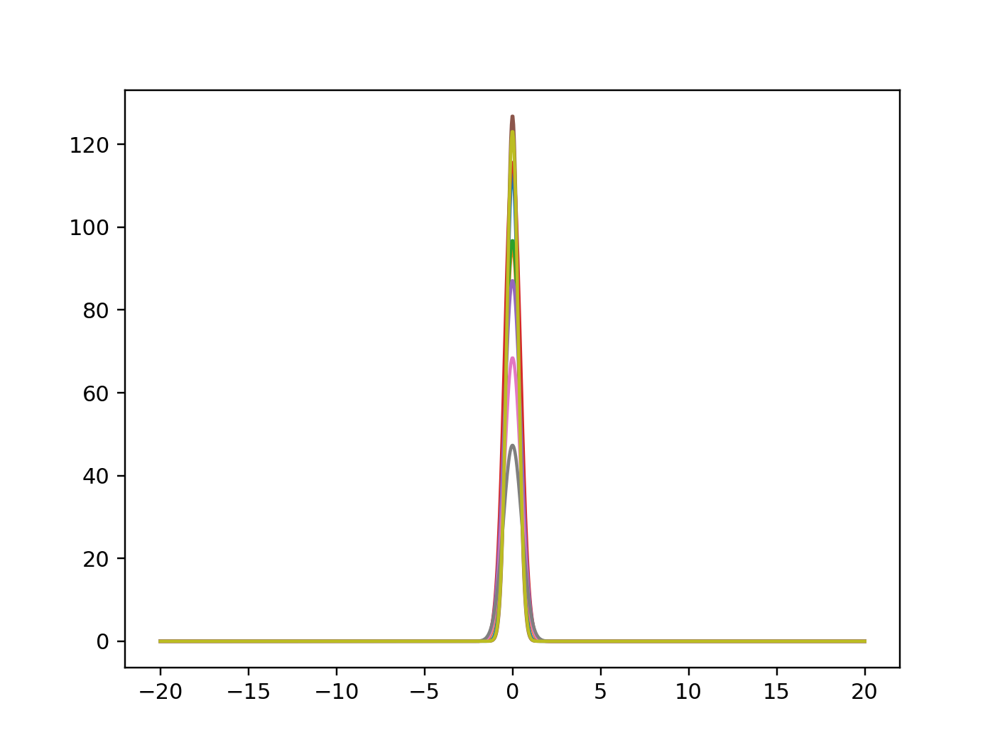

In [38]:
pl.figure()
for i in range(9):
    pl.plot(x,gauss_profile[:,i],label='gauss')

In [ ]:
#code to make/save colormaps

pl.figure()

cmap = mpimg.imread('/Users/marcoaqil/pycortex/filestore/colormaps/Retinotopy_HSV_2x_alpha.png') 
pl.imshow(np.swapaxes(np.fliplr(cmap),0,1))
pl.ylim((62,193))
pl.xlim((0,3))
pl.gca().axes.get_xaxis().set_visible(False)
pl.gca().set_yticks(np.linspace(62,193,5))
pl.gca().set_yticklabels(('$-\pi/2$','$-3\pi/4$','$\pi$','$3\pi/4$','$\pi/2$'))
pl.savefig('/Users/marcoaqil/PRFMapping/Figures/polr_cmap.png', dpi=200, bbox_inches='tight', transparent=True)

pl.figure()

cmap = mpimg.imread('/Users/marcoaqil/pycortex/filestore/colormaps/Jet_2D_alpha.png') 
pl.imshow(np.swapaxes(np.fliplr(cmap),0,1))
pl.xlim((0,5))
pl.gca().axes.get_xaxis().set_visible(False)
pl.gca().set_yticks([255,3*255/3.75,2*255/3.75,1*255/3.75,0])
pl.gca().set_yticklabels(('$0.25\degree$', '$1\degree$', '$2\degree$','$3\degree$','$4\degree$'))
pl.savefig('/Users/marcoaqil/PRFMapping/Figures/ecc_cmap.png', dpi=200, bbox_inches='tight', transparent=True)

pl.figure()

cmap = mpimg.imread('/Users/marcoaqil/pycortex/filestore/colormaps/Jet_2D_alpha.png') 
pl.imshow(np.swapaxes(np.fliplr(cmap),0,1))
pl.xlim((0,5))
pl.gca().axes.get_xaxis().set_visible(False)
pl.gca().set_yticks(np.linspace(255,0,5))
pl.gca().set_yticklabels(np.linspace(0,200,5).astype('int'))
pl.savefig('/Users/marcoaqil/PRFMapping/Figures/Bparam_cmap.png', dpi=200, bbox_inches='tight', transparent=True)

<IPython.core.display.Javascript object>


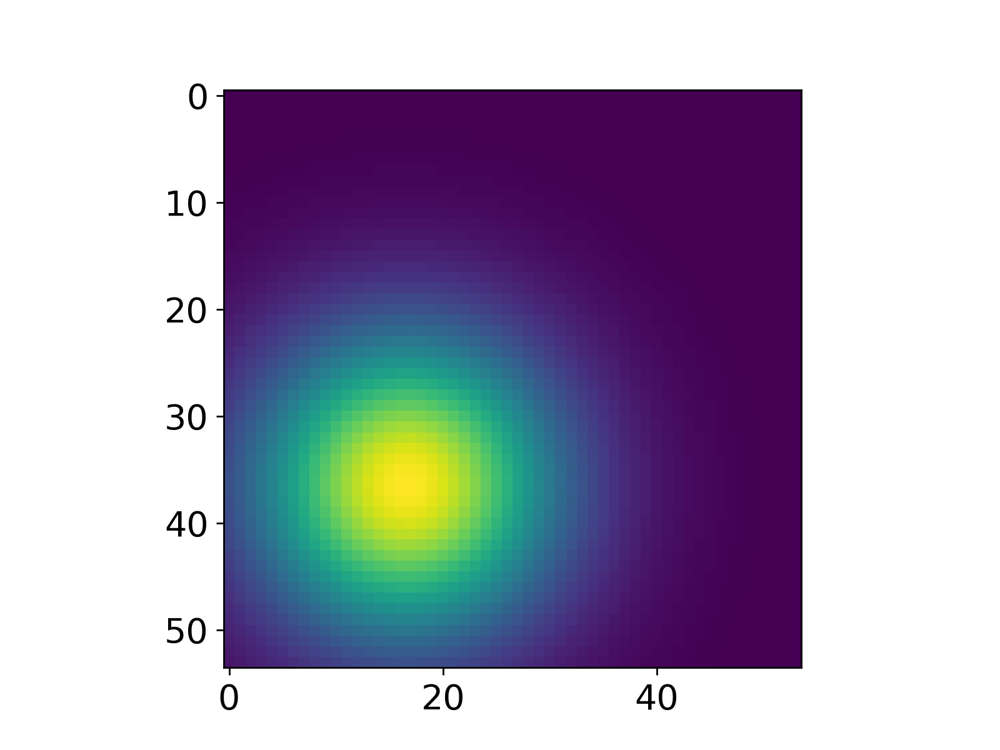

In [202]:
from prfpy.rf import gauss2D_iso_cart
from prfpy.timecourse import stimulus_through_prf
#dm = gg.stimulus.design_matrix

rf = np.rot90(gauss2D_iso_cart(x=gg.stimulus.x_coordinates[..., np.newaxis],
                              y=gg.stimulus.y_coordinates[..., np.newaxis],
                              mu=(-2, -2),
                              sigma=2,
                              normalize_RFs=False).T, axes=(1,2))
#neural_tc = stimulus_through_prf(rf, dm)
#pl.figure()
pl.figure()
pl.imshow(rf[0])

In [205]:
###############outdated cells

71.42857142857143

In [96]:
#correcting for low intensity TCs (lowest xx percentile per ROI) (unused)
tc_mean_full = np.zeros(nonzerovar_mask.shape)
tc_mean = timecourse.mean(-1)
tc_mean_full[nonzerovar_mask]=tc_mean

for roi in idx_rois:
    k_values = int(len(idx_rois[roi])/20)
    lowest_intensity = np.argpartition(tc_mean_full[idx_rois[roi]][tc_mean_full[idx_rois[roi]]>0], k_values)
    alpha[idx_rois[roi][tc_mean_full[idx_rois[roi]]>0][lowest_intensity[:k_values]]] = 0
    
    tc_mean_full[idx_rois[roi][tc_mean_full[idx_rois[roi]]>0][lowest_intensity[:k_values]]] = 0

#plotting histograms of mean signal intensity per ROI, after removing lowest intensity
for roi in idx_rois:
    pl.figure()
    pl.title(roi)
    pl.hist(tc_mean_full[idx_rois[roi]],bins=100)
    pl.show()
    #pl.close()

In [2]:
#load data fsaverage sub 001

gauss = np.load("/Users/marcoaqil/PRFMapping/Cartesius results/sub-001_iterparams-gauss_space-fsaverage.npy")
norm_grid = np.load("/Users/marcoaqil/PRFMapping/Cartesius results/sub-001_gridparams-norm_space-fsaverage.npy") 
norm_an = np.load("/Users/marcoaqil/PRFMapping/Cartesius results/sub-001_iterparams-norm_space-fsaverage_analytic.npy")
#norm_num = np.load("/Users/marcoaqil/PRFMapping/Cartesius results/sub-001_iterparams-norm_space-fsaverage_numerical.npy")
dog_res= np.load("/Users/marcoaqil/PRFMapping/Cartesius results/sub-001_iterparams-dog_space-fsaverage.npy")
css_res= np.load("/Users/marcoaqil/PRFMapping/Cartesius results/sub-001_iterparams-css_space-fsaverage.npy")
norm_unbound = np.load("/Users/marcoaqil/PRFMapping/Cartesius results/sub-001_iterparams-norm_space-fsaverage_unbounded.npy")
norm_combined=np.load("/Users/marcoaqil/PRFMapping/Cartesius results/sub-001_norm-iterparams-combined_space-fsaverage.npy")
norm_powell=np.load("/Users/marcoaqil/PRFMapping/Cartesius results sub-001/sub-001_iterparams-norm_space-fsaverage_powell.npy")
norm_num_fix = np.load("/Users/marcoaqil/PRFMapping/Cartesius results/sub-001_iterparams-norm_space-fsaverage_num_bounds_fixed.npy")

nonzerovar_mask = np.load("/Users/marcoaqil/PRFMapping/sub-001_nonzerovar-mask_space-fsaverage.npy")

norm_res = norm_num_fix

#load data fsnative sub 001
gauss = np.load("/Users/marcoaqil/PRFMapping/Cartesius results/sub-001_iterparams-gauss_space-fsnative.npy")
css_res= np.load("/Users/marcoaqil/PRFMapping/Cartesius results/sub-001_iterparams-css_space-fsnative.npy")
dog_res= np.load("/Users/marcoaqil/PRFMapping/Cartesius results/sub-001_iterparams-dog_space-fsnative.npy")
norm_res = np.load("/Users/marcoaqil/PRFMapping/Cartesius results/sub-001_iterparams-norm_space-fsnative.npy")
nonzerovar_mask = np.load("/Users/marcoaqil/PRFMapping/Cartesius results/sub-001_nonzerovar-mask_space-fsnative.npy")
timecourse = np.load('/Users/marcoaqil/PRFMapping/Cartesius results/sub-001_timecourse_space-fsnative.npy')

#load data fsnative sub 006 (old)
gauss = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-006_iterparams-gauss_space-fsnative.npy")
css_res= np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-006_iterparams-css_space-fsnative.npy")
dog_res= np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-006_iterparams-dog_space-fsnative.npy")
norm_res = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-006_iterparams-norm_space-fsnative.npy")
norm_grid = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-006_gridparams-norm_space-fsnative.npy")
gauss_grid = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-006_gridparams-gauss_space-fsnative.npy")

nonzerovar_mask = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-006_nonlow-var-mask_space-fsnative.npy")

timecourse = np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-006_timecourse_space-fsnative.npy')

#load data fsnative20191107120858 sub 006 SMALLER BOUNDS iterated fit (old)
gauss_it = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/smaller_bounds/sub-006_iterparams-gauss_space-fsnative20191107120858.npy")
css_res_it = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/smaller_bounds/sub-006_iterparams-css_space-fsnative20191107120858.npy")
dog_res_it = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/smaller_bounds/sub-006_iterparams-dog_space-fsnative20191107120858.npy")
norm_res_it = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/smaller_bounds/sub-006_iterparams-norm_space-fsnative20191107120858.npy")

nonzerovar_mask = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/smaller_bounds/sub-006_nonlow-var-mask_space-fsnative.npy")

timecourse = np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/smaller_bounds/sub-006_timecourse_space-fsnative.npy')

#load data fsnative sub 006 iterated with trust-constr minimizer (old)
gauss_it = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-006_iterparams-gauss_space-fsnative20191106094038.npy")
css_res_it = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-006_iterparams-css_space-fsnative20191106094038.npy")
dog_res_it = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-006_iterparams-dog_space-fsnative20191106094038.npy")
norm_res_it = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-006_iterparams-norm_space-fsnative20191106094038.npy")

#nonzerovar_mask_it = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-006_nonlow-var-mask_space-fsnative.npy")

#timecourse_it = np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-006_timecourse_space-fsnative.npy')

#load data fsnative sub 006 first surr constraints tc first (old)
gauss = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/surr_constraints_tc_first/sub-006_iterparams-gauss_space-fsnative.npy")
css_res = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/surr_constraints_tc_first/sub-006_iterparams-css_space-fsnative.npy")
dog_res = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/surr_constraints_tc_first/sub-006_iterparams-dog_space-fsnative.npy")
norm_res = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/surr_constraints_tc_first/sub-006_iterparams-norm_space-fsnative.npy")

#load data fsnative sub 006 first surr constraints tc first iterated (old)
gauss_it = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/surr_constraints_tc_first/sub-006_iterparams-gauss_space-fsnative20191108021600.npy")
css_res_it = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/surr_constraints_tc_first/sub-006_iterparams-css_space-fsnative20191108021600.npy")
dog_res_it = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/surr_constraints_tc_first/sub-006_iterparams-dog_space-fsnative20191108021600.npy")
norm_res_it = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/surr_constraints_tc_first/sub-006_iterparams-norm_space-fsnative20191108021600.npy")

#load data fsnative sub 007 (old)
gauss = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-007_iterparams-gauss_space-fsnative.npy")
css_res = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-007_iterparams-css_space-fsnative.npy")
dog_res = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-007_iterparams-dog_space-fsnative.npy")
norm_res = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-007_iterparams-norm_space-fsnative.npy")
norm_grid = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-007_gridparams-norm_space-fsnative.npy")
gauss_grid = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-007_gridparams-gauss_space-fsnative.npy")

nonzerovar_mask = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-007_nonlow-var-mask_space-fsnative.npy")
timecourse = np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/sub-007_timecourse_space-fsnative.npy')

In [ ]:
#plot suppr idx on cortex (not very meaningful)
#suppression index (for norm also take into account baseline?)
suppr_idx = np.zeros((nonzerovar_mask.shape[0],2))
suppr_idx[nonzerovar_mask,0] = (dog_res[:,5] * dog_res[:,6]**2)/(dog_res[:,3] * dog_res[:,2]**2)
suppr_idx[nonzerovar_mask,1] = (norm_res[:,5] * norm_res[:,6]**2 + norm_res[:,7])/(norm_res[:,3] * norm_res[:,2]**2 + norm_res[:,8])

suppr_idx_dog = cortex.Vertex2D(np.log(suppr_idx[:,0]), alpha, subject=subj,
                                vmin=-25, vmax=10, vmin2=0.2, vmax2=0.6, cmap='Jet_2D_alpha')
suppr_idx_norm = cortex.Vertex2D(np.log(suppr_idx[:,1]), alpha, subject=subj,
                                 vmin=-12, vmax=2, vmin2=0.2, vmax2=0.6, cmap='Jet_2D_alpha')

ds_suppr_idx = {'suppr_idx DoG':suppr_idx_dog.raw, 'suppr_idx Norm':suppr_idx_norm.raw}

cortex.webgl.show(ds_suppr_idx,
                 with_curvature=True, 
                 with_labels=True, 
                 with_rois=True, 
                 with_borders=True, 
                 with_colorbar=True)

In [302]:
#load data sub 006 mean 100 tc fit (with normalized RFs)
normalize_RFs = True
subj='sub-006'
space = 'fsnative'

gauss_grid, norm_grid, gauss, css_res, dog_res, norm_res = combine_results(
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/normalizedRFs', subj, space,
        ['2019-11-20-14-33-34', '2019-11-21-21-08-07',
         '2019-11-21-10-32-09', '2019-11-21-09-23-30'])

#timecourse and mask (from before)
nonzerovar_mask = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/mean_100_tc/sub-006_mask_space-fsnative.npy")
timecourse = np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/mean_100_tc/sub-006_timecourse_space-fsnative.npy')

In [7]:
%%capture

#RSQ
rsq = np.zeros((nonzerovar_mask.shape[0],4))
rsq[nonzerovar_mask,0] = gauss[:,-1]
rsq[nonzerovar_mask,1] = css_res[:, -1]
rsq[nonzerovar_mask,2] = dog_res[:, -1]
rsq[nonzerovar_mask,3] = norm_res[:, -1]

#prf ecc
ecc = np.zeros((nonzerovar_mask.shape[0],4))
ecc[nonzerovar_mask,0] = np.sqrt(gauss[:,0]**2+gauss[:,1]**2)
ecc[nonzerovar_mask,1] = np.sqrt(css_res[:,0]**2+css_res[:,1]**2)
ecc[nonzerovar_mask,2] = np.sqrt(dog_res[:,0]**2+dog_res[:,1]**2)
ecc[nonzerovar_mask,3] = np.sqrt(norm_res[:,0]**2+norm_res[:,1]**2)

#prf polar angle
polar = np.zeros((nonzerovar_mask.shape[0],4))
polar[nonzerovar_mask,0] = np.arctan2(-gauss[:,0], gauss[:,1])
polar[nonzerovar_mask,1] = np.arctan2(-css_res[:,0], css_res[:,1])
polar[nonzerovar_mask,2] = np.arctan2(-dog_res[:,0], dog_res[:,1])
polar[nonzerovar_mask,3] = np.arctan2(-norm_res[:,0], norm_res[:,1])

#prf size
size = np.zeros((nonzerovar_mask.shape[0],4))
size[nonzerovar_mask,0] = gauss[:,2]
size[nonzerovar_mask,1] = css_res[:,2]
size[nonzerovar_mask,2] = dog_res[:,2]
size[nonzerovar_mask,3] = norm_res[:,2]

#prf amplitude
amp = np.zeros((nonzerovar_mask.shape[0],4))
amp[nonzerovar_mask,0] = gauss[:,3]
amp[nonzerovar_mask,1] = css_res[:,3]
amp[nonzerovar_mask,2] = dog_res[:,3]
amp[nonzerovar_mask,3] = norm_res[:,3]

#BOLD baseline
bold_base = np.zeros((nonzerovar_mask.shape[0],4))
bold_base[nonzerovar_mask,0] = gauss[:,4]
bold_base[nonzerovar_mask,1] = css_res[:,4]
bold_base[nonzerovar_mask,2] = dog_res[:,4]
bold_base[nonzerovar_mask,3] = norm_res[:,4]

#css exponent
css_exp = np.zeros(nonzerovar_mask.shape[0])
css_exp[nonzerovar_mask] = css_res[:,5]

#surround amplitude
surr_amp = np.zeros((nonzerovar_mask.shape[0],2))
surr_amp[nonzerovar_mask,0] = dog_res[:,5]
surr_amp[nonzerovar_mask,1] = norm_res[:,5]

#surround size
surr_size = np.zeros((nonzerovar_mask.shape[0],2))
surr_size[nonzerovar_mask,0] = dog_res[:,6]
surr_size[nonzerovar_mask,1] = norm_res[:,6]

#normalization model baselines (neural and surround, ratio, (a+b/(c+d), ad-bc))
baselines = np.zeros((nonzerovar_mask.shape[0],5))
baselines[nonzerovar_mask,0] = norm_res[:,7]
baselines[nonzerovar_mask,1] = norm_res[:,8]
baselines[nonzerovar_mask,2] = norm_res[:,7]/norm_res[:,8]
baselines[nonzerovar_mask,3] = (norm_res[:,3]+norm_res[:,7])/(norm_res[:,5]+norm_res[:,8])
baselines[nonzerovar_mask,4] = (norm_res[:,3]*norm_res[:,8])-(norm_res[:,5]*norm_res[:,7])

#fwhmax fwatmin
fw_hmax = np.zeros((nonzerovar_mask.shape[0],4))
fw_atmin = np.zeros((nonzerovar_mask.shape[0],2))
norm_profiles = np.zeros((1000, nonzerovar_mask.shape[0]))
fw_hmax[nonzerovar_mask,0] = fwhmax_fwatmin('Gauss', gauss, normalize_RFs)
fw_hmax[nonzerovar_mask,1] = fwhmax_fwatmin('CSS', css_res, normalize_RFs)
fw_hmax[nonzerovar_mask,2], fw_atmin[nonzerovar_mask,0] = fwhmax_fwatmin('DoG', dog_res, normalize_RFs)
(fw_hmax[nonzerovar_mask,3], fw_atmin[nonzerovar_mask,1]), norm_profiles[:,nonzerovar_mask] = fwhmax_fwatmin('Norm', norm_res, normalize_RFs,
                                                                                      return_profiles=True)

In [ ]:
#raw time series stats

tc_mean_dict={}
tc_var_dict={}
tc_tsnr_dict={}

for space in spaces:
    for subj in subjects:
        load timecourse_raw and mask_raw
        
    if subj == 'sub-006':
        timecourse_raw = np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/smaller_bounds/sub-006_timecourse_space-fsnative.npy')
        mask_raw = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/smaller_bounds/sub-006_nonlow-var-mask_space-fsnative.npy")
    elif subj == 'sub-007':
        mask_raw = np.load("/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/raw_data_fits/sub-007_mask_space-fsnative.npy")
        timecourse_raw = np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/raw_data_fits/sub-007_timecourse_space-fsnative.npy')
    elif subj == 'sub-001':
        mask_raw = np.load("/Users/marcoaqil/PRFMapping/Cartesius results/sub-001_nonzerovar-mask_space-fsnative.npy")
        timecourse_raw = np.load('/Users/marcoaqil/PRFMapping/Cartesius results/sub-001_timecourse_space-fsnative.npy')

    #calc raw time series mean and plotting histograms of mean signal intensity per ROI
    tc_mean_full = np.zeros(mask_raw.shape)
    tc_mean_full[mask_raw] = timecourse_raw.mean(-1)
    tc_mean_dict[subj] = tc_mean_full
    
    tc_var_full = np.zeros(mask_raw.shape)
    tc_var_full[mask_raw] = timecourse_raw.var(-1)
    tc_var_dict[subj] = tc_var_full
    
    tc_tsnr_full = tc_mean_full/np.sqrt(tc_var_full)  
    tc_tsnr_dict[subj] = tc_tsnr_full
    
    

In [ ]:
norm_params_full = np.zeros((nonzerovar_mask.shape[0],10))
norm_params_full[nonzerovar_mask,:] = np.copy(norm_res)

In [143]:
#output freesurefer-format eccentricity angle maps to draw custom ROIs in freeview
lh_c = read_morph_data(opj(fs_dir, subj+'/surf/lh.curv'))

ecc_freeview = np.median(ecc, axis=-1)

alpha_freeview = rsq.max(-1) * (amp.min(-1)>0) * (tc_mean_full>tc_min) * (ecc.max(-1)<ecc_max) * (ecc.min(-1)>ecc_min)

ecc_freeview[alpha_freeview<0.2] = -10

write_morph_data(opj(fs_dir, subj+'/surf/lh.ecc_masked')
                                       ,ecc_freeview[:lh_c.shape[0]])
write_morph_data(opj(fs_dir, subj+'/surf/rh.ecc_masked')
                                       ,ecc_freeview[lh_c.shape[0]:])

#output freesurefer-format polar angle maps to draw custom ROIs in freeview
lh_c = read_morph_data(opj(fs_dir, subj+'/surf/lh.curv'))

baseline_freeview = baselines[:,0]

alpha_freeview = rsq.max(-1) * (amp.min(-1)>0) * (tc_mean_full>tc_min) * (ecc.max(-1)<ecc_max) * (ecc.min(-1)>ecc_min)

baseline_freeview[alpha_freeview<0.2] = -10

write_morph_data(opj(fs_dir, subj+'/surf/lh.baseline_masked')
                                       ,baseline_freeview[:lh_c.shape[0]])
write_morph_data(opj(fs_dir, subj+'/surf/rh.baseline_masked')
                                       ,baseline_freeview[lh_c.shape[0]:])

In [ ]:
#load data RAW BOLD fit ABC norm model variant (5000tr-con maxiter no constraints)
space = 'fsnative'

main_dict[space]['ABC_raw']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/raw_data_abc', 
        ['2019-12-02-14-38-20', '2019-12-03-11-03-08',
         '2019-12-03-16-00-08', '2019-12-03-11-45-30'])

main_dict[space]['ABC_raw']['sub-007']['Results'] = combine_results('sub-007', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/raw_data_abc', 
        ['2019-12-02-21-18-45', '2019-12-03-10-46-06',
         '2019-12-03-12-00-44', '2019-12-03-13-23-45'])

#load data MEAN-100-TC fit ABC norm model variant (5000tr-con maxiter. no constraints)
space = 'fsnative'
 
main_dict[space]['ABC_100'][subj]['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/mean_100_ABC_norm', 
        ['2019-11-30-15-34-05', '2019-12-01-11-15-33',
         '2019-12-01-13-01-26', '2019-12-01-15-26-47'])

main_dict[space]['ABC_100']['sub-007']['Results'] = combine_results('sub-007', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/mean_100_ABC_norm',
        ['2019-11-30-15-33-42', '2019-12-01-11-49-31',
         '2019-12-01-13-32-49', '2019-12-01-15-29-24'])

main_dict[space]['ABC_100']['sub-001']['Results'] = combine_results('sub-001', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/mean_100_ABC_norm',
        ['2019-12-04-10-45-12', '2019-12-04-14-03-47',
         '2019-12-04-15-55-17', '2019-12-04-21-03-19'])

#load data mean 100 tc fit (ABCD norm)
space = 'fsnative'

main_dict[space]['Standard_100']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/mean_100_tc',
        ['2019-11-15-11-36-38', '2019-11-16-08-04-40',
         '2019-11-16-11-05-09', '2019-11-15-15-53-43'])

main_dict[space]['Standard_100']['sub-007']['Results'] = combine_results('sub-007', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/mean_100_tc',
        ['2019-11-27-11-19-09', '2019-11-28-14-22-27',
         '2019-11-29-12-25-38', '2019-11-29-18-00-53'])

#load data raw data fits (ABCD norm)
space = 'fsnative'
 
main_dict[space]['Standard_raw']['sub-006']['Results'] = combine_results('sub-006', space, 
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/raw_data_fits',
        ['20191109165849', '20191110131514',
         '20191109100256', '20191109141507'])
 
main_dict[space]['Standard_raw']['sub-007']['Results'] = combine_results('sub-007', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/raw_data_fits', 
        ['', '20191112083058',
         '20191112180440', '20191113094719'])

main_dict[space]['Standard_raw']['sub-001']['Results'] = combine_results('sub-001', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/raw_data_fits', 
        ['2019-11-28-20-50-33', '2019-11-29-14-32-37',
         '2019-11-29-16-10-34', '2019-11-30-11-22-29'])

In [ ]:
#import newly analyzed subject from freesurfer to pycortex database
#this doesnt work anymore. use script in documents folder

cortex.freesurfer.import_subj('sub-006', freesurfer_subject_dir='/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/freesurfer', 
                              whitematter_surf='smoothwm')

#importing flatmap created with freeview or tksurfer to pycortex database
#cortex.freesurfer.import_flat(subject='sub-006', patch='full', hemis=['lh', 'rh'], 
#                freesurfer_subject_dir='/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/freesurfer', clean=True)

In [311]:
#plotting histograms of tSNR per ROI
#for roi in ["V1","V2","V3"]:
#    pl.figure()
#    pl.title(roi)
#    pl.hist(tsnr_full[idx_rois[roi]],bins=100)
#    pl.show()
#    pl.close()

# different views available, more views can be added  and the
# existing list can be removed
#views = dict(lateral=dict(radius=250, altitude=90.5, azimuth=181, pivot=180),
#             medial=dict(radius=10, altitude=90.5, azimuth=0, pivot=180),
#             front=dict(radius=250, altitude=90.5, azimuth=0, pivot=0),
#             back=dict(radius=250, altitude=90.5, azimuth=181, pivot=0),
#             top=dict(radius=250, altitude=0, azimuth=180, pivot=0),
#             bottom=dict(radius=250, altitude=180, azimuth=0, pivot=0)
#            )

In [74]:
#making t1w nifti images (use nilearn image) (flask to make javascript?)
import nibabel as nib
maskk = np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/T1w_results/sub-006_mask_space-T1w.npy')
resxx = np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/T1w_results/sub-006_iterparams-norm_space-T1w2019-12-12-15-24-19.npy')
aha = np.zeros(maskk.shape)
aha[maskk] = resxx[:,-1]

ref_img = nib.load('/Users/marcoaqil/Downloads/sub-006_ses-1_task-1R_run-1_space-T1w_desc-brain_mask.nii.gz')
affine, header = ref_img.affine, ref_img.header

nib.Nifti1Image(aha, affine, header).to_filename('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/T1w_results/sub-006_rsq_space-T1w')

xfm_trans = cortex.xfm.Transform(np.identity(4), 
                                    '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/T1w_results/sub-006_rsq_space-T1w.nii')
xfm_trans.save('sub-006', 'func_space-t1w')


vol_data = cortex.Volume2D('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/T1w_results/sub-006_rsq_space-T1w.nii', 
                         '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/T1w_results/sub-006_rsq_space-T1w.nii',
                         'sub-006',
                         'func_space-t1w',
                           vmin=0.2,
                           vmax=0.6,
                           vmin2=0.05,
                           vmax2=0.2,
                          cmap='Jet_2D_alpha')


cortex.webgl.show(vol_data,                  
                 with_curvature=True, 
                 with_labels=True, 
                 with_rois=True, 
                 with_borders=True, 
                 with_colorbar=True)


Started server on port 41494


<JS: window.viewer>

Stopping server


In [ ]:
# binned fw_atmin vs other parameters relationships
rsq_thresh = 0.3

colors = {}
colors['custom.V1']= 'black'
colors['custom.V2']= 'red'
colors['custom.V3']= 'pink'

symbol = {}
symbol['Norm. param. B'] = 'o'
symbol['Norm. param. D'] = 'o'
symbol['Ratio (B/D)'] = 'o'
symbol['(A+B)/(C+D)'] = 'o'
symbol['(AD-BC)'] = 'o'


baselines_stats = {}
fw_atmin_stats = {}

for roi in colors:#idx_rois:
    
    baselines_stats[roi] = {}
    fw_atmin_stats[roi] = {}
    
    alpha_roi = (roi_mask(idx_rois[roi],alpha_norm)>rsq_thresh) * (fw_atmin[:,1]<w_max)
    if alpha_roi.sum()>40:    
    
        fw_atmin_sorted = np.argsort(fw_atmin[alpha_roi], axis=0)
        split_fw_atmin_bins = np.array_split(fw_atmin_sorted, 10, axis=0)

        #NOTE: here i indexes different params of same model (above it is same param in different models)
        #therefore fw_atmin_stats is the same for all params
        for i, param in enumerate(symbol):
            pl.figure("fw_atmin vs "+param, figsize=(8, 6))
            #pl.title(subj+' - '+param+' vs Surround size (FWatMin)')
            
            baselines_stats[roi][param]=[]
            fw_atmin_stats[roi][param]=[]

            for fw_atmin_quantile in split_fw_atmin_bins:
                baselines_stats[roi][param].append(weightstats.DescrStatsW(baselines[alpha_roi,i][fw_atmin_quantile[:,1]],
                                                                      weights=rsq[alpha_roi,3][fw_atmin_quantile[:,1]]))

                fw_atmin_stats[roi][param].append(weightstats.DescrStatsW(fw_atmin[alpha_roi,1][fw_atmin_quantile[:,1]],
                                                                      weights=rsq[alpha_roi,3][fw_atmin_quantile[:,1]]))




            plot = pl.errorbar([ss.mean for ss in fw_atmin_stats[roi][param]],
               [ss.mean for ss in baselines_stats[roi][param]],
               yerr=np.array([np.abs(ss.zconfint_mean(alpha=0.05)-ss.mean) for ss in baselines_stats[roi][param]]).T,
               xerr=np.array([np.abs(ss.zconfint_mean(alpha=0.05)-ss.mean) for ss in fw_atmin_stats[roi][param]]).T,
               fmt=symbol[param], mfc=colors[roi], mec='black', label=roi.replace('custom.',''), ecolor=colors[roi])
            #pl.yscale('log')
            pl.legend(loc=0)
            pl.xlabel('Surround size (degrees)')
            pl.ylabel(param)
            
            #pl.xlim(4,15)
            
            #pl.savefig('/Users/marcoaqil/PRFMapping/Figures/'+subj+'_Norm-'+
            #       param.replace("/","")+'-vs-fw_atmin.png', dpi=200, bbox_inches='tight')
            
            
    else:
        print(roi+" has no vertices/voxels above specified rsq threshold")
    
    
    

# binned eccentricity vs other parameters relationships
rsq_thresh = 0.3

ecc_stats = {}
profile_stats = {}


for roi in ['custom.V1', 'custom.V2', 'custom.V3']:#, 'V3A', 'V3B', 'hV4', 'LO1', 'TO1']:#idx_rois:
    
    ecc_stats[roi] = {}
    profile_stats[roi] = {}
    
    alpha_roi = (roi_mask(idx_rois[roi],alpha_norm)>rsq_thresh) 
    if alpha_roi.sum()>40:    
        pl.figure(roi, figsize=(8, 6))
        #pl.title(subj+' '+roi+' Norm profiles')
        ecc_sorted = np.argsort(ecc[alpha_roi], axis=0)
        #mask_ecc_sorted=[]
        #for elem in ecc_sorted[:,3]:
        #    mask_ecc_sorted.append(np.sum(nonzerovar_mask[:elem]))
        #mask_ecc_sorted=np.array(mask_ecc_sorted)    
        split_ecc_bins = np.array_split(ecc_sorted, 4, axis=0)

        ecc_stats[roi] = []
        profile_stats[roi] = []

        for ecc_quantile in split_ecc_bins:

            #hacky as per usual: 3 is the norm model index in ecc and rsq dataset
            ecc_stats[roi].append(weightstats.DescrStatsW(ecc[alpha_roi,3][ecc_quantile[:,3]],
                                                                      weights=rsq[alpha_roi,3][ecc_quantile[:,3]]))
            
            # different ways of calculating the profile VS eccentricity relationship
            #### weighted mean of parameters in each ecc bin
            #norm_bin_mean = weightstats.DescrStatsW(norm_params_full[alpha_roi,:][ecc_quantile[:,3]],
            #                                        weights=rsq[alpha_roi,3][ecc_quantile[:,3]]).mean   
            #bin_profile = fwhmax_fwatmin('Norm', norm_bin_mean, normalize_RFs, return_profiles=True)[1]
            #plot = pl.plot(np.linspace(-50,50,1000)+ecc_stats[roi][-1].mean, bin_profile,
            #              label=f'Ecc={ecc_stats[roi][-1].mean:.2f}')
            


            #### weighted mean of profiles in each eccentricity bin           
            profile_stats[roi].append(weightstats.DescrStatsW(norm_profiles[:,alpha_roi][:,ecc_quantile[:,3]].T,
                                                    weights=rsq[alpha_roi,3][ecc_quantile[:,3]]))
            
            plot = pl.plot(np.linspace(-50,50,1000)+ecc_stats[roi][-1].mean, profile_stats[roi][-1].mean,
                          label=f'Ecc={ecc_stats[roi][-1].mean:.2f}$\degree$')
            
            pl.fill_between(np.linspace(-50,50,1000)+ecc_stats[roi][-1].mean, profile_stats[roi][-1].zconfint_mean(alpha=0.05)[0],
                           profile_stats[roi][-1].zconfint_mean(alpha=0.05)[1], facecolor=plot[0].get_color(),
                           alpha=0.15)
            
            pl.plot(np.linspace(-50,50,1000), np.ones(1000)*plot[0].get_ydata()[-1], color=plot[0].get_color(),
                   linestyle='--', linewidth=1)

        pl.legend(loc=0)
        pl.xlim((0,10))
        pl.xlabel('Eccentricity (degrees)')
        pl.ylabel('Norm pRF profiles')
            
        #pl.savefig('/Users/marcoaqil/PRFMapping/Figures/'+subj+'_'+
        #           roi+'_Norm-profiles.png', dpi=200, bbox_inches='tight')
            
    else:
        print(roi+" has no vertices/voxels above specified rsq threshold")
    
    
    

In [ ]:
# binned fw_hmax vs other parameters relationships
rsq_thresh = 0.3

colors = {}
colors['custom.V1']= 'black'
colors['custom.V2']= 'red'
colors['custom.V3']= 'pink'

symbol = {}
symbol['Norm. param. B'] = 'o'
symbol['Norm. param. D'] = 'o'
symbol['Ratio (B/D)'] = 'o'
symbol['(A+B)/(C+D)'] = 'o'
symbol['(AD-BC)'] = 'o'


baselines_stats = {}
fw_hmax_stats = {}

for roi in colors:#idx_rois:
    
    baselines_stats[roi] = {}
    fw_hmax_stats[roi] = {}
    
    alpha_roi = (roi_mask(idx_rois[roi],alpha_norm)>rsq_thresh) * (fw_atmin[:,1]<w_max)
    if alpha_roi.sum()>40:    
    
        fw_hmax_sorted = np.argsort(fw_hmax[alpha_roi], axis=0)
        split_fw_hmax_bins = np.array_split(fw_hmax_sorted, 10, axis=0)

        #note: here i indexes different params of same model (above it is same param in different models)
        #therefore fw_hmax_stats is the same for all params
        for i, param in enumerate(symbol):
            pl.figure("fwhmax vs "+param, figsize=(8, 6))
            #pl.title(subj+' - '+param+' vs pRF size (FWHM)')
            
            baselines_stats[roi][param]=[]
            fw_hmax_stats[roi][param]=[]

            for fw_hmax_quantile in split_fw_hmax_bins:
                baselines_stats[roi][param].append(weightstats.DescrStatsW(baselines[alpha_roi,i][fw_hmax_quantile[:,3]],
                                                                      weights=rsq[alpha_roi,3][fw_hmax_quantile[:,3]]))

                fw_hmax_stats[roi][param].append(weightstats.DescrStatsW(fw_hmax[alpha_roi,3][fw_hmax_quantile[:,3]],
                                                                      weights=rsq[alpha_roi,3][fw_hmax_quantile[:,3]]))




            plot = pl.errorbar([ss.mean for ss in fw_hmax_stats[roi][param]],
               [ss.mean for ss in baselines_stats[roi][param]],
               yerr=np.array([np.abs(ss.zconfint_mean(alpha=0.05)-ss.mean) for ss in baselines_stats[roi][param]]).T,
               xerr=np.array([np.abs(ss.zconfint_mean(alpha=0.05)-ss.mean) for ss in fw_hmax_stats[roi][param]]).T,
               fmt=symbol[param], mfc=colors[roi], mec='black', label=roi.replace('custom.',''), ecolor=colors[roi])
            
            #pl.plot([ss.mean for ss in fw_hmax_stats[roi][param]],0.1*np.array([ss.mean for ss in fw_hmax_stats[roi][param]])**2)
            #pl.yscale('log')
            pl.legend(loc=0)
            pl.xlabel('pRF size (degrees)')
            pl.ylabel(param)
            
            #pl.savefig('/Users/marcoaqil/PRFMapping/Figures/'+subj+'_Norm-'+
            #       param.replace("/","").replace('.','').replace(' ','_')+'-vs-fw_hmax.png', dpi=200, bbox_inches='tight')
    else:
        print(roi+" has no vertices/voxels above specified rsq threshold")
    
    
    

In [18]:
#load crossvalidated results PSC BOLD fit ABD norm. 1S cond. dcfilter interbar baseline, run mean not median
#mr hrf fitting. unfiltered predictions!
space = 'fsnative'

vis_res.main_dict[space]['ABD_100_fixed_bold_baseline_1S_dcfilter_interbar_runmean_mrhrf_unfiltpred']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/old results/CV_results/mean_100_ABD/1S_only/fixed_bold_baseline_interbar_dcfilter/runmean/mr_hrf/unfiltpred/',
        [['2020-03-21-16-57-31', '2020-03-21-21-30-26',
         '2020-03-21-22-30-59', '2020-03-21-22-52-52']])

[Errno 2] No such file or directory: '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/old results/CV_results/mean_100_ABD/1S_only/fixed_bold_baseline_interbar_dcfilter/runmean/mr_hrf/unfiltpred/sub-006_mask_space-fsnative2020-03-21-16-57-31.npy'
11730
(613665,)
11730
12655


In [471]:
#load crossvalidated results PSC BOLD fit ABD norm. 1S cond. dcfilter interbar baseline, run mean not median
#mr hrf fitting. lowpassed away the last 114 eigenmodes (30 percent). unfiltered predictions!
space = 'fsnative'

vis_res.main_dict[space]['ABD_100_fixed_bold_baseline_1S_dcfilter_interbar_runmean_mrhrf_lowpass114_unfiltpred']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/mean_100_ABD/1S_only/fixed_bold_baseline_interbar_dcfilter/runmean/mr_hrf/lasteigenmodes114/unfiltpred/',
        ['2020-03-20-17-14-22', '2020-03-20-22-13-19',
         '2020-03-20-22-25-19', '2020-03-20-23-15-27'])

#load crossvalidated results PSC BOLD fit ABD norm. 1S cond. dcfilter interbar baseline, run mean not median
#mr hrf fitting. lowpassed away the last 114 eigenmodes (30 percent)
space = 'fsnative'

vis_res.main_dict[space]['ABD_100_fixed_bold_baseline_1S_dcfilter_interbar_runmean_mrhrf_lowpass114']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/mean_100_ABD/1S_only/fixed_bold_baseline_interbar_dcfilter/runmean/mr_hrf/lasteigenmodes114/',
        ['2020-03-18-23-13-04', '2020-03-19-09-10-22',
         '2020-03-19-11-11-25', '2020-03-19-11-45-57'])

#load crossvalidated results PSC BOLD fit ABD norm. 1S cond. dcfilter interbar baseline, run mean not median
#mr hrf fitting. lowpassed away the last 76 eigenmodes (20 percent) (called it 72 by mistake)
space = 'fsnative'

vis_res.main_dict[space]['ABD_100_fixed_bold_baseline_1S_dcfilter_interbar_runmean_mrhrf_lowpass72']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/mean_100_ABD/1S_only/fixed_bold_baseline_interbar_dcfilter/runmean/mr_hrf/lasteigenmodes72/',
        ['2020-03-18-16-46-37', '2020-03-18-19-05-44',
         '2020-03-18-19-44-04', '2020-03-18-20-32-46'])

#load crossvalidated results PSC BOLD fit ABD norm. 1S cond. dcfilter interbar baseline, run mean not median
#mr hrf fitting. lowpassed away the last 38 eigenmodes (10 percent)
space = 'fsnative'

vis_res.main_dict[space]['ABD_100_fixed_bold_baseline_1S_dcfilter_interbar_runmean_mrhrf_lowpass38']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/mean_100_ABD/1S_only/fixed_bold_baseline_interbar_dcfilter/runmean/mr_hrf/lasteigenmodes38/',
        ['2020-03-18-12-42-34', '2020-03-18-14-25-45',
         '2020-03-18-14-34-50', '2020-03-18-15-02-00'])

#load crossvalidated results PSC BOLD fit ABD norm. 1S cond. dcfilter interbar baseline, run mean not median
#no hrf fitting
space = 'fsnative'

vis_res.main_dict[space]['ABD_100_fixed_bold_baseline_1S_dcfilter_interbar_runmean_nohrf']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/mean_100_ABD/1S_only/fixed_bold_baseline_interbar_dcfilter/runmean/no_hrf/',
        ['2020-03-18-08-57-30', '2020-03-18-09-56-51',
         '2020-03-18-10-01-54', '2020-03-18-10-19-08'])

#load crossvalidated results PSC BOLD fit ABD norm. 1S cond. dcfilter interbar baseline, run mean not median
#mrvista style hrf fitting (keep hrf param fixed in second stage and only refit prf)
space = 'fsnative'

vis_res.main_dict[space]['ABD_100_fixed_bold_baseline_1S_dcfilter_interbar_runmean_mrhrf']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/mean_100_ABD/1S_only/fixed_bold_baseline_interbar_dcfilter/runmean/mr_hrf/',
        ['2020-03-17-10-53-46', '2020-03-17-13-27-09',
         '2020-03-17-14-02-25', '2020-03-17-14-27-41'])

#load crossvalidated results PSC BOLD fit ABD norm model variant 1S condition dcfilter interbar baseline, run mean not median
space = 'fsnative'

vis_res.main_dict[space]['ABD_100_fixed_bold_baseline_1S_dcfilter_interbar_runmean']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/mean_100_ABD/1S_only/fixed_bold_baseline_interbar_dcfilter/runmean/',
        ['2020-03-16-11-33-26', '2020-03-16-13-51-16',
         '2020-03-16-14-06-16', '2020-03-16-14-35-10'])

#load crossvalidated results PSC BOLD fit ABD norm model variant 1S condition only dcfilter interbar baseline
space = 'fsnative'

vis_res.main_dict[space]['ABD_100_fixed_bold_baseline_1S_dcfilter_interbar']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/mean_100_ABD/1S_only/fixed_bold_baseline_interbar_dcfilter/',
        ['2020-03-13-15-35-58', '2020-03-14-01-25-17',
         '2020-03-14-09-18-20', '2020-03-14-11-45-24'])

#load crossvalidated results PSC BOLD fit ABCD norm model variant 1S condition only dcfilter not fixed bold baseline
space = 'fsnative'

vis_res.main_dict[space]['ABCD_100_1S_dcfilter_interbar']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/mean_100_ABCD/dc_filter/',
        ['2020-03-13-00-41-56', '2020-03-13-09-27-08',
         '2020-03-13-10-01-18', '2020-03-13-10-32-14'])

#load crossvalidated results PSC BOLD fit ABCD norm model variant 1S condition only dcfilter interbar baseline
space = 'fsnative'

vis_res.main_dict[space]['ABCD_100_fixed_bold_baseline_1S_dcfilter_interbar']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/mean_100_ABCD/fixed_bold_baseline/1S_only/dc_filter/interbar_baseline/',
        ['2020-03-11-16-05-40', '2020-03-12-08-08-56',
         '2020-03-12-11-52-40', '2020-03-12-13-21-14'])

#load crossvalidated results PSC BOLD fit ABCD norm model variant 1S condition only polyorder 1 interbar baseline
space = 'fsnative'

vis_res.main_dict[space]['ABCD_100_fixed_bold_baseline_1S_poly1_interbar']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/mean_100_ABCD/fixed_bold_baseline/1S_only/polyorder_1/interbar_baseline/',
        ['2020-03-09-12-39-27', '2020-03-09-17-09-25',
         '2020-03-09-18-06-14', '2020-03-10-08-51-31'])


#load crossvalidated results PSC BOLD fit ABCD norm model variant 1S condition only polyorder 1
space = 'fsnative'

vis_res.main_dict[space]['ABCD_100_fixed_bold_baseline_1S_poly1']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/mean_100_ABCD/fixed_bold_baseline/1S_only/polyorder_1/',
        ['2020-03-05-11-50-17', '2020-03-05-14-25-44',
         '2020-03-05-15-09-15', '2020-03-05-16-13-53'])

#load crossvalidated results PSC BOLD fit ABCD norm model variant 1S condition only
space = 'fsnative'

vis_res.main_dict[space]['ABCD_100_fixed_bold_baseline_1S']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/mean_100_ABCD/fixed_bold_baseline/1S_only/',
        ['2020-03-04-17-32-33', '2020-03-04-21-28-41',
         '2020-03-04-22-32-02', '2020-03-04-23-29-29'])

#load crossvalidated results PSC BOLD fit ABD norm model variant 1S condition only
space = 'fsnative'

vis_res.main_dict[space]['ABD_100_fixed_bold_baseline_1S']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/mean_100_ABD/1S_only/',
        ['2020-03-03-17-39-48'])

#load crossvalidated results PSC BOLD fit ABCD norm model variant
space = 'fsnative'

vis_res.main_dict[space]['ABD_100_fixed_bold_baseline']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/mean_100_ABD/',
        ['2020-03-03-11-32-25'])

#load crossvalidated results PSC BOLD fit ABCD norm model variant
space = 'fsnative'

vis_res.main_dict[space]['ABCD_100_fixed_bold_baseline']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/mean_100_ABCD/fixed_bold_baseline/',
        ['2020-02-25-15-23-50'])

#load crossvalidated results PSC BOLD fit ABCD norm model variant
space = 'fsnative'

vis_res.main_dict[space]['ABCD_100']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/mean_100_ABCD',
        ['2020-02-05-17-27-16', '2020-02-05-17-37-03', '2020-02-08-11-02-24',
         '2020-02-09-12-55-59', '2020-02-09-20-05-56'],
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/sub-006_timecourse-raw_space-fsnative.npy')

%%capture
#load crossvalidated results PSC BOLD fit ABC norm model variant
space = 'fsnative'

vis_res.main_dict[space]['ABC_100']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/mean_100_ABC',
          ['2020-02-10-01-09-28', '2020-02-10-09-12-40', 
         '2020-02-10-09-37-55', '02-10-11-30-44'])

%%capture
#load crossvalidated results PSC BOLD fit ACD norm model variant
space = 'fsnative'

vis_res.main_dict[space]['ACD_100']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/mean_100_ACD',
        ['2020-02-10-17-59-24', '2020-02-11-07-55-07',
         '2020-02-11-14-30-41', '2020-02-12-06-46-13'])

#load crossvalidated results PSC BOLD fit ABCD norm model variant
space = 'T1w'

vis_res.main_dict[space]['ABCD_100']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/mean_100_ABCD_T1w',
        ['2020-02-13-00-14-59', '2020-02-13-23-54-19',
         '2020-02-14-08-28-59', '2020-02-14-19-00-05'],
        ref_img_path='/Users/marcoaqil/Downloads/sub-006_ses-1_task-1R_run-1_space-T1w_desc-brain_mask.nii.gz')

In [ ]:
space = 'fsnative'

vis_res.main_dict[space]['ABCD_1S_5050']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/5050/',
             [['2020-04-10-20-48-09'],['2020-04-10-22-15-12'],['2020-04-10-23-39-57'],['2020-04-11-01-38-17'],
              ['2020-04-11-03-22-03'],['2020-04-11-04-16-37'],['2020-04-11-21-25-10'],['2020-04-11-23-55-07']])   

vis_res.main_dict[space]['ABCD_1S_LOO']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/LOO/',
             [['2020-04-09-19-56-06'],['2020-04-09-21-30-20'],['2020-04-10-02-23-52'],
              ['2020-04-10-12-53-29'],['2020-04-10-14-32-32'],['2020-04-10-17-13-35']])

vis_res.main_dict[space]['ABCD_1S_5050']['sub-007']['Results'] = combine_results('sub-007', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/5050/',
             [['2020-04-10-20-27-53'],['2020-04-10-22-15-09'],['2020-04-10-23-39-54'],['2020-04-11-01-38-44'],
              ['2020-04-11-03-22-36'],['2020-04-11-04-14-41'],['2020-04-11-19-18-36'],['2020-04-11-22-39-50']]) 

vis_res.main_dict[space]['ABCD_1S_LOO']['sub-007']['Results'] = combine_results('sub-007', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/LOO/',
             [['2020-04-09-20-20-44'],['2020-04-09-21-31-32'],['2020-04-10-02-24-00'],
              ['2020-04-10-12-55-47'],['2020-04-10-15-01-54'],['2020-04-10-17-42-43']])  

In [21]:
nc=[]
for elem in ['2020-04-10-20-48-09','2020-04-10-23-39-57',
              '2020-04-11-03-22-03','2020-04-11-21-25-10']:
    timecourse = np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/5050/sub-006_timecourse_space-fsnative'+elem+'.npy')
    timecourse_test = np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/5050/sub-006_timecourse-test_space-fsnative'+elem+'.npy')
    mask = np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/5050/sub-006_mask_space-fsnative'+elem+'.npy')
    
    n_timepoints = timecourse.shape[-1]
    noise_ceiling_scaled_odd = []
    noise_ceiling_scaled_even = []

    vox_data = timecourse
    prediction = timecourse_test

    for i in range(timecourse.shape[0]):

        sum_pred = np.sum(prediction[i])
        square_norm_pred = np.linalg.norm(prediction[i], ord=2)**2    
        sumd = np.sum(vox_data[i])    

        best_slope = (n_timepoints * np.dot(vox_data[i], prediction[i].T) - sumd *
              sum_pred) / (n_timepoints * square_norm_pred - sum_pred**2)
        best_baseline = (sumd - best_slope * sum_pred) / n_timepoints

        scaled_pred = prediction[i]*best_slope + best_baseline

        rsq = 1-np.sum((vox_data[i]-scaled_pred)**2, axis=-1)/(vox_data[i].shape[-1]*vox_data[i].var(-1))

        noise_ceiling_scaled_odd.append(rsq)

    vox_data = timecourse_test
    prediction = timecourse

    for i in range(timecourse.shape[0]):

        sum_pred = np.sum(prediction[i])
        square_norm_pred = np.linalg.norm(prediction[i], ord=2)**2    
        sumd = np.sum(vox_data[i])    

        best_slope = (n_timepoints * np.dot(vox_data[i], prediction[i].T) - sumd *
              sum_pred) / (n_timepoints * square_norm_pred - sum_pred**2)
        best_baseline = (sumd - best_slope * sum_pred) / n_timepoints

        scaled_pred = prediction[i]*best_slope + best_baseline

        rsq = 1-np.sum((vox_data[i]-scaled_pred)**2, axis=-1)/(vox_data[i].shape[-1]*vox_data[i].var(-1))

        noise_ceiling_scaled_even.append(rsq)   


    noise_ceiling_scaled_odd = np.array(noise_ceiling_scaled_odd)
    noise_ceiling_scaled_even = np.array(noise_ceiling_scaled_even)
    
    noise_ceiling_full_o = np.zeros(mask.shape)
    noise_ceiling_full_e = np.zeros(mask.shape)
    noise_ceiling_full_o[mask] = noise_ceiling_scaled_odd
    noise_ceiling_full_e[mask] = noise_ceiling_scaled_even
    nc.append(noise_ceiling_full_e)
    nc.append(noise_ceiling_full_o)
    
nc_median = np.median(nc, axis=0)   

nc=[]
for elem in ['2020-04-10-20-48-09','2020-04-10-23-39-57',
              '2020-04-11-03-22-03','2020-04-11-21-25-10']:
    timecourse = np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/5050/sub-006_timecourse_space-fsnative'+elem+'.npy')
    timecourse_test = np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/5050/sub-006_timecourse-test_space-fsnative'+elem+'.npy')
    mask = np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/5050/sub-006_mask_space-fsnative'+elem+'.npy')
    
    noise_ceiling_odd = 1-np.sum((timecourse_test-timecourse)**2, axis=-1)/(timecourse_test.shape[-1]*timecourse_test.var(-1))
    noise_ceiling_even = 1-np.sum((timecourse-timecourse_test)**2, axis=-1)/(timecourse.shape[-1]*timecourse.var(-1))

    noise_ceiling_full_o = np.zeros(mask.shape)
    noise_ceiling_full_e = np.zeros(mask.shape)
    noise_ceiling_full_o[mask] = noise_ceiling_odd
    noise_ceiling_full_e[mask] = noise_ceiling_even
    nc.append(noise_ceiling_full_e)
    nc.append(noise_ceiling_full_o)
    
nc_median = np.median(nc, axis=0)  

vis_res.main_dict['fsnative']['ABCD_1S_5050']['sub-006']['Processed Results']['Noise Ceiling']['Noise Ceiling'] = nc_median

nc=[]
for elem in ['2020-04-09-19-56-06', '2020-04-09-21-30-20','2020-04-10-02-23-52',
              '2020-04-10-12-53-29','2020-04-10-14-32-32','2020-04-10-17-13-35']:
    timecourse = np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/LOO/sub-006_timecourse_space-fsnative'+elem+'.npy')
    timecourse_test = np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/LOO/sub-006_timecourse-test_space-fsnative'+elem+'.npy')
    mask = np.load('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/LOO/sub-006_mask_space-fsnative'+elem+'.npy')
    
    noise_ceiling = 1-np.sum((timecourse_test-timecourse)**2, axis=-1)/(timecourse_test.shape[-1]*timecourse_test.var(-1))

    noise_ceiling_full = np.zeros(mask.shape)
    noise_ceiling_full[mask] = noise_ceiling
    nc.append(noise_ceiling_full)
    
nc_median = np.median(nc, axis=0)  

vis_res.main_dict['fsnative']['ABCD_1S_LOO']['sub-006']['Processed Results']['Noise Ceiling']['Noise Ceiling'] = nc_median

In [154]:
space = 'fsnative'

vis_res.main_dict[space]['ABCD_1S_5050']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/5050/',
             [['2020-04-10-20-48-09'],['2020-04-10-23-39-57'],
              ['2020-04-11-03-22-03'],['2020-04-11-21-25-10']])   

vis_res.main_dict[space]['ABCD_1S_LOO']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/LOO/',
             [['2020-04-09-19-56-06'],['2020-04-09-21-30-20'],['2020-04-10-02-23-52'],
              ['2020-04-10-12-53-29'],['2020-04-10-14-32-32'],['2020-04-10-17-13-35']])

vis_res.main_dict[space]['ABCD_1S_5050']['sub-007']['Results'] = combine_results('sub-007', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/5050/',
             [['2020-04-10-20-27-53'],['2020-04-10-23-39-54'],
              ['2020-04-11-03-22-36'],['2020-04-11-19-18-36']]) 

vis_res.main_dict[space]['ABCD_1S_LOO']['sub-007']['Results'] = combine_results('sub-007', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/LOO/',
             [['2020-04-09-20-20-44'],['2020-04-09-21-31-32'],['2020-04-10-02-24-00'],
              ['2020-04-10-12-55-47'],['2020-04-10-15-01-54'],['2020-04-10-17-42-43']])  

space = 'fsnative'

vis_res.main_dict[space]['ABD_1S_smallbounds']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABD_1S_smallbounds/',
             [['2020-04-08-18-23-37'],
              ['2020-04-09-02-50-02']])   

vis_res.main_dict[space]['ABD_1S_smallbounds']['sub-007']['Results'] = combine_results('sub-007', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABD_1S_smallbounds/',
             [['2020-04-08-22-33-41'],
              ['2020-04-09-01-03-32']])     

space = 'fsnative'

vis_res.main_dict[space]['ABD_1S']['sub-007']['Results'] = combine_results('sub-007', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABD_1S/',
             [['2020-04-07-20-08-44','2020-04-08-00-06-16',
               '2020-04-08-02-55-43','2020-04-08-03-41-53'],
              ['2020-04-05-23-21-57','2020-04-06-19-33-13',
              '2020-04-07-01-13-14','2020-04-07-13-29-40']])   

vis_res.main_dict[space]['ABD_1S']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABD_1S/',
             [['2020-04-07-18-00-08','2020-04-08-00-54-17',
              '2020-04-08-02-49-36','2020-04-08-03-41-50'],
              ['2020-04-06-04-36-48','2020-04-06-20-59-14',
                '2020-04-07-02-34-43','2020-04-07-11-59-39']])      

#load whole-brain (no CV) results for drawing ROIs. current standard settings.
space = 'fsnative'

vis_res.main_dict[space]['ROI_drawing']['sub-006']['Results'] = combine_results('sub-006', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/ROI_drawing/',
        [['2020-04-05-16-20-54']],
    '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/ROI_drawing/sub-006_timecourse-raw_space-fsnative.npy')


vis_res.main_dict[space]['ROI_drawing']['sub-007']['Results'] = combine_results('sub-007', space,
        '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/ROI_drawing/',
        [['2020-04-05-12-23-42']],
    '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/ROI_drawing/sub-007_timecourse-raw_space-fsnative.npy')

[Errno 2] No such file or directory: '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/5050/sub-006_mask_space-fsnative.npy'
gauss iter 8119
gauss fold 8119
(312694,)
[38266]
38266
gauss median 8119
norm median 8987
[Errno 2] No such file or directory: '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/5050/sub-006_mask_space-fsnative.npy'
gauss in mask: 8119
norm in mask: 8987
[Errno 2] No such file or directory: '/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/LOO/sub-006_mask_space-fsnative.npy'
gauss iter 3082
gauss fold 3082
(312694,)
gauss iter 3113
gauss fold 3113
(312694,)
gauss iter 2904
gauss fold 2904
(312694,)
gauss iter 4173
gauss fold 4173
(312694,)
gauss iter 3609
gauss fold 3609
(312694,)
gauss iter 3347
gauss fold 3347
(312694,)
[38266, 38266, 38266, 38266, 38266, 38266]
38266
gauss median 3389
norm median 3797
[Errno 2] No such file or directory: '/Users/marcoaqil/PRFMapping/PRFMapping-De

In [177]:
tcs_fold = tcs
beta_folds = dd(list)
rsq_folds = dd(list)
mean_tc = np.mean(tcs_fold, axis=0)

d = len(tcs_fold)
M = tcs_fold[0].shape[-1]

#response power
sigma_s = np.mean([(el**2).mean(-1) for el in tcs_fold], axis=0)

#estimated noise power
sigma_eta = (d/(d-1)) * (sigma_s - (np.mean(tcs_fold, axis=0)**2).mean(-1))

for model in ["Gauss", "CSS", "DoG", "Norm"]:
    pred = preds[model] - preds[model].mean(-1)[...,np.newaxis]
    
    #residual error power
    sigma_e = np.mean([((pred-elem)**2).mean(-1) for elem in tcs_fold], axis=0) 
    
    #numerator is predictive power; denominator is signal power
    beta = (sigma_s - sigma_e)/(sigma_s - sigma_eta)
    beta_folds[model].append(beta)
    
    rsq_folds[model].append(1-np.sum((pred-mean_tc)**2, axis=-1)/(mean_tc.var(-1)*mean_tc.shape[-1]))

/Users/marcoaqil/anaconda3/envs/prfpy_intel_env/lib/python3.6/site-packages/ipykernel_launcher.py:17: RuntimeWarning: divide by zero encountered in true_divide
/Users/marcoaqil/anaconda3/envs/prfpy_intel_env/lib/python3.6/site-packages/ipykernel_launcher.py:17: RuntimeWarning: invalid value encountered in true_divide
/Users/marcoaqil/anaconda3/envs/prfpy_intel_env/lib/python3.6/site-packages/ipykernel_launcher.py:20: RuntimeWarning: divide by zero encountered in true_divide
/Users/marcoaqil/anaconda3/envs/prfpy_intel_env/lib/python3.6/site-packages/ipykernel_launcher.py:20: RuntimeWarning: invalid value encountered in true_divide


In [158]:
subj_res = vis_res.main_dict['fsnative']['ABCD_1S_5050']['sub-006']

beta_folds = dd(list)

for elem in ['2020-04-10-20-48-09']:
    with open('/Users/marcoaqil/PRFMapping/PRFMapping-Deriv-hires/prfpy/CV_results/ABCD_1S/5050/sub-006_analysis_settings'+elem+'.yml') as f:
        idx = yaml.safe_load(f)['fit_runs']
    idx_test = [index for index in tcs_idx if index not in idx]
    
    tcs_fold = [tcs[i] for i in idx_test]
    d = len(tcs_fold)
    M = tcs_fold[0].shape[-1]
    
    sigma_s = np.mean([(el**2).sum(-1)/M for el in tcs_fold], axis=0)
    sigma_eta = (d/(d-1)) * (sigma_s - (np.mean(tcs_fold, axis=0)**2).sum(-1)/M)
    
    for model in ["Gauss", "CSS", "DoG", "Norm"]:
        pred = preds[model] - preds[model].mean(-1)[...,np.newaxis]
    
        sigma_e = np.mean([((pred-elem)**2).sum(-1)/M for elem in tcs_fold], axis=0) 
    
        beta = (sigma_s - sigma_e)/(sigma_s - sigma_eta)
        beta_folds[model].append(beta)

In [173]:
beta_median = {model:np.median(beta_folds[model], axis=0) for model in beta_folds}

beta_median_full = dd(lambda:np.zeros(mask.shape))
for model in ["Gauss", "CSS", "DoG", "Norm"]:
    beta_median_full[model][mask] = beta_median[model]
        

In [178]:
rsq_median = {model:np.median(rsq_folds[model], axis=0) for model in rsq_folds}

rsq_median_full = dd(lambda:np.zeros(mask.shape))
for model in ["Gauss", "CSS", "DoG", "Norm"]:
    rsq_median_full[model][mask] = rsq_median[model]

<IPython.core.display.Javascript object>


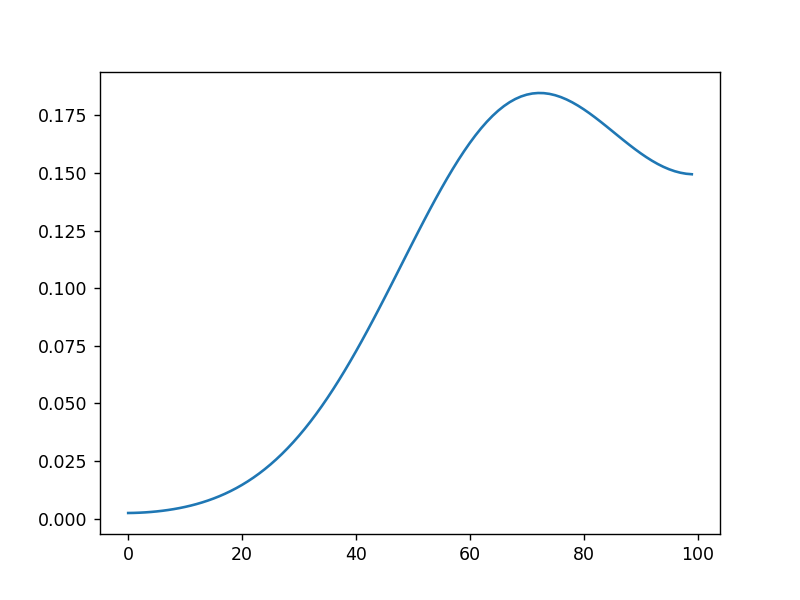

In [14]:
import scipy as sp
gridsize=100
diagonals = [np.ones(gridsize-1),np.zeros(gridsize+1),np.ones(gridsize-1)]
#1D grid-graph
AdjMatrix = sp.sparse.diags(diagonals,[-1,0,1]).toarray()
Deg=np.sum(AdjMatrix, axis=0)
Degree_Matrix=sp.sparse.diags(Deg)
regLap = Degree_Matrix - sp.sparse.csc_matrix(AdjMatrix)
#unnormalized laplacian
Laplacian=-regLap.toarray()
s,U=np.linalg.eigh(Laplacian)
s[-1]=0
s=s[::-1]
U=U[:,::-1]

pl.figure()
u_0=np.zeros(100)
u_0[70]=10
ker = np.dot(U,np.dot(np.diag(np.exp(s*250)),U.T))
gauss=np.dot(ker,u_0)
pl.plot(gauss)
param = np.dot(U.T,gauss)

<IPython.core.display.Javascript object>


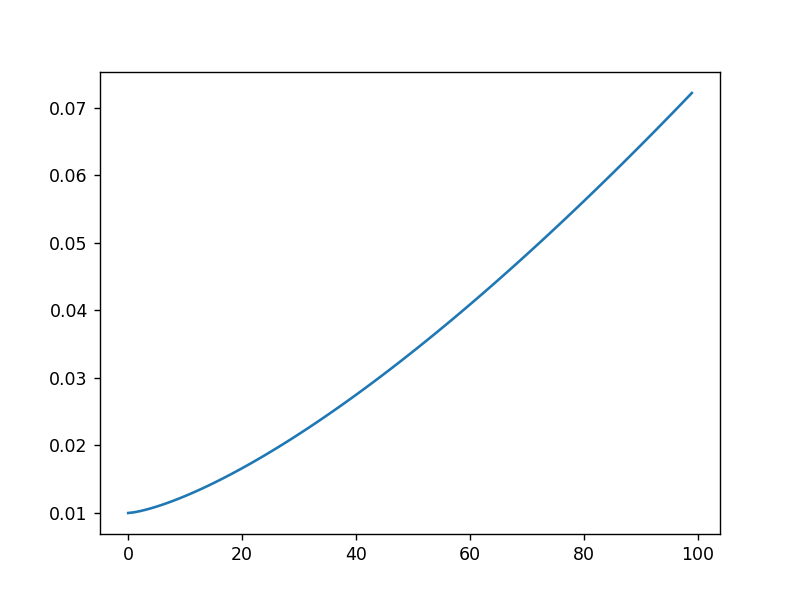

In [20]:
pl.figure()
param = np.arange(100)**1.4*0.0001+0.01
pl.plot(param)

<IPython.core.display.Javascript object>


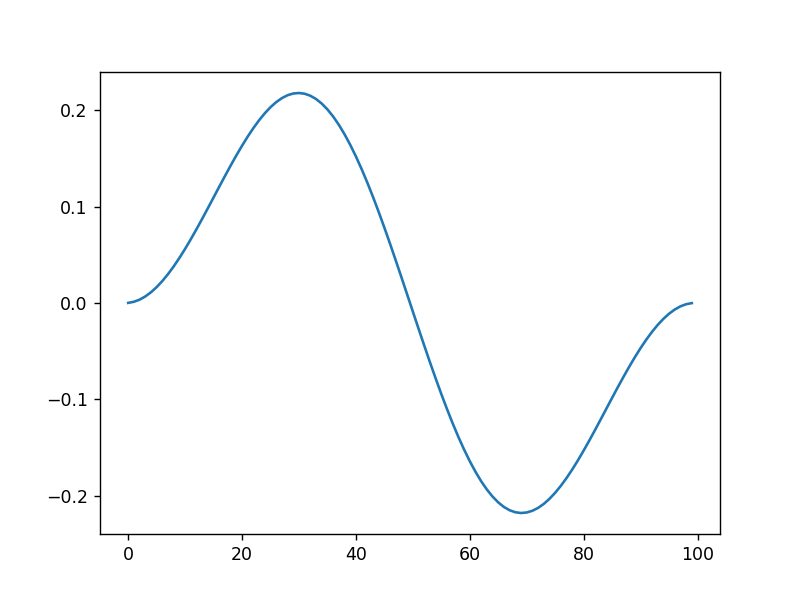

In [42]:
pl.figure()
pl.plot(U[:,3]+U[:,1])

<IPython.core.display.Javascript object>


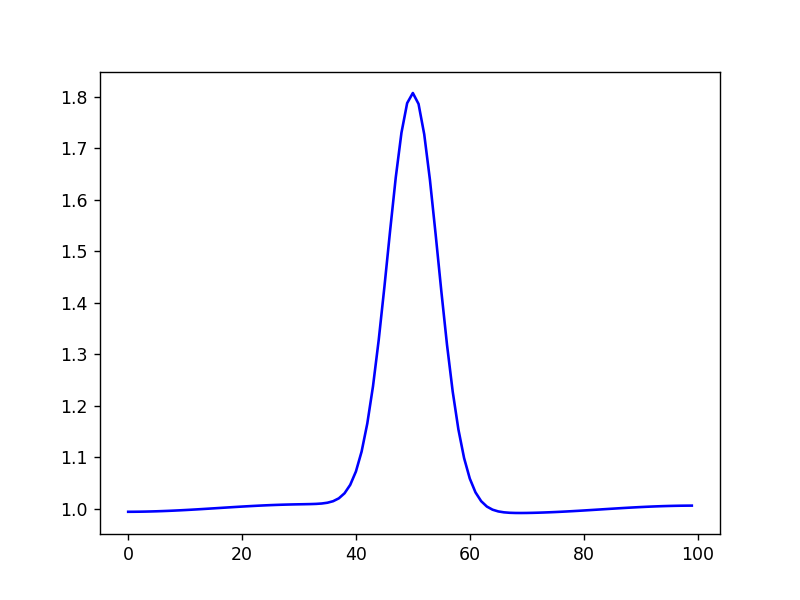

In [44]:
fig_sim = pl.figure()
ax = fig_sim.add_subplot(111)
u_0=np.ones(100)
u_0[50]=10
#u_0[80]=10
delta_t=np.ones(100)*0.1#param#np.dot(U.T,param)#0.01#np.dot(U.T,param)
delta_t[1]=10
delta_t[3]=10
ker = np.dot(U,np.dot(np.diag(np.exp(s*delta_t)),U.T))


for i in range(0,100):
    u_Delta_t = np.dot(ker,u_0)
    time.sleep(0.1)
    ax.clear()
    ax.plot(u_Delta_t, 'b-')           
    fig_sim.canvas.draw()
    fig_sim.canvas.flush_events()
    u_0=np.copy(u_Delta_t)
    

In [ ]:
#ECC-SURROUND SIZE
save_figures = False
rsq_thresh = 0.4
rois = ['custom.V1', 'custom.V2', 'custom.V3','custom.LO','custom.TO']
analysis_names=['fit-task-all_fit-runs-5050CVmedian']
vis_res.set_alpha(only_models=['Gauss', 'DoG', 'CSS', 'Norm_abcd'])
vis_res.ecc_surround_roi_plots(rois, rsq_thresh, save_figures, analysis_names=analysis_names)

#NORM BASELINES
save_figures = False
rsq_thresh = 0.25
analysis_names=['fit-task-all_fit-runs-all']
rois = ['custom.V1', 'custom.V2', 'custom.V3','custom.LO','custom.TO']#, 'custom.hV4','custom.VO',#,#'custom.hV4','custom.VO']#,
                     # 'custom.hV4','custom.VO','custom.V3AB','custom.LO','custom.TO','custom.IPS']
vis_res.set_alpha(only_models=['Gauss', 'DoG', 'CSS', 'Norm_abcd'])
vis_res.ecc_norm_baselines_roi_plots(rois, rsq_thresh, save_figures, analysis_names=analysis_names)

#CSS EXP
save_figures = False
rsq_thresh = 0.4
rois = ['custom.V1', 'custom.V2', 'custom.V3','custom.LO','custom.TO']
vis_res.set_alpha()
vis_res.ecc_css_exp_roi_plots(rois, rsq_thresh, save_figures)

In [ ]:
#this is to always set the alpha correctly
vis_res.set_alpha(only_models=['Gauss', 'DoG', 'CSS', 'Norm_abcd'])

save_figures = False
rsq_thresh = 0.0
analysis_names=['fit-task-all_fit-runs-5050CVmedian']
rois = rois = ['custom.V1', 'custom.V2', 'custom.V3', 
        'custom.V3AB', 'custom.hV4', 'custom.LO',
        'custom.IPS', 'custom.VO', 'custom.TO']
        #,'custom.IPS']#,'custom.FO']

vis_res.rsq_roi_plots(rois, rsq_thresh, save_figures, analysis_names=analysis_names, 
                      plot_hist=False, print_stats=False)

# Median vs mean fsaverage

In [43]:
(vis_res.main_dict['HCP']['fit-task-BAR_fit-runs-all']['100610']['mask']).sum()

108441

In [7]:
parabara = dict()
for param in vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['100610']['Processed Results'].keys():
    parabara[param] = np.nanmedian([vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][subj]['Processed Results'][param]['Norm_abcd'] for subj in vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'].keys() if 'fs' not in subj], axis=0)

/Users/marcoaqil/anaconda3/envs/prfpy_2021/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1119: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


In [8]:
#for key in parabara:
#    vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage']['Processed Results'][key]['Norm_abcd'] = deepcopy(parabara[key])
    

In [15]:
vis_res.set_alpha(only_models=['Norm_abcd'], ecc_min=0, ecc_max=8)
alpha_old = vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage']['Processed Results']['Alpha']['Norm_abcd']
#'RSq', 'Eccentricity', 'Polar Angle', 'Size ratio (sigma_2/sigma_1)', 'Norm Param. B', 'Norm Param. D', 'Size (sigma_1)', 'Size (sigma_2)', 'Amplitude', 'Surround Amplitude', 'Size (fwhmax)', 'Surround Size (fwatmin)',
ds_comp=dict()
for parname in ['Norm Param. B', 'Norm Param. D','Eccentricity', 'Polar Angle', 'Size ratio (sigma_2/sigma_1)','Size (sigma_1)', 'Size (sigma_2)', 'RSq']:
    zz_old = vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage']['Processed Results'][parname]['Norm_abcd']
    zz_new = parabara[parname]
    
    if parname == 'Polar Angle':
        cmap = 'Retinotopy_HSV_2x_alpha'
        ds_comp[f"mean {parname}"] = cortex.Vertex2D(zz_old, alpha_old, subject='fsaverage', 
                                               # vmin=np.nanquantile(zz_old[parabara['RSq']>0.05],0.1),vmax=np.nanquantile(zz_old[parabara['RSq']>0.05],0.9),
                             vmin2=0.05, vmax2=0.6, cmap=cmap).raw                                                      
        ds_comp[f"median {parname}"] = cortex.Vertex2D(zz_new, alpha_old, subject='fsaverage', 
                                               # vmin=np.nanquantile(zz_new[parabara['RSq']>0.05],0.1),vmax=np.nanquantile(zz_new[parabara['RSq']>0.05],0.9),
                             vmin2=0.05, vmax2=0.6, cmap=cmap).raw   
    else:
        cmap = 'Jet_2D_alpha'
        ds_comp[f"mean {parname}"] = cortex.Vertex2D(zz_old, alpha_old, subject='fsaverage', 
                                                vmin=np.nanquantile(zz_old[parabara['RSq']>0.05],0.1),vmax=np.nanquantile(zz_old[parabara['RSq']>0.05],0.9),
                             vmin2=0.05, vmax2=0.6, cmap=cmap).raw                                                      
        ds_comp[f"median {parname}"] = cortex.Vertex2D(zz_new, alpha_old, subject='fsaverage', 
                                                vmin=np.nanquantile(zz_new[parabara['RSq']>0.05],0.1),vmax=np.nanquantile(zz_new[parabara['RSq']>0.05],0.9),
                             vmin2=0.05, vmax2=0.6, cmap=cmap).raw              
cortex.webgl.show(ds_comp, with_curvature=False, with_labels=True, with_rois=True, with_borders=True, with_colorbar=True)    

HCP fit-task-BAR_fit-runs-all 100610
HCP fit-task-BAR_fit-runs-all 102311
HCP fit-task-BAR_fit-runs-all 102816
HCP fit-task-BAR_fit-runs-all 104416
HCP fit-task-BAR_fit-runs-all 105923
HCP fit-task-BAR_fit-runs-all 108323
HCP fit-task-BAR_fit-runs-all 109123
HCP fit-task-BAR_fit-runs-all 111312
HCP fit-task-BAR_fit-runs-all 111514
HCP fit-task-BAR_fit-runs-all 114823
HCP fit-task-BAR_fit-runs-all 115017
HCP fit-task-BAR_fit-runs-all 115825
HCP fit-task-BAR_fit-runs-all 116726
HCP fit-task-BAR_fit-runs-all 118225
HCP fit-task-BAR_fit-runs-all 125525
HCP fit-task-BAR_fit-runs-all 126426
HCP fit-task-BAR_fit-runs-all 128935
HCP fit-task-BAR_fit-runs-all 130114
HCP fit-task-BAR_fit-runs-all 130518
HCP fit-task-BAR_fit-runs-all 131217
HCP fit-task-BAR_fit-runs-all 131722
HCP fit-task-BAR_fit-runs-all 132118
HCP fit-task-BAR_fit-runs-all 134627
HCP fit-task-BAR_fit-runs-all 134829
HCP fit-task-BAR_fit-runs-all 135124
HCP fit-task-BAR_fit-runs-all 137128
HCP fit-task-BAR_fit-runs-all 140117
H

fsaverage fit-task-BAR_fit-runs-all 182739
fsaverage fit-task-BAR_fit-runs-all 185442
fsaverage fit-task-BAR_fit-runs-all 186949
fsaverage fit-task-BAR_fit-runs-all 187345
fsaverage fit-task-BAR_fit-runs-all 191033
fsaverage fit-task-BAR_fit-runs-all 191336
fsaverage fit-task-BAR_fit-runs-all 191841
fsaverage fit-task-BAR_fit-runs-all 192439
fsaverage fit-task-BAR_fit-runs-all 192641
fsaverage fit-task-BAR_fit-runs-all 193845
fsaverage fit-task-BAR_fit-runs-all 195041
fsaverage fit-task-BAR_fit-runs-all 196144
fsaverage fit-task-BAR_fit-runs-all 197348
fsaverage fit-task-BAR_fit-runs-all 198653
fsaverage fit-task-BAR_fit-runs-all 199655
fsaverage fit-task-BAR_fit-runs-all 200210
fsaverage fit-task-BAR_fit-runs-all 200311
fsaverage fit-task-BAR_fit-runs-all 200614
fsaverage fit-task-BAR_fit-runs-all 201515
fsaverage fit-task-BAR_fit-runs-all 203418
fsaverage fit-task-BAR_fit-runs-all 204521
fsaverage fit-task-BAR_fit-runs-all 205220
fsaverage fit-task-BAR_fit-runs-all 209228
fsaverage f

<JS: window.viewer>

In [10]:

parabara['x'] = np.nanmean([vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][subj]['Processed Results']['Eccentricity']['Norm_abcd']*np.cos(vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][subj]['Processed Results']['Polar Angle']['Norm_abcd']) for subj in vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'].keys() if 'fs' not in subj], axis=0)
parabara['y'] = np.nanmean([vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][subj]['Processed Results']['Eccentricity']['Norm_abcd']*np.sin(vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][subj]['Processed Results']['Polar Angle']['Norm_abcd']) for subj in vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'].keys() if 'fs' not in subj], axis=0)


In [39]:
parabara['Polar Angle'] = np.arctan2(parabara['y'],parabara['x'])
parabara['Eccentricity'] = np.sqrt(parabara['y']**2+parabara['x']**2)
vis_res.set_alpha(only_models=['Norm_abcd'], ecc_min=0, ecc_max=4.5)
alpha_old = vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage']['Processed Results']['Alpha']['Norm_abcd']
ds_comp=dict()
for parname in ['Polar Angle', 'Eccentricity']:
    zz_old = vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage']['Processed Results'][parname]['Norm_abcd']
    zz_new = parabara[parname]

    if parname == 'Polar Angle':
        cmap = 'Retinotopy_HSV_2x_alpha'
    else:
        cmap = 'Jet_2D_alpha'
    ds_comp[f"old {parname}"] = cortex.Vertex2D(zz_old, alpha_old, subject='fsaverage', 
                                               # vmin=np.nanquantile(zz_old[parabara['RSq']>0.15],0.1),vmax=np.nanquantile(zz_old[parabara['RSq']>0.15],0.9),
                             vmin2=0.05, vmax2=0.6, cmap=cmap).raw                                                      
    ds_comp[f"new {parname}"] = cortex.Vertex2D(zz_new, alpha_old, subject='fsaverage', 
                                              #  vmin=np.nanquantile(zz_new[parabara['RSq']>0.15],0.1),vmax=np.nanquantile(zz_new[parabara['RSq']>0.15],0.9),
                             vmin2=0.05, vmax2=0.6, cmap=cmap).raw              
cortex.webgl.show(ds_comp, with_curvature=False, with_labels=True, with_rois=True, with_borders=True, with_colorbar=True)   


HCP fit-task-BAR_fit-runs-all 100610
HCP fit-task-BAR_fit-runs-all 102311
HCP fit-task-BAR_fit-runs-all 102816
HCP fit-task-BAR_fit-runs-all 104416
HCP fit-task-BAR_fit-runs-all 105923
HCP fit-task-BAR_fit-runs-all 108323
HCP fit-task-BAR_fit-runs-all 109123
HCP fit-task-BAR_fit-runs-all 111312
HCP fit-task-BAR_fit-runs-all 111514
HCP fit-task-BAR_fit-runs-all 114823
HCP fit-task-BAR_fit-runs-all 115017
HCP fit-task-BAR_fit-runs-all 115825
HCP fit-task-BAR_fit-runs-all 116726
HCP fit-task-BAR_fit-runs-all 118225
HCP fit-task-BAR_fit-runs-all 125525
HCP fit-task-BAR_fit-runs-all 126426
HCP fit-task-BAR_fit-runs-all 128935
HCP fit-task-BAR_fit-runs-all 130114
HCP fit-task-BAR_fit-runs-all 130518
HCP fit-task-BAR_fit-runs-all 131217
HCP fit-task-BAR_fit-runs-all 131722
HCP fit-task-BAR_fit-runs-all 132118
HCP fit-task-BAR_fit-runs-all 134627
HCP fit-task-BAR_fit-runs-all 134829
HCP fit-task-BAR_fit-runs-all 135124
HCP fit-task-BAR_fit-runs-all 137128
HCP fit-task-BAR_fit-runs-all 140117
H

fsaverage fit-task-BAR_fit-runs-all 192641
fsaverage fit-task-BAR_fit-runs-all 193845
fsaverage fit-task-BAR_fit-runs-all 195041
fsaverage fit-task-BAR_fit-runs-all 196144
fsaverage fit-task-BAR_fit-runs-all 197348
fsaverage fit-task-BAR_fit-runs-all 198653
fsaverage fit-task-BAR_fit-runs-all 199655
fsaverage fit-task-BAR_fit-runs-all 200210
fsaverage fit-task-BAR_fit-runs-all 200311
fsaverage fit-task-BAR_fit-runs-all 200614
fsaverage fit-task-BAR_fit-runs-all 201515
fsaverage fit-task-BAR_fit-runs-all 203418
fsaverage fit-task-BAR_fit-runs-all 204521
fsaverage fit-task-BAR_fit-runs-all 205220
fsaverage fit-task-BAR_fit-runs-all 209228
fsaverage fit-task-BAR_fit-runs-all 212419
fsaverage fit-task-BAR_fit-runs-all 214019
fsaverage fit-task-BAR_fit-runs-all 214524
fsaverage fit-task-BAR_fit-runs-all 221319
fsaverage fit-task-BAR_fit-runs-all 233326
fsaverage fit-task-BAR_fit-runs-all 239136
fsaverage fit-task-BAR_fit-runs-all 246133
fsaverage fit-task-BAR_fit-runs-all 249947
fsaverage f

<JS: window.viewer>

# Param recovery

In [15]:
gg.stimulus.convolved_design_matrix.shape

(54, 54, 221)

In [14]:
# gauss grid params
grid_nr = 20
max_ecc_size = vis_res.prf_stims['2R'].screen_size_degrees/2.0
sizes, eccs, polars = max_ecc_size * np.linspace(0.25, 1, grid_nr)**2, \
    max_ecc_size * np.linspace(0.1, 1, grid_nr)**2, \
    np.linspace(0, 2*np.pi, grid_nr)

# to set up parameter bounds in iterfit
inf = np.inf
eps = 1e-1
ss = vis_res.prf_stims['2R'].screen_size_degrees

gauss_bounds = [(-1.5*max_ecc_size, 1.5*max_ecc_size),  # x
                    (-1.5*max_ecc_size, 1.5*max_ecc_size),  # y
                    (eps, 1.5*ss),  # prf size
                    (0, 1000),  # prf amplitude
                    (0, 0)]  # bold baseline


norm_bounds = [(-1.5*max_ecc_size, 1.5*max_ecc_size),  # x
                    (-1.5*max_ecc_size, 1.5*max_ecc_size),  # y
                    (eps, 1.5*ss),  # prf size
                    (0, 1000),  # prf amplitude
                    (0, 0),  # bold baseline
                    (0, 1000),  # surround amplitude
                    (eps, 3*ss),  # surround size
                    (0, 1000),  # neural baseline
                    (1e-6, 1000)]  # surround baseline



surround_amplitude_grid=np.array([0,0.01,0.05,0.2,0.4,0.7,1,3], dtype='float32')
surround_size_grid=np.array([3,5,8,12,18], dtype='float32')
neural_baseline_grid=np.array([0,1,10,100], dtype='float32')
surround_baseline_grid=np.array([0.1,1.0,10.0,100.0], dtype='float32')

# surround_amplitude_grid=np.array([0.01,0.1,1,10], dtype='float32')
# surround_size_grid=np.array([5,8,12,18], dtype='float32')
# neural_baseline_grid=np.array([0.1,1,10,100], dtype='float32')
# surround_baseline_grid=np.array([0.1,1.0,10.0,100.0], dtype='float32')

n_jobs = 1
n_batches = 1
fit_hrf = False
pos_prfs_only = True
constraints_gauss = []
constraints_norm = constraints_gauss
xtol = 1e-5
ftol = 1e-5
rsq_threshold = 0.05
verbose = False
# Gaussian model
gg = vis_res.prf_models['Gauss']

data = pred

gf = Iso2DGaussianFitter(
    data=data, model=gg, n_jobs=n_jobs, fit_hrf=fit_hrf)



# gf.grid_fit(ecc_grid=eccs,
#                 polar_grid=polars,
#                 size_grid=sizes,
#                 verbose=verbose,
#                 n_batches=n_batches,
#                 pos_prfs_only=pos_prfs_only)

# gf.iterative_fit(rsq_threshold=rsq_threshold, verbose=verbose,
#                  bounds=gauss_bounds,
#                  constraints=constraints_gauss,
#                      xtol=xtol,
#                      ftol=ftol)

# normalization iterative fit
gg_norm = vis_res.prf_models['Norm_abcd']

gf_norm = Norm_Iso2DGaussianFitter(data=data,
                                   model=gg_norm,
                                   n_jobs=n_jobs,
                                   fit_hrf=fit_hrf,
                                   previous_gaussian_fitter=gf)

# gf_norm.grid_fit(surround_amplitude_grid,
#              surround_size_grid,
#              neural_baseline_grid,
#              surround_baseline_grid,
#              verbose=verbose,
#              n_batches=n_batches,
#              rsq_threshold=rsq_threshold,
#              pos_prfs_only=pos_prfs_only)

# gf_norm.iterative_fit(rsq_threshold=rsq_threshold, verbose=verbose,
#                                bounds=norm_bounds,
#                                constraints=constraints_norm,
#                                xtol=xtol,
#                                ftol=ftol)



In [30]:
pred = vis_res.prf_models['Norm_abcd'].return_prediction(*list(params[:,:-1].T))-params[:,4][...,np.newaxis]
#noisy_gauss_pred = np.split(np.load('/Users/marcoaqil/param_recov/sub-006_timecourse_space-fsnative-arima-rsq.npy'),20,axis=0)[0]
#noisy_gauss_pred = np.split(np.load('/Users/marcoaqil/param_recov/sub-006_timecourse_space-fsnative-ranresid.npy'),20,axis=0)[0]
#noisy_gauss_pred = np.split(np.load('/Users/marcoaqil/param_recov/sub-006_timecourse_space-fsnative-phsresid.npy'),20,axis=0)[0]
#noisy_gauss_pred = np.split(np.load('/Users/marcoaqil/param_recov/sub-006_timecourse_space-fsnative-arimarsq-gauss.npy'),20,axis=0)[0]
noisy_gauss_pred = np.split(np.load('/Users/marcoaqil/param_recov/sub-006_timecourse_space-fsnative-arima-rsq.npy'),20,axis=0)[0]

In [58]:
#Gauss arimarsq fit
gf_norm.iterative_search_params = np.median(np.split(np.load('/Users/marcoaqil/param_recov/sub-006_iterparams-norm_space-fsnative2021-08-09-13-44-07.npy'),
                                                                     20,axis=0),axis=0)

In [46]:
#Dog arimarsq fit
gf_norm.iterative_search_params = np.median(np.split(np.concatenate((np.load('/Users/marcoaqil/param_recov/sub-006_iterparams-norm_space-fsnative2021-08-09-23-38-30.npy'),
                                                                    np.load('/Users/marcoaqil/param_recov/sub-006_iterparams-norm_space-fsnative2021-08-10-17-17-00.npy')),axis=0),
                                                                     40,axis=0),axis=0)

In [53]:
#CSS arimarsq fit
gf_norm.iterative_search_params = np.median(np.split(np.concatenate((np.load('/Users/marcoaqil/param_recov/sub-006_iterparams-norm_space-fsnative2021-08-09-11-05-37.npy'),
                                                                     np.load('/Users/marcoaqil/param_recov/sub-006_iterparams-norm_space-fsnative2021-08-11-00-41-38.npy')),axis=0),
                                                                     40,axis=0),axis=0)

In [51]:
#phase resid
gf_norm.iterative_search_params = np.median(np.split(np.load('/Users/marcoaqil/param_recov/sub-006_iterparams-norm_space-fsnative2021-08-07-04-11-57.npy'),
                                                                     20,axis=0),axis=0)

In [42]:
#ranresid
gf_norm.iterative_search_params = np.median(np.split(np.load('/Users/marcoaqil/param_recov/sub-006_iterparams-norm_space-fsnative2021-08-06-18-58-09.npy'),
                                                                     20,axis=0),axis=0)

In [50]:
#arima rsq 100 times  DN on DN
gf_norm.iterative_search_params = np.median(np.split(np.concatenate((np.load('/Users/marcoaqil/param_recov/sub-006_iterparams-norm_space-fsnative2021-08-04-18-37-56.npy'),
                                                                    np.load('/Users/marcoaqil/param_recov/sub-006_iterparams-norm_space-fsnative2021-08-05-11-47-48.npy')#,
                                                                   # np.load('/Users/marcoaqil/param_recov/sub-006_iterparams-norm_space-fsnative2021-08-05-18-03-55.npy'),
                                                                    #np.load('/Users/marcoaqil/param_recov/sub-006_iterparams-norm_space-fsnative2021-08-06-10-23-50.npy'),
                                                                    #np.load('/Users/marcoaqil/param_recov/sub-006_iterparams-norm_space-fsnative2021-08-06-15-06-20.npy')
                                                                    ), axis=0),
                                                                     40,axis=0),axis=0)

In [134]:
#max arimarsq
# gf_norm.iterative_search_params = np.array([np.load(f'/Users/marcoaqil/param_recov/sub-006_iterparams-norm_space-fsnative{date}.npy')
#                                            for date in ['2021-08-03-17-59-17','2021-08-03-18-20-23','2021-08-03-18-40-27']])[np.argmax([np.load(f'/Users/marcoaqil/param_recov/sub-006_iterparams-norm_space-fsnative{date}.npy')[:,-1]
#                                            for date in ['2021-08-03-17-59-17','2021-08-03-18-20-23','2021-08-03-18-40-27']],axis=0),np.arange(22665),:]

In [353]:
#arima noise '2021-08-02-15-20-15'; no noise '2021-08-02-14-20-20'; white noise '2021-08-02-12-05-57'; true noise '2021-08-02-16-12-05'
#arima rsq1 '2021-08-03-17-59-17' #arimarsq2 '2021-08-03-18-20-23'#arimarsq3 '2021-08-03-18-40-27' #arimarsq4, reordered 2021-08-04-16-38-32
date = '2021-08-04-16-38-32'
gf_norm.iterative_search_params = np.load(f'/Users/marcoaqil/param_recov/sub-006_iterparams-norm_space-fsnative{date}.npy')
gf_norm.gridsearch_params = np.load(f'/Users/marcoaqil/param_recov/sub-006_gridparams-norm_space-fsnative{date}.npy')
gf.iterative_search_params = np.load(f'/Users/marcoaqil/param_recov/sub-006_iterparams-gauss_space-fsnative{date}.npy')
gf.gridsearch_params = np.load(f'/Users/marcoaqil/param_recov/sub-006_gridparams-gauss_space-fsnative{date}.npy')

In [42]:
#parr_try = gf_norm.gridsearch_params[1,:-1].T
#parr_try = gf_norm.iterative_search_params[1,:-1].T
#parr_try[-2]=10*gf_norm.gridsearch_params[1,3]

In [ ]:
#(gf_norm.iterative_search_params[gf_norm.gridsearch_params[:,-1]>0.05]-gf_norm.gridsearch_params[gf_norm.gridsearch_params[:,-1]>0.05])

In [47]:
fit_norm = vis_res.prf_models['Norm_abcd'].return_prediction(*list(gf_norm.iterative_search_params[:,:-1].T))
#fit_gauss = vis_res.prf_models['Gauss'].return_prediction(*list(gf.iterative_search_params[:,:-1].T))

/Users/marcoaqil/legacy/prfpy/prfpy/rf.py:112: RuntimeWarning: divide by zero encountered in true_divide
  return np.exp(-((x-mu[0])**2 + (y-mu[1])**2)/(2*sigma**2))
/Users/marcoaqil/legacy/prfpy/prfpy/model.py:520: RuntimeWarning: invalid value encountered in true_divide
  (srf_amplitude[..., np.newaxis] * stimulus_through_prf(srf, dm, self.stimulus.dx) + surround_baseline[..., np.newaxis]) \
/Users/marcoaqil/legacy/prfpy/prfpy/model.py:521: RuntimeWarning: invalid value encountered in true_divide
  - neural_baseline[..., np.newaxis]/surround_baseline[..., np.newaxis]


In [240]:
ccc = np.copy(gf_norm.iterative_search_params[num])
ccc[np.array([3,5,7,8])] *= params[num,3]/gf_norm.iterative_search_params[num,3]

<IPython.core.display.Javascript object>


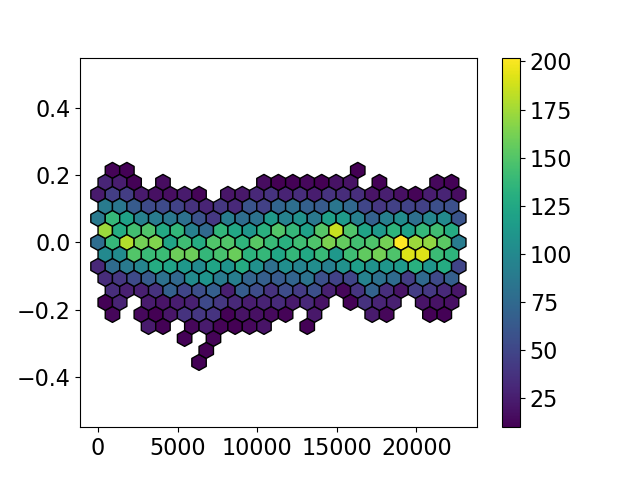

<IPython.core.display.Javascript object>


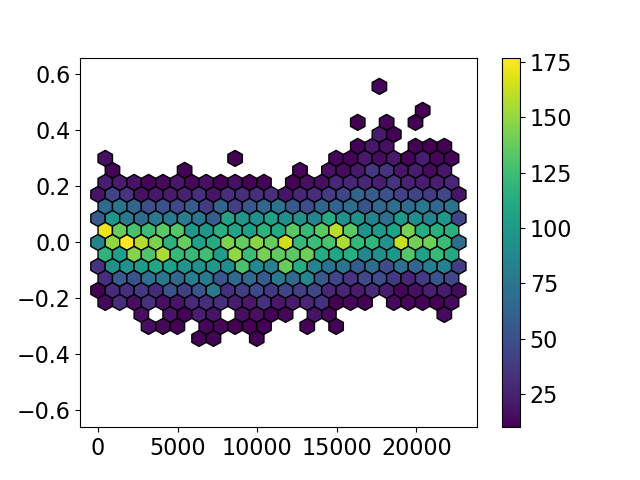

<IPython.core.display.Javascript object>


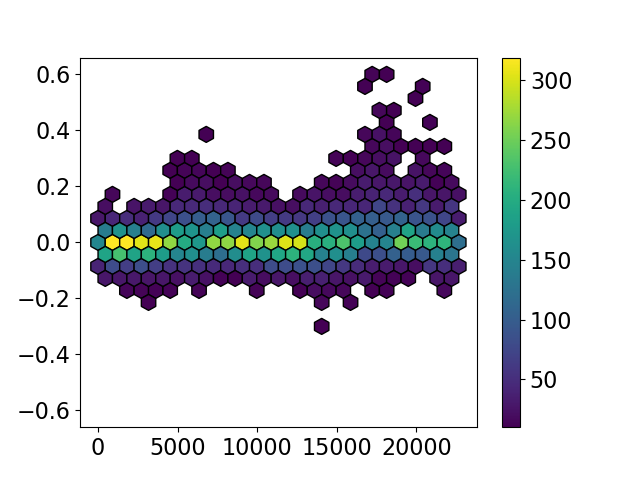

In [39]:
pl.figure()
pl.hexbin(np.arange(22665),np.mean(pred-curr_tc,axis=-1), cmap='viridis',mincnt=10,gridsize=25,edgecolors='k',extent=[0,22665,-0.5,0.5])
pl.colorbar()
pl.figure()
pl.hexbin(np.arange(22665),np.mean(fit_norm-curr_tc,axis=-1), cmap='viridis',mincnt=10,gridsize=25,edgecolors='k',extent=[0,22665,-0.6,0.6])
pl.colorbar()
pl.figure()
pl.hexbin(np.arange(22665),np.mean(fit_norm-noisy_gauss_pred,axis=-1), cmap='viridis',mincnt=10,gridsize=25,edgecolors='k',extent=[0,22665,-0.6,0.6])
pl.colorbar()

<IPython.core.display.Javascript object>


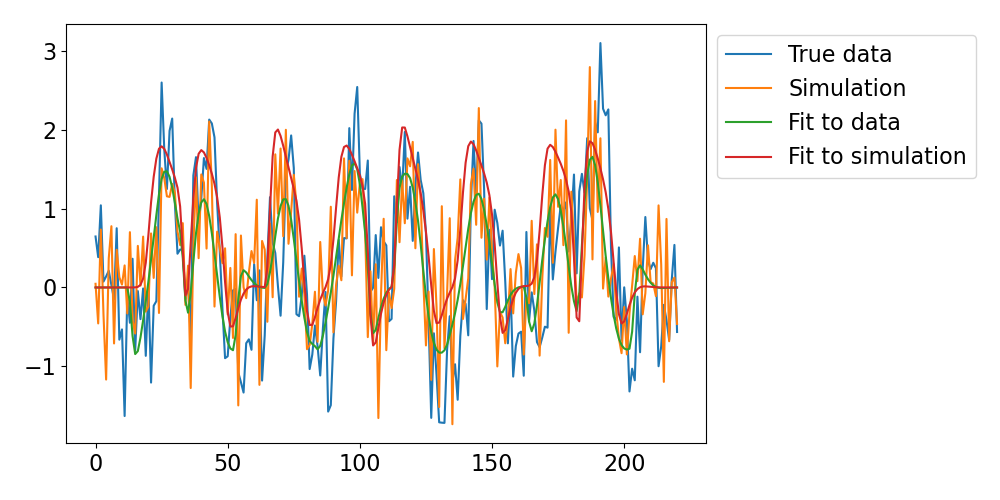

true params:
[  2.2679   0.5559   2.6942  15.9259 100.       5.9195  21.3771   0.0764
   0.1183   0.4581]
recovered params (last is rsq):
[ 2.5589  1.0151  1.5793 22.1625  0.     12.8791  1.6105 15.4458 85.4002
  0.4527]


In [16]:
pl.figure(figsize=(10,5))
num=6010
pl.plot(curr_tc[num], label='True data')
pl.plot(noisy_gauss_pred[num], label='Simulation')
pl.plot(pred[num], label='Fit to data')
pl.plot(fit_norm[num],label='Fit to simulation')
#pl.plot(noisy_gauss_pred[num]-curr_tc[num])
pl.legend(bbox_to_anchor=(1, 1), loc='upper left', ncol=1)
pl.tight_layout()
print("true params:")
print(params[num])
print("recovered params (last is rsq):")
print(gf_norm.iterative_search_params[num])

In [128]:
1-np.sum((pred[num]-noisy_gauss_pred[num])**2)/(len(noisy_gauss_pred[num])*noisy_gauss_pred[num].var())

0.643665793324713

In [316]:
1-np.sum((fit_norm[num]-curr_tc[num])**2)/(len(curr_tc[num])*curr_tc[num].var())

0.4634234338862704

In [142]:
np.sum(gf_norm.iterative_search_params[gf_norm.gridsearch_params[:,-1]>0.05,3]==0)

0

In [70]:
np.sum(np.isnan(rsq) | ~np.isfinite(rsq))

0

In [191]:
gf_norm.iterative_search_params[gf_norm.iterative_search_params[:,-1]<0,-1]=0

In [ ]:
#pl.figure()
#pl.plot(gf_norm.iterative_search_params[:,8])
#pl.plot(params[:,8])
#pl.scatter(gf_norm.iterative_search_params[:,3],params[:,3])
for i in range(msk.sum()):
    print(i)
    print(np.corrcoef(params[:,np.array([3,5,7,8])][msk][i],gf_norm.iterative_search_params[:,np.array([3,5,7,8])][msk][i])[0,1])
    print(nc[msk][i])

In [173]:
params[:,np.array([3,5,7,8])][msk].shape

(164, 4)

<IPython.core.display.Javascript object>


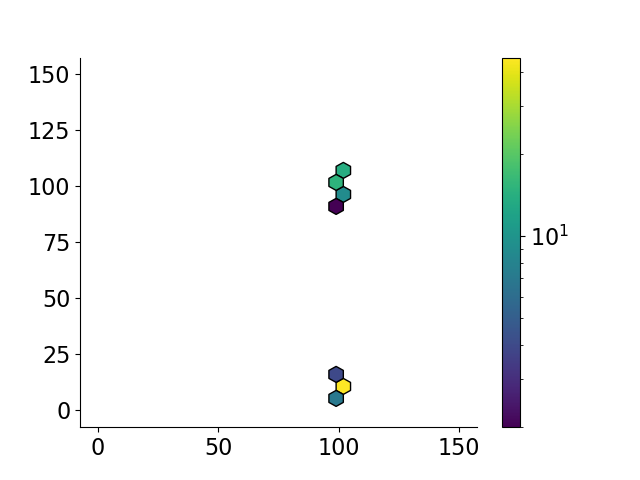

In [201]:
pl.figure()
#pl.scatter(params[gf_norm.iterative_search_params[:,-1]>0.3,8],gf_norm.iterative_search_params[gf_norm.iterative_search_params[:,-1]>0.3,8],s=1)
pl.hexbin(params[msk,7],gf_norm.iterative_search_params[msk,7], 
          cmap='viridis',mincnt=2,gridsize=25,edgecolors='k',extent=[0,150,0,150],bins='log')
pl.colorbar()

WLS score 0.0028009159224516855
corrcoef -0.05115081953605281


<IPython.core.display.Javascript object>


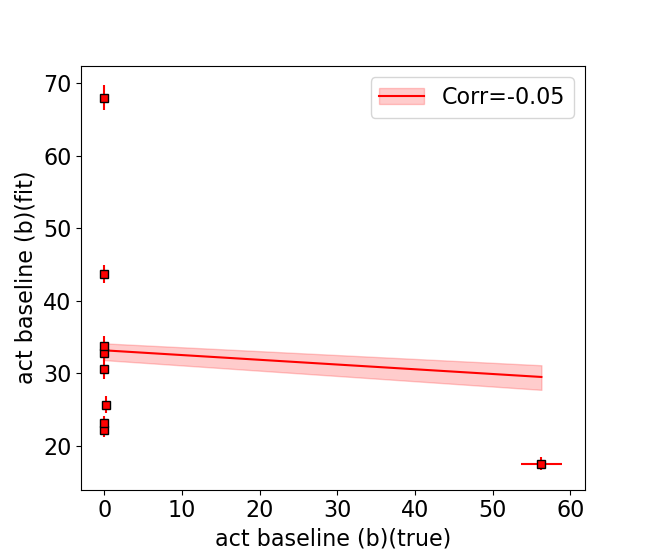

<IPython.core.display.Javascript object>


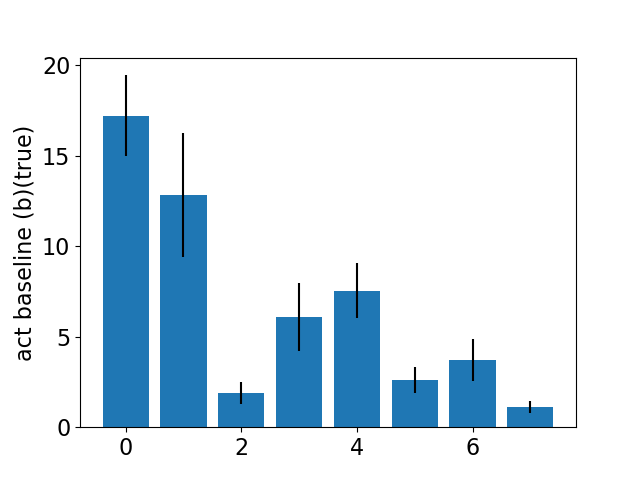

<IPython.core.display.Javascript object>


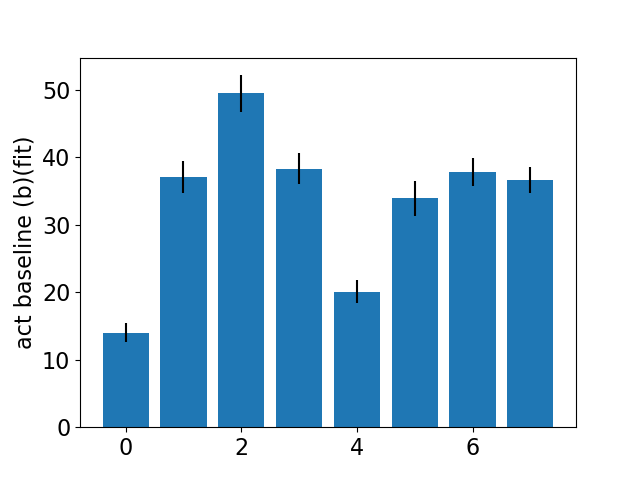

Text(0, 0.5, 'act baseline (b)(fit)')

In [61]:
from statsmodels.stats import weightstats
from sklearn.linear_model import LinearRegression

param_names = ['x pos', 'y pos', 'act size', 'act amplitude (a)', 'bold baseline', 'norm amplitude (c)', 'norm size', 'act baseline (b)', 'norm baseline (d)', 'rsq']

roi_sizes = []
for k in ress_dict_norm:
    roi_sizes.append(ress_dict_norm[k].shape[0])
roi_sizes = np.array(roi_sizes)

x_par_num = 7
y_par_num = 7

nr_bins = 9
msk = gf_norm.iterative_search_params[:,-1]>0.3 * ((gf_norm.iterative_search_params[:,0]**2+gf_norm.iterative_search_params[:,1]**2)**0.5<4.5)#gf_norm.iterative_search_params[:,-1]-gf.iterative_search_params[:,-1] >0.05#
#bin stats 
x_par = params[msk,x_par_num]#/params[msk,5]
y_par = gf_norm.iterative_search_params[msk,y_par_num]#/gf_norm.iterative_search_params[msk,5]
rsq = gf_norm.iterative_search_params[msk,-1]

x_par_sorted = np.argsort(x_par)

x_par_stats = []
y_par_stats = []
rsq_stats = []

split_x_par_bins = np.array_split(x_par_sorted, nr_bins)

for x_par_quantile in split_x_par_bins:
    y_par_stats.append(weightstats.DescrStatsW(y_par[x_par_quantile],
                                               weights=rsq[x_par_quantile]))

    x_par_stats.append(weightstats.DescrStatsW(x_par[x_par_quantile],
                                            weights=rsq[x_par_quantile]))

    rsq_stats.append(weightstats.DescrStatsW(rsq[x_par_quantile],
                                            weights=np.ones_like(rsq[x_par_quantile])))

curr_x_bins = np.array([ss.mean for ss in x_par_stats])
curr_y_bins = np.array([ss.mean for ss in y_par_stats])

WLS = LinearRegression()
WLS.fit(x_par.reshape(-1, 1), y_par, sample_weight=rsq)

wls_score = WLS.score(x_par.reshape(-1, 1),
                    y_par.reshape(-1, 1),
                    sample_weight=rsq.reshape(-1, 1))

ccf = np.corrcoef(x_par,y_par)[0,1]
print(f"WLS score {wls_score}")
print(f"corrcoef {ccf}")

bootstrap_fits = []
for c in range(200):

    sample = np.random.randint(0, len(x_par), int(len(x_par)))

    WLS_bootstrap = LinearRegression()
    WLS_bootstrap.fit(x_par[sample].reshape(-1, 1), y_par[sample], sample_weight=rsq[sample])

    bootstrap_fits.append(WLS_bootstrap.predict(curr_x_bins.reshape(-1, 1)))


current_color = 'red'

pl.figure(figsize=(6.5,5.5))

pl.plot(curr_x_bins,
    WLS.predict(curr_x_bins.reshape(-1, 1)),
    color=current_color, label=f"Corr={ccf:.2f}")# p={pval_lin:.2e}")

#Lin. R2={wls_score:.2f}
#conf interval shading s
pl.fill_between(curr_x_bins,
                    np.min(bootstrap_fits, axis=0),
                    np.max(bootstrap_fits, axis=0),
                    alpha=0.2, color=current_color, label=f"Corr={ccf:.2f}")# p={pval_lin:.2e}")



curr_yerr = np.array([ss.std_mean for ss in y_par_stats])
curr_xerr = np.array([ss.std_mean for ss in x_par_stats])

pl.errorbar(curr_x_bins,
    curr_y_bins,
    yerr=curr_yerr,
    xerr=curr_xerr,
    fmt='s',  mec='black', color=current_color)

handles, labels = pl.gca().get_legend_handles_labels()
from collections import defaultdict as dd
legend_dict = dd(list)
for cc, label in enumerate(labels):
    legend_dict[label].append(handles[cc])

for label in legend_dict:
    legend_dict[label] = tuple(legend_dict[label])

pl.legend([legend_dict[label] for label in legend_dict], legend_dict.keys())  

pl.xlabel(param_names[x_par_num]+'(true)')
pl.ylabel(param_names[y_par_num]+'(fit)')

splitter = np.cumsum(roi_sizes)
splitter = nr_bins

pl.figure()
pl.bar(np.arange(splitter-1), [weightstats.DescrStatsW(x_par_roi,
                        weights=rsq_roi).mean for x_par_roi,rsq_roi in zip(np.array_split(x_par,splitter),np.array_split(rsq,splitter))][:-1],
                      yerr=[weightstats.DescrStatsW(x_par_roi,
                        weights=rsq_roi).std_mean*3**0.5 for x_par_roi,rsq_roi in zip(np.array_split(x_par,splitter),np.array_split(rsq,splitter))][:-1])
#pl.xticks(np.arange(9), [r.replace('custom.','') for r in ress_dict])
pl.ylabel(param_names[x_par_num]+'(true)')
pl.figure()
pl.bar(np.arange(splitter-1), [weightstats.DescrStatsW(y_par_roi,
                        weights=rsq_roi).mean for y_par_roi,rsq_roi in zip(np.array_split(y_par,splitter),np.array_split(rsq,splitter))][:-1],
                      yerr=[weightstats.DescrStatsW(y_par_roi,
                        weights=rsq_roi).std_mean*3**0.5 for y_par_roi,rsq_roi in zip(np.array_split(y_par,splitter),np.array_split(rsq,splitter))][:-1])
pl.ylabel(param_names[y_par_num]+'(fit)')
#pl.xticks(np.arange(9), [r.replace('custom.','') for r in ress_dict])



In [ ]:
# from scipy.stats import sem
# pl.figure()
# n_bins = 50


# pl.errorbar(np.mean(np.array_split(params.T[:,2],n_bins),axis=1),
#             np.mean(np.array_split(gf_norm.iterative_search_params[:,-3],n_bins),axis=1),
#             xerr=sem(np.array_split(params.T[:,2],n_bins),axis=1),
#             yerr=sem(np.array_split(gf_norm.iterative_search_params[:,-3],n_bins),axis=1),
#            fmt='s',  mec='k', color='r', ecolor='k')
# #pl.scatter(params.T[:,2],gf_norm.iterative_search_params[:,-3], color='k',s=5)

# #pl.plot(gf.iterative_search_params[:,-1])

<IPython.core.display.Javascript object>


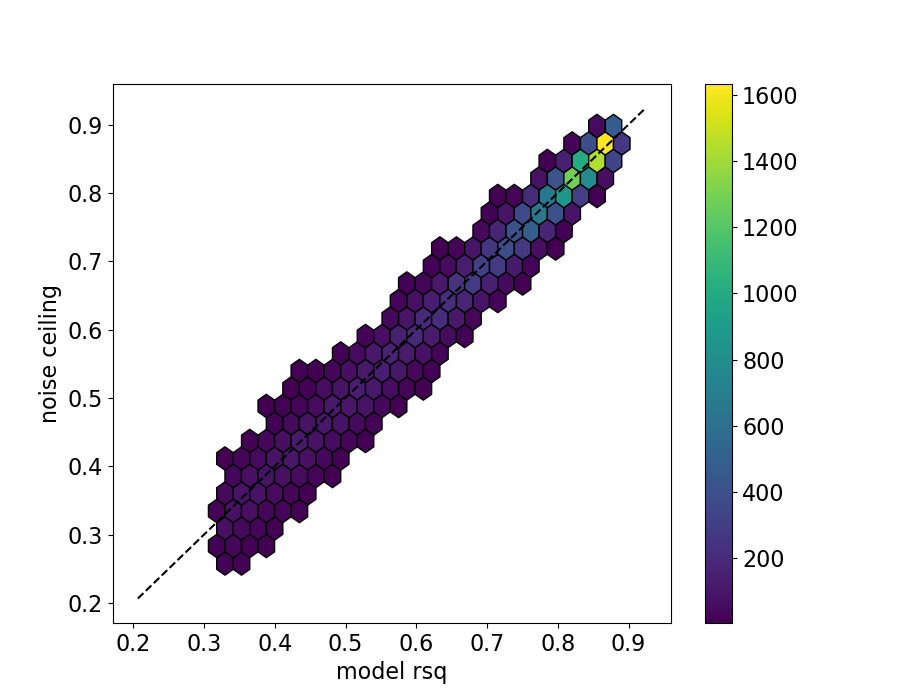

Text(0.5, 0, 'model rsq')

In [138]:
fig = pl.figure(figsize=(9,7))
hx = pl.hexbin(gf_norm.iterative_search_params[:,-1],nc, cmap='viridis',mincnt=5,gridsize=25,edgecolors='k')
fig.colorbar(hx)
pl.plot(np.linspace(nc.min(),nc.max(),100),np.linspace(nc.min(),nc.max(),100),c='k',ls='--')
pl.ylabel('noise ceiling')
pl.xlabel('model rsq')


<IPython.core.display.Javascript object>


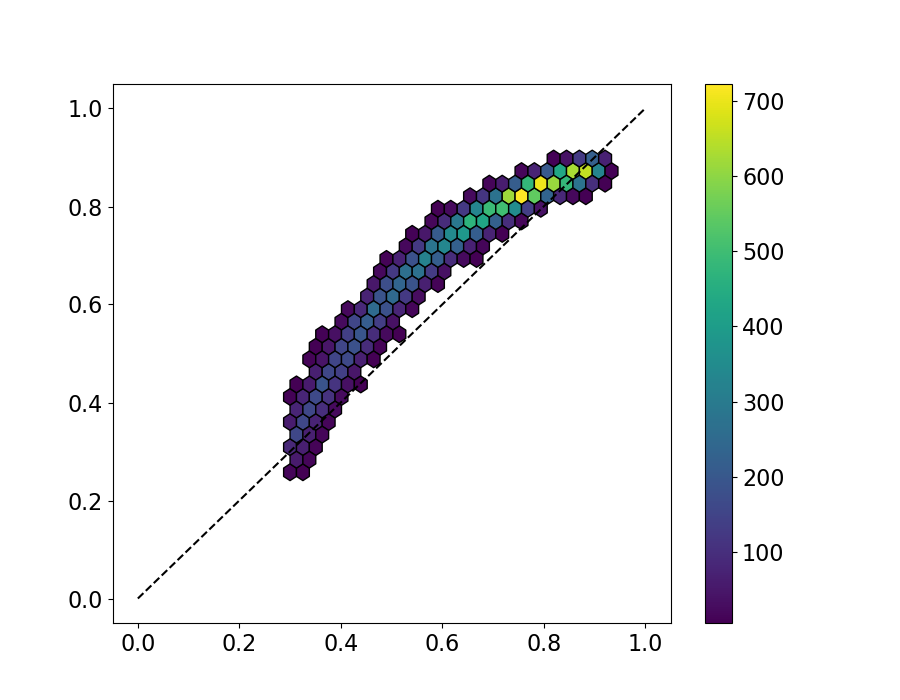

In [64]:
fig = pl.figure(figsize=(9,7))
hx = pl.hexbin(params[:,-1],nc, cmap='viridis',mincnt=5,gridsize=25,edgecolors='k')
fig.colorbar(hx)
pl.plot(np.linspace(0,1,100),np.linspace(0,1,100),c='k',ls='--')

<IPython.core.display.Javascript object>


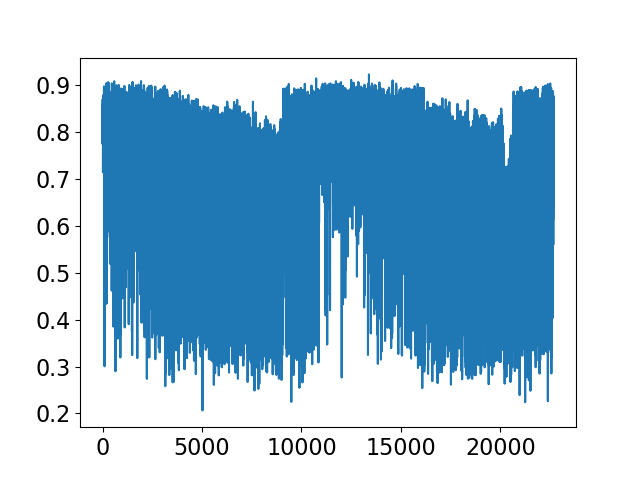

In [63]:
nc = []

for l in range(pred.shape[0]):
    nc.append(1-np.sum((pred[l]-noisy_gauss_pred[l])**2)/(len(noisy_gauss_pred[l])*noisy_gauss_pred[l].var()))
nc=np.array(nc)    
pl.figure()
pl.plot(nc)

In [248]:
params = np.copy(all_params_norm[all_roi_mask])

In [219]:
#something wrong with this
# params = []
# for curr_roi in ress_dict_norm:
#     print(curr_roi)
#     #sample_roi = np.arange(ress_dict_norm[curr_roi].shape[0])#np.random.randint(0, ress_dict_norm[curr_roi].shape[0], np.max((1000,ress_dict_norm[curr_roi].shape[0])))
#     params.append(ress_dict_norm[curr_roi])#[sample_roi])
# params = np.concatenate(np.array(params),axis=0)

custom.V1
custom.V2
custom.V3
custom.V3AB
custom.hV4
custom.LO
custom.TO
custom.VO
custom.IPS


/Users/marcoaqil/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  


In [359]:
num_preds = 100
#decent recovery of A,D,C (b not so great)
#params = np.asarray([2*np.ones(num_preds),2*np.ones(num_preds),np.linspace(1,10,num_preds),np.linspace(10,1,num_preds),np.zeros(num_preds),0.1*np.ones(num_preds),10*np.ones(num_preds),100*np.ones(num_preds),100*np.ones(num_preds),np.ones(num_preds)]).T
#perfect recovery up to rescaling by C
#params = np.asarray([1*np.ones(num_preds),1*np.ones(num_preds),np.linspace(0.5,1,num_preds),np.linspace(50,5,num_preds),np.zeros(num_preds),1*np.ones(num_preds),10*np.ones(num_preds),100*np.ones(num_preds),100*np.ones(num_preds),np.ones(num_preds)]).T

params = np.asarray([1*np.ones(num_preds),1*np.ones(num_preds),np.linspace(0.5,5,num_preds),np.geomspace(50,5,num_preds),np.zeros(num_preds),1*np.ones(num_preds),10*np.ones(num_preds),100*np.ones(num_preds),100*np.ones(num_preds),np.ones(num_preds)]).T

# vis_res.prf_models['Norm_abcd'].stimulus.design_matrix = np.concatenate((vis_res.prf_stims['1R'].design_matrix,vis_res.prf_stims['2R'].design_matrix,vis_res.prf_stims['4R'].design_matrix),axis=-1)
# vis_res.prf_models['Gauss'].stimulus.design_matrix = np.concatenate((vis_res.prf_stims['1R'].design_matrix,vis_res.prf_stims['2R'].design_matrix,vis_res.prf_stims['4R'].design_matrix),axis=-1)

# from prfpy.timecourse import stimulus_through_prf, \
#     convolve_stimulus_dm
# vis_res.prf_models['Gauss'].stimulus.convolved_design_matrix = convolve_stimulus_dm(vis_res.prf_models['Gauss'].stimulus.design_matrix,vis_res.prf_models['Gauss'].hrf)

pred = vis_res.prf_models['Norm_abcd'].return_prediction(*list(params[:,:-1].T))-params[:,4][...,np.newaxis]
pl.figure()
pl.plot(pred[::10].T)

AttributeError: 'visualize_results' object has no attribute 'prf_models'

In [255]:
params[:,7] = 0
params[:,8] = np.mean(params[:,8])

In [64]:
from prfpy.timecourse import generate_arima_noise
arno = 0.3*(((1/params[:,-1]**2.5)*pred.var(-1))**0.5)[...,np.newaxis] * generate_arima_noise(ar=(1, 0.4),
                         ma=(1, 0.0),
                            dimensions=pred.shape)

In [278]:
pl.close('all')

<IPython.core.display.Javascript object>


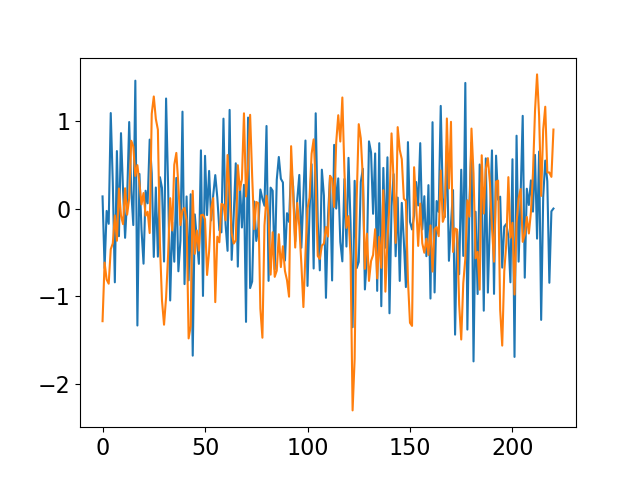

In [365]:
pl.figure()
num=1000
pl.plot(arno[num].T)
pl.plot(curr_tc[num] -pred[num])

In [291]:
vis_res.prf_models['Norm_abcd'].stimulus.dx = 1#vis_res.prf_models['Norm_abcd'].stimulus.screen_size_degrees/vis_res.prf_models['Norm_abcd'].stimulus.design_matrix.shape[0]

In [ ]:
pred = vis_res.prf_models['Norm_abcd'].return_prediction(*list(params[:,:-1].T))-params[:,4][...,np.newaxis]
pl.figure()
noisy_gauss_pred = np.zeros_like(pred)
#for l in range(pred.shape[0]):
    #print(pred[l].var())
    #noisy_gauss_pred[l] = pred[l] + (np.random.normal(0,0.66*(pred[l].var())**0.5,len(pred[l])))
noisy_gauss_pred = pred +arno
#pl.plot(noisy_gauss_pred.T)
pl.plot(noisy_gauss_pred[-100:].T)

<IPython.core.display.Javascript object>


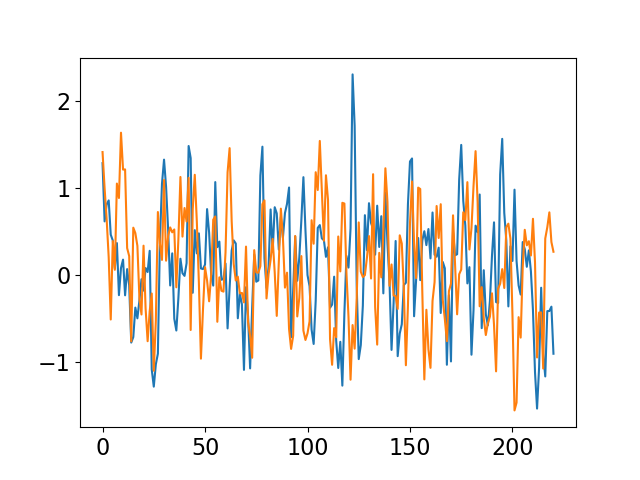

In [138]:
from scipy.fft import rfft, irfft, fft, ifft

def phaseScrambleTS(ts):
    """Returns a TS: original TS power is preserved; TS phase is shuffled."""
    fs = fft(ts)
    pow_fs = np.abs(fs) ** 2.
    phase_fs = np.angle(fs)
    phase_fsr = phase_fs.copy()

    if len(ts) % 2 == 0:
        phase_fsr_lh = phase_fsr[1:len(phase_fsr)/2]
    else:
        phase_fsr_lh = phase_fsr[1:int((len(phase_fsr)+1)/2)]
    np.random.shuffle(phase_fsr_lh)
    if len(ts) % 2 == 0:
        phase_fsr_rh = -phase_fsr_lh[::-1]
        phase_fsr = np.concatenate((np.array((phase_fsr[0],)), phase_fsr_lh,
                                    np.array((phase_fsr[len(phase_fsr)/2],)),
                                    phase_fsr_rh))
    else:
        phase_fsr_rh = -phase_fsr_lh[::-1]
        phase_fsr = np.concatenate((np.array((phase_fsr[0],)), phase_fsr_lh, phase_fsr_rh))
    fsrp = np.sqrt(pow_fs) * (np.cos(phase_fsr) + 1j * np.sin(phase_fsr))
    tsrp = ifft(fsrp)
    if not np.allclose(tsrp.imag, np.zeros(tsrp.shape)):
        max_imag = (np.abs(tsrp.imag)).max()
        imag_str = '\nNOTE: a non-negligible imaginary component was discarded.\n\tMax: {}'
        print(imag_str.format(max_imag))
    return tsrp.real

pl.figure()
pl.plot(resid[1000])
pl.plot(phaseScrambleTS(resid[1000]))

In [129]:
pred = vis_res.prf_models['Gauss'].return_prediction(*list(params_gauss[:,:-1].T))-params_gauss[:,4][...,np.newaxis]

In [130]:
from prfpy.timecourse import generate_arima_noise
ppp = []
#resid = pred-curr_tc
for i in range(20):
    arno = 0.3*(((1/params_gauss[:,-1]**2.5)*pred.var(-1))**0.5)[...,np.newaxis] * generate_arima_noise(ar=(1, 0.4),
                         ma=(1, 0.0),
                            dimensions=pred.shape)
    noisy_gauss_pred = pred + arno

#     ran_resid = resid[np.random.randint(0,22665,22665)]
#     noisy_gauss_pred = pred + ran_resid

#     for p in range(22665):
#         noisy_gauss_pred[p] = pred[p] + phaseScrambleTS(resid[p])
        

    ppp.append(noisy_gauss_pred)
noisy_comb_pred = np.concatenate(ppp,axis=0)

/Users/marcoaqil/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in power
  """


In [131]:
noisy_comb_pred[np.isnan(noisy_comb_pred)] = 0
np.save('/Users/marcoaqil/param_recov/sub-006_timecourse_space-fsnative-arimarsq-gauss2.npy',noisy_comb_pred)

In [352]:
#refit results real data quick read
curr_alpha = (vis_res.main_dict['fsnative']['fit-task-2R_fit-runs-all']['sub-006']['Processed Results']['Alpha']['Norm_abcd']>0.3)
ress_dict = dict()
ress_dict_norm = dict()
for curr_roi in ['custom.V1', 'custom.V2', 'custom.V3','custom.V3AB','custom.hV4','custom.LO','custom.TO','custom.VO','custom.IPS']:
    curr_roi_mask = (roi_mask(vis_res.idx_rois['sub-006'][curr_roi], curr_alpha)) 
    all_roi_mask += curr_roi_mask.astype('bool')
    all_params_norm = np.zeros((curr_roi_mask.shape[0],10))
    all_params_norm[np.load('/Users/marcoaqil/param_recov/sub-006_mask_space-fsnative2021-08-02-16-12-05.npy'),:] = np.copy(np.load('/Users/marcoaqil/param_recov/sub-006_iterparams-norm_space-fsnative2021-08-02-16-12-05.npy'))

    ress_dict_norm[curr_roi] = all_params_norm[curr_roi_mask]

In [83]:
np.max(vis_res.main_dict['fsnative']['fit-task-2R_fit-runs-all']['sub-006']['Processed Results']['Norm Param. D']['Norm_abcd'][vis_res.main_dict['fsnative']['fit-task-2R_fit-runs-all']['sub-006']['mask']] - vis_res.main_dict['fsnative']['fit-task-2R_fit-runs-all']['sub-006']['Results']['Norm_abcd'][:,8])

0.0

In [90]:
np.max(vis_res.main_dict['fsnative']['fit-task-2R_fit-runs-all']['sub-006']['Processed Results']['Norm Param. D']['Norm_abcd'][all_roi_mask] - params[:,8])

0.0

In [107]:
np.max(vis_res.main_dict['fsnative']['fit-task-2R_fit-runs-all']['sub-006']['Processed Results']['Norm Param. D']['Norm_abcd'][(roi_mask(vis_res.idx_rois['sub-006']['custom.V1'], curr_alpha)) ] - ress_dict_norm['custom.V1'][:,8]) 

0.0

In [8]:
#output for b-d-gauss amplitude analysis ('all' for earlie results)
curr_alpha = (vis_res.main_dict['fsnative']['fit-task-2R_fit-runs-all']['sub-006']['Processed Results']['Alpha']['Norm_abcd']>0.3)
ress_dict = dict()
ress_dict_norm = dict()
ress_dict_css = dict()
ress_dict_dog = dict()
all_roi_mask = np.zeros_like(curr_alpha).astype('bool')
for curr_roi in ['custom.V1', 'custom.V2', 'custom.V3','custom.V3AB','custom.hV4','custom.LO','custom.TO','custom.VO','custom.IPS']:
    curr_roi_mask = (roi_mask(vis_res.idx_rois['sub-006'][curr_roi], curr_alpha))
    
    all_roi_mask += curr_roi_mask.astype('bool')
    
    all_params = np.zeros((curr_roi_mask.shape[0],6))
    all_params[vis_res.main_dict['fsnative']['fit-task-2R_fit-runs-all']['sub-006']['mask'],:] = np.copy(vis_res.main_dict['fsnative']['fit-task-2R_fit-runs-all']['sub-006']['Results']['Gauss'])

    ress_dict[curr_roi] = all_params[curr_roi_mask]
    
    all_params_norm = np.zeros((curr_roi_mask.shape[0],10))
    all_params_norm[vis_res.main_dict['fsnative']['fit-task-2R_fit-runs-all']['sub-006']['mask'],:] = np.copy(vis_res.main_dict['fsnative']['fit-task-2R_fit-runs-all']['sub-006']['Results']['Norm_abcd'])

    ress_dict_norm[curr_roi] = all_params_norm[curr_roi_mask]

    all_params_css = np.zeros((curr_roi_mask.shape[0],7))
    all_params_css[vis_res.main_dict['fsnative']['fit-task-2R_fit-runs-all']['sub-006']['mask'],:] = np.copy(vis_res.main_dict['fsnative']['fit-task-2R_fit-runs-all']['sub-006']['Results']['CSS'])

    ress_dict_css[curr_roi] = all_params_css[curr_roi_mask]

    all_params_dog = np.zeros((curr_roi_mask.shape[0],8))
    all_params_dog[vis_res.main_dict['fsnative']['fit-task-2R_fit-runs-all']['sub-006']['mask'],:] = np.copy(vis_res.main_dict['fsnative']['fit-task-2R_fit-runs-all']['sub-006']['Results']['DoG'])

    ress_dict_dog[curr_roi] = all_params_dog[curr_roi_mask]

params = np.copy(all_params_norm[all_roi_mask])
params_gauss = np.copy(all_params[all_roi_mask])   
params_css = np.copy(all_params_css[all_roi_mask])
params_dog = np.copy(all_params_dog[all_roi_mask])   

In [9]:
tc = np.zeros((curr_roi_mask.shape[0],221))
for n in range(6):

    msk = np.load(f'/Volumes/Crucial X8/PRFMapping/PRFMapping-Deriv-hires/prfpy/FS7_results/timecourses/sub-006_mask_space-fsnative_task-2R_run-{n}.npy')
    tc[msk] += np.load(f'/Volumes/Crucial X8/PRFMapping/PRFMapping-Deriv-hires/prfpy/FS7_results/timecourses/sub-006_timecourse_space-fsnative_task-2R_run-{n}.npy')
    
tc /= 6
tc -= 100

curr_tc = tc[all_roi_mask]

In [55]:
#output for b-d-gauss amplitude analysis ('all' for earlie results) all analyses
# curr_alpha = (vis_res.main_dict['fsnative']['fit-task-2R_fit-runs-all']['sub-006']['Processed Results']['Alpha']['Norm_abcd']>0.3)
# ress_dict = dict()
# ress_dict_norm = dict()
# all_roi_mask = np.zeros_like(curr_alpha).astype('bool')
# for curr_roi in ['custom.V1', 'custom.V2', 'custom.V3','custom.V3AB','custom.hV4','custom.LO','custom.TO','custom.VO','custom.IPS']:
#     curr_roi_mask = (roi_mask(vis_res.idx_rois['sub-006'][curr_roi], curr_alpha))
    
#     all_roi_mask += curr_roi_mask.astype('bool')
    
#     all_params = np.zeros((curr_roi_mask.shape[0],6))
#     for an in vis_res.main_dict['fsnative']:
#         all_params[vis_res.main_dict['fsnative'][an]['sub-006']['mask'],:] += np.copy(vis_res.main_dict['fsnative'][an]['sub-006']['Results']['Gauss'])
    
#     ress_dict[curr_roi] = all_params[curr_roi_mask]/5
    
#     all_params_norm = np.zeros((curr_roi_mask.shape[0],10))
#     for an in vis_res.main_dict['fsnative']:
#         all_params_norm[vis_res.main_dict['fsnative'][an]['sub-006']['mask'],:] += np.copy(vis_res.main_dict['fsnative'][an]['sub-006']['Results']['Norm_abcd'])

#     ress_dict_norm[curr_roi] = all_params_norm[curr_roi_mask]/5
    
# params = np.copy(all_params_norm[all_roi_mask])   

# Pycortex colormaps stuff

In [36]:
from matplotlib import pyplot as plt
from matplotlib.colors import Normalize

cmap = plt.imread('/Users/marcoaqil/pycortex/filestore/colormaps/nipy_spectral_2D_alpha_nofix.png')

vmin=1
vmax=99
vmin2=0.05
vmax2=0.6
data1=np.arange(100)
data2=np.linspace(0.01,1,100)

norm1 = Normalize(vmin, vmax)
norm2 = Normalize(vmin2, vmax2)

d1 = np.clip(norm1(data1), 0, 1)
d2 = np.clip(norm2(data2), 0, 1)
dim1 = np.round(d1 * (cmap.shape[1]-1))
# Nans in data seemed to cause weird interaction with conversion to uint32
dim1 = np.nan_to_num(dim1).astype(np.uint32) 
dim2 = np.round(d2 * (cmap.shape[0]-1))
dim2 = np.nan_to_num(dim2).astype(np.uint32)

colored = cmap[dim2.ravel(), dim1.ravel()]
# map r, g, b, a values between 0 and 255 to avoid problems with
# VolumeRGB when plotting flatmaps with quickflat
colored = (colored * 255).astype(np.uint8)
r, g, b, a = colored.T
r.shape = dim1.shape
g.shape = dim1.shape
b.shape = dim1.shape
a.shape = dim1.shape

<IPython.core.display.Javascript object>


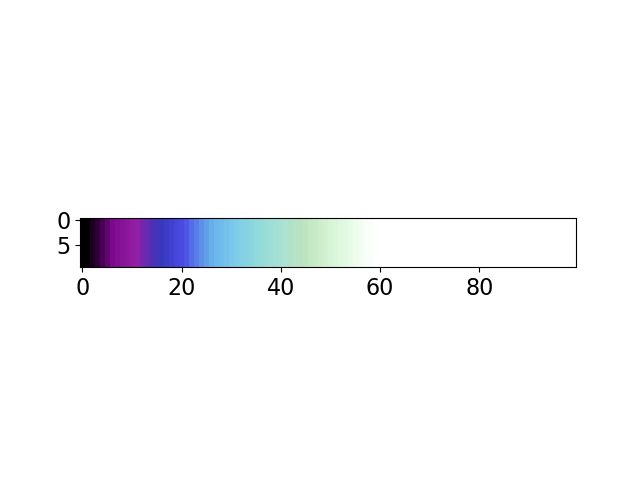

In [37]:
pl.imshow(np.tile(colored[np.newaxis,...],(10,1,1)), cmap='nipy_spectral')

In [22]:
import matplotlib.image as mpimg
spect = mpimg.imread('/Users/marcoaqil/pycortex/filestore/colormaps/RdBu_r_alpha.png')
resc = np.sum(spect[:,:,:3],axis=(0,2))
resc = (resc+resc.min())/(resc.max()+resc.min())*(0.9)+0.1
resc_2d = np.tile(resc,(256,1))
spect[:,:,-1]**=resc_2d
mpimg.imsave('/Users/marcoaqil/pycortex/filestore/colormaps/RdBu_r_alpha_fix.png',spect)

In [26]:
import matplotlib.image as mpimg
spect = mpimg.imread('/Users/marcoaqil/pycortex/filestore/colormaps/nipy_spectral_2D_alpha.png')
resc = np.sum(spect[:,:,:3],axis=(0,2))
resc = (resc+resc.min())/(resc.max()+resc.min())*(0.9)+0.1
resc_2d = np.tile(resc,(256,1))
spect[:,:,-1]**= (1/resc_2d)
mpimg.imsave('/Users/marcoaqil/pycortex/filestore/colormaps/nipy_spectral_2D_alpha_unfix.png',spect)

In [48]:
import matplotlib.image as mpimg
spect = mpimg.imread('/Users/marcoaqil/pycortex/filestore/colormaps/nipy_spectral_2D_alpha.png')
#resc = np.sum(spect[:,:,:3],axis=(0,2))
#resc = (resc+resc.min())/(resc.max()+resc.min())*(0.9)+0.1
#resc_2d = np.tile(resc,(256,1))
spect[:,:,-1] = 1
mpimg.imsave('/Users/marcoaqil/pycortex/filestore/colormaps/nipy_spectral_2D_constalpha.png',spect)

In [17]:
import matplotlib.image as mpimg
spect = mpimg.imread('/Users/marcoaqil/pycortex/filestore/colormaps/nipy_spectral_2D_alpha_nofix.png')
spect[-1,-1]

array([0.8, 0.8, 0.8, 0. ], dtype=float32)

# Define new parameters, Misc outputs

In [14]:
path = '/Volumes/Crucial X8/PRFMapping/PRFMapping-Deriv-hires/freesurfer/fsaverage/label/glasser'
for filename in os.listdir(path):
    os.rename(opj(path,filename), opj(path,filename.replace('lh.L','lh.glasser').replace('_ROI','').replace('rh.R','rh.glasser')))

In [280]:
#output stuf for decoding
curr_alpha = (vis_res.main_dict['fsnative']['fit-task-2R_fit-runs-5050CVmedian']['sub-006']['Processed Results']['Alpha']['Norm_abcd']>0.3)
V1_mask = (roi_mask(vis_res.idx_rois['sub-006']['custom.V1'], curr_alpha)) 
#np.save('/Users/marcoaqil/V1_mask.npy', V1_mask)
V1_mask.shape

all_params = np.zeros((V1_mask.shape[0],6))
all_params[vis_res.main_dict['fsnative']['fit-task-2R_fit-runs-5050CVmedian']['sub-006']['mask'],:] = np.copy(vis_res.main_dict['fsnative']['fit-task-2R_fit-runs-5050CVmedian']['sub-006']['Results']['Gauss'])

V1_params = all_params[V1_mask]

np.save('/Users/marcoaqil/V1_params_gauss.npy', V1_params)

#vis_res.prf_models['Norm_abcd']

with open('/Users/marcoaqil/Gauss_2R_prf_model.pickle', 'wb') as handle:
     dill.dump(vis_res.prf_models['Gauss'], handle)

In [83]:
for space, space_res in vis_res.main_dict.items(): 
    print(space)
    if space == 'fsnative':
        for analysis, analysis_res in space_res.items():
            print(analysis)
            if '2R' in analysis:
                for subj, subj_res in analysis_res.items():
                    print(subj)
                    if 'sub-006' in subj:
                        for param, param_res in subj_res['Processed Results'].items():
                            for model, model_res in param_res.items():
                                if 'Norm_abcd' in model and '/' not in param:
                                    np.save(f'/Volumes/Crucial X8/{subj}_{param}.npy', model_res)

fsnative
fit-task-1R_fit-runs-all
fit-task-1S_fit-runs-all
fit-task-2R_fit-runs-all
sub-001
sub-002
sub-003
sub-004
sub-005
sub-006
sub-007
fit-task-4F_fit-runs-all
fit-task-4R_fit-runs-all
fsaverage


In [8]:
from sklearn.linear_model import LinearRegression
for space, space_res in vis_res.main_dict.items(): 
    print(space)
    if space == 'fsnative' or space == 'HCP':
        for analysis, analysis_res in space_res.items():
            print(analysis)
            for subj, subj_res in analysis_res.items():
                print(subj)
                for model in ['Gauss', 'DoG', 'CSS', 'Norm_abcd']:
                    #subj_res['Processed Results']['Size (sigma_1)'][model] = np.zeros(subj_res['mask'].shape)
                    #subj_res['Processed Results']['Size (sigma_1)'][model][subj_res['mask']] = np.copy(subj_res['Results'][model][:,2])
                    if model in ['CSS']:
                        #WLS = LinearRegression()
                        #WLS.fit(subj_res['Processed Results']['Norm Param. D'][model].reshape(-1,1), subj_res['Processed Results']['CSS Exponent']['CSS'], )
                        ##subj_res['Processed Results']['Size (sigma_2)'][model] = np.zeros(subj_res['mask'].shape)
                        #[subj_res['mask']] unmasked for HCP
                        ##subj_res['Processed Results']['Size (sigma_2)'][model] = np.copy(subj_res['Results'][model][:,6])
                        subj_res['Processed Results']['RSq'][model][subj_res['Processed Results']['CSS Exponent'][model]<0] = 0

                        #subj_res['Processed Results']['B(1/(Cpis_2**2+D)-1/D)'][model] = np.zeros(subj_res['mask'].shape)
                        #subj_res['Processed Results']['B(1/(Cpis_2**2+D)-1/D)'][model][subj_res['mask']] =  subj_res['Results'][model][:,7]*(1/(subj_res['Results'][model][:,5]*np.pi*subj_res['Results'][model][:,6]**2+subj_res['Results'][model][:,8])-1/subj_res['Results'][model][:,8])

                        
# (A+B)/(C+D)  ((actual response at point stim in prf centre))
# ————————----------
# (A*2pi*s_1**2+B)/((C*2pi*s_2**2+D)  ((actual full response)

# subj_res['Processed Results']['Min/Max Response Ratio (with BD)'][model][subj_res['mask']] = ((subj_res['Results'][model][:,3]+subj_res['Results'][model][:,7])/(subj_res['Results'][model][:,8] + subj_res['Results'][model][:,5])-subj_res['Results'][model][:,7]/subj_res['Results'][model][:,8])/((subj_res['Results'][model][:,3]*2*np.pi*subj_res['Results'][model][:,2]**2+subj_res['Results'][model][:,7])/(subj_res['Results'][model][:,8] + subj_res['Results'][model][:,5]*2*np.pi*subj_res['Results'][model][:,6]**2)-subj_res['Results'][model][:,7]/subj_res['Results'][model][:,8])


#'Size ratio (sigma_2/sigma_1)'#C/A#'B/A'#'D/C'#'D/A'#'B/C'#'Surround volume (full)'#'Centre volume (full)'
#'(A+B)/(C+D)'#'(A*B)/(C*D)'#'(A*D)/(C*B)'#'(A+D)/(C+B)'#'Point-stim derivative'#'(C(A+B))/(A(C+D))'
#'Min/Max Response Ratio'#'Max/Min Response Ratio'#A(C+D)/C(A+B)#Min/Max Response Ratio (with BD)'
#(As_1**2+B)/(Cs_2**2+D)#(As_1**2+B)/(Cs_2**2+D)-B/D#(AD-BC)/D**2 (deriv at 0)
#'A/C'#D/B#D*sigma_2/sigma_1#(D*sigma_2)/(B*sigma_1)#(Cs_2**2+D)/(As_1**2+B)#(B*sigma_1)/(D*sigma_2)
#B/D**2#'B(1/(Cpis_2**2+D)-1/D)'
###DoG
#'Surround volume (full)'
#'Surround/Centre Amplitude' 
#'Surround-Centre Amplitude'
#'Surround-Centre Volume'

#min/max and max/min done without -B/D


fsnative
fit-task-1R_fit-runs-all
sub-001
sub-002
sub-003
sub-004
sub-005
sub-006
sub-007
fit-task-1S_fit-runs-all
sub-001
sub-002
sub-003
sub-004
sub-005
sub-006
sub-007
fit-task-2R_fit-runs-all
sub-001
sub-002
sub-003
sub-004
sub-005
sub-006
sub-007
fit-task-4F_fit-runs-all
sub-001
sub-002
sub-003
sub-004
sub-005
sub-006
sub-007
fit-task-4R_fit-runs-all
sub-001
sub-002
sub-003
sub-004
sub-005
sub-006
sub-007
fsaverage


In [ ]:
for space, space_res in vis_res.main_dict.items(): 
    print(space)
    if space == 'fsnative':
        for analysis, analysis_res in space_res.items():
            print(analysis)
            an_info = analysis_res['sub-001']['analysis_info']
            prf_stim = create_full_stim(screenshot_paths=[opj(an_info['timecourse_folder'],f'task-{task}_screenshots') for task in an_info['task_names']],
                                n_pix=an_info['n_pix'],
                                discard_volumes=an_info['discard_volumes'],
                                baseline_volumes_begin_end=an_info['baseline_volumes_begin_end'],
                                dm_edges_clipping=an_info['dm_edges_clipping'],
                                screen_size_cm=an_info['screen_size_cm'],
                                screen_distance_cm=an_info['screen_distance_cm'],
                                TR=an_info['TR'],
                                task_names=an_info['task_names'])               
            for subj, subj_res in analysis_res.items():
                print(subj)
                for model in ['DoG']:

                    gg = model_wrapper(model,
                                       stimulus=prf_stim,
                                       hrf=an_info['hrf'],
                                       filter_predictions=an_info['filter_predictions'],
                                       filter_type=an_info['filter_type'],
                                       filter_params={x:an_info[x] for x in ["first_modes_to_remove",
                                                                             "last_modes_to_remove_percent",
                                                                             "window_length",
                                                                             "polyorder",
                                                                             "highpass",
                                                                             "add_mean"]},
                                       normalize_RFs=an_info['normalize_RFs'])
                    surround_area_ratio = []
                    for vertex in range(subj_res['Results'][model].shape[0]):
                        params = subj_res['Results'][model][vertex,:-1]
                        pred = gg.return_prediction(*list(params))[0] - 100                        
                        surround_area_ratio.append(np.abs(pred[pred<0].sum()/pred[pred>0].sum()))
                        
                    subj_res['Processed Results']['Timecourse Neg/Pos Area Ratio'][model] = np.zeros(subj_res['mask'].shape)
                    subj_res['Processed Results']['Timecourse Neg/Pos Area Ratio'][model][subj_res['mask']] =  np.copy(surround_area_ratio)

In [18]:
timecourse_folder = '/Volumes/Crucial X8/PRFMapping/PRFMapping-Deriv-hires/prfpy/FS7_results/timecourses'
for space, space_res in vis_res.main_dict.items(): 
    print(space)
    if space == 'fsnative':
        for analysis, analysis_res in space_res.items():
            print(analysis)       
            for subj, subj_res in analysis_res.items():
                an_info = analysis_res[subj]['analysis_info']
                print(subj)
                tc_paths = [str(path) for path in sorted(Path(timecourse_folder).glob(f"{subj}_timecourse_space-{an_info['fitting_space']}_task-*_run-*.npy"))]    
                mask_paths = [tc_path.replace('timecourse_','mask_') for tc_path in tc_paths]
                #all_task_names = np.unique(np.array([elem.replace('task-','') for path in tc_paths for elem in path.split('_')  if 'task' in elem]))
                all_runs = np.unique(np.array([int(elem.replace('run-','').replace('.npy','')) for path in tc_paths for elem in path.split('_')  if 'run' in elem]))
    
                tc = dict()
                preds = dict()
                
                for task in an_info['task_names']:
                    if task not in vis_res.prf_stims:
                        vis_res.prf_stims[task] = create_full_stim(screenshot_paths=[opj(timecourse_folder,f'task-{task}_screenshots')],
                                n_pix=an_info['n_pix'],
                                discard_volumes=an_info['discard_volumes'],
                                baseline_volumes_begin_end=an_info['baseline_volumes_begin_end'],
                                dm_edges_clipping=an_info['dm_edges_clipping'],
                                screen_size_cm=an_info['screen_size_cm'],
                                screen_distance_cm=an_info['screen_distance_cm'],
                                TR=an_info['TR'],
                                task_names=[task])                    
                    
                                    

                    gg = model_wrapper('Norm_abcd',
                                       stimulus=vis_res.prf_stims[task],
                                       hrf=an_info['hrf'],
                                       filter_predictions=an_info['filter_predictions'],
                                       filter_type=an_info['filter_type'],
                                       filter_params={x:an_info[x] for x in ["first_modes_to_remove",
                                                                             "last_modes_to_remove_percent",
                                                                             "window_length",
                                                                             "polyorder",
                                                                             "highpass",
                                                                             "add_mean"]},
                                       normalize_RFs=an_info['normalize_RFs'])
                    
                    
                    tc_runs=[]
                    
                    for run in all_runs:
                        mask_run = [np.load(mask_path) for mask_path in mask_paths if task in mask_path and f"run-{run}" in mask_path][0]
                        #masked_idx = np.sum(mask_run[:index])
                        
                        tc_run = [np.load(tc_path) for tc_path in tc_paths if task in tc_path and f"run-{run}" in tc_path][0]
                        
                        tc_run *= (100/tc_run.mean(-1))[...,np.newaxis]
                        tc_run += (tc_run.mean(-1)-np.median(tc_run[...,vis_res.prf_stims[task].late_iso_dict[task]], axis=-1))[...,np.newaxis]
                        
                        tc_runs.append(np.zeros((mask_run.shape[0],tc_run.shape[-1])))
                        tc_runs[-1][mask_run] = tc_run
                        
                    tc[task] = np.mean(tc_runs, axis=0)-100
                    
                    params = subj_res['Results']['Norm_abcd']
                    preds[task] =  gg.return_prediction(*list(params[:,:-1].T)) - 100              
                    
                
                tc_mean = np.mean(tc[task][subj_res['mask']], axis=-1)
                tc_max = np.max(tc[task][subj_res['mask']], axis=-1)
                
                tc_max_model = tc[task][subj_res['mask'],np.argmax(preds[task], axis=-1)]
                
                subj_res['Processed Results']['Analysis Timecourse Stats']['Mean'] = np.zeros(subj_res['mask'].shape)
                subj_res['Processed Results']['Analysis Timecourse Stats']['Mean'][subj_res['mask']] =  np.copy(tc_mean)
                subj_res['Processed Results']['Analysis Timecourse Stats']['Max (absolute)'] = np.zeros(subj_res['mask'].shape)
                subj_res['Processed Results']['Analysis Timecourse Stats']['Max (absolute)'][subj_res['mask']] =  np.copy(tc_max)
                subj_res['Processed Results']['Analysis Timecourse Stats']['Max (model-based)'] = np.zeros(subj_res['mask'].shape)
                subj_res['Processed Results']['Analysis Timecourse Stats']['Max (model-based)'][subj_res['mask']] =  np.copy(tc_max_model)

fsnative
fit-task-1R_fit-runs-all
sub-001


/Users/marcoaqil/prfpy/prfpy/rf.py:112: RuntimeWarning: divide by zero encountered in true_divide
  return np.exp(-((x-mu[0])**2 + (y-mu[1])**2)/(2*sigma**2))
/Users/marcoaqil/prfpy/prfpy/model.py:515: RuntimeWarning: divide by zero encountered in true_divide
  (srf_amplitude[..., np.newaxis] * stimulus_through_prf(srf, dm) + surround_baseline[..., np.newaxis]) \
/Users/marcoaqil/prfpy/prfpy/model.py:515: RuntimeWarning: invalid value encountered in true_divide
  (srf_amplitude[..., np.newaxis] * stimulus_through_prf(srf, dm) + surround_baseline[..., np.newaxis]) \
/Users/marcoaqil/prfpy/prfpy/model.py:516: RuntimeWarning: invalid value encountered in true_divide
  - neural_baseline[..., np.newaxis]/surround_baseline[..., np.newaxis]


sub-002
sub-003
sub-004
sub-005
sub-006
sub-007
fit-task-1S_fit-runs-all
sub-001
Design matrix completed
sub-002
sub-003
sub-004
sub-005
sub-006
sub-007
fit-task-2R_fit-runs-all
sub-001
Design matrix completed
sub-002
sub-003
sub-004
sub-005
sub-006
sub-007
fit-task-4F_fit-runs-all
sub-001
Design matrix completed
sub-002
sub-003
sub-004
sub-005
sub-006
sub-007
fit-task-4R_fit-runs-all
sub-001
Design matrix completed
sub-002
sub-003
sub-004
sub-005
sub-006
sub-007
fsaverage


In [345]:
vis_res.main_dict['fsaverage'].keys()

dict_keys(['fit-task-1R_fit-runs-all', 'fit-task-1S_fit-runs-all', 'fit-task-2R_fit-runs-all', 'fit-task-4F_fit-runs-all', 'fit-task-4R_fit-runs-all', 'Mean analysis'])

In [25]:
vis_res.idx_rois['fsaverage_hcp1sthalf'] = deepcopy(vis_res.idx_rois['fsaverage'])
vis_res.idx_rois['fsaverage_hcp2ndhalf'] = deepcopy(vis_res.idx_rois['fsaverage'])


#for model in vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage']['Processed Results']['RSq']:
#    vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage_wrsq']['Processed Results']['RSq'][model] = deepcopy(vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage']['Processed Results']['RSq'][model])
    
    
    
vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage_hcp1sthalf']['Processed Results']['Receptor Maps'] = deepcopy(vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage']['Processed Results']['Receptor Maps'])
vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage_hcp2ndhalf']['Processed Results']['Receptor Maps'] = deepcopy(vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage']['Processed Results']['Receptor Maps'])


for key in vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['100610']['Processed Results'].keys():
    print(key)
    if key not in ['Alpha']:        
        for model in vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['100610']['Processed Results'][key]:
            fsaverage_param = dict()
            if key == 'RSq':
                fsaverage_rsq = dict()
            for sid in vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'].keys(): #########
                if 'fsaverage' not in sid:
                    fsaverage_param[sid] = deepcopy(vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][sid]['Processed Results'][key][model])
                    if key == 'RSq':
                        fsaverage_rsq[sid] = deepcopy(vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][sid]['Processed Results'][key][model])
            
            first_half = list(fsaverage_param.keys())[::2]
            second_half = list(fsaverage_param.keys())[1::2]

            if key == 'RSq':
                vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage_hcp1sthalf']['Processed Results'][key][model] = np.nanmean([fsaverage_rsq[sid] for sid in first_half], axis=0)   
                vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage_hcp2ndhalf']['Processed Results'][key][model] = np.nanmean([fsaverage_rsq[sid] for sid in second_half], axis=0)   

            else:

                data = np.array([fsaverage_param[sid] for sid in first_half])
                weights = np.array([fsaverage_rsq[sid] for sid in first_half])            
                vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage_hcp1sthalf']['Processed Results'][key][model] = (data*weights).sum(0)/weights.sum(0)
            
                data = np.array([fsaverage_param[sid] for sid in second_half])
                weights = np.array([fsaverage_rsq[sid] for sid in second_half])            
                vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage_hcp2ndhalf']['Processed Results'][key][model] = (data*weights).sum(0)/weights.sum(0)            

                
for analysis, analysis_res in vis_res.main_dict['fsaverage'].items():
    for subj, subj_res in analysis_res.items():
        if subj in ['fsaverage_hcp1sthalf', 'fsaverage_hcp2ndhalf']:
            for model in subj_res['Processed Results']['RSq']:
                if 'x_pos' in subj_res['Processed Results'] and 'y_pos' in subj_res['Processed Results']:
                    subj_res['Processed Results']['Polar Angle'][model] = np.arctan2(subj_res['Processed Results']['y_pos'][model],subj_res['Processed Results']['x_pos'][model])
                    subj_res['Processed Results']['Eccentricity'][model] = np.sqrt(subj_res['Processed Results']['y_pos'][model]**2+subj_res['Processed Results']['x_pos'][model]**2)
                if 'Size (sigma_1)' in subj_res['Processed Results'] and 'Size (sigma_2)' in subj_res['Processed Results']:
                    subj_res['Processed Results']['Size ratio (sigma_2/sigma_1)'][model] = subj_res['Processed Results']['Size (sigma_2)'][model]/subj_res['Processed Results']['Size (sigma_1)'][model]

                if 'Norm Param. B' in subj_res['Processed Results'] and 'Norm Param. D' in subj_res['Processed Results']:
                    subj_res['Processed Results']['Ratio (B/D)'][model] = subj_res['Processed Results']['Norm Param. B'][model]/subj_res['Processed Results']['Norm Param. D'][model]


RSq
Eccentricity


/var/folders/vb/gdqfj5px0gb7r_bgl5hpf8n00000gn/T/ipykernel_29516/1120089407.py:38: RuntimeWarning: invalid value encountered in true_divide
  vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage_hcp1sthalf']['Processed Results'][key][model] = (data*weights).sum(0)/weights.sum(0)
/var/folders/vb/gdqfj5px0gb7r_bgl5hpf8n00000gn/T/ipykernel_29516/1120089407.py:42: RuntimeWarning: invalid value encountered in true_divide
  vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage_hcp2ndhalf']['Processed Results'][key][model] = (data*weights).sum(0)/weights.sum(0)


Polar Angle
Size ratio (sigma_2/sigma_1)
Norm Param. B
Norm Param. D
Size (sigma_1)
Size (sigma_2)
Amplitude
Surround Amplitude
Size (fwhmax)
Surround Size (fwatmin)
Alpha
x_pos
y_pos


In [175]:
vis_res.idx_rois['fsaverage_median'] = deepcopy(vis_res.idx_rois['fsaverage'])


vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage_median']['Processed Results']['Receptor Maps'] = deepcopy(vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage']['Processed Results']['Receptor Maps'])


for key in vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['100610']['Processed Results'].keys():
    if key not in ['Alpha']:        
        for model in vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['100610']['Processed Results'][key]:
            fsaverage_param = dict()
            for sid in vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'].keys(): #########
                if 'fsaverage' not in sid:
                    fsaverage_param[sid] = deepcopy(vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][sid]['Processed Results'][key][model])
            
            
            vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage_median']['Processed Results'][key][model] = np.nanmedian([fsaverage_param[sid] for sid in fsaverage_param], axis=0)   
            
        

/Users/marcoaqil/anaconda3/envs/prfpy_2021/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


In [7]:
#allall, allruns_sepcond_rsqwm, 5050CV, allruns_sepcond_zsc, HCP_181subjects_rsqwm, HCP_999999
with open('/Volumes/Crucial X8/fix_maindict_HCP_999999.pickle', 'rb') as handle:
    dict_99=dill.load(handle)

In [7]:
vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage']['Processed Results'].keys()

dict_keys(['RSq', 'Eccentricity', 'Polar Angle', 'Size ratio (sigma_2/sigma_1)', 'Norm Param. B', 'Norm Param. D', 'Size (sigma_1)', 'Size (sigma_2)', 'Ratio (B/D)', 'Receptor Maps', 'Amplitude', 'Surround Amplitude', 'Size (fwhmax)', 'Surround Size (fwatmin)', 'Alpha', '5-HT1A', '5-HT1B', '5-HT2A', '5-HTT', '5-HT4', 'GABA_A', 'x_pos', 'y_pos'])

In [8]:
dict_99['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage']['Processed Results'].keys()

dict_keys(['RSq', 'x_pos', 'y_pos', 'Norm Param. B', 'Norm Param. D', 'Amplitude', 'Surround Amplitude', 'Size (fwhmax)', 'Surround Size (fwatmin)', 'Size (sigma_1)', 'Size (sigma_2)', 'Polar Angle', 'Eccentricity', 'Size ratio (sigma_2/sigma_1)', 'Ratio (B/D)', 'Receptor Maps', 'Alpha'])

In [8]:
dict_99_181 = deepcopy(dict_99)

In [9]:
for key in dict_99_181['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage']['Processed Results'].keys():
    if key not in ['RSq','Alpha','Receptor Maps']:
        for model in  dict_99_181['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage']['Processed Results'][key]:
            
            sj_99_param = dict_99['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage']['Processed Results'][key][model]
            sj_99_rsq = dict_99['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage']['Processed Results']['RSq'][model]
            hcp_181_param = vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage']['Processed Results'][key][model]
            hcp_181_rsq = vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage']['Processed Results']['RSq'][model]
            
            dict_99_181['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage']['Processed Results'][key][model] = (sj_99_param*sj_99_rsq+hcp_181_param*hcp_181_rsq)/(sj_99_rsq+hcp_181_rsq)
            dict_99_181['fsaverage']['fit-task-BAR_fit-runs-all']['fsaverage']['Processed Results']['RSq'][model] = (sj_99_rsq+hcp_181_rsq)/2
            

In [29]:
#cleaning useless analysis_settings files which mess up combine results
results_folder = '/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/prfpy/crossvalidated_tc'
for filename in os.listdir(results_folder):
    if 'analysis' in filename:
        with open(opj(results_folder,filename)) as f:
            an_info = yaml.safe_load(f)
        if f"{filename[:6]}_mask_space-{an_info['fitting_space']}{an_info['analysis_time']}.npy" not in os.listdir(results_folder):
            if an_info["previous_analysis_time"] == '':
                os.remove(opj(results_folder,filename))

# Mean prediction vs mean timecourse rsq

In [23]:
#compute average predictions HCP
preds = np.zeros((118584,300))
preds_weighted = np.zeros((118584,300))
weights = np.zeros(118584)
counter = np.zeros(118584)
for space, space_res in vis_res.main_dict.items(): 
    print(space)
    if space == 'HCP':
        for analysis, analysis_res in space_res.items():
            print(analysis)
            an_info = analysis_res['100610']['analysis_info']
            
            prf_stim = create_full_stim(screenshot_paths=['/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/HCP_data/7T_RETBAR_small.hdf5'],
                                n_pix=an_info['n_pix'],
                                discard_volumes=an_info['discard_volumes'],
                                baseline_volumes_begin_end=an_info['baseline_volumes_begin_end'],
                                dm_edges_clipping=an_info['dm_edges_clipping'],
                                screen_size_cm=an_info['screen_size_cm'],
                                screen_distance_cm=an_info['screen_distance_cm'],
                                TR=an_info['TR'],
                                task_names=an_info['task_names'],
                                normalize_integral_dx=an_info['normalize_integral_dx'])       
            
            gg = model_wrapper('Norm_abcd',
                               stimulus=prf_stim,
                               hrf=an_info['hrf'],
                               filter_predictions=an_info['filter_predictions'],
                               filter_type=an_info['filter_type'],
                               filter_params={x:an_info[x] for x in ["first_modes_to_remove",
                                                                     "last_modes_to_remove_percent",
                                                                     "window_length",
                                                                     "polyorder",
                                                                     "highpass",
                                                                     "add_mean"]},
                               normalize_RFs=an_info['normalize_RFs'])
            #few_sjs = np.array(list(analysis_res.keys()))[np.random.randint(len(analysis_res.keys()),size=10)]
            for subj, subj_res in analysis_res.items():
                #if subj in few_sjs:
                print(subj)

                params = subj_res['Results']['Norm_abcd']
                mask = params[:,-1]>0
                curr_weights = params[mask,-1]

                sj_pred = gg.return_prediction(*list(params[mask,:-1].T))

                nan_mask = ((np.isnan(sj_pred).sum(-1)) == 0)
                print(np.sum(nan_mask))

                sj_pred[~nan_mask] = 0
                curr_weights[~nan_mask] = 0

                preds[mask] += sj_pred

                preds_weighted[mask] += (sj_pred * curr_weights[...,np.newaxis])
                
                counter[mask] += (curr_weights>0).astype(int)
                weights[mask] += curr_weights
                print(np.max(preds))
                print(np.max(weights))



preds[mask] /= counter[mask][...,np.newaxis]
preds_weighted[mask] /= weights[mask][...,np.newaxis]
np.save('/Volumes/Crucial X8/HCP_mean_preds.npy',preds)
np.save('/Volumes/Crucial X8/HCP_mean_preds_weighted.npy',preds_weighted)
np.save('/Volumes/Crucial X8/HCP_counter.npy',counter)
np.save('/Volumes/Crucial X8/HCP_totalweights.npy',weights)

HCP
fit-task-BAR_fit-runs-all
100610
27695
7.253134717819292
0.7038541494788828
102311
25746
12.159713732286708
1.2718000618280247
102816
40353
18.033215341445622
1.770422992536276
104416
34527
18.033215341445622
2.278992718920972
105923
27319
21.406078320617226
2.8275833760446396
108323
36636
27.20454173040362
3.5581187981091684
109123
34427
33.59192819589894
4.131453032033492
111312
53225
38.819625238514206
4.836504342458108
111514
31684
43.1800167544676
5.446333504886708
114823
38473
48.13615730851154
6.1227302262361505
115017
23705
51.25237409347637
6.703695495421765
115825
32562
56.781570711839876
7.069915600033216
116726
30019
62.931124270577946
7.717969766595998
118225
24617
64.6328713634201
8.34865265615557
125525
23835
66.80574289833129
8.864957055166611
126426
24947
72.5582680603106
9.401302565096755
128935
27096
77.45211105133262
9.937174009149619
130114
36950
82.02885599839834
10.692400153571743
130518
22474
85.2781616058836
11.207415174270984
131217
24168
91.12632157502972

13289
636.1366284243621
99.04921754403573
878877
23443
640.0662571051472
99.66560690483178
898176
23853
646.7661001261807
100.43215354982736
899885
31466
652.852859868706
101.18809876260283
901139
37231
658.0182514548585
101.82099535512303
901442
32415
661.4159086581819
102.044986626281
905147
30118
667.4519447487918
102.70398433730153
910241
36739
672.8532901091061
103.49055224874846
926862
34405
677.0762839546871
104.08579661160255
927359
35083
681.9748927742468
104.56550625372485
942658
25181
684.1770428645116
105.33334376667646
943862
21824
687.6577632486518
105.9436493176619
951457
36689
691.2636900667288
106.54984984511367
958976
29124
694.0050787065607
106.99614852861289
966975
30669
699.884751653874
107.6067998466185
971160
38159
701.8636148998643
108.12616960230432
973770
26071
705.0209835036545
108.64983876045468
995174
33882
709.1780644540481
109.01896210928268
fsaverage


In [6]:
mean_tc = np.load('/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/timecourses/355runs_mean.npy')
preds = np.load('/Volumes/Crucial X8/HCP_mean_preds.npy')
preds_weighted = np.load('/Volumes/Crucial X8/HCP_mean_preds_weighted.npy')

In [7]:
hcp_atlas_mask_path = ['/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/HCP_data/atlas/L.atlasroi.59k_fs_LR.shape.gii',
                          '/Volumes/Crucial X8/PRFMapping/PRFMapping-HCP/HCP_data/atlas/R.atlasroi.59k_fs_LR.shape.gii']
f=nb.load(hcp_atlas_mask_path[0])
data_1 = np.array([arr.data for arr in f.darrays])[0].astype('bool')

f=nb.load(hcp_atlas_mask_path[1])
data_2 = np.array([arr.data for arr in f.darrays])[0].astype('bool')

lh_data = np.zeros((data_1.shape[0], mean_tc.shape[1]), dtype=mean_tc.dtype)
rh_data = np.zeros((data_2.shape[0], mean_tc.shape[1]), dtype=mean_tc.dtype)


lh_data[data_1] = mean_tc[:np.sum(data_1)]
rh_data[data_2] = mean_tc[np.sum(data_1):(np.sum(data_1) + np.sum(data_2))]

resample = np.concatenate((lh_data,rh_data))

In [8]:
rsq_weighted_preds = 1-((preds_weighted - resample)**2).sum(-1)/(resample.shape[-1]*resample.var(-1))
rsq_preds = 1-((preds - resample)**2).sum(-1)/(resample.shape[-1]*resample.var(-1))

rsq_preds[(rsq_preds<0) | np.isnan(rsq_preds)] = 0
rsq_weighted_preds[(rsq_weighted_preds<0) | np.isnan(rsq_weighted_preds)] = 0

/var/folders/vb/gdqfj5px0gb7r_bgl5hpf8n00000gn/T/ipykernel_29516/3034470323.py:1: RuntimeWarning: invalid value encountered in true_divide
  rsq_weighted_preds = 1-((preds_weighted - resample)**2).sum(-1)/(resample.shape[-1]*resample.var(-1))
/var/folders/vb/gdqfj5px0gb7r_bgl5hpf8n00000gn/T/ipykernel_29516/3034470323.py:2: RuntimeWarning: invalid value encountered in true_divide
  rsq_preds = 1-((preds - resample)**2).sum(-1)/(resample.shape[-1]*resample.var(-1))


<IPython.core.display.Javascript object>


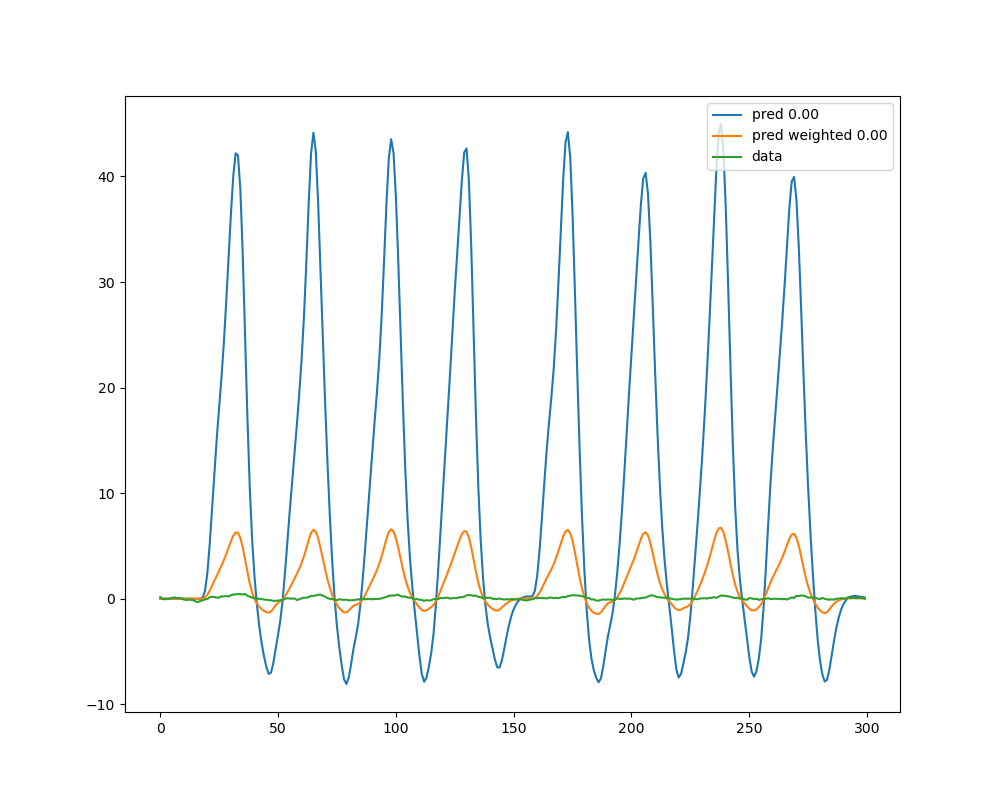

In [9]:
pl.figure(figsize=(10,8))
idxx = np.argsort((rsq_preds+rsq_weighted_preds)/2)[::-1]
idx = idxx[20000]
pl.plot(preds[idx], label=f'pred {rsq_preds[idx]:.2f}')
pl.plot(preds_weighted[idx], label=f'pred weighted {rsq_weighted_preds[idx]:.2f}')
pl.plot(resample[idx], label='data')
pl.legend()

In [10]:
vmin=0.4
vmax=0.8
pycortex_subj = '999999'
pycortex_cmap = 'jet'
ds_rsq = dict()
for rsq_thresh in [0]:
    

    ds_rsq[f'rsq_preds ({rsq_thresh:.2f} thresh)'] = Vertex2D_fix(rsq_preds, rsq_preds, subject=pycortex_subj, 
                                    vmin=vmin, vmax=vmax, vmin2=rsq_thresh, vmax2=vmax, cmap=pycortex_cmap)
    ds_rsq[f'rsq_weighted_preds ({rsq_thresh:.2f} thresh)'] = Vertex2D_fix(rsq_weighted_preds, rsq_weighted_preds, subject=pycortex_subj, 
                                    vmin=vmin, vmax=vmax, vmin2=rsq_thresh, vmax2=vmax, cmap=pycortex_cmap)

handle = cortex.webgl.show(ds_rsq, with_curvature=False, with_labels=True, with_rois=True, with_borders=True, with_colorbar=True)

Started server on port 37731


# HCP Crossvalidation

In [8]:
full_rsq = np.concatenate(tuple([vis_res.main_dict['HCP']['fit-task-BAR_fit-runs-CVmedian'][sj]['Processed Results']['RSq']['Norm_abcd'] for sj in vis_res.main_dict['HCP']['fit-task-BAR_fit-runs-CVmedian'].keys()]))
full_rsq_gauss = np.concatenate(tuple([vis_res.main_dict['HCP']['fit-task-BAR_fit-runs-CVmedian'][sj]['Processed Results']['RSq']['Gauss'] for sj in vis_res.main_dict['HCP']['fit-task-BAR_fit-runs-CVmedian'].keys()]))

In [9]:
nc = np.concatenate(tuple([vis_res.main_dict['HCP']['fit-task-BAR_fit-runs-CVmedian'][sj]['Processed Results']['Noise Ceiling']['Noise Ceiling (RSq)'] for sj in vis_res.main_dict['HCP']['fit-task-BAR_fit-runs-CVmedian'].keys()]))


In [19]:
thresh = -10
#mask_rsq = ((nc>thresh) + (full_rsq>thresh) + (full_rsq_gauss>thresh)) * (full_rsq_gauss!=0) * (full_rsq!=0) * ((nc>-5) * (full_rsq>-5) * (full_rsq_gauss>-5))
mask_rsq = (nc>thresh) * (full_rsq>thresh) * (full_rsq_gauss>thresh) #* (full_rsq_gauss!=0) * (full_rsq!=0) 

In [20]:
np.nanquantile(nc[mask_rsq],0.1)

-1.4964644742990552

<IPython.core.display.Javascript object>


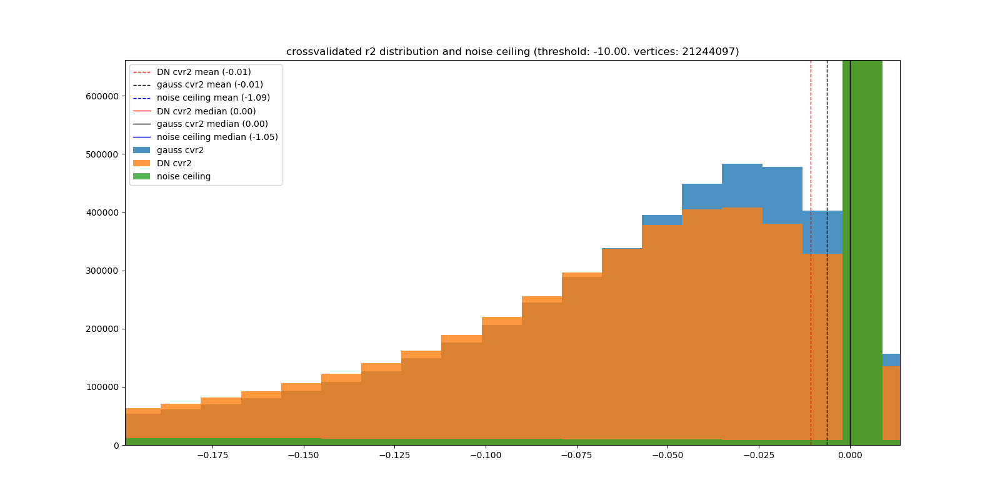

Text(0.5, 1.0, 'crossvalidated r2 distribution and noise ceiling (threshold: -10.00. vertices: 21244097)')

In [21]:
pl.figure(figsize=(16,8))
pl.hist(full_rsq_gauss[mask_rsq],bins=np.linspace(thresh,1,1000), label='gauss cvr2', alpha=0.8)
pl.hist(full_rsq[mask_rsq],bins=np.linspace(thresh,1,1000), label='DN cvr2', alpha=0.8)
pl.hist(nc[mask_rsq],bins=np.linspace(thresh,1,1000), label='noise ceiling', alpha=0.8)
pl.axvline(np.mean(full_rsq[mask_rsq]), color='r', linestyle='dashed', linewidth=1, label=f'DN cvr2 mean ({np.mean(full_rsq[mask_rsq]):.2f})')
pl.axvline(np.mean(full_rsq_gauss[mask_rsq]), color='k', linestyle='dashed', linewidth=1, label=f'gauss cvr2 mean ({np.mean(full_rsq_gauss[mask_rsq]):.2f})')
pl.axvline(np.mean(nc[mask_rsq]), color='b', linestyle='dashed', linewidth=1, label=f'noise ceiling mean ({np.mean(nc[mask_rsq]):.2f})')
pl.axvline(np.median(full_rsq[mask_rsq]), color='r', linewidth=1, label=f'DN cvr2 median ({np.median(full_rsq[mask_rsq]):.2f}) ')
pl.axvline(np.median(full_rsq_gauss[mask_rsq]), color='k', linewidth=1, label=f'gauss cvr2 median ({np.median(full_rsq_gauss[mask_rsq]):.2f})')
pl.axvline(np.median(nc[mask_rsq]), color='b', linewidth=1, label=f'noise ceiling median ({np.median(nc[mask_rsq]):.2f})')
pl.legend()

pl.title(f'crossvalidated r2 distribution and noise ceiling (threshold: {thresh:.2f}. vertices: {np.sum(mask_rsq)})')

In [ ]:
pl.figure(figsize=(16,8))
diff = full_rsq[mask_rsq]-full_rsq_gauss[mask_rsq]
pl.hist(diff,bins=1000, label='diff', alpha=0.8)
pl.axvline(np.mean(diff), color='k', linestyle='dashed', linewidth=1, label='diff cvr2 mean')
pl.axvline(np.median(diff), color='k', linewidth=1, label='diff cvr2 median')
pl.legend()
pl.xlim((-1,1))

## Combining no-cv results with CV-rsq and # of subjects map

In [6]:
#rsqwm have rsq-weighted means over subjects on fsaverage
#maindict_ #allall, allruns_sepcond_rsqwm, 5050CV, allruns_sepcond_zsc, HCP_181subjects_rsqwm, HCP_999999, 99mean181, 99split20, HCP_cv (tcfit), HCP_tc_nocv
with open('/Volumes/Crucial X8/maindict_HCP_cv.pickle', 'rb') as handle:
    dict_cv=dill.load(handle)

In [7]:
m = [sj for sj in dict_cv['HCP']['fit-task-BAR_fit-runs-CVmedian'].keys()]
m.sort()

In [8]:
l = [sj for sj in vis_res.main_dict['HCP']['fit-task-BAR_fit-runs-all'].keys()]
l.sort()

In [ ]:
hcp_group_average = dict()
ds_pyc = dict()

space = 'HCP'  #'HCP'#fsaverage
if space == 'fsaverage':
    pyc_sj = 'fsaverage'
else:
    pyc_sj = '999999'

weights = np.nan_to_num(np.array([dict_cv[space]['fit-task-BAR_fit-runs-CVmedian'][sj]['Processed Results']['RSq']['Norm_abcd'] for sj in m]))
weights[weights<=0] = 0

sj_number_map = np.sum(weights>0, axis=0)
threshold_li = filters.threshold_li(sj_number_map)
print(threshold_li)

for param in ['RSq', 'x_pos', 'y_pos','Norm Param. B','Norm Param. D','Amplitude', 'Surround Amplitude','Size (fwhmax)','Surround Size (fwatmin)','Size (sigma_1)','Size (sigma_2)']:
    if param == 'x_pos':
        data = np.nan_to_num(np.array([vis_res.main_dict[space]['fit-task-BAR_fit-runs-all'][sj]['Processed Results']['Eccentricity']['Norm_abcd'] for sj in m])*np.cos(np.array([vis_res.main_dict[space]['fit-task-BAR_fit-runs-all'][sj]['Processed Results']['Polar Angle']['Norm_abcd'] for sj in m])))
    elif param == 'y_pos':
        data = np.nan_to_num(np.array([vis_res.main_dict[space]['fit-task-BAR_fit-runs-all'][sj]['Processed Results']['Eccentricity']['Norm_abcd'] for sj in m])*np.sin(np.array([vis_res.main_dict[space]['fit-task-BAR_fit-runs-all'][sj]['Processed Results']['Polar Angle']['Norm_abcd'] for sj in m])))
    elif param == 'RSq':
        data = np.copy(weights)
    else:
        data = np.nan_to_num(np.array([vis_res.main_dict[space]['fit-task-BAR_fit-runs-all'][sj]['Processed Results'][param]['Norm_abcd'] for sj in m]))

    if param == 'RSq':
        hcp_group_average[param] = (data*(weights>0)).sum(0)/(weights>0).sum(0)
    else:
        hcp_group_average[param] = (data*weights).sum(0)/weights.sum(0)
    
hcp_group_average['Polar Angle'] = np.arctan2(hcp_group_average['y_pos'], hcp_group_average['x_pos'])
hcp_group_average['Eccentricity'] = np.sqrt(hcp_group_average['y_pos']**2 + hcp_group_average['x_pos']**2) 
hcp_group_average['#Subjects with CVRSq>0'] = np.copy(sj_number_map)

for param in hcp_group_average:
    vis_res.main_dict[space]['fit-task-BAR_fit-runs-all'][f'{space}_cvrsq']['Processed Results'][param]['Norm_abcd'] = np.copy(hcp_group_average[param])
    
vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][f'fsaverage_cvrsq']['Processed Results']['RSq']['Norm_abcd']=np.nan_to_num(vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][f'fsaverage_cvrsq']['Processed Results']['RSq']['Norm_abcd'])

In [23]:
vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][f'fsaverage_cvrsq']['Processed Results']['Size ratio (sigma_2/sigma_1)']['Norm_abcd']=vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][f'fsaverage_cvrsq']['Processed Results']['Size (sigma_2)']['Norm_abcd']/vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][f'fsaverage_cvrsq']['Processed Results']['Size (sigma_1)']['Norm_abcd']

/var/folders/vb/gdqfj5px0gb7r_bgl5hpf8n00000gn/T/ipykernel_65293/2405854770.py:1: RuntimeWarning: invalid value encountered in true_divide
  vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][f'fsaverage_cvrsq']['Processed Results']['Size ratio (sigma_2/sigma_1)']['Norm_abcd']=vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][f'fsaverage_cvrsq']['Processed Results']['Size (sigma_2)']['Norm_abcd']/vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][f'fsaverage_cvrsq']['Processed Results']['Size (sigma_1)']['Norm_abcd']


In [34]:
vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][f'fsaverage_cvrsq']['Processed Results']['Ratio (B/D)']['Norm_abcd']=vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][f'fsaverage_cvrsq']['Processed Results']['Norm Param. B']['Norm_abcd']/vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][f'fsaverage_cvrsq']['Processed Results']['Norm Param. D']['Norm_abcd']

/var/folders/vb/gdqfj5px0gb7r_bgl5hpf8n00000gn/T/ipykernel_73692/1394410459.py:1: RuntimeWarning: invalid value encountered in true_divide
  vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][f'fsaverage_cvrsq']['Processed Results']['Ratio (B/D)']['Norm_abcd']=vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][f'fsaverage_cvrsq']['Processed Results']['Norm Param. B']['Norm_abcd']/vis_res.main_dict['fsaverage']['fit-task-BAR_fit-runs-all'][f'fsaverage_cvrsq']['Processed Results']['Norm Param. D']['Norm_abcd']


In [25]:
for param in hcp_group_average:
    if param == 'Polar Angle':
        pyc_cmap = 'hsvx2'
        vmin1 = -3.1415
        vmax1 = 3.1415
    else:
        pyc_cmap = 'nipy_spectral'
        vmin1 = np.nanquantile(hcp_group_average[param][sj_number_map>threshold_li],0.1)
        vmax1 = np.nanquantile(hcp_group_average[param][sj_number_map>threshold_li],0.9)
        
    ds_pyc[f"{param}"] = Vertex2D_fix(hcp_group_average[param], sj_number_map, subject=pyc_sj, 
                                                        vmin=vmin1, 
                                                        vmax=vmax1, 
                                                        vmin2=threshold_li, vmax2=69, cmap=pyc_cmap)

# select path for static viewer on disk
viewer_path = '/Users/marcoaqil/Downloads'

# create viewer
#cortex.webgl.make_static(outpath=viewer_path, data=ds_pyc, recache=True)
#cortex.webgl.show(ds_pyc)

Started server on port 4722


<JS: window.viewer>

## CVR2 maps tests (neg values not set to zero, median)

In [6]:
cvrsq_raw_mean = np.mean([vis_res.main_dict['HCP']['fit-task-BAR_fit-runs-CVmedian'][sj]['Processed Results']['RSq']['Norm_abcd'] for sj in vis_res.main_dict['HCP']['fit-task-BAR_fit-runs-CVmedian'].keys()], axis=0)
cvrsq_raw_median = np.median([vis_res.main_dict['HCP']['fit-task-BAR_fit-runs-CVmedian'][sj]['Processed Results']['RSq']['Norm_abcd'] for sj in vis_res.main_dict['HCP']['fit-task-BAR_fit-runs-CVmedian'].keys()], axis=0)

cvrsq_raw_number_sj = np.sum([vis_res.main_dict['HCP']['fit-task-BAR_fit-runs-CVmedian'][sj]['Processed Results']['RSq']['Norm_abcd']>0 for sj in vis_res.main_dict['HCP']['fit-task-BAR_fit-runs-CVmedian'].keys()], axis=0)


In [7]:
(cvrsq_raw_mean>0).sum()/len(cvrsq_raw_mean)

0.07713519530459421

In [92]:
rsq_thresh = 0.0
rsq_max_opacity = 0.15
ds_rsq=dict()
ds_rsq[f"cvrsq_raw_mean"] = cortex.Vertex(cvrsq_raw_mean, subject='999999', 
                                vmin=np.nanquantile(cvrsq_raw_mean,0.1), 
                                vmax=np.nanquantile(cvrsq_raw_mean,0.9), cmap='nipy_spectral')
ds_rsq[f"cvrsq_raw_median"] = cortex.Vertex(cvrsq_raw_median, subject='999999', 
                                vmin=np.nanquantile(cvrsq_raw_median,0.1), 
                                vmax=np.nanquantile(cvrsq_raw_median,0.9), cmap='nipy_spectral')
ds_rsq[f"cvrsq_raw_number_sj"] = cortex.Vertex(cvrsq_raw_number_sj, subject='999999', 
                                vmin=8, 
                                vmax=150, cmap='nipy_spectral')
cortex.webgl.show(ds_rsq)

Started server on port 54914


<JS: window.viewer>

In [78]:
from skimage import filters
threshold_yen = filters.threshold_yen(cvrsq_raw_number_sj) #yen=43, otsu=56, isodata=56, li=22, mean=16.54, minimum=89, triangle=8
threshold_otsu = filters.threshold_otsu(cvrsq_raw_number_sj)
threshold_isodata = filters.threshold_isodata(cvrsq_raw_number_sj)
threshold_li = filters.threshold_li(cvrsq_raw_number_sj)
threshold_mean = filters.threshold_mean(cvrsq_raw_number_sj)
threshold_minimum = filters.threshold_minimum(cvrsq_raw_number_sj)
threshold_triangle = filters.threshold_triangle(cvrsq_raw_number_sj)

In [77]:
thresh

8

In [57]:
np.sum(cvrsq_raw_number_sj>thresh)/len(cvrsq_raw_number_sj)

0.12439283545840923

<IPython.core.display.Javascript object>


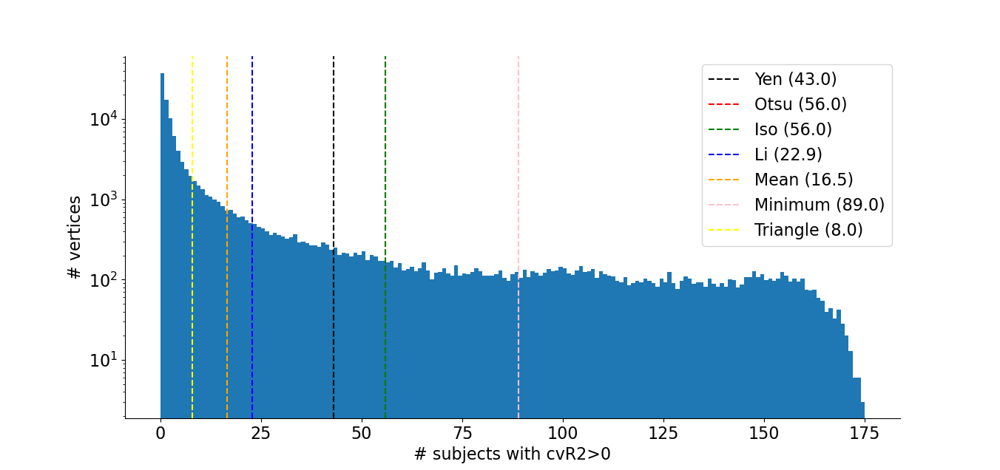

In [86]:
pl.figure()
pl.hist(cvrsq_raw_number_sj,bins=175)
pl.axvline(threshold_yen, linestyle='--', color='k', label = f"Yen ({threshold_yen:.1f})")
pl.axvline(threshold_otsu, linestyle='--', color='r', label = f"Otsu ({threshold_otsu:.1f})")
pl.axvline(threshold_isodata, linestyle='--', color='g', label = f"Iso ({threshold_isodata:.1f})")
pl.axvline(threshold_li, linestyle='--', color='b', label = f"Li ({threshold_li:.1f})")
pl.axvline(threshold_mean, linestyle='--', color='orange', label = f"Mean ({threshold_mean:.1f})")
pl.axvline(threshold_minimum, linestyle='--', color='pink', label = f"Minimum ({threshold_minimum:.1f})")
pl.axvline(threshold_triangle, linestyle='--', color='yellow', label = f"Triangle ({threshold_triangle:.1f})")
pl.xlabel('# subjects with cvR2>0')
pl.ylabel('# vertices')
pl.yscale('log')
pl.legend()

## B and D histograms

In [13]:
space = 'fsaverage'#'fsaverage'
analysis = 'fit-task-BAR_fit-runs-CVmedian'#'fit-task-BAR_fit-runs-all'

if space == 'HCP':
    full_rsq = np.concatenate(tuple([vis_res.main_dict[space][analysis][sj]['Processed Results']['RSq']['Norm_abcd'] for sj in vis_res.main_dict[space][analysis].keys()]))
    norm_b = np.concatenate(tuple([vis_res.main_dict[space][analysis][sj]['Processed Results']['Norm Param. B']['Norm_abcd'] for sj in vis_res.main_dict[space][analysis].keys()]))
    norm_d = np.concatenate(tuple([vis_res.main_dict[space][analysis][sj]['Processed Results']['Norm Param. D']['Norm_abcd'] for sj in vis_res.main_dict[space][analysis].keys()]))
else:
    full_rsq = vis_res.main_dict[space][analysis][space]['Processed Results']['RSq']['Norm_abcd'] 
    norm_b = vis_res.main_dict[space][analysis][space]['Processed Results']['Norm Param. B']['Norm_abcd'] 
    norm_d = vis_res.main_dict[space][analysis][space]['Processed Results']['Norm Param. D']['Norm_abcd']


In [21]:
param_rsq_thresh = 0.3
quantile_exclusion = 0.999
mask_b = (full_rsq>param_rsq_thresh) * (norm_b<np.nanquantile(norm_b,quantile_exclusion))*(norm_b>np.nanquantile(norm_b,1-quantile_exclusion))
mask_d = (full_rsq>param_rsq_thresh) * (norm_d<np.nanquantile(norm_d,quantile_exclusion))*(norm_d>np.nanquantile(norm_d,1-quantile_exclusion))

<IPython.core.display.Javascript object>


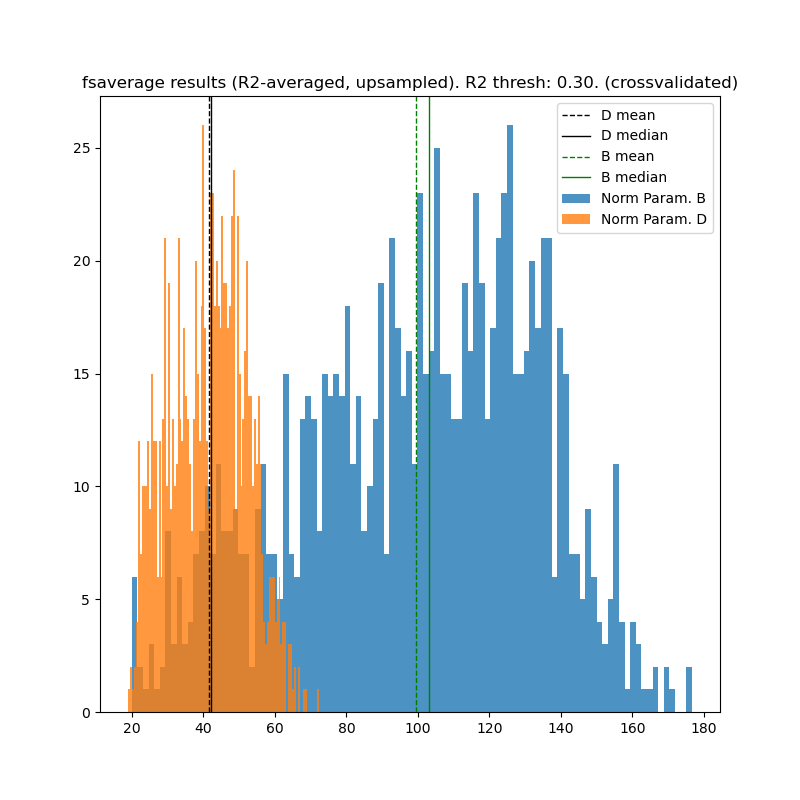

In [22]:
pl.figure(figsize=(8,8))
pl.hist(norm_b[mask_b],bins=100, label='Norm Param. B', alpha=0.8)
pl.hist(norm_d[mask_d],bins=100, label='Norm Param. D', alpha=0.8)
pl.axvline(np.nanmean(norm_d[mask_d]), color='k', linestyle='dashed', linewidth=1, label='D mean')
pl.axvline(np.nanmedian(norm_d[mask_d]), color='k', linewidth=1, label='D median')
pl.axvline(np.nanmean(norm_b[mask_b]), color='g', linestyle='dashed', linewidth=1, label='B mean')
pl.axvline(np.nanmedian(norm_b[mask_b]), color='g', linewidth=1, label='B median')
if space == 'HCP':
    title_string = f"Raw fit results (unaveraged, unsmoothed). R2 thresh: {param_rsq_thresh:.2f}."
    if 'CV' in analysis:
        title_string+=" (crossvalidated)"
    pl.title(title_string)
    
else:
    title_string = f"fsaverage results (R2-averaged, upsampled). R2 thresh: {param_rsq_thresh:.2f}."
    if 'CV' in analysis:
        title_string+=" (crossvalidated)"
    pl.title(title_string)

pl.legend()

<IPython.core.display.Javascript object>


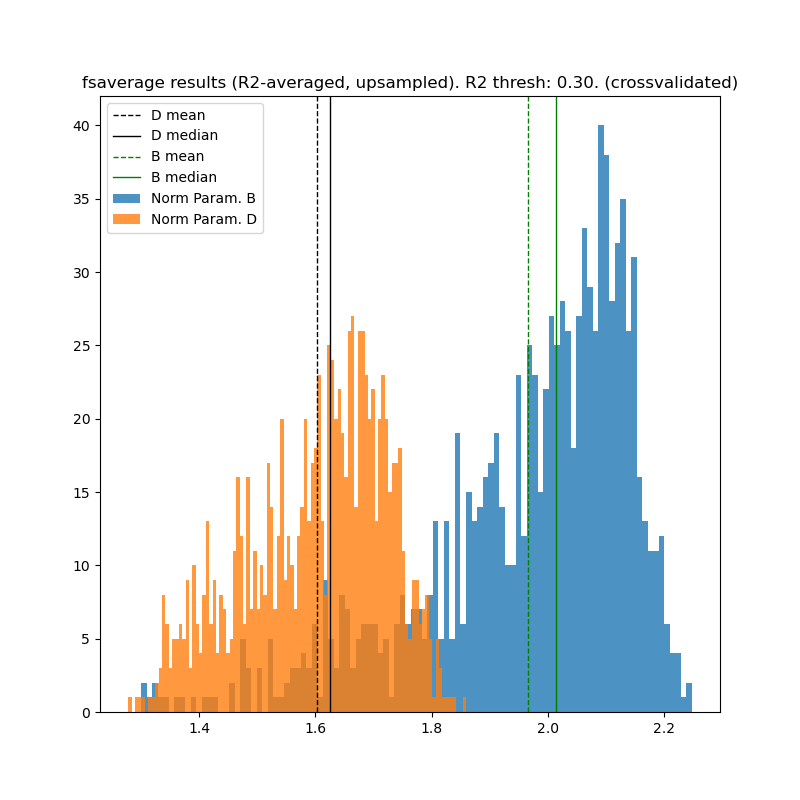

In [23]:
pl.figure(figsize=(8,8))
pl.hist(np.log10(norm_b[mask_b]),bins=100, label='Norm Param. B', alpha=0.8)
pl.hist(np.log10(norm_d[mask_d]),bins=100, label='Norm Param. D', alpha=0.8)
pl.axvline(np.nanmean(np.log10(norm_d[mask_d])), color='k', linestyle='dashed', linewidth=1, label='D mean')
pl.axvline(np.nanmedian(np.log10(norm_d[mask_d])), color='k', linewidth=1, label='D median')
pl.axvline(np.nanmean(np.log10(norm_b[mask_b])), color='g', linestyle='dashed', linewidth=1, label='B mean')
pl.axvline(np.nanmedian(np.log10(norm_b[mask_b])), color='g', linewidth=1, label='B median')
if space == 'HCP':
    title_string = f"Raw fit results (unaveraged, unsmoothed). R2 thresh: {param_rsq_thresh:.2f}."
    if 'CV' in analysis:
        title_string+=" (crossvalidated)"
    pl.title(title_string)
    
else:
    title_string = f"fsaverage results (R2-averaged, upsampled). R2 thresh: {param_rsq_thresh:.2f}."
    if 'CV' in analysis:
        title_string+=" (crossvalidated)"
    pl.title(title_string)
pl.legend()